# Reading & Cleaning Air Quality data

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install pandas numpy scikit-learn fancyimpute statsmodels seaborn matplotlib pykalman ace_tools

  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 251.6/251.6 kB 17.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.7/154.7 kB 10.3 MB/s eta 0:00:00
  Created wheel for fancyimpute: filename=fancyimpute-0.7.0-py3-none-any.whl size=29881 sha256=5bc98e916d02d069ac2c584b270d56c0aaa4fc98e200071b3f6b3c6960506407
  Stored in directory: /root/.cache/pip/wheels/7b/0c/d3/ee82d1fbdcc0858d96434af108608d01703505d453720c84ed
  Created wheel for knnimpute: filename=knnimpute-0.1.0-py3-none-any.whl size=11331 sha256=2ceb5681edf398770032f552476f09204d9ee5b9d765aefe6e31df744c4fe5c4
  Stored in directory: /root/.cache/pip/wheels/46/06/a5/45a724630562413c374e29c08732411d496092408b3a7bf754
Successfully built fancyimpute knnimpute


In [ ]:
import pandas as pd
import numpy as np
from sklearn.impute import SimpleImputer
from sklearn.metrics import mean_squared_error, mean_absolute_error
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import os
import glob
import random

In [ ]:
def clean_dataframe(file_path):
    # Step 1: Read the CSV file
    df = pd.read_csv(file_path)

    # Step 2: Replace empty strings and spaces with NaN
    df.replace(['', ' '], np.nan, inplace=True)

    # Step 3: Ensure 'pm25' column exists and handle any potential issues with column names
    df.columns = df.columns.str.strip()  # Remove any leading/trailing spaces from column names
    if 'pm25' not in df.columns:
        raise KeyError(f"'pm25' column not found in the DataFrame for file: {file_path}")

    # Step 4: Remove rows with one or two non-NaN values (excluding 'date' column)
    def filter_rows(row):
        # Exclude 'date' column
        data = row.drop(['date'])
        non_nan_count = data.count()
        # Check if 'pm25' column is NaN and ensure it's not counted in the exclusion condition
        if pd.isna(row['pm25']) and non_nan_count >= 2:
            return True
        return non_nan_count > 2

    df = df[df.apply(filter_rows, axis=1)]

    # Step 5: Handle the 'date' column
    df['date'] = pd.to_datetime(df['date'])

    return df

def process_all_csvs(directory_path, output_directory):
    # Create the output directory if it doesn't exist
    os.makedirs(output_directory, exist_ok=True)

    # Get all CSV files in the directory
    csv_files = glob.glob(os.path.join(directory_path, '*.csv'))

    for file_path in csv_files:
        try:
            cleaned_df = clean_dataframe(file_path)
            output_file_path = os.path.join(output_directory, os.path.basename(file_path))
            cleaned_df.to_csv(output_file_path, index=False)
            print(f"Processed and saved: {output_file_path}")
        except Exception as e:
            print(f"Error processing {file_path}: {e}")

# Example usage
directory_path = '/content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/csv'
output_directory = '/content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/clean_csv'
process_all_csvs(directory_path, output_directory)


Processed and saved: /content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/clean_csv/tehran-mahalati, iran-air-quality.csv
Processed and saved: /content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/clean_csv/tehran-region 19, iran-air-quality.csv


<ipython-input-10-feedfdcdfdfd>:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['date'] = pd.to_datetime(df['date'])


Processed and saved: /content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/clean_csv/tehran-region 22, iran-air-quality.csv
Processed and saved: /content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/clean_csv/tehran-cheshmeh, iran-air-quality.csv
Processed and saved: /content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/clean_csv/tehran-region 2, iran-air-quality.csv
Processed and saved: /content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/clean_csv/tehran-region 21, iran-air-quality.csv
Processed and saved: /content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/clean_csv/tehran-region 11, iran-air-quality.csv
Processed and saved: /content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/clean_csv/tehran-region 16, iran-air-quality.csv
Processed and saved: /content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/clean_csv/tehran-salamat, iran-air-q

<ipython-input-10-feedfdcdfdfd>:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['date'] = pd.to_datetime(df['date'])


Processed and saved: /content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/clean_csv/tehran-razi, iran-air-quality.csv
Processed and saved: /content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/clean_csv/tehran-sharif university, iran-air-quality.csv
Processed and saved: /content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/clean_csv/tehran-shahid beheshti university, iran-air-quality.csv
Processed and saved: /content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/clean_csv/tehran-darous, iran-air-quality.csv
Processed and saved: /content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/clean_csv/tehran-pirozi, iran-air-quality.csv
Processed and saved: /content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/clean_csv/tehran-region 10, iran-air-quality.csv


<ipython-input-10-feedfdcdfdfd>:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['date'] = pd.to_datetime(df['date'])


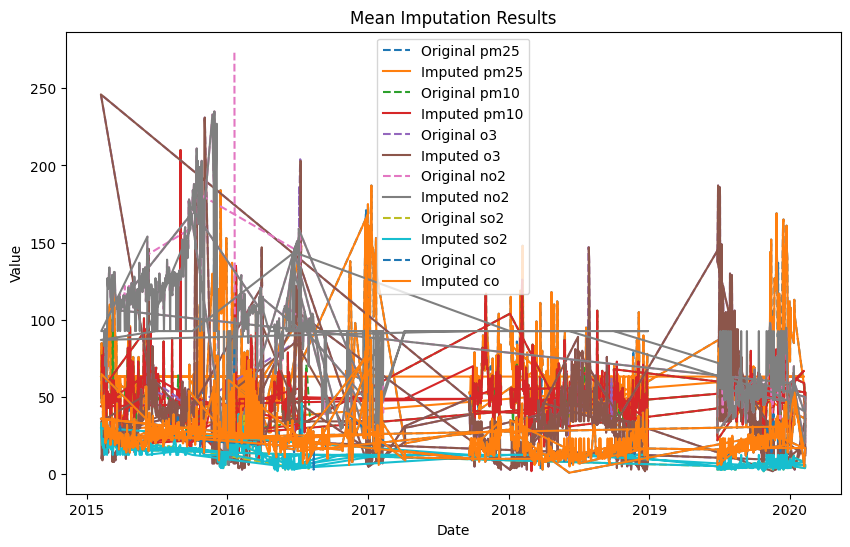

Metrics for DataFrame 1: {'pm25': {'MSE': 773.5375629577013, 'MAE': 21.123639548420865}, 'pm10': {'MSE': 269.22059433724445, 'MAE': 12.643171061528058}, 'o3': {'MSE': 1360.528717652603, 'MAE': 23.42468734133933}, 'no2': {'MSE': 2604.8347508872125, 'MAE': 40.609458577951735}, 'so2': {'MSE': 54.81745379756768, 'MAE': 6.471028519809007}, 'co': {'MSE': 190.69031598325657, 'MAE': 9.306078317281388}}


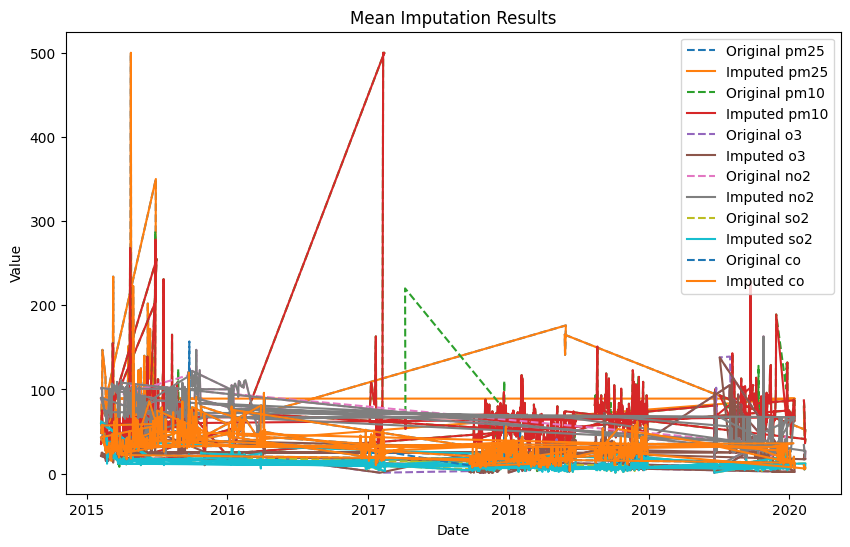

Metrics for DataFrame 2: {'pm25': {'MSE': 1258.246368426748, 'MAE': 29.642857142857142}, 'pm10': {'MSE': 1571.9894625427282, 'MAE': 24.670564138954294}, 'o3': {'MSE': 560.4062533610731, 'MAE': 16.774402068519713}, 'no2': {'MSE': 949.2024452866732, 'MAE': 27.705501222493886}, 'so2': {'MSE': 42.36655502849198, 'MAE': 4.974019390406185}, 'co': {'MSE': 412.81198904109596, 'MAE': 13.26301369863014}}


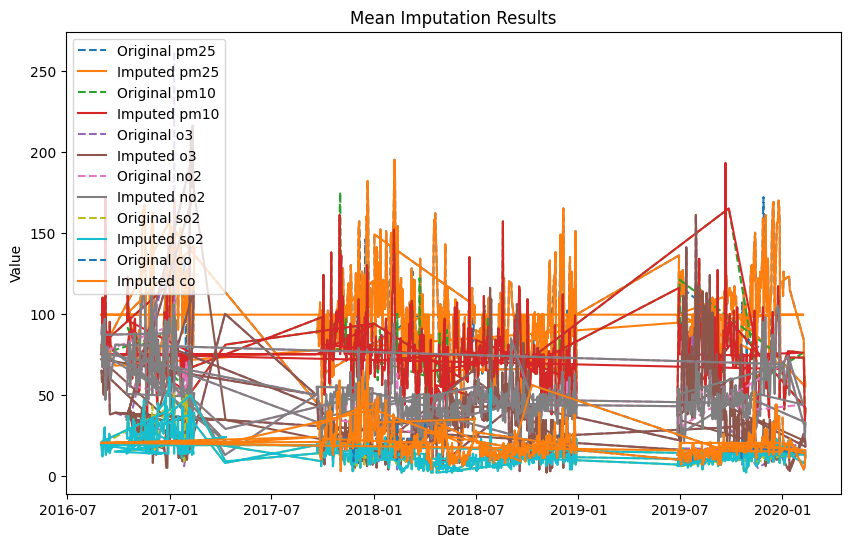

Metrics for DataFrame 3: {'pm25': {'MSE': 831.2820126899676, 'MAE': 23.30979053012951}, 'pm10': {'MSE': 420.2227111004354, 'MAE': 13.908350219520432}, 'o3': {'MSE': 976.4334173565876, 'MAE': 18.359744690216797}, 'no2': {'MSE': 262.45787439227047, 'MAE': 11.771937352499462}, 'so2': {'MSE': 106.28135750661019, 'MAE': 6.88016868189282}, 'co': {'MSE': 104.3862065042358, 'MAE': 8.09978145847711}}


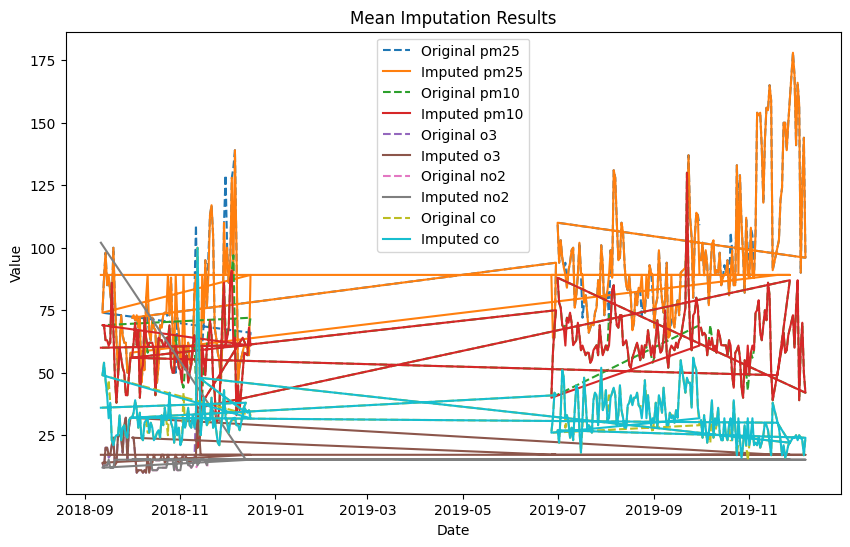

Metrics for DataFrame 4: {'pm25': {'MSE': 442.9773697814238, 'MAE': 17.355509355509355}, 'pm10': {'MSE': 124.59843956504966, 'MAE': 7.769230769230769}, 'o3': {'MSE': 69.46594280289546, 'MAE': 5.279874213836479}, 'no2': {'MSE': 7.5772889417360325, 'MAE': 2.706896551724139}, 'co': {'MSE': 49.69509617401533, 'MAE': 5.642929123278467}}


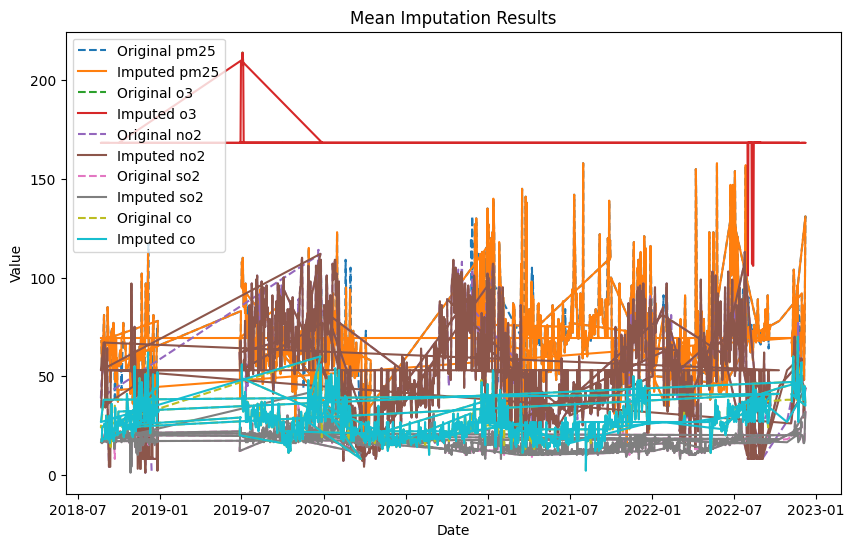

Metrics for DataFrame 5: {'pm25': {'MSE': 547.8556615440154, 'MAE': 18.43744743380284}, 'o3': {'MSE': 3674.0900000000015, 'MAE': 60.30000000000001}, 'no2': {'MSE': 843.06331268797, 'MAE': 24.602897994717505}, 'so2': {'MSE': 18.28626731359588, 'MAE': 3.2922878155436295}, 'co': {'MSE': 93.94127507413221, 'MAE': 7.815262515262515}}


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import random
from sklearn.metrics import mean_squared_error, mean_absolute_error

# Function to read 5 random CSV files
def read_random_csv_files(directory_path, n=5):
    csv_files = [os.path.join(directory_path, f) for f in os.listdir(directory_path) if f.endswith('.csv')]
    random_files = random.sample(csv_files, n)
    dfs = [pd.read_csv(file) for file in random_files]
    return dfs

# Function to perform mean imputation with cross-validation
def mean_imputation_cv(df, date_col='date', test_ratio=0.1):
    df = df.copy()
    numerical_cols = df.select_dtypes(include=[np.number]).columns.tolist()

    # Split the data into train and test sets by introducing NaNs
    df_with_nans = df.copy()
    test_indices = df_with_nans.sample(frac=test_ratio, random_state=42).index
    original_values = df.loc[test_indices, numerical_cols]
    df_with_nans.loc[test_indices, numerical_cols] = np.nan

    # Perform mean imputation
    df_mean_imputed = df_with_nans.copy()
    for col in numerical_cols:
        mean_value = df_mean_imputed[col].mean()
        df_mean_imputed[col].fillna(mean_value, inplace=True)

    # Plot the results
    plt.figure(figsize=(10, 6))
    for col in numerical_cols:
        plt.plot(df[date_col], df[col], label=f'Original {col}', linestyle='dashed')
        plt.plot(df[date_col], df_mean_imputed[col], label=f'Imputed {col}')

    plt.xlabel('Date')
    plt.ylabel('Value')
    plt.title('Mean Imputation Results')
    plt.legend()
    plt.show()

    # Calculate metrics only where both original and imputed values are not NaN
    metrics = {}
    for col in numerical_cols:
        valid_indices = original_values[col].notna() & df_mean_imputed.loc[test_indices, col].notna()
        mse = mean_squared_error(original_values.loc[valid_indices, col], df_mean_imputed.loc[test_indices, col][valid_indices])
        mae = mean_absolute_error(original_values.loc[valid_indices, col], df_mean_imputed.loc[test_indices, col][valid_indices])
        metrics[col] = {'MSE': mse, 'MAE': mae}

    return df_mean_imputed, metrics

# Example usage
output_directory = '/content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/clean_csv'
dfs = read_random_csv_files(output_directory)

# Apply mean imputation with cross-validation to each DataFrame and print the results
for i, df in enumerate(dfs):
    df['date'] = pd.to_datetime(df['date'])  # Ensure 'date' column is in datetime format
    df_mean_imputed, metrics = mean_imputation_cv(df)
    print(f"Metrics for DataFrame {i+1}: {metrics}")


                                            File Name  Column Count
0               tehran-mahalati, iran-air-quality.csv             7
1              tehran-region 19, iran-air-quality.csv             7
2              tehran-region 22, iran-air-quality.csv             7
3               tehran-cheshmeh, iran-air-quality.csv             7
4               tehran-region 2, iran-air-quality.csv             7
5              tehran-region 21, iran-air-quality.csv             7
6              tehran-region 11, iran-air-quality.csv             7
7              tehran-region 16, iran-air-quality.csv             7
8                tehran-salamat, iran-air-quality.csv             5
9                tehran-golbarg, iran-air-quality.csv             7
10              tehran-region 4, iran-air-quality.csv             7
11  tehran-tehran - park shokoufeh, iran-air-quali...             6
12             tehran-rose park, iran-air-quality.csv             7
13                tehran-poonak, iran-air-qualit

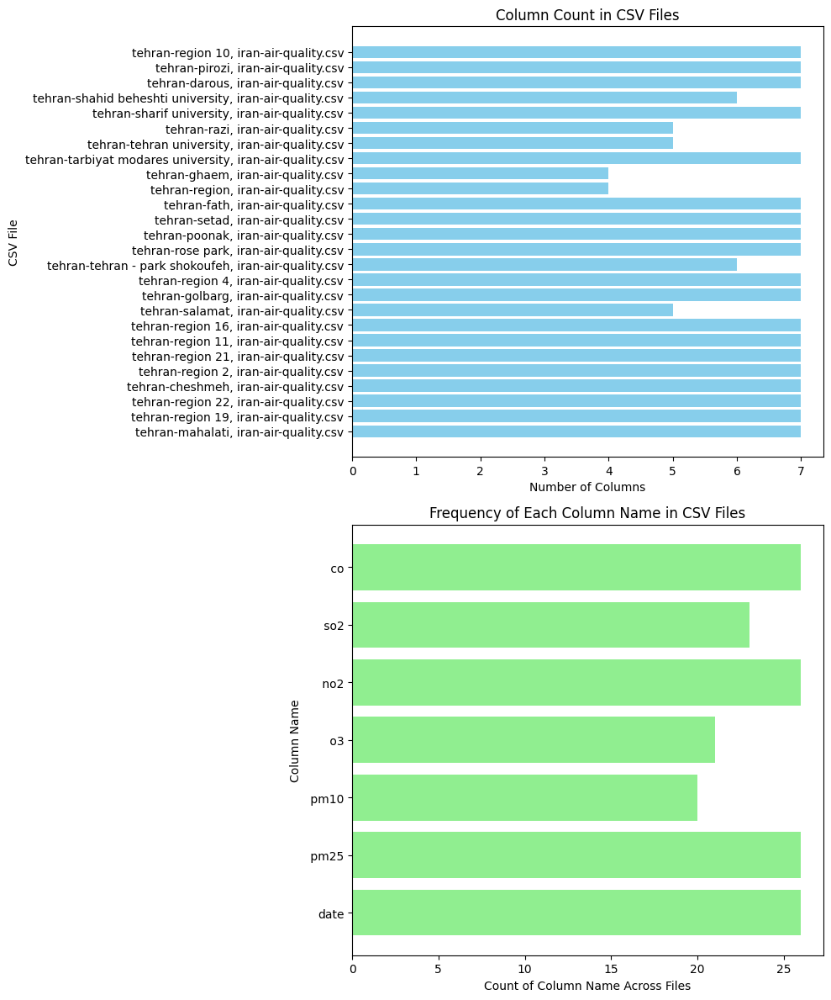

In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt
from collections import Counter

# Folder path containing the CSV files
folder_path = '/content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/csv'  # Replace with the actual path to your folder

# Initialize lists to store file names and column counts
file_names = []
column_counts = []

# Initialize a Counter for column names
column_name_counter = Counter()

# Loop through all files in the folder
for file_name in os.listdir(folder_path):
    if file_name.endswith('.csv'):
        file_path = os.path.join(folder_path, file_name)
        # Read the CSV file
        df = pd.read_csv(file_path)
        # Store the file name and number of columns
        file_names.append(file_name)
        column_counts.append(len(df.columns))
        # Update the column name counter
        column_name_counter.update(df.columns)

# Create a DataFrame for the column counts per file
column_count_df = pd.DataFrame({
    'File Name': file_names,
    'Column Count': column_counts
})

# Convert the column name counter to a DataFrame
column_name_df = pd.DataFrame.from_dict(column_name_counter, orient='index', columns=['Count']).reset_index()
column_name_df = column_name_df.rename(columns={'index': 'Column Name'})

# Display the tables
print(column_count_df)
print(column_name_df)

# Plot the column counts per file and frequency of column names
plt.figure(figsize=(10, 12))

# Plot column counts per file
plt.subplot(2, 1, 1)
plt.barh(column_count_df['File Name'], column_count_df['Column Count'], color='skyblue')
plt.xlabel('Number of Columns')
plt.ylabel('CSV File')
plt.title('Column Count in CSV Files')

# Plot frequency of column names
plt.subplot(2, 1, 2)
plt.barh(column_name_df['Column Name'], column_name_df['Count'], color='lightgreen')
plt.xlabel('Count of Column Name Across Files')
plt.ylabel('Column Name')
plt.title('Frequency of Each Column Name in CSV Files')

plt.tight_layout()

# Show the plot
plt.show()


# Air Quality Preprocessing

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
df_cheshmeh = pd.read_csv("/content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/clean_csv/tehran-cheshmeh, iran-air-quality.csv")
df_cheshmeh = pd.DataFrame(df_cheshmeh)
df_cheshmeh

,date,pm25,pm10,o3,no2,so2,co
0,2022-12-01,78.0,69.0,NaN,29.0,25.0,47.0
1,2022-12-02,85.0,56.0,NaN,25.0,29.0,51.0
2,2022-12-03,57.0,53.0,NaN,24.0,26.0,45.0
3,2022-12-04,59.0,38.0,NaN,27.0,26.0,47.0
4,2022-12-05,40.0,42.0,NaN,30.0,28.0,42.0
...,...,...,...,...,...,...,...
1218,2018-08-26,NaN,NaN,8.0,38.0,NaN,21.0
1219,2018-08-27,NaN,NaN,9.0,39.0,NaN,22.0
1220,2018-08-28,NaN,NaN,8.0,33.0,NaN,22.0
1221,2018-08-30,NaN,NaN,19.0,34.0,NaN,NaN


In [ ]:
df_cheshmeh.isna().sum()

,0
date,0
pm25,37
pm10,113
o3,1100
no2,210
so2,937
co,22


In [ ]:
df_cheshmeh.drop(['so2', 'o3'], axis=1, inplace=True)

In [ ]:
df_cheshmeh.isna().sum()

,0
date,0
pm25,37
pm10,113
no2,210
co,22


In [ ]:
df_cheshmeh.describe()

,pm25,pm10,no2,co
count,1186.000000,1110.000000,1013.000000,1201.000000
mean,81.324621,54.309009,44.356367,26.058285
std,29.245073,20.681644,21.356941,11.454618
min,19.000000,7.000000,1.000000,7.000000
25%,63.000000,42.000000,32.000000,16.000000
50%,78.000000,53.000000,40.000000,23.000000
75%,96.000000,62.000000,55.000000,38.000000
max,316.000000,349.000000,119.000000,53.000000


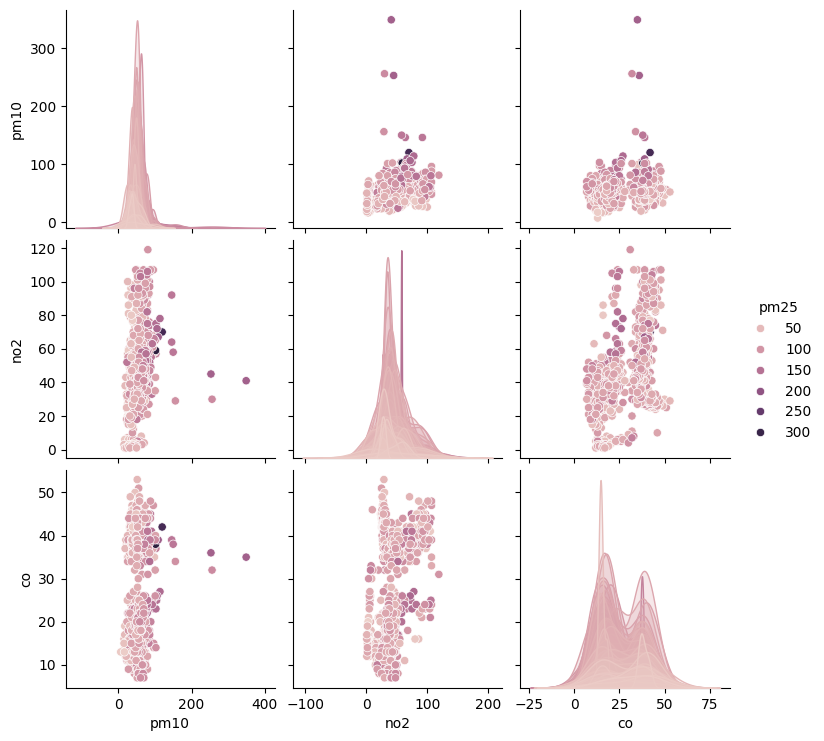

In [ ]:
sns.pairplot(df_cheshmeh, hue='pm25')
plt.show()

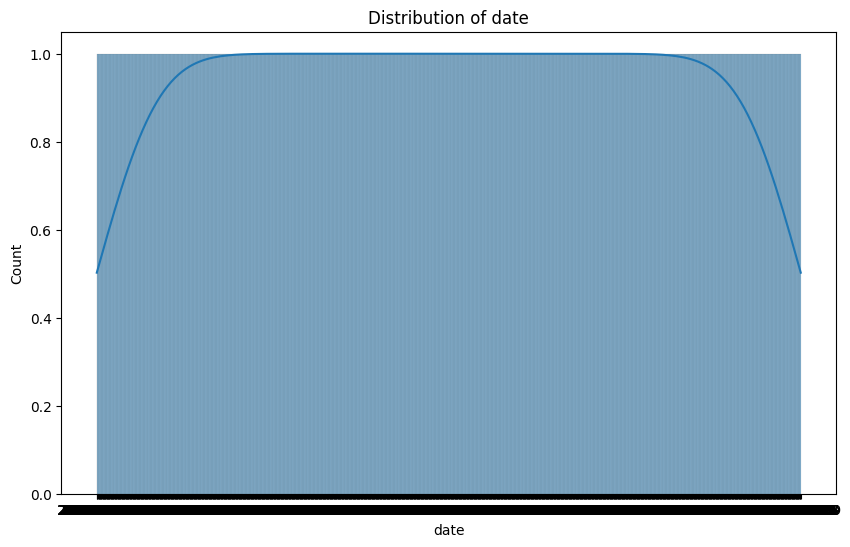

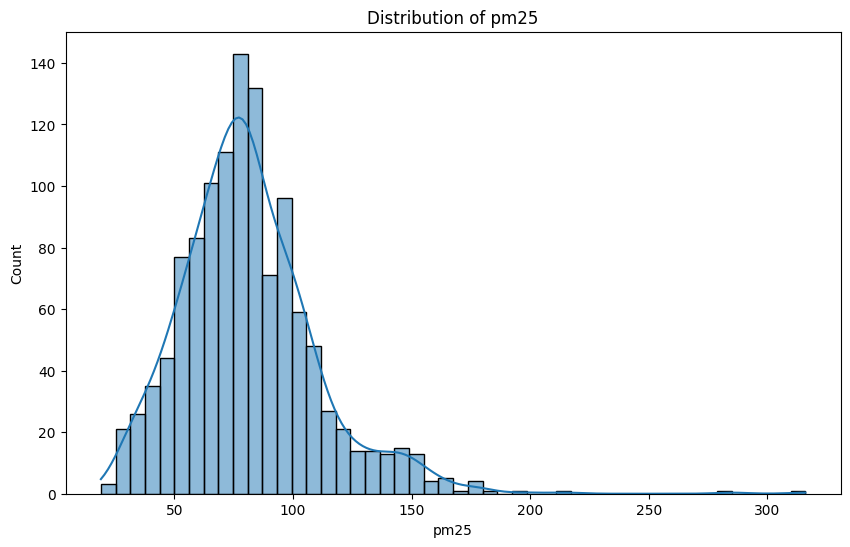

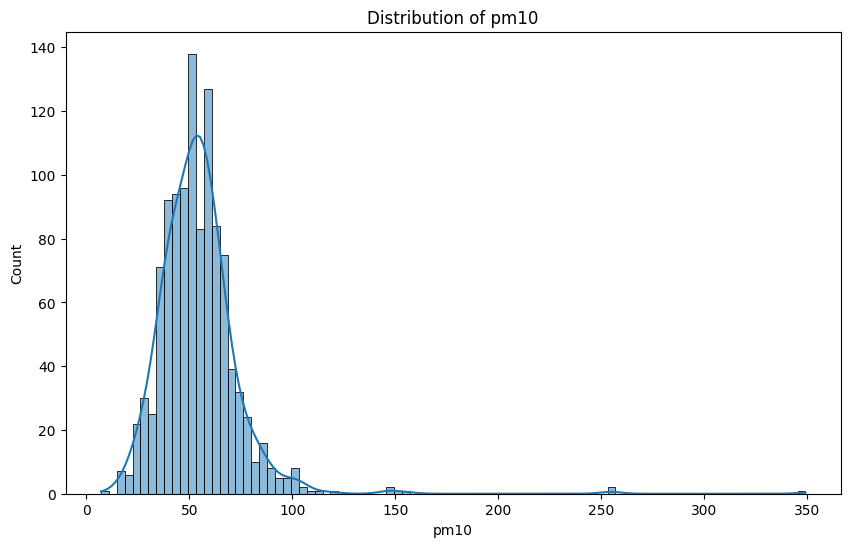

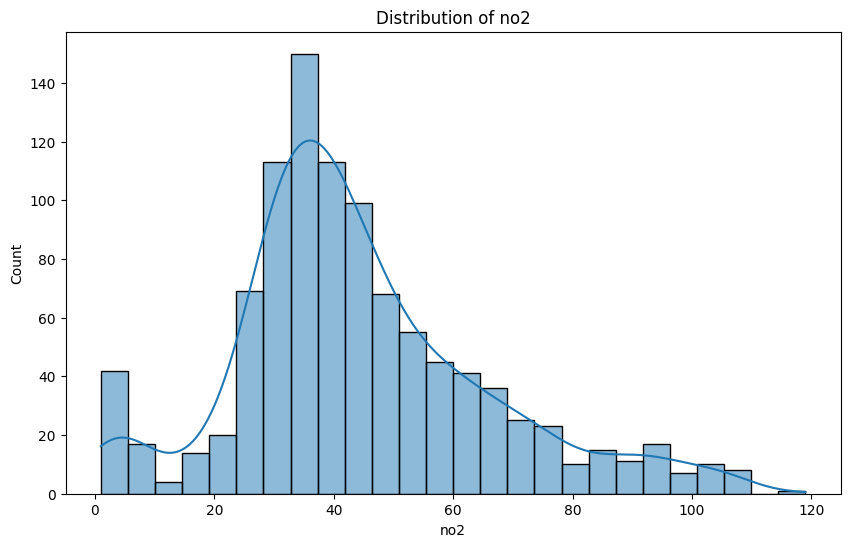

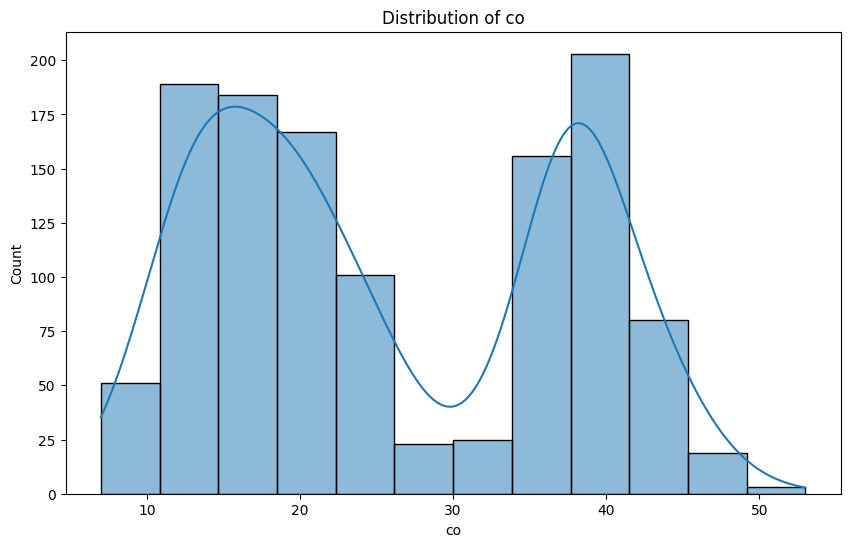

In [ ]:
numeric_columns = df_cheshmeh.columns
for column in numeric_columns:
    plt.figure(figsize=(10, 6))
    sns.histplot(df_cheshmeh[column], kde=True)
    plt.title(f'Distribution of {column}')
    plt.show()

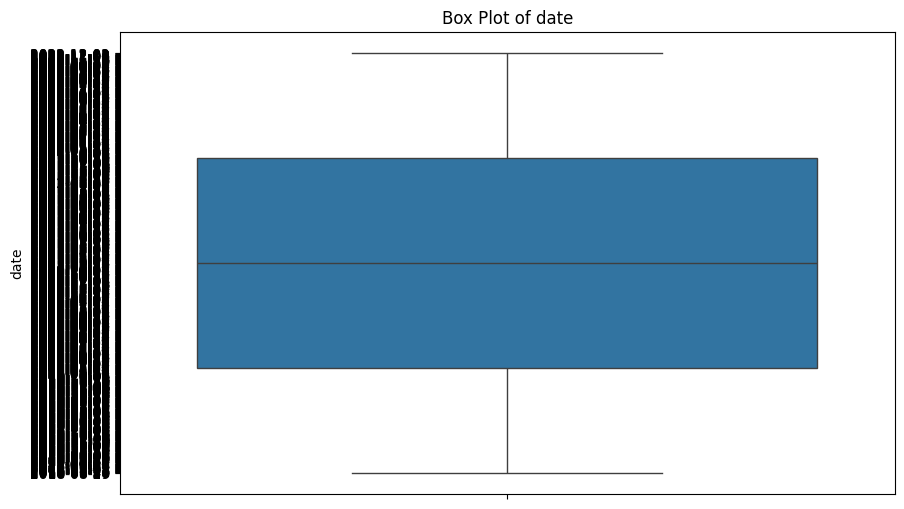

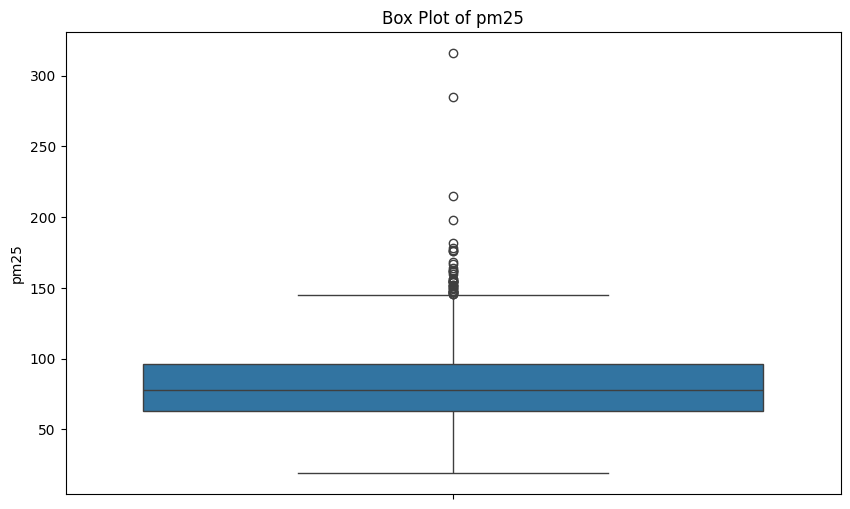

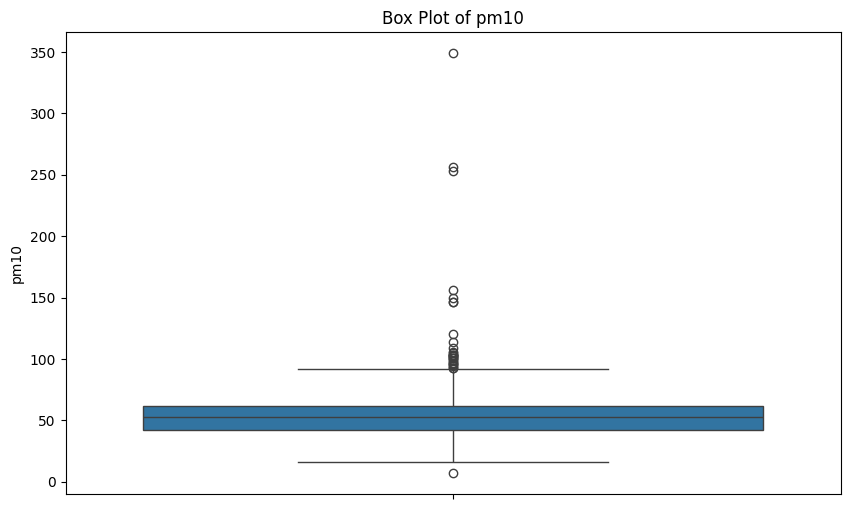

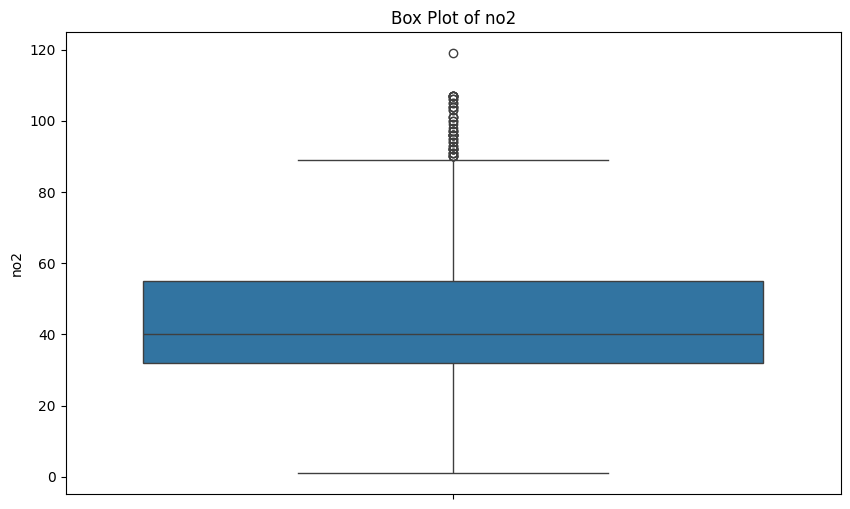

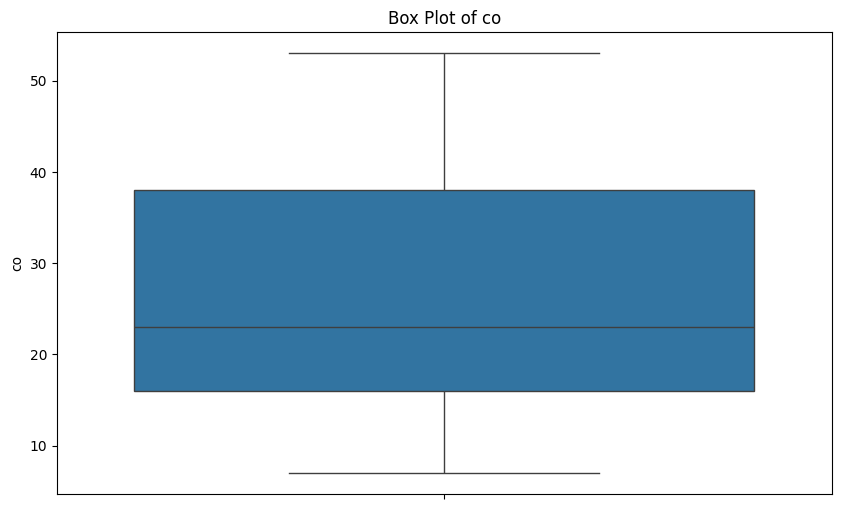

In [ ]:
numeric_columns = df_cheshmeh.columns
for column in numeric_columns:
    plt.figure(figsize=(10, 6))
    sns.boxplot(df_cheshmeh[column])
    plt.title(f'Box Plot of {column}')
    plt.show()

In [ ]:
print(df_cheshmeh.dtypes)

date     object
pm25    float64
pm10    float64
no2     float64
co      float64
dtype: object


In [ ]:
def interpolate_missing_data(df, date_col='date'):
    df_interpolated = df.copy()

    # Step 1: Convert the 'date' column to datetime format using pandas
    df_interpolated[date_col] = pd.to_datetime(df_interpolated[date_col], errors='coerce')

    # Step 2: Set 'date' as the index
    df_interpolated.set_index(date_col, inplace=True)

    # Step 3: Perform time-based interpolation
    df_interpolated = df_interpolated.interpolate(method='time')

    # Step 4: Reset the index
    df_interpolated.reset_index(inplace=True)

    return df_interpolated

In [ ]:
def remove_outliers_iqr(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    df_cleaned = df[~((df < lower_bound) | (df > upper_bound)).any(axis=1)]
    return df_cleaned

In [ ]:
def preprocess_all_csvs(clean_csv_dir, preprocessed_csv_dir):
    # Create the preprocessed_csv directory if it doesn't exist
    os.makedirs(preprocessed_csv_dir, exist_ok=True)

    # Process each CSV file in the clean_csv directory
    all_dataframes = []
    for file_name in os.listdir(clean_csv_dir):
        if file_name.endswith('.csv'):
            file_path = os.path.join(clean_csv_dir, file_name)
            save_path = os.path.join(preprocessed_csv_dir, file_name)

            # Preprocess the file
            df = preprocess_air_quality_data(file_path, save_path)

            # Add location feature based on the file name (removing the extension)
            location = os.path.splitext(file_name)[0]
            df['location'] = location

            # Append to the list of DataFrames
            all_dataframes.append(df)

    # Combine all preprocessed DataFrames into one
    combined_df = pd.concat(all_dataframes, ignore_index=True)

    # Save the combined DataFrame to a CSV file
    combined_csv_path = os.path.join(preprocessed_csv_dir, 'combined_preprocessed.csv')
    combined_df.to_csv(combined_csv_path, index=False)

    return combined_df

In [ ]:
def preprocess_air_quality_data(csv_path, save_path):
    # Load the dataset
    df = pd.read_csv(csv_path)

    # Drop unwanted columns
    df.drop(['so2', 'o3', 'pm10'], axis=1, inplace=True)

    # Interpolate missing data based on the time
    df = interpolate_missing_data(df, 'date')

    # Remove outliers using the IQR method
    df = remove_outliers_iqr(df)

    # Feature engineering: create additional time-based features
    df['year'] = df['date'].dt.year
    df['month'] = df['date'].dt.month
    df['day_of_week'] = df['date'].dt.dayofweek
    df['day_of_year'] = df['date'].dt.dayofyear

    # Create lag features for numeric columns only
    lag_days = [1, 2, 3]
    numeric_cols = df.select_dtypes(include=['float64', 'int64']).columns

    for lag in lag_days:
        for col in numeric_cols:
            df[f'{col}_lag_{lag}'] = df[col].shift(lag)

    # Drop rows with NaN values resulting from lag creation
    df = df.dropna()

    # Reset the index
    df.reset_index(drop=True, inplace=True)

    # Save the preprocessed DataFrame to a new CSV file
    df.to_csv(save_path, index=False)

    # Return the preprocessed DataFrame
    return df

In [ ]:
# Example usage
csv_path = '/content/drive/MyDrive/ground data/pm 2.5 amount Air Quality Stations Data/clean_csv/tehran-cheshmeh, iran-air-quality.csv'
save_path = 'cheshmeh_full_processed.csv'

df_processed = preprocess_air_quality_data(csv_path, save_path)

print("Processed DataFrame Head:")
print(df_processed.head())

Processed DataFrame Head:
        date  pm25   no2    co  year  month  day_of_week  day_of_year  \
0 2022-12-04  59.0  27.0  47.0  2022     12            6          338   
1 2022-12-05  40.0  30.0  42.0  2022     12            0          339   
2 2022-12-06  41.0  31.0  46.0  2022     12            1          340   
3 2022-12-07  65.0  30.0  44.0  2022     12            2          341   
4 2022-12-08  79.0  30.0  43.0  2022     12            3          342   

   pm25_lag_1  no2_lag_1  co_lag_1  pm25_lag_2  no2_lag_2  co_lag_2  \
0        57.0       24.0      45.0        85.0       25.0      51.0   
1        59.0       27.0      47.0        57.0       24.0      45.0   
2        40.0       30.0      42.0        59.0       27.0      47.0   
3        41.0       31.0      46.0        40.0       30.0      42.0   
4        65.0       30.0      44.0        41.0       31.0      46.0   

   pm25_lag_3  no2_lag_3  co_lag_3  
0        78.0       29.0      47.0  
1        85.0       25.0      51.0

In [ ]:
import os
import pandas as pd
import numpy as np
from scipy import stats

In [ ]:
# Function to load and process CSV files
def load_and_process_csv(file_path):
    """
    Load the CSV file, clean missing data, handle outliers, and ensure uniform time series.
    """
    # Load the CSV file
    df = pd.read_csv(file_path, parse_dates=['date'], dayfirst=True)

    # Sort by date to ensure time series order
    df = df.sort_values(by='date')

    # Step 1: Handle missing data - drop rows with a high percentage of missing data
    missing_threshold = 0.2  # Drop rows with more than 20% missing data
    df = df.dropna(thresh=int(df.shape[1] * (1 - missing_threshold)))

    # Step 2: Handle outliers - remove rows where any value deviates significantly
    numeric_cols = df.select_dtypes(include=[np.number]).columns.tolist()
    z_scores = np.abs(stats.zscore(df[numeric_cols], nan_policy='omit'))
    df = df[(z_scores < 3).all(axis=1)]  # Remove rows with z-score > 3 (outliers)

    # Step 3: Uniform time series - drop days that are too far apart from each other
    df['date_diff'] = df['date'].diff().dt.days
    large_gaps = df['date_diff'] > 30  # Drop rows where the gap between dates is more than 30 days
    df = df[~large_gaps]

    # Step 4: Impute remaining missing values using linear interpolation
    df.interpolate(method='linear', inplace=True)

    # Step 5: Drop 'date_diff' column after processing
    df = df.drop(columns=['date_diff'])

    return df

In [ ]:
# Function to process all CSV files in a folder and save the refined versions
def process_all_csv_files(base_dir):
    """Process all CSV files in numbered folders and save them in a 'Refined' folder."""
    for folder in os.listdir(base_dir):
        folder_path = os.path.join(base_dir, folder)

        # Ensure it's a directory
        if os.path.isdir(folder_path):
            for file in os.listdir(folder_path):
                if file.endswith('.csv'):
                    file_path = os.path.join(folder_path, file)

                    # Process the CSV file
                    try:
                        processed_df = load_and_process_csv(file_path)

                        # Save the refined file in the 'Refined' folder
                        refined_folder = os.path.join(folder_path, "Refined")
                        if not os.path.exists(refined_folder):
                            os.makedirs(refined_folder)

                        output_file = os.path.join(refined_folder, f"{file.split('.')[0]}_refined.csv")
                        processed_df.to_csv(output_file, index=False)
                        print(f"Processed and saved: {output_file}")
                    except Exception as e:
                        print(f"Error processing {file}: {e}")

# Libraries Import

In [ ]:
!pip install pandas numpy scipy openpyxl jdatetime

In [ ]:
# Import necessary libraries
import os
import pandas as pd
import numpy as np
from scipy import stats
import glob
import jdatetime  # For Persian to Gregorian date conversion

# Data Preprocessing and Cleaning Functions


In [ ]:
# Function to ensure the 'date' column is properly parsed as datetime
def parse_dates(df):
    """
    Tries to parse the 'date' column using the 'month/day/year' format.
    """
    try:
        df['date'] = pd.to_datetime(df['date'], format='%m/%d/%Y')
        print("Dates parsed successfully using 'month/day/year' format.")
    except ValueError as e:
        print(f"Date parsing failed with 'month/day/year' format: {e}")
        try:
            df['date'] = pd.to_datetime(df['date'])
            print("Dates parsed successfully with default parser.")
        except ValueError as e2:
            raise ValueError(f"Failed to parse dates: {e2}")
    return df

In [ ]:
# Function to clean and convert columns to numeric
def clean_numeric_columns(df):
    """
    Convert numeric columns to appropriate data types, handling non-numeric values by converting them to NaN.
    """
    for col in df.columns:
        if df[col].dtype == 'object' and col != 'date':
            df[col] = pd.to_numeric(df[col], errors='coerce')
    return df

In [ ]:
# Function to load and process CSV files (Air Quality Data)
def load_and_process_csv(file_path):
    """
    Load the CSV file, clean missing data, handle outliers, and ensure uniform time series.
    """
    # Load the CSV file
    df = pd.read_csv(file_path)

    # Ensure 'date' column is in datetime format
    df = parse_dates(df)

    # Handle numeric columns
    df = clean_numeric_columns(df)

    # Sort by date to ensure time series order
    df.sort_values(by='date', inplace=True)

    # Handle missing data - Drop rows with a high percentage of missing data
    df.dropna(thresh=len(df.columns) * 0.8, inplace=True)

    # Handle outliers - Remove rows where any value deviates significantly
    numeric_cols = df.select_dtypes(include=[np.number]).columns.tolist()
    if not df[numeric_cols].empty:
        z_scores = np.abs(stats.zscore(df[numeric_cols], nan_policy='omit'))
        df = df[(z_scores < 3).all(axis=1)]

    # Fill remaining missing values using linear interpolation
    df.interpolate(method='linear', inplace=True)

    # Drop any remaining NaNs
    df.dropna(inplace=True)

    return df

In [ ]:
# Function to process all CSV files in a folder and save the refined versions (Air Quality Data)
def process_all_csv_files(base_dir):
    for folder in os.listdir(base_dir):
        folder_path = os.path.join(base_dir, folder)
        if os.path.isdir(folder_path):
            for file in os.listdir(folder_path):
                if file.endswith('.csv') and 'air-quality' in file.lower():
                    file_path = os.path.join(folder_path, file)
                    try:
                        processed_df = load_and_process_csv(file_path)
                        if processed_df is not None:
                            refined_folder = os.path.join(folder_path, 'Refined')
                            if not os.path.exists(refined_folder):
                                os.makedirs(refined_folder)
                            output_file = os.path.join(refined_folder, f'{file.split(".")[0]}_refined.csv')
                            processed_df.to_csv(output_file, index=False)
                            print(f'Processed and saved: {output_file}')
                    except Exception as e:
                        print(f'Error processing {file_path}: {e}')

In [ ]:
# Base directory where your CSV files are located
base_dir = '/content/drive/MyDrive/ground data/Final_Data'

# Process all CSV files (Air Quality Data)
process_all_csv_files(base_dir)

Dates parsed successfully using 'month/day/year' format.
Processed and saved: /content/drive/MyDrive/ground data/Final_Data/19/Refined/tehran-region 19, iran-air-quality_refined.csv
Dates parsed successfully using 'month/day/year' format.
Processed and saved: /content/drive/MyDrive/ground data/Final_Data/11/Refined/tehran-razi, iran-air-quality_refined.csv
Dates parsed successfully using 'month/day/year' format.
Processed and saved: /content/drive/MyDrive/ground data/Final_Data/2/Refined/tehran-region 2, iran-air-quality_refined.csv
Dates parsed successfully using 'month/day/year' format.
Processed and saved: /content/drive/MyDrive/ground data/Final_Data/1/Refined/tehran-shahid beheshti university, iran-air-quality_refined.csv
Dates parsed successfully using 'month/day/year' format.
Processed and saved: /content/drive/MyDrive/ground data/Final_Data/10/Refined/tehran-region 10, iran-air-quality_refined.csv
Dates parsed successfully using 'month/day/year' format.
Processed and saved: /co

# Processing Meteorology Data

In [ ]:
# Function to load and process the meteorology data
def load_meteorology_data():
    """
    Load and clean the meteorology data from 'Metrology 2013-2021.xlsx'.
    """
    df_meteo = pd.read_excel('/content/drive/MyDrive/ground data/Final_Data/Metrology 2013-2021.xlsx')

    # Rename 'data' column to 'date' if necessary
    if 'data' in df_meteo.columns:
        df_meteo.rename(columns={'data': 'date'}, inplace=True)

    # Convert 'date' to datetime
    df_meteo['date'] = pd.to_datetime(df_meteo['date'], errors='coerce')

    # Remove rows with missing 'date'
    df_meteo.dropna(subset=['date'], inplace=True)

    # Remove unnecessary columns if any
    unnecessary_columns = ['region_id', 'region_name', 'station_id']
    df_meteo.drop(columns=[col for col in unnecessary_columns if col in df_meteo.columns], inplace=True)

    # Remove rows with more than one NaN
    df_meteo['na_count'] = df_meteo.isna().sum(axis=1)
    df_meteo = df_meteo[df_meteo['na_count'] <= 3].drop(columns=['na_count'])

    # Interpolate remaining missing values
    df_meteo = df_meteo.sort_values('date')
    df_meteo.interpolate(method='linear', inplace=True)
    df_meteo.dropna(inplace=True)

    return df_meteo

In [ ]:
# Function to load station mappings from 'Stations.xlsx'
def load_station_mappings():
    """
    Load the station mappings from 'Stations.xlsx'.
    """
    stations_df = pd.read_excel('/content/drive/MyDrive/ground data/Final_Data/Stations.xlsx')
    stations_df = stations_df[stations_df['isValid'] == 'yes']
    stations_df['Number'] = stations_df['Number'].astype(str)
    return stations_df

# Processing Traffic Data

In [ ]:
# Function to convert Persian date to Gregorian
def convert_persian_to_gregorian(shamsi_date):
    """Converts a Persian date (Jalali) string to Gregorian date."""
    try:
        parts = shamsi_date.split('/')
        if len(parts) != 3:
            print(f"Invalid date format: {shamsi_date}")
            return None
        year, month, day = map(int, parts)
        shamsi_date_obj = jdatetime.date(year, month, day)
        gregorian_date = shamsi_date_obj.togregorian()
        return gregorian_date.strftime('%Y-%m-%d')
    except Exception as e:
        print(f"Error converting date: {shamsi_date} - {e}")
        return None

In [ ]:
# Function to ensure exactly 365 days by adding missing dates and interpolating missing values
def ensure_365_days(df, station_id):
    """Ensure exactly 365 days of data by adding missing dates and interpolating missing values."""
    # Convert the 'date' column to datetime
    df['date'] = pd.to_datetime(df['date'])

    # Generate a 365-day range from the first available date
    start_date = df['date'].min()
    end_date = start_date + pd.DateOffset(days=364)
    all_days = pd.date_range(start=start_date, end=end_date, freq='D')

    # Create a new DataFrame with all days
    all_days_df = pd.DataFrame({'date': all_days})

    # Merge the traffic data with the full 365-day data
    df_full = pd.merge(all_days_df, df, on='date', how='left')

    # Fill missing values for 'station_id'
    df_full['station_id'] = station_id

    # Interpolate missing values for the numeric columns, including 'timeframe'
    numeric_columns = ['timeframe', 'min', 'max', 'stage1', 'stage2', 'stage3']
    for col in numeric_columns:
        if col in df_full.columns:
            df_full[col] = pd.to_numeric(df_full[col], errors='coerce')
        else:
            df_full[col] = np.nan

    df_full[numeric_columns] = df_full[numeric_columns].interpolate(method='linear', limit_direction='both')

    return df_full

In [ ]:
# Function to process traffic data from the XLSX file
def process_traffic_file(file_path, folder):
    """Process the traffic XLSX file, rename columns, convert dates, and interpolate missing values."""
    df = pd.read_excel(file_path)

    # Rename the columns and drop any extra columns
    expected_columns = ['date', 'station_name', 'timeframe', 'min', 'max', 'stage1', 'stage2', 'stage3']
    df = df.iloc[:, :len(expected_columns)]  # Keep only the first 8 columns
    df.columns = expected_columns

    # Convert Persian date to Gregorian
    df['date'] = df['date'].apply(convert_persian_to_gregorian)
    df.dropna(subset=['date'], inplace=True)

    # Extract 'station_id' from the folder name
    station_id = folder

    # Replace 'station_name' with 'station_id'
    df['station_id'] = station_id
    df = df.drop(columns=['station_name'])  # Remove 'station_name' column

    # Ensure exactly 365 days of data and interpolate missing values
    df_full = ensure_365_days(df, station_id)

    return df_full

In [ ]:
# Function to process all traffic files in a directory
def process_all_traffic_files(base_dir):
    """Process all traffic XLSX files and save them in the 'Refined' folder."""
    for folder in os.listdir(base_dir):
        folder_path = os.path.join(base_dir, folder)

        # Ensure it's a directory
        if os.path.isdir(folder_path):
            for file in os.listdir(folder_path):
                if file.lower() == 'traffic.xlsx':  # Case-insensitive check for 'traffic.xlsx'
                    file_path = os.path.join(folder_path, file)

                    # Process the traffic file
                    try:
                        processed_df = process_traffic_file(file_path, folder)

                        # Save the refined file in the 'Refined' folder
                        refined_folder = os.path.join(folder_path, "Refined")
                        if not os.path.exists(refined_folder):
                            os.makedirs(refined_folder)

                        # Save the new refined traffic file
                        output_file = os.path.join(refined_folder, f"traffic_{folder}_refined.xlsx")
                        processed_df.to_excel(output_file, index=False)
                        print(f"Processed and saved: {output_file}")
                    except Exception as e:
                        print(f"Error processing {file_path}: {e}")

In [ ]:
# Process all traffic files
process_all_traffic_files(base_dir)

Processed and saved: /content/drive/MyDrive/ground data/Final_Data/19/Refined/traffic_19_refined.xlsx
Processed and saved: /content/drive/MyDrive/ground data/Final_Data/11/Refined/traffic_11_refined.xlsx
Processed and saved: /content/drive/MyDrive/ground data/Final_Data/2/Refined/traffic_2_refined.xlsx
Processed and saved: /content/drive/MyDrive/ground data/Final_Data/1/Refined/traffic_1_refined.xlsx
Processed and saved: /content/drive/MyDrive/ground data/Final_Data/10/Refined/traffic_10_refined.xlsx
Processed and saved: /content/drive/MyDrive/ground data/Final_Data/18/Refined/traffic_18_refined.xlsx
Processed and saved: /content/drive/MyDrive/ground data/Final_Data/16/Refined/traffic_16_refined.xlsx
Processed and saved: /content/drive/MyDrive/ground data/Final_Data/14/Refined/traffic_14_refined.xlsx
Processed and saved: /content/drive/MyDrive/ground data/Final_Data/13/Refined/traffic_13_refined.xlsx
Processed and saved: /content/drive/MyDrive/ground data/Final_Data/15/Refined/traffic_

# Merging Data for Each Station

In [ ]:
# Function to load and preprocess air quality data for a station
def load_preprocess_air_quality(station_id):
    refined_dir = f'/content/drive/MyDrive/ground data/Final_Data/{station_id}/Refined'

    # Find air quality file
    aq_files = glob.glob(os.path.join(refined_dir, '*air-quality_refined.csv'))
    if not aq_files:
        print(f"Air quality data file not found for station {station_id}")
        return None

    # Load air quality data
    aq_file = aq_files[0]
    df_aq = pd.read_csv(aq_file)

    # Normalize column names and check for required columns
    df_aq.columns = df_aq.columns.str.strip().str.lower()
    required_cols = ['date', 'pm25', 'no2', 'co']
    if any(col not in df_aq.columns for col in required_cols):
        print(f"Missing columns in air quality data for station {station_id}: {required_cols}")
        return None

    # Convert 'date' to datetime and handle missing values
    df_aq['date'] = pd.to_datetime(df_aq['date'], errors='coerce')
    df_aq.dropna(subset=['date'], inplace=True)
    df_aq = df_aq[['date', 'pm25', 'no2', 'co']].sort_values('date')

    # Interpolate missing values
    df_aq.interpolate(method='linear', inplace=True)
    df_aq.dropna(inplace=True)

    return df_aq

In [ ]:
# Function to load and preprocess traffic data for a station
def load_preprocess_traffic(station_id):
    refined_dir = f'/content/drive/MyDrive/ground data/Final_Data/{station_id}/Refined'
    traffic_files = glob.glob(os.path.join(refined_dir, '*traffic_*_refined.xlsx'))

    if not traffic_files:
        print(f"Traffic data file not found for station {station_id}")
        return pd.DataFrame()  # Return empty DataFrame if no traffic data

    # Load traffic data
    traffic_file = traffic_files[0]
    df_traffic = pd.read_excel(traffic_file)
    df_traffic['date'] = pd.to_datetime(df_traffic['date'], errors='coerce')
    df_traffic.dropna(subset=['date'], inplace=True)
    df_traffic['month_day'] = df_traffic['date'].dt.strftime('%m-%d')

    return df_traffic

In [ ]:
# Function to load and preprocess satellite data (if applicable)
def load_preprocess_satellite_data(station_id):
    refined_dir = f'/content/drive/MyDrive/ground data/Final_Data/{station_id}/Refined'
    sat_files = glob.glob(os.path.join(refined_dir, '*_refined.xlsx'))
    sat_file = None
    for f in sat_files:
        if 'traffic' not in f.lower():
            sat_file = f
            break

    if not sat_file:
        print(f"Satellite data file not found for station {station_id}")
        return None

    # Load satellite data
    df_sat = pd.read_excel(sat_file)
    df_sat['date'] = pd.to_datetime(df_sat['date'], errors='coerce')
    df_sat.dropna(subset=['date'], inplace=True)

    return df_sat

In [ ]:
# Function to merge datasets with date matching to ensure no rows get lost
def merge_datasets(df_aq, df_traffic, df_meteo_station, df_satellite=None):
    # Get the minimum and maximum dates across all datasets
    min_date = min(df_aq['date'].min(), df_meteo_station['date'].min())
    max_date = max(df_aq['date'].max(), df_meteo_station['date'].max())
    if not df_traffic.empty:
        min_date = min(min_date, df_traffic['date'].min())
        max_date = max(max_date, df_traffic['date'].max())
    if df_satellite is not None:
        min_date = min(min_date, df_satellite['date'].min())
        max_date = max(max_date, df_satellite['date'].max())

    # Generate a complete date range
    date_range = pd.date_range(start=min_date, end=max_date)
    df_dates = pd.DataFrame({'date': date_range})
    df_dates['month_day'] = df_dates['date'].dt.strftime('%m-%d')

    # Merge air quality data with date range
    df_aq_full = pd.merge(df_dates, df_aq, on='date', how='left')

    # Merge traffic data with date range on 'month_day'
    if not df_traffic.empty:
        df_traffic = df_traffic.drop(columns=['date'], errors='ignore')
        df_traffic_full = pd.merge(df_dates[['date', 'month_day']], df_traffic, on='month_day', how='left')
    else:
        df_traffic_full = df_dates[['date', 'month_day']].copy()
        # If traffic data is empty, create empty columns
        traffic_cols = ['timeframe', 'min', 'max', 'stage1', 'stage2', 'stage3']
        for col in traffic_cols:
            df_traffic_full[col] = np.nan

    # Merge air quality data with traffic data
    df_combined = pd.merge(df_aq_full, df_traffic_full.drop(columns=['date'], errors='ignore'), on='month_day', how='left')

    # Merge with meteorology data
    df_combined = pd.merge(df_combined, df_meteo_station, on='date', how='left')

    # Drop 'month_day' column after merging
    df_combined.drop(columns=['month_day'], inplace=True)

    # Create two versions: one with satellite data, one without
    df_combined_no_sat = df_combined.copy()
    if df_satellite is not None:
        df_combined_with_sat = pd.merge(df_combined, df_satellite, on='date', how='left')
    else:
        df_combined_with_sat = df_combined.copy()  # No satellite data available

    return df_combined_no_sat, df_combined_with_sat

In [ ]:
# Function to handle missing values after merging
def handle_missing_values(data):
    # Interpolate missing numeric values
    numeric_cols = data.select_dtypes(include=['float64', 'int64']).columns
    data[numeric_cols] = data[numeric_cols].interpolate(method='linear', limit_direction='both')

    # Drop any remaining rows with NaNs
    data.dropna(inplace=True)

    return data

In [ ]:
# Function to process and save satellite data for each station
def process_and_save_satellite_data(final_ground_data, final_combined_data, station_id, base_dir):
    """
    Extracts satellite data plus pm25 and saves it for both daily and monthly data.
    """
    # Identify ground data columns (excluding 'pm25' and 'station_id')
    ground_data_columns = final_ground_data.columns.tolist()
    ground_data_columns = [col for col in ground_data_columns if col not in ['station_id']]

    # Extract satellite data for daily data
    satellite_data_daily = extract_satellite_data(final_combined_data, ground_data_columns)

    # Save satellite data daily
    station_refined_folder = os.path.join(base_dir, station_id, 'Refined')
    satellite_data_file = os.path.join(station_refined_folder, f'satellite_data_{station_id}.csv')
    satellite_data_daily.to_csv(satellite_data_file, index=False)
    print(f"Saved satellite data for station {station_id} to {satellite_data_file}")

    # Convert ground data and combined data to monthly (if not already done)
    monthly_ground_data = convert_to_monthly(final_ground_data)
    monthly_combined_data = convert_to_monthly(final_combined_data)

    # Extract satellite data for monthly data
    satellite_data_monthly = extract_satellite_data(monthly_combined_data, monthly_ground_data.columns.tolist())

    # Save satellite data monthly
    station_monthly_folder = os.path.join(base_dir, station_id, 'Refined', 'monthly')
    satellite_data_monthly_file = os.path.join(station_monthly_folder, f'satellite_data_{station_id}_monthly.csv')
    satellite_data_monthly.to_csv(satellite_data_monthly_file, index=False)
    print(f"Saved monthly satellite data for station {station_id} to {satellite_data_monthly_file}")

    return satellite_data_daily, satellite_data_monthly

In [ ]:
# Function to process and save combined satellite data for all stations
def save_combined_satellite_data(all_satellite_data_daily, all_satellite_data_monthly, base_dir):
    """
    Saves the combined satellite data for all stations, both daily and monthly.
    """
    # Concatenate all stations' satellite data for daily data
    satellite_data_combined_daily = pd.concat(all_satellite_data_daily, ignore_index=True)
    # Save the combined satellite data daily
    satellite_data_combined_file = os.path.join(base_dir, 'satellite_data_combined.csv')
    satellite_data_combined_daily.to_csv(satellite_data_combined_file, index=False)
    print(f"Combined satellite data saved to {satellite_data_combined_file}")

    # Concatenate all stations' satellite data for monthly data
    satellite_data_combined_monthly = pd.concat(all_satellite_data_monthly, ignore_index=True)
    # Save the combined satellite data monthly
    satellite_data_combined_monthly_file = os.path.join(base_dir, 'satellite_data_combined_monthly.csv')
    satellite_data_combined_monthly.to_csv(satellite_data_combined_monthly_file, index=False)
    print(f"Combined monthly satellite data saved to {satellite_data_combined_monthly_file}")

# Full Data Handling

In [ ]:
def convert_to_monthly(data):
    """
    Converts daily data to monthly data by averaging numeric variables and handling non-numeric variables appropriately.
    """
    # Create a 'month_period' column as period
    data['month_period'] = data['date'].dt.to_period('M')

    # Identify numeric and non-numeric columns
    numeric_cols = data.select_dtypes(include=[np.number]).columns.tolist()
    non_numeric_cols = data.select_dtypes(exclude=[np.number]).columns.tolist()

    # Remove 'month_period' and 'date' from non-numeric columns if present
    non_numeric_cols = [col for col in non_numeric_cols if col not in ['month_period', 'date']]

    # For numeric columns, calculate the mean
    monthly_numeric = data.groupby('month_period')[numeric_cols].mean().reset_index()

    # For non-numeric columns, take the first occurrence
    if non_numeric_cols:
        monthly_non_numeric = data.groupby('month_period')[non_numeric_cols].first().reset_index()
        # Merge numeric and non-numeric data on 'month_period'
        monthly_data = pd.merge(monthly_numeric, monthly_non_numeric, on='month_period')
    else:
        monthly_data = monthly_numeric

    # Convert 'month_period' back to datetime by taking the start of the month
    monthly_data['date'] = monthly_data['month_period'].dt.to_timestamp()

    # Drop 'month_period' column
    monthly_data.drop(columns=['month_period'], inplace=True)

    # Reorder columns to have 'date' first
    cols = ['date'] + [col for col in monthly_data.columns if col != 'date']
    monthly_data = monthly_data[cols].sort_values('date')

    return monthly_data

In [ ]:
# Function to process and save monthly data for each station
def process_and_save_monthly_data(final_ground_data, final_combined_data, station_id, base_dir):
    """
    Processes daily data into monthly data and saves them in the specified locations.
    """
    # Convert daily ground data to monthly
    monthly_ground_data = convert_to_monthly(final_ground_data)
    # Convert daily combined data to monthly
    monthly_combined_data = convert_to_monthly(final_combined_data)

    # Save monthly data in 'monthly' folder within the station's 'Refined' folder
    station_monthly_folder = os.path.join(base_dir, station_id, 'Refined', 'monthly')
    if not os.path.exists(station_monthly_folder):
        os.makedirs(station_monthly_folder)

    # Save monthly ground data
    monthly_ground_file = os.path.join(station_monthly_folder, f'ground_data_{station_id}_monthly.csv')
    monthly_ground_data.to_csv(monthly_ground_file, index=False)
    print(f"Saved monthly ground data for station {station_id} to {monthly_ground_file}")

    # Save monthly combined data
    monthly_combined_file = os.path.join(station_monthly_folder, f'station_{station_id}_combined_data_monthly.csv')
    monthly_combined_data.to_csv(monthly_combined_file, index=False)
    print(f"Saved monthly combined data with satellite for station {station_id} to {monthly_combined_file}")

    return monthly_ground_data, monthly_combined_data

In [ ]:
# Function to process and save combined monthly data for all stations
def save_combined_monthly_data(all_monthly_ground_data, all_monthly_combined_data, base_dir):
    """
    Saves the combined monthly ground data and full data for all stations.
    """
    # Concatenate all stations' monthly ground data
    combined_monthly_ground_data = pd.concat(all_monthly_ground_data, ignore_index=True)
    # Concatenate all stations' monthly combined data
    full_monthly_combined_data = pd.concat(all_monthly_combined_data, ignore_index=True)

    # Save the combined monthly ground data
    combined_monthly_ground_file = os.path.join(base_dir, 'combined_ground_data_monthly.csv')
    combined_monthly_ground_data.to_csv(combined_monthly_ground_file, index=False)
    print(f"Combined monthly ground data saved to {combined_monthly_ground_file}")

    # Save the full monthly combined data
    full_monthly_combined_file = os.path.join(base_dir, 'full_data_combined_monthly.csv')
    full_monthly_combined_data.to_csv(full_monthly_combined_file, index=False)
    print(f"Full monthly combined data with satellite saved to {full_monthly_combined_file}")


In [ ]:
# Updated main function to include monthly data processing
def combine_all_stations():
    base_dir = "/content/drive/MyDrive/ground data/Final_Data"
    stations_df = load_station_mappings()
    df_meteo = load_meteorology_data()

    all_ground_data = []
    all_combined_data = []
    all_monthly_ground_data = []
    all_monthly_combined_data = []

    for idx, row in stations_df.iterrows():
        station_id = row['Number']
        metrology_station = row['Metrology Station']  # This column contains the meteorology station name

        print(f"Processing station {station_id}...")

        # Load air quality data
        df_aq = load_preprocess_air_quality(station_id)
        if df_aq is None or df_aq.empty:
            print(f"Skipping station {station_id} due to missing or incomplete air quality data.\n")
            continue

        # Load traffic data
        df_traffic = load_preprocess_traffic(station_id)

        # Load satellite data if available
        df_satellite = load_preprocess_satellite_data(station_id)

        # Get meteorology data for the station's meteorology station
        df_meteo_station = df_meteo[df_meteo['station_name'] == metrology_station].copy()
        if df_meteo_station.empty:
            print(f"No meteorology data found for meteorology station '{metrology_station}' assigned to station {station_id}. Skipping.")
            continue

        # Merge datasets with date matching
        df_no_sat, df_with_sat = merge_datasets(df_aq, df_traffic, df_meteo_station, df_satellite)

        # Handle missing values for ground data (without satellite data)
        final_ground_data = handle_missing_values(df_no_sat)
        final_ground_data['station_id'] = station_id

        # Handle missing values for combined data (with satellite data)
        final_combined_data = handle_missing_values(df_with_sat)
        final_combined_data['station_id'] = station_id

        # Save ground data for the station separately (without satellite data)
        station_refined_folder = os.path.join(base_dir, station_id, 'Refined')
        if not os.path.exists(station_refined_folder):
            os.makedirs(station_refined_folder)
        ground_data_file = os.path.join(station_refined_folder, f'ground_data_{station_id}.csv')
        final_ground_data.to_csv(ground_data_file, index=False)
        print(f"Saved ground data for station {station_id} to {ground_data_file}")

        # Save combined data for the station separately (with satellite data)
        combined_data_file = os.path.join(station_refined_folder, f'station_{station_id}_combined_data.csv')
        final_combined_data.to_csv(combined_data_file, index=False)
        print(f"Saved combined data with satellite for station {station_id} to {combined_data_file}")

        # Process and save monthly data for the station
        monthly_ground_data, monthly_combined_data = process_and_save_monthly_data(
            final_ground_data, final_combined_data, station_id, base_dir)

        # Append the processed data to the lists
        all_ground_data.append(final_ground_data)
        all_combined_data.append(final_combined_data)
        all_monthly_ground_data.append(monthly_ground_data)
        all_monthly_combined_data.append(monthly_combined_data)

    # Concatenate all ground data into one DataFrame (without satellite data)
    if all_ground_data:
        combined_ground_data = pd.concat(all_ground_data, ignore_index=True)

        # Save the combined ground data to a CSV file
        combined_ground_file_path = os.path.join(base_dir, 'combined_ground_data.csv')
        combined_ground_data.to_csv(combined_ground_file_path, index=False)
        print(f"Combined ground data saved to {combined_ground_file_path}")
    else:
        print("No ground data was combined.")

    # Concatenate all combined data into one DataFrame (with satellite data)
    if all_combined_data:
        full_data_combined = pd.concat(all_combined_data, ignore_index=True)

        # Save the full combined data to a CSV file
        full_combined_file_path = os.path.join(base_dir, 'full_data_combined.csv')
        full_data_combined.to_csv(full_combined_file_path, index=False)
        print(f"Full combined data with satellite saved to {full_combined_file_path}")
    else:
        print("No combined data was saved.")

    # Save combined monthly data for all stations
    if all_monthly_ground_data and all_monthly_combined_data:
        save_combined_monthly_data(all_monthly_ground_data, all_monthly_combined_data, base_dir)

In [ ]:
# Run the combine function
combine_all_stations()

<ipython-input-56-52b2f0536064>:28: FutureWarning: DataFrame.interpolate with object dtype is deprecated and will raise in a future version. Call obj.infer_objects(copy=False) before interpolating instead.
  df_meteo.interpolate(method='linear', inplace=True)


Processing station 1...
Saved ground data for station 1 to /content/drive/MyDrive/ground data/Final_Data/1/Refined/ground_data_1.csv
Saved combined data with satellite for station 1 to /content/drive/MyDrive/ground data/Final_Data/1/Refined/station_1_combined_data.csv
Saved monthly ground data for station 1 to /content/drive/MyDrive/ground data/Final_Data/1/Refined/monthly/ground_data_1_monthly.csv
Saved monthly combined data with satellite for station 1 to /content/drive/MyDrive/ground data/Final_Data/1/Refined/monthly/station_1_combined_data_monthly.csv
Processing station 2...
Saved ground data for station 2 to /content/drive/MyDrive/ground data/Final_Data/2/Refined/ground_data_2.csv
Saved combined data with satellite for station 2 to /content/drive/MyDrive/ground data/Final_Data/2/Refined/station_2_combined_data.csv
Saved monthly ground data for station 2 to /content/drive/MyDrive/ground data/Final_Data/2/Refined/monthly/ground_data_2_monthly.csv
Saved monthly combined data with sat

# Monthly Data Analysis

Load and Inspect the Data: We will load the combined_ground_data_monthly.csv and full_data_combined_monthly.csv files, inspect their structures, and identify key columns (including features and the target label pm25).

Data Cleaning and Preprocessing: We will check for missing values, outliers, and data consistency, and take steps to clean the data as necessary.

Feature Engineering and Selection: We will identify which features are most relevant for predicting the target variable pm25, and how to handle different types of data (e.g., temporal features, district-specific features).

Exploratory Data Analysis (EDA): We will explore the distributions, relationships, and correlations between the various features and the target pm25.

Next Steps: Once the initial analysis is complete, we will define how to proceed with model training (e.g., considering station-based analysis, different types of models, etc.).

In [ ]:
import pandas as pd

# Load the combined ground data monthly
combined_ground_data_monthly_path = '/content/drive/MyDrive/ground data/Final_Data/combined_ground_data_monthly.csv'
combined_ground_data_monthly = pd.read_csv(combined_ground_data_monthly_path)

# Display basic info and first few rows of the dataset
combined_ground_data_monthly_info = combined_ground_data_monthly.info()
combined_ground_data_monthly_head = combined_ground_data_monthly.head()

combined_ground_data_monthly_info, combined_ground_data_monthly_head

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 845 entries, 0 to 844
Data columns (total 26 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   date               845 non-null    object 
 1   pm25               845 non-null    float64
 2   no2                845 non-null    float64
 3   co                 845 non-null    float64
 4   timeframe          845 non-null    float64
 5   min                845 non-null    float64
 6   max                845 non-null    float64
 7   stage1             845 non-null    float64
 8   stage2             845 non-null    float64
 9   stage3             845 non-null    float64
 10  lat                845 non-null    float64
 11  lon                845 non-null    float64
 12  station_elevation  845 non-null    float64
 13  vvmin              845 non-null    float64
 14  ffm                845 non-null    float64
 15  tmax               845 non-null    float64
 16  tmin               845 non

(None,
          date  pm25   no2    co  timeframe        min        max     stage1  \
 0  2018-01-01  85.0  45.0  37.0  40.106774  11.480000  55.470000  18.810000   
 1  2018-02-01  85.0  45.0  37.0  42.104821  11.480000  55.470000  18.810000   
 2  2018-03-01  85.0  45.0  37.0  27.573697  10.593333  52.186667  17.526667   
 3  2018-04-01  85.0  45.0  37.0  27.011333   8.820000  45.620000  14.960000   
 4  2018-05-01  85.0  45.0  37.0  29.417097   8.820000  45.620000  14.960000   
 
       stage2     stage3  ...      tmin         tm     rrr24        nm  \
 0  33.480000  48.140000  ... -8.953226  -2.338710  0.074516  2.470968   
 1  33.480000  48.140000  ... -4.619048   0.585714  1.368214  3.957143   
 2  31.393333  45.253333  ...  0.713333   8.406061  0.330000  3.608485   
 3  27.220000  39.480000  ...  1.168333   7.816667  1.390333  4.468333   
 4  27.220000  39.480000  ...  5.590323  12.954839  1.256613  4.212903   
 
         umax       umin         um      sshn  station_id  statio

The combined_ground_data_monthly.csv dataset contains 845 entries with 26 columns. Key details from the dataset:

Target Variable: pm25 (the air quality indicator you're aiming to predict).
Air Quality Data: Includes columns such as no2, co (other air pollutants).
Traffic Data: Columns stage1, stage2, stage3 seem related to traffic data.
Meteorology Data: Columns such as tmax, tmin, tm (temperature), rrr24 (rainfall), and others.
Spatial Data: Latitude (lat), longitude (lon), and station_elevation.
Station Information: station_id and station_name.
Next, I will load and inspect the full_data_combined_monthly.csv dataset, which includes satellite data along with the ground data.

In [ ]:
# Load the full data combined monthly
full_data_combined_monthly_path = '/content/drive/MyDrive/ground data/Final_Data/full_data_combined_monthly.csv'
full_data_combined_monthly = pd.read_csv(full_data_combined_monthly_path)

# Display basic info and first few rows of the dataset
full_data_combined_monthly_info = full_data_combined_monthly.info()
full_data_combined_monthly_head = full_data_combined_monthly.head()

full_data_combined_monthly_info, full_data_combined_monthly_head

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 845 entries, 0 to 844
Data columns (total 41 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   date               845 non-null    object 
 1   pm25               845 non-null    float64
 2   no2                845 non-null    float64
 3   co                 845 non-null    float64
 4   timeframe          845 non-null    float64
 5   min                845 non-null    float64
 6   max                845 non-null    float64
 7   stage1             845 non-null    float64
 8   stage2             845 non-null    float64
 9   stage3             845 non-null    float64
 10  station_id_x       845 non-null    float64
 11  lat_x              845 non-null    float64
 12  lon                845 non-null    float64
 13  station_elevation  845 non-null    float64
 14  vvmin              845 non-null    float64
 15  ffm                845 non-null    float64
 16  tmax               845 non

(None,
          date  pm25   no2    co  timeframe        min        max     stage1  \
 0  2018-01-01  85.0  45.0  37.0  39.650000  11.480000  55.470000  18.810000   
 1  2018-02-01  85.0  45.0  37.0  42.470172  11.480000  55.470000  18.810000   
 2  2018-03-01  85.0  45.0  37.0  28.266481  10.621935  52.292581  17.568065   
 3  2018-04-01  85.0  45.0  37.0  26.495484   8.820000  45.620000  14.960000   
 4  2018-05-01  85.0  45.0  37.0  29.606250   8.820000  45.620000  14.960000   
 
       stage2     stage3  ...     aod_2     aod_3     aod_4     aod_5  \
 0  33.480000  48.140000  ...  0.158758  0.158758  0.157579  0.155298   
 1  33.480000  48.140000  ...  0.161471  0.161471  0.149974  0.158429   
 2  31.460645  45.346452  ...  0.165059  0.165059  0.141833  0.162700   
 3  27.220000  39.480000  ...  0.225970  0.225970  0.250866  0.246700   
 4  27.220000  39.480000  ...  0.237464  0.237464  0.208404  0.218016   
 
       aod_6     aod_7     aod_8     aod_9  station_name  station_id  


The full_data_combined_monthly.csv dataset contains 845 entries with 41 columns. This dataset includes the ground data from the previous file along with additional satellite data. Key details:

Ground Data: Same as in the first dataset (e.g., pm25, no2, co, etc.).
Satellite Data: Columns such as aod_1 to aod_9, which likely represent Aerosol Optical Depth (AOD) values from satellite observations, which are important for air quality monitoring.
Spatial Data: Includes lat_x, lat_y, lon, and UTM coordinates (x_utm, y_utm).
Both datasets are now loaded, and we can proceed with the analysis. Here’s how I suggest moving forward:

Data Cleaning: Ensure there are no missing or erroneous values in both datasets.
Basic Statistical Analysis: Review distributions of key features (e.g., pm25, aod values, and meteorological data).
Correlation Analysis: Investigate correlations between different features (ground and satellite data) and the target variable pm25.
Let's begin with data cleaning and a basic statistical overview. I'll start by checking for missing values and performing a summary of the key statistics for both datasets

In [ ]:
# Checking for missing values and providing summary statistics for both datasets

# Checking missing values in the combined ground data monthly
missing_values_combined_ground = combined_ground_data_monthly.isnull().sum()

# Summary statistics for combined ground data monthly
summary_combined_ground = combined_ground_data_monthly.describe()

# Checking missing values in the full data combined monthly
missing_values_full_data = full_data_combined_monthly.isnull().sum()

# Summary statistics for full data combined monthly
summary_full_data = full_data_combined_monthly.describe()

missing_values_combined_ground, summary_combined_ground, missing_values_full_data, summary_full_data


(date                 0
 pm25                 0
 no2                  0
 co                   0
 timeframe            0
 min                  0
 max                  0
 stage1               0
 stage2               0
 stage3               0
 lat                  0
 lon                  0
 station_elevation    0
 vvmin                0
 ffm                  0
 tmax                 0
 tmin                 0
 tm                   0
 rrr24                0
 nm                   0
 umax                 0
 umin                 0
 um                   0
 sshn                 0
 station_id           0
 station_name         0
 dtype: int64,
              pm25         no2          co   timeframe         min         max  \
 count  845.000000  845.000000  845.000000  845.000000  845.000000  845.000000   
 mean    70.498099   45.242798   21.670292   28.214137   10.359426   38.494120   
 std     30.352363   14.452200   11.923855   13.840293    5.178749   16.671434   
 min     22.000000    4.645161   

Both datasets appear to be free of missing values, and the statistical summaries show the distributions of key features such as pm25, traffic data (stage1, stage2, stage3), meteorological data, and satellite-derived AOD values (aod_1 to aod_9).

Here are some next steps based on this analysis:

Exploratory Data Analysis (EDA):
Visualize the distribution of pm25 and other key features.
Investigate correlations between ground-based measurements, meteorological features, and satellite data.
Outlier Detection:
Analyze potential outliers in features like pm25, temperature, and AOD values, which could impact model performance.
Feature Correlations:
Identify which features (ground data and satellite data) have the strongest relationships with pm25.
Let’s proceed with the EDA by visualizing the distribution of pm25 and investigating feature correlations

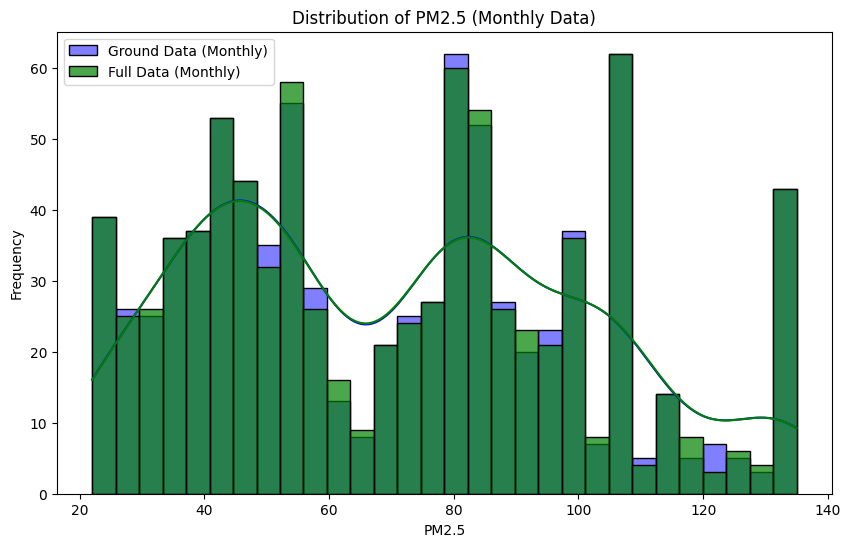

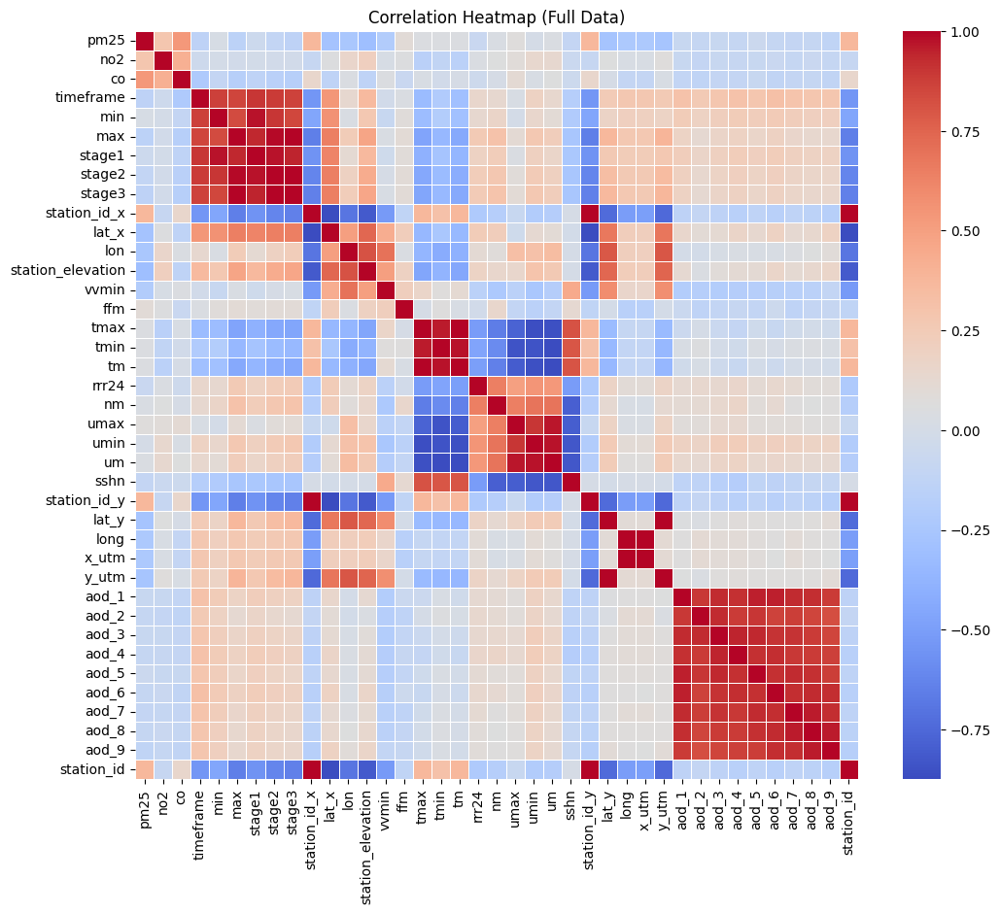

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the distribution of pm25 in both datasets
plt.figure(figsize=(10, 6))
sns.histplot(combined_ground_data_monthly['pm25'], bins=30, kde=True, color='blue', label='Ground Data (Monthly)')
sns.histplot(full_data_combined_monthly['pm25'], bins=30, kde=True, color='green', label='Full Data (Monthly)', alpha=0.7)
plt.title('Distribution of PM2.5 (Monthly Data)')
plt.xlabel('PM2.5')
plt.ylabel('Frequency')
plt.legend()
plt.show()

# Compute and visualize the correlation matrix for the full dataset
correlation_matrix = full_data_combined_monthly.drop(['date', 'station_name'],axis=1).corr()

# Plot the heatmap of the correlation matrix
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap (Full Data)')
plt.show()

The visualizations provide insights into the data:

PM2.5 Distribution: The distribution of pm25 shows that the values are spread across a wide range, with some higher concentrations. Both the ground and full datasets have similar distributions, but further analysis is needed to understand if the satellite data contributes to better predictions of high concentrations.

Correlation Heatmap: The heatmap reveals relationships between various features in the full dataset. Notable correlations can be explored further, especially focusing on how satellite data (AOD values) correlates with the target variable pm25.

Next Steps:
Investigate Feature Correlations: We should examine which features, including the AOD values and meteorological data, are most correlated with pm25.
Station-Based Analysis: As you mentioned the need for station-specific analysis, we can explore how the data behaves across different stations.

In [ ]:
# Investigate correlations between features and the target variable pm25
pm25_correlations = correlation_matrix['pm25'].sort_values(ascending=False)

# Display the top 10 positive and negative correlations with pm25
top_positive_correlations = pm25_correlations.head(10)
top_negative_correlations = pm25_correlations.tail(10)

top_positive_correlations, top_negative_correlations

(pm25            1.000000
 co              0.535915
 station_id_x    0.373326
 station_id_y    0.373326
 station_id      0.373326
 no2             0.283905
 ffm             0.097640
 umax            0.073052
 tmin            0.048412
 tm              0.046098
 Name: pm25, dtype: float64,
 timeframe           -0.140521
 max                 -0.146654
 vvmin               -0.203808
 x_utm               -0.232267
 long                -0.233195
 lon                 -0.248273
 y_utm               -0.262733
 lat_y               -0.268513
 lat_x               -0.278854
 station_elevation   -0.307384
 Name: pm25, dtype: float64)

Here are the top correlations with the target variable pm25:

Top Positive Correlations:
CO (0.54) – Carbon monoxide levels have a moderate positive correlation with pm25, indicating some relationship between these pollutants.
Station IDs (0.37) – The station_id (x, y, and station_id) has a moderate positive correlation, suggesting station-specific effects on air quality measurements.
NO2 (0.28) – Nitrogen dioxide also has a moderate correlation, which is expected as it is another common air pollutant.
FFM (0.10) – This meteorological feature shows a mild correlation.
Top Negative Correlations:
Station Elevation (-0.31) – Higher station elevations are associated with lower pm25 levels, which may reflect better air quality at higher altitudes.
Latitude and Longitude (-0.27 to -0.25) – Geographic coordinates show a mild negative correlation, possibly indicating spatial patterns in air pollution.
UTM Coordinates (-0.26 to -0.23) – Similar to latitude/longitude, the UTM coordinates show spatial correlations.
VVmin (-0.20) – A meteorological feature (possibly wind speed) has a mild negative correlation.
Interestingly, the satellite-derived AOD values did not show strong direct correlations with pm25 in this summary. This could suggest a more complex relationship that may require further modeling.

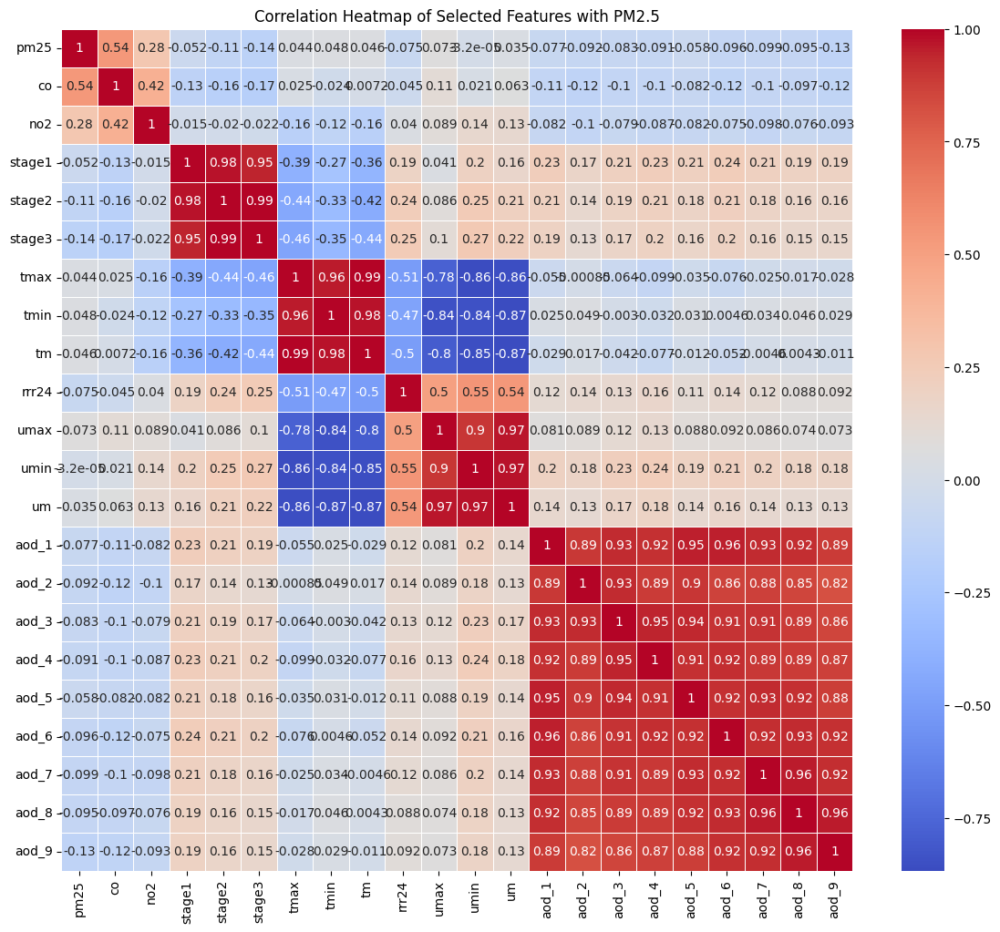

(103.17565788918992,
 co              0.598071
 no2             0.109033
 lat_x           0.056496
 vvmin           0.028371
 long            0.022631
 ffm             0.021290
 x_utm           0.017291
 station_id      0.011604
 station_id_y    0.010399
 station_id_x    0.008879
 dtype: float64)

In [ ]:
# Focus on visualizing key correlations with pm25, especially for meteorological and AOD features

# Select features of interest for deeper correlation analysis (meteorology and satellite data)
selected_features = [
    'pm25', 'co', 'no2', 'stage1', 'stage2', 'stage3', 'tmax', 'tmin', 'tm',
    'rrr24', 'umax', 'umin', 'um', 'aod_1', 'aod_2', 'aod_3', 'aod_4', 'aod_5',
    'aod_6', 'aod_7', 'aod_8', 'aod_9'
]

# Compute the correlation matrix for these selected features
selected_corr_matrix = full_data_combined_monthly[selected_features].corr()

# Plot the heatmap of the correlation matrix for selected features
plt.figure(figsize=(14, 12))
sns.heatmap(selected_corr_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap of Selected Features with PM2.5')
plt.show()

# Now, moving to model training to evaluate feature importance
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error

# Define features and target
X = full_data_combined_monthly.drop(columns=['date', 'pm25', 'station_name'])
y = full_data_combined_monthly['pm25']

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a Random Forest Regressor to assess feature importance
rf_model = RandomForestRegressor(random_state=42)
rf_model.fit(X_train, y_train)

# Predict and evaluate
y_pred = rf_model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)

# Get feature importance
feature_importance = pd.Series(rf_model.feature_importances_, index=X.columns).sort_values(ascending=False)

mse, feature_importance.head(10)

Correlation Analysis:
The heatmap revealed several insights into how meteorological and satellite-derived features relate to each other and to pm25. Key findings:

CO and NO2 show moderate positive correlations with pm25, confirming their relevance as air pollutants.
Meteorological variables like temperature (e.g., tmax, tmin), wind speed (e.g., umax, umin), and rainfall (rrr24) exhibit weaker correlations.
The AOD (satellite-derived Aerosol Optical Depth) values have relatively low direct correlation with pm25, suggesting that the relationship might be non-linear or complex.
Random Forest Model Results:
The Random Forest Regressor provided the following insights:

The mean squared error (MSE) of the model was approximately 103.18, indicating the model's performance in predicting pm25 on unseen data.
The most important features for predicting pm25 are:
CO (59.8%)
NO2 (10.9%)
Latitude (lat_x) (5.6%)
Minimum wind speed (vvmin) (2.8%)
Longitude (long) (2.3%)
These results suggest that CO is by far the most important predictor of pm25, followed by NO2, and geographical factors like latitude and longitude. The satellite AOD values did not rank high in importance, but they might contribute more in more complex or specialized models.

# Loading Combined Datasets

In [ ]:
import pandas as pd

# Paths to the datasets
ground_data_daily_path = '/content/drive/MyDrive/ground data/Final_Data/combined_ground_data.csv'
ground_data_monthly_path = '/content/drive/MyDrive/ground data/Final_Data/combined_ground_data_monthly.csv'
full_data_daily_path = '/content/drive/MyDrive/ground data/Final_Data/full_data_combined.csv'
full_data_monthly_path = '/content/drive/MyDrive/ground data/Final_Data/full_data_combined_monthly.csv'

# Load datasets
ground_data_daily = pd.read_csv(ground_data_daily_path)
ground_data_monthly = pd.read_csv(ground_data_monthly_path)
full_data_daily = pd.read_csv(full_data_daily_path)
full_data_monthly = pd.read_csv(full_data_monthly_path)

# 1. Ground-Only Data Processing (Daily and Monthly)
# Drop duplicates for daily data
ground_data_daily.drop_duplicates(inplace=True)

# Ground-only monthly data (already provided as ground_data_monthly)

# 2. Combined Data (Full Data with Ground and Satellite for Daily and Monthly)
# Full daily data = full_data_daily
# Full monthly data = full_data_monthly

# 3. Satellite-Only Data (Daily and Monthly)
# By subtracting ground data from full data
satellite_data_daily = full_data_daily.copy()
satellite_data_monthly = full_data_monthly.copy()

# Subtract ground features from the full dataset to isolate satellite data
# Convert sets to lists for indexing
common_columns_daily = list(set(ground_data_daily.columns).intersection(full_data_daily.columns))
common_columns_monthly = list(set(ground_data_monthly.columns).intersection(full_data_monthly.columns))

# Filter only numeric columns for the subtraction
numeric_columns_daily = [col for col in common_columns_daily if pd.api.types.is_numeric_dtype(ground_data_daily[col])]
numeric_columns_monthly = [col for col in common_columns_monthly if pd.api.types.is_numeric_dtype(ground_data_monthly[col])]

# Subtract ground data from full data to isolate satellite data
satellite_data_daily[numeric_columns_daily] = full_data_daily[numeric_columns_daily] - ground_data_daily[numeric_columns_daily]
satellite_data_monthly[numeric_columns_monthly] = full_data_monthly[numeric_columns_monthly] - ground_data_monthly[numeric_columns_monthly]



# 4. Processing Time Series (Lag, Rolling, Date Features)
def process_time_series(data, date_col='date', lag_features=[], rolling_features=[], window_sizes=[3, 6]):
    # Convert 'date' to datetime
    data[date_col] = pd.to_datetime(data[date_col])

    # Sort by date and set date as index
    data.sort_values(by=date_col, inplace=True)
    data.set_index(date_col, inplace=True)

    # Create lag features
    for col in lag_features:
        for lag in [1, 2, 3]:  # You can adjust the lag periods
            data[f'{col}_lag_{lag}'] = data[col].shift(lag)

    # Create rolling features
    for col in rolling_features:
        for window in window_sizes:
            data[f'{col}_rolling_mean_{window}'] = data[col].rolling(window=window).mean()
            data[f'{col}_rolling_std_{window}'] = data[col].rolling(window=window).std()

    # Create date-related features
    data['month'] = data.index.month
    data['season'] = data.index.month % 12 // 3 + 1  # 1: Winter, 2: Spring, 3: Summer, 4: Autumn

    # Drop any rows with NaNs (resulting from lag/rolling operations)
    data.dropna(inplace=True)

    return data

# Define columns for lag and rolling features (example: 'pm25', 'co', 'no2', etc.)
lag_columns = ['pm25', 'co', 'no2']
rolling_columns = ['pm25', 'co', 'no2']

# Apply the time series processing to all datasets (daily and monthly)
processed_ground_daily = process_time_series(ground_data_daily, lag_features=lag_columns, rolling_features=rolling_columns)
processed_ground_monthly = process_time_series(ground_data_monthly, lag_features=lag_columns, rolling_features=rolling_columns)
processed_full_daily = process_time_series(full_data_daily, lag_features=lag_columns, rolling_features=rolling_columns)
processed_full_monthly = process_time_series(full_data_monthly, lag_features=lag_columns, rolling_features=rolling_columns)
processed_satellite_daily = process_time_series(satellite_data_daily, lag_features=lag_columns, rolling_features=rolling_columns)
processed_satellite_monthly = process_time_series(satellite_data_monthly, lag_features=lag_columns, rolling_features=rolling_columns)

# 5. Save the processed datasets to CSV
processed_ground_daily.to_csv('/content/drive/MyDrive/processed_ground_data_daily.csv', index=True)
processed_ground_monthly.to_csv('/content/drive/MyDrive/processed_ground_data_monthly.csv', index=True)
processed_full_daily.to_csv('/content/drive/MyDrive/processed_full_data_daily.csv', index=True)
processed_full_monthly.to_csv('/content/drive/MyDrive/processed_full_data_monthly.csv', index=True)
processed_satellite_daily.to_csv('/content/drive/MyDrive/processed_satellite_data_daily.csv', index=True)
processed_satellite_monthly.to_csv('/content/drive/MyDrive/processed_satellite_data_monthly.csv', index=True)

# Machine Learning (Sarima/Arima)

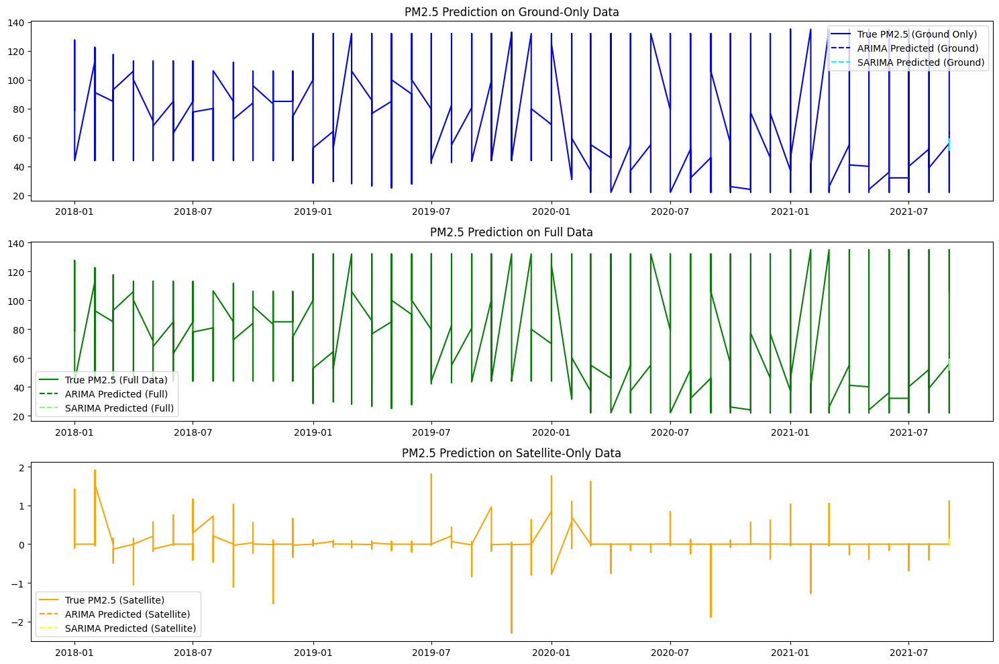

In [ ]:
import pandas as pd
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.statespace.sarimax import SARIMAX
import matplotlib.pyplot as plt

# Load the processed monthly datasets and ensure the date index has a frequency
processed_ground_monthly = pd.read_csv('/content/drive/MyDrive/processed_ground_data_monthly.csv', index_col='date', parse_dates=True)
processed_full_monthly = pd.read_csv('/content/drive/MyDrive/processed_full_data_monthly.csv', index_col='date', parse_dates=True)
processed_satellite_monthly = pd.read_csv('/content/drive/MyDrive/processed_satellite_data_monthly.csv', index_col='date', parse_dates=True)

# Set the frequency to Month Start ('MS') for the date index
processed_ground_monthly.index = processed_ground_monthly.index.to_period('M')
processed_full_monthly.index = processed_full_monthly.index.to_period('M')
processed_satellite_monthly.index = processed_satellite_monthly.index.to_period('M')

# Extract the 'pm25' column for each dataset
pm25_ground = processed_ground_monthly['pm25']
pm25_full = processed_full_monthly['pm25']
pm25_satellite = processed_satellite_monthly['pm25']

# Fit ARIMA models
def fit_arima_model(data, order=(5, 1, 0), steps=12):
    model = ARIMA(data, order=order)
    model_fit = model.fit()
    forecast = model_fit.forecast(steps=steps)
    return forecast, model_fit

# Fit SARIMA models
def fit_sarima_model(data, order=(1, 1, 1), seasonal_order=(1, 1, 1, 12), steps=12):
    model = SARIMAX(data, order=order, seasonal_order=seasonal_order)
    model_fit = model.fit()
    forecast = model_fit.forecast(steps=steps)
    return forecast, model_fit

# ARIMA models for each dataset
forecast_ground, model_ground = fit_arima_model(pm25_ground)
forecast_full, model_full = fit_arima_model(pm25_full)
forecast_satellite, model_satellite = fit_arima_model(pm25_satellite)

# SARIMA models for each dataset
sarima_forecast_ground, sarima_model_ground = fit_sarima_model(pm25_ground)
sarima_forecast_full, sarima_model_full = fit_sarima_model(pm25_full)
sarima_forecast_satellite, sarima_model_satellite = fit_sarima_model(pm25_satellite)

# Plotting ARIMA and SARIMA results
plt.figure(figsize=(15, 10))

# ARIMA on Ground-Only Data
plt.subplot(3, 1, 1)
plt.plot(pm25_ground.index.to_timestamp(), pm25_ground, label="True PM2.5 (Ground Only)", color='blue')
plt.plot(pm25_ground.index.to_timestamp()[-len(forecast_ground):], forecast_ground, label="ARIMA Predicted (Ground)", linestyle='--', color='blue')
plt.plot(pm25_ground.index.to_timestamp()[-len(sarima_forecast_ground):], sarima_forecast_ground, label="SARIMA Predicted (Ground)", linestyle='--', color='cyan')
plt.title('PM2.5 Prediction on Ground-Only Data')
plt.legend()

# ARIMA on Full Data
plt.subplot(3, 1, 2)
plt.plot(pm25_full.index.to_timestamp(), pm25_full, label="True PM2.5 (Full Data)", color='green')
plt.plot(pm25_full.index.to_timestamp()[-len(forecast_full):], forecast_full, label="ARIMA Predicted (Full)", linestyle='--', color='green')
plt.plot(pm25_full.index.to_timestamp()[-len(sarima_forecast_full):], sarima_forecast_full, label="SARIMA Predicted (Full)", linestyle='--', color='lightgreen')
plt.title('PM2.5 Prediction on Full Data')
plt.legend()

# ARIMA on Satellite Data
plt.subplot(3, 1, 3)
plt.plot(pm25_satellite.index.to_timestamp(), pm25_satellite, label="True PM2.5 (Satellite)", color='orange')
plt.plot(pm25_satellite.index.to_timestamp()[-len(forecast_satellite):], forecast_satellite, label="ARIMA Predicted (Satellite)", linestyle='--', color='orange')
plt.plot(pm25_satellite.index.to_timestamp()[-len(sarima_forecast_satellite):], sarima_forecast_satellite, label="SARIMA Predicted (Satellite)", linestyle='--', color='yellow')
plt.title('PM2.5 Prediction on Satellite-Only Data')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

# Define a function to calculate performance metrics
def calculate_metrics(true_values, predicted_values):
    mae = mean_absolute_error(true_values, predicted_values)
    mse = mean_squared_error(true_values, predicted_values)
    rmse = np.sqrt(mse)
    return mae, mse, rmse

# Calculate metrics for ARIMA models
mae_ground_arima, mse_ground_arima, rmse_ground_arima = calculate_metrics(pm25_ground[-len(forecast_ground):], forecast_ground)
mae_full_arima, mse_full_arima, rmse_full_arima = calculate_metrics(pm25_full[-len(forecast_full):], forecast_full)
mae_satellite_arima, mse_satellite_arima, rmse_satellite_arima = calculate_metrics(pm25_satellite[-len(forecast_satellite):], forecast_satellite)

# Calculate metrics for SARIMA models
mae_ground_sarima, mse_ground_sarima, rmse_ground_sarima = calculate_metrics(pm25_ground[-len(sarima_forecast_ground):], sarima_forecast_ground)
mae_full_sarima, mse_full_sarima, rmse_full_sarima = calculate_metrics(pm25_full[-len(sarima_forecast_full):], sarima_forecast_full)
mae_satellite_sarima, mse_satellite_sarima, rmse_satellite_sarima = calculate_metrics(pm25_satellite[-len(sarima_forecast_satellite):], sarima_forecast_satellite)

# Create a comparison dataframe
metrics_df = pd.DataFrame({
    'Model': ['ARIMA_Ground', 'ARIMA_Full', 'ARIMA_Satellite',
              'SARIMA_Ground', 'SARIMA_Full', 'SARIMA_Satellite'],
    'MAE': [mae_ground_arima, mae_full_arima, mae_satellite_arima,
            mae_ground_sarima, mae_full_sarima, mae_satellite_sarima],
    'MSE': [mse_ground_arima, mse_full_arima, mse_satellite_arima,
            mse_ground_sarima, mse_full_sarima, mse_satellite_sarima],
    'RMSE': [rmse_ground_arima, rmse_full_arima, rmse_satellite_arima,
             rmse_ground_sarima, rmse_full_sarima, rmse_satellite_sarima]
})

# Print the comparison table
print(metrics_df)

# Find the best model based on RMSE (lower is better)
best_model_idx = metrics_df['RMSE'].idxmin()
best_model_metrics = metrics_df.iloc[best_model_idx]

print("\nBest Model Based on RMSE:")
print(best_model_metrics)

              Model        MAE         MSE       RMSE
0      ARIMA_Ground  18.732147  539.912492  23.236017
1        ARIMA_Full  18.820780  539.988419  23.237651
2   ARIMA_Satellite   0.093068    0.103453   0.321641
3     SARIMA_Ground  19.560002  526.039125  22.935543
4       SARIMA_Full  19.668108  529.396415  23.008616
5  SARIMA_Satellite   0.147694    0.103944   0.322404

Best Model Based on RMSE:
Model    ARIMA_Satellite
MAE             0.093068
MSE             0.103453
RMSE            0.321641
Name: 2, dtype: object


In [ ]:
# Load the processed daily datasets and ensure the date index has a frequency
processed_ground_daily = pd.read_csv('/content/drive/MyDrive/processed_ground_data_daily.csv', index_col='date', parse_dates=True)
processed_full_daily = pd.read_csv('/content/drive/MyDrive/processed_full_data_daily.csv', index_col='date', parse_dates=True)
processed_satellite_daily = pd.read_csv('/content/drive/MyDrive/processed_satellite_data_daily.csv', index_col='date', parse_dates=True)

# Set the frequency to Day Start ('D') for the date index
processed_ground_daily.index = processed_ground_daily.index.to_period('D')
processed_full_daily.index = processed_full_daily.index.to_period('D')
processed_satellite_daily.index = processed_satellite_daily.index.to_period('D')

# Extract the 'pm25' column for each dataset
pm25_ground_daily = processed_ground_daily['pm25']
pm25_full_daily = processed_full_daily['pm25']
pm25_satellite_daily = processed_satellite_daily['pm25']

# Define ARIMA and SARIMA functions
def fit_arima_model(data, order=(5, 1, 0), steps=7):  # Forecasting 7 days ahead
    model = ARIMA(data, order=order)
    model_fit = model.fit()
    forecast = model_fit.forecast(steps=steps)
    return forecast, model_fit

def fit_sarima_model(data, order=(1, 1, 1), seasonal_order=(1, 1, 1, 7), steps=7):  # Weekly seasonality assumed
    model = SARIMAX(data, order=order, seasonal_order=seasonal_order)
    model_fit = model.fit()
    forecast = model_fit.forecast(steps=steps)
    return forecast, model_fit

# Fit ARIMA models for daily data
forecast_ground_daily_arima, model_ground_daily_arima = fit_arima_model(pm25_ground_daily)
forecast_full_daily_arima, model_full_daily_arima = fit_arima_model(pm25_full_daily)
forecast_satellite_daily_arima, model_satellite_daily_arima = fit_arima_model(pm25_satellite_daily)

# Fit SARIMA models for daily data
forecast_ground_daily_sarima, model_ground_daily_sarima = fit_sarima_model(pm25_ground_daily)
forecast_full_daily_sarima, model_full_daily_sarima = fit_sarima_model(pm25_full_daily)
forecast_satellite_daily_sarima, model_satellite_daily_sarima = fit_sarima_model(pm25_satellite_daily)

# Calculate performance metrics for ARIMA models on daily data
mae_ground_daily_arima, mse_ground_daily_arima, rmse_ground_daily_arima = calculate_metrics(pm25_ground_daily[-len(forecast_ground_daily_arima):], forecast_ground_daily_arima)
mae_full_daily_arima, mse_full_daily_arima, rmse_full_daily_arima = calculate_metrics(pm25_full_daily[-len(forecast_full_daily_arima):], forecast_full_daily_arima)
mae_satellite_daily_arima, mse_satellite_daily_arima, rmse_satellite_daily_arima = calculate_metrics(pm25_satellite_daily[-len(forecast_satellite_daily_arima):], forecast_satellite_daily_arima)

# Calculate performance metrics for SARIMA models on daily data
mae_ground_daily_sarima, mse_ground_daily_sarima, rmse_ground_daily_sarima = calculate_metrics(pm25_ground_daily[-len(forecast_ground_daily_sarima):], forecast_ground_daily_sarima)
mae_full_daily_sarima, mse_full_daily_sarima, rmse_full_daily_sarima = calculate_metrics(pm25_full_daily[-len(forecast_full_daily_sarima):], forecast_full_daily_sarima)
mae_satellite_daily_sarima, mse_satellite_daily_sarima, rmse_satellite_daily_sarima = calculate_metrics(pm25_satellite_daily[-len(forecast_satellite_daily_sarima):], forecast_satellite_daily_sarima)

# Create a comparison dataframe for daily data
metrics_daily_df = pd.DataFrame({
    'Model': ['ARIMA_Ground_Daily', 'ARIMA_Full_Daily', 'ARIMA_Satellite_Daily',
              'SARIMA_Ground_Daily', 'SARIMA_Full_Daily', 'SARIMA_Satellite_Daily'],
    'MAE': [mae_ground_daily_arima, mae_full_daily_arima, mae_satellite_daily_arima,
            mae_ground_daily_sarima, mae_full_daily_sarima, mae_satellite_daily_sarima],
    'MSE': [mse_ground_daily_arima, mse_full_daily_arima, mse_satellite_daily_arima,
            mse_ground_daily_sarima, mse_full_daily_sarima, mse_satellite_daily_sarima],
    'RMSE': [rmse_ground_daily_arima, rmse_full_daily_arima, rmse_satellite_daily_arima,
             rmse_ground_daily_sarima, rmse_full_daily_sarima, rmse_satellite_daily_sarima]
})

# Print the comparison table for daily data
print(metrics_daily_df)

# Find the best model based on RMSE for daily data (lower is better)
best_daily_model_idx = metrics_daily_df['RMSE'].idxmin()
best_daily_model_metrics = metrics_daily_df.iloc[best_daily_model_idx]

print("\nBest Model for Daily Data Based on RMSE:")
print(best_daily_model_metrics)


                    Model        MAE          MSE       RMSE
0      ARIMA_Ground_Daily  31.835745  1174.500099  34.270980
1        ARIMA_Full_Daily  43.266555  1883.598257  43.400441
2   ARIMA_Satellite_Daily   0.042174     0.002526   0.050256
3     SARIMA_Ground_Daily  23.659668  1035.708034  32.182418
4       SARIMA_Full_Daily  46.899645  2281.666269  47.766790
5  SARIMA_Satellite_Daily  31.635122  1081.910271  32.892404

Best Model for Daily Data Based on RMSE:
Model    ARIMA_Satellite_Daily
MAE                   0.042174
MSE                   0.002526
RMSE                  0.050256
Name: 2, dtype: object


# Deep Learning (LSTM)

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

# Check if the GPU is available
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))
if tf.config.list_physical_devices('GPU'):
    device_details = tf.config.list_physical_devices('GPU')[0]
    print(f"Device Name: {device_details.name}, Device Type: {device_details.device_type}")
else:
    print("No GPU detected. Make sure you're using GPU runtime.")

# Function to prepare the data for LSTM
def prepare_lstm_data(data, n_lags=10):
    X, y = [], []
    for i in range(n_lags, len(data)):
        X.append(data[i-n_lags:i])
        y.append(data[i])
    return np.array(X), np.array(y)

# Function to scale the data using MinMaxScaler
def scale_data(data):
    scaler = MinMaxScaler(feature_range=(0, 1))
    data_scaled = scaler.fit_transform(data)
    return data_scaled, scaler

# Function to inverse transform the scaled data
def inverse_scale(scaler, data):
    return scaler.inverse_transform(data)

# Data preprocessing for LSTM
def preprocess_lstm(df, target_column='pm25', n_lags=10):
    data = df[[target_column]].values
    data_scaled, scaler = scale_data(data)
    X, y = prepare_lstm_data(data_scaled, n_lags)
    return X, y, scaler

# Split data into train/test sets
def split_data(X, y, train_size=0.8):
    train_len = int(len(X) * train_size)
    X_train, X_test = X[:train_len], X[train_len:]
    y_train, y_test = y[:train_len], y[train_len:]
    return X_train, X_test, y_train, y_test

# Build the LSTM model
def build_lstm_model(input_shape):
    model = Sequential()

    # First LSTM layer with dropout
    model.add(LSTM(128, return_sequences=True, input_shape=input_shape))
    model.add(Dropout(0.2))

    # Second LSTM layer with dropout
    model.add(LSTM(64, return_sequences=False))
    model.add(Dropout(0.2))

    # Output layer
    model.add(Dense(1))

    model.compile(optimizer='adam', loss='mean_squared_error')
    return model

# Train the LSTM model with EarlyStopping and ReduceLROnPlateau
def train_lstm_model(model, X_train, y_train, X_test, y_test, epochs=100, batch_size=64):
    early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
    reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=0.001)

    history = model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=epochs,
                        batch_size=batch_size, callbacks=[early_stop, reduce_lr], verbose=2)
    return model, history

# Evaluate the model and calculate performance metrics
def evaluate_model(model, X_test, y_test, scaler):
    y_pred = model.predict(X_test)

    # Inverse scaling for predictions and true values
    y_pred_inverse = inverse_scale(scaler, y_pred)
    y_test_inverse = inverse_scale(scaler, y_test.reshape(-1, 1))

    # Calculate metrics
    mae = mean_absolute_error(y_test_inverse, y_pred_inverse)
    mse = mean_squared_error(y_test_inverse, y_pred_inverse)
    rmse = np.sqrt(mse)

    return mae, mse, rmse, y_pred_inverse, y_test_inverse

# Plot training history
def plot_training_history(history):
    plt.figure(figsize=(12, 6))
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

# Plot predictions vs actual values
def plot_predictions(y_test_inverse, y_pred_inverse, title="Predicted vs True Values"):
    plt.figure(figsize=(12, 6))
    plt.plot(y_test_inverse, label='True Values')
    plt.plot(y_pred_inverse, label='Predicted Values')
    plt.title(title)
    plt.xlabel('Time')
    plt.ylabel('PM2.5 Value')
    plt.legend()
    plt.show()

# LSTM process function for each dataset
def lstm_process(df, target_column='pm25', n_lags=10):
    # Preprocess data
    X, y, scaler = preprocess_lstm(df, target_column=target_column, n_lags=n_lags)
    X_train, X_test, y_train, y_test = split_data(X, y)

    # Build and train the model
    input_shape = (X_train.shape[1], X_train.shape[2])
    model = build_lstm_model(input_shape)
    model, history = train_lstm_model(model, X_train, y_train, X_test, y_test)

    # Evaluate the model
    mae, mse, rmse, y_pred_inverse, y_test_inverse = evaluate_model(model, X_test, y_test, scaler)

    # Plot training history and predictions
    plot_training_history(history)
    plot_predictions(y_test_inverse, y_pred_inverse)

    return mae, mse, rmse

# Load your preprocessed data
# Use the processed datasets that have lag features already incorporated
processed_ground_daily = pd.read_csv('/content/drive/MyDrive/processed_ground_data_daily.csv')
processed_satellite_daily = pd.read_csv('/content/drive/MyDrive/processed_satellite_data_daily.csv')
processed_full_daily = pd.read_csv('/content/drive/MyDrive/processed_full_data_daily.csv')

processed_ground_monthly = pd.read_csv('/content/drive/MyDrive/processed_ground_data_monthly.csv')
processed_satellite_monthly = pd.read_csv('/content/drive/MyDrive/processed_satellite_data_monthly.csv')
processed_full_monthly = pd.read_csv('/content/drive/MyDrive/processed_full_data_monthly.csv')

Num GPUs Available:  1
Device Name: /physical_device:GPU:0, Device Type: GPU


Running LSTM for Monthly Data


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
11/11 - 5s - 445ms/step - loss: 0.1090 - val_loss: 0.1079 - learning_rate: 0.0010
Epoch 2/100
11/11 - 0s - 9ms/step - loss: 0.0664 - val_loss: 0.0995 - learning_rate: 0.0010
Epoch 3/100
11/11 - 0s - 9ms/step - loss: 0.0633 - val_loss: 0.1016 - learning_rate: 0.0010
Epoch 4/100
11/11 - 0s - 9ms/step - loss: 0.0609 - val_loss: 0.1009 - learning_rate: 0.0010
Epoch 5/100
11/11 - 0s - 9ms/step - loss: 0.0599 - val_loss: 0.1005 - learning_rate: 0.0010
Epoch 6/100
11/11 - 0s - 9ms/step - loss: 0.0597 - val_loss: 0.1006 - learning_rate: 0.0010
Epoch 7/100
11/11 - 0s - 9ms/step - loss: 0.0598 - val_loss: 0.1042 - learning_rate: 0.0010
Epoch 8/100
11/11 - 0s - 9ms/step - loss: 0.0601 - val_loss: 0.0997 - learning_rate: 0.0010
Epoch 9/100
11/11 - 0s - 9ms/step - loss: 0.0602 - val_loss: 0.1031 - learning_rate: 0.0010
Epoch 10/100
11/11 - 0s - 9ms/step - loss: 0.0589 - val_loss: 0.1028 - learning_rate: 0.0010
Epoch 11/100
11/11 - 0s - 9ms/step - loss: 0.0596 - val_loss: 0.0995 - learni

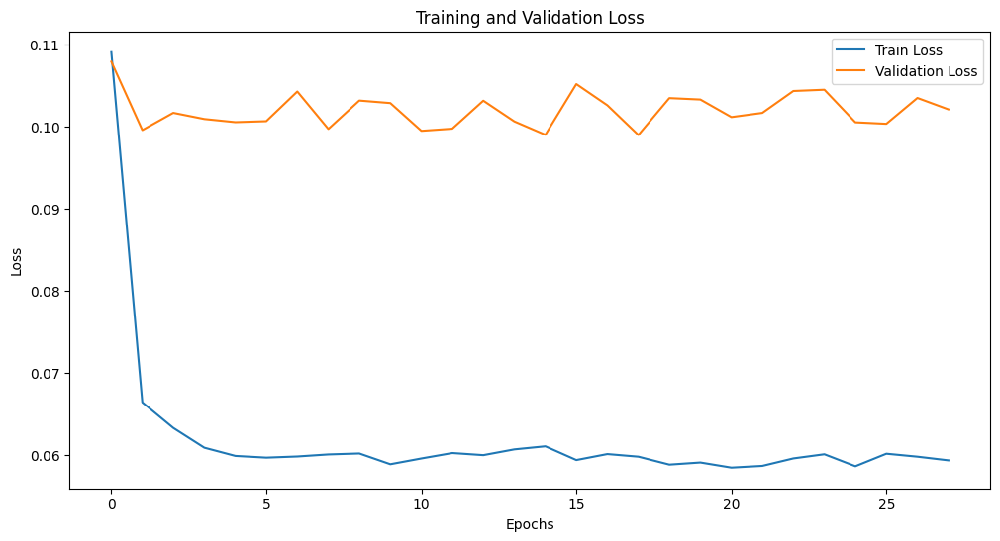

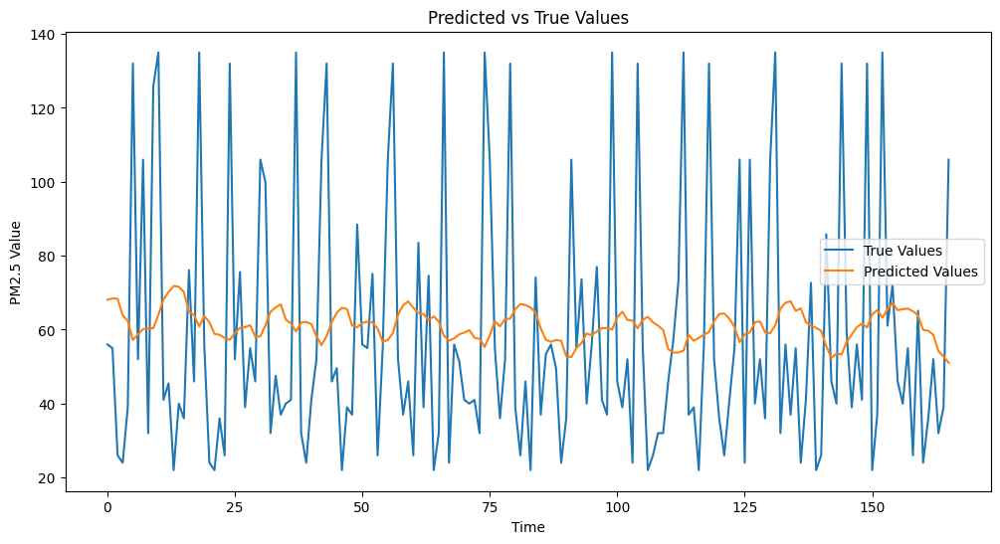

Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


11/11 - 2s - 185ms/step - loss: 0.0980 - val_loss: 0.0115 - learning_rate: 0.0010
Epoch 2/100
11/11 - 0s - 10ms/step - loss: 0.0178 - val_loss: 0.0055 - learning_rate: 0.0010
Epoch 3/100
11/11 - 0s - 10ms/step - loss: 0.0105 - val_loss: 0.0026 - learning_rate: 0.0010
Epoch 4/100
11/11 - 0s - 9ms/step - loss: 0.0099 - val_loss: 0.0023 - learning_rate: 0.0010
Epoch 5/100
11/11 - 0s - 9ms/step - loss: 0.0096 - val_loss: 0.0022 - learning_rate: 0.0010
Epoch 6/100
11/11 - 0s - 9ms/step - loss: 0.0092 - val_loss: 0.0023 - learning_rate: 0.0010
Epoch 7/100
11/11 - 0s - 10ms/step - loss: 0.0090 - val_loss: 0.0024 - learning_rate: 0.0010
Epoch 8/100
11/11 - 0s - 10ms/step - loss: 0.0083 - val_loss: 0.0022 - learning_rate: 0.0010
Epoch 9/100
11/11 - 0s - 10ms/step - loss: 0.0085 - val_loss: 0.0021 - learning_rate: 0.0010
Epoch 10/100
11/11 - 0s - 9ms/step - loss: 0.0092 - val_loss: 0.0021 - learning_rate: 0.0010
Epoch 11/100
11/11 - 0s - 10ms/step - loss: 0.0085 - val_loss: 0.0023 - learning_rat

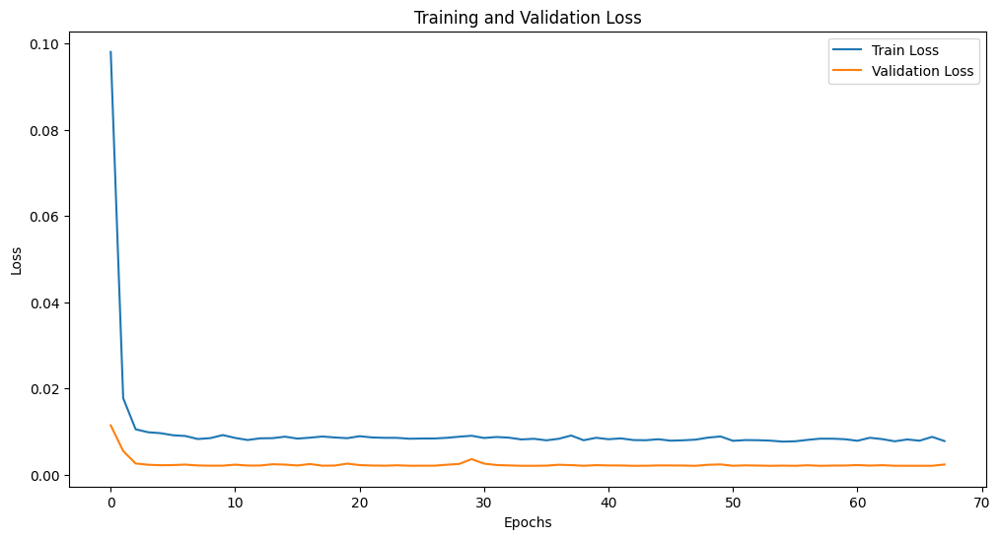

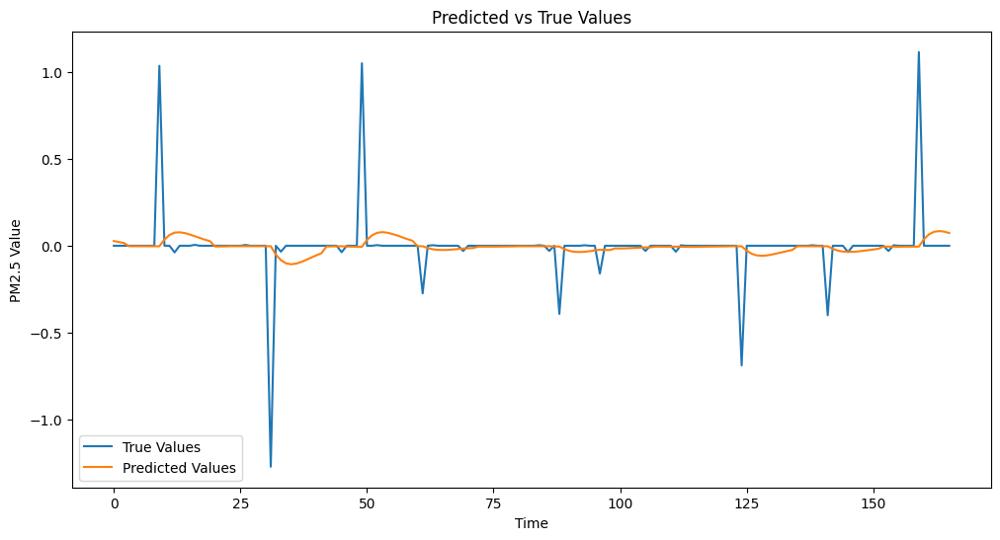

Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


11/11 - 2s - 185ms/step - loss: 0.1036 - val_loss: 0.1035 - learning_rate: 0.0010
Epoch 2/100
11/11 - 0s - 9ms/step - loss: 0.0655 - val_loss: 0.0999 - learning_rate: 0.0010
Epoch 3/100
11/11 - 0s - 9ms/step - loss: 0.0613 - val_loss: 0.1024 - learning_rate: 0.0010
Epoch 4/100
11/11 - 0s - 9ms/step - loss: 0.0613 - val_loss: 0.1012 - learning_rate: 0.0010
Epoch 5/100
11/11 - 0s - 9ms/step - loss: 0.0593 - val_loss: 0.1015 - learning_rate: 0.0010
Epoch 6/100
11/11 - 0s - 9ms/step - loss: 0.0592 - val_loss: 0.1029 - learning_rate: 0.0010
Epoch 7/100
11/11 - 0s - 9ms/step - loss: 0.0589 - val_loss: 0.1010 - learning_rate: 0.0010
Epoch 8/100
11/11 - 0s - 9ms/step - loss: 0.0601 - val_loss: 0.1012 - learning_rate: 0.0010
Epoch 9/100
11/11 - 0s - 9ms/step - loss: 0.0595 - val_loss: 0.1038 - learning_rate: 0.0010
Epoch 10/100
11/11 - 0s - 9ms/step - loss: 0.0585 - val_loss: 0.0995 - learning_rate: 0.0010
Epoch 11/100
11/11 - 0s - 9ms/step - loss: 0.0593 - val_loss: 0.1050 - learning_rate: 0.0

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


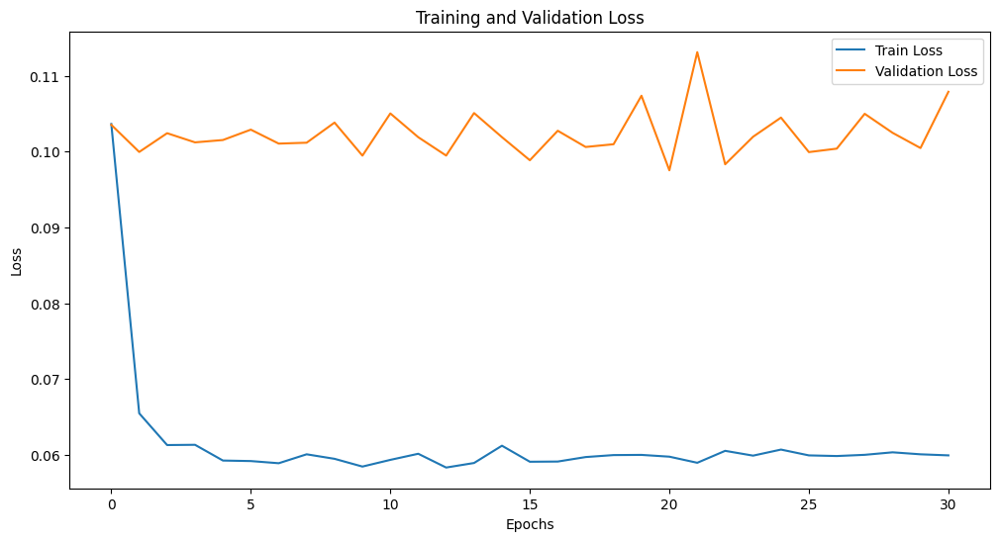

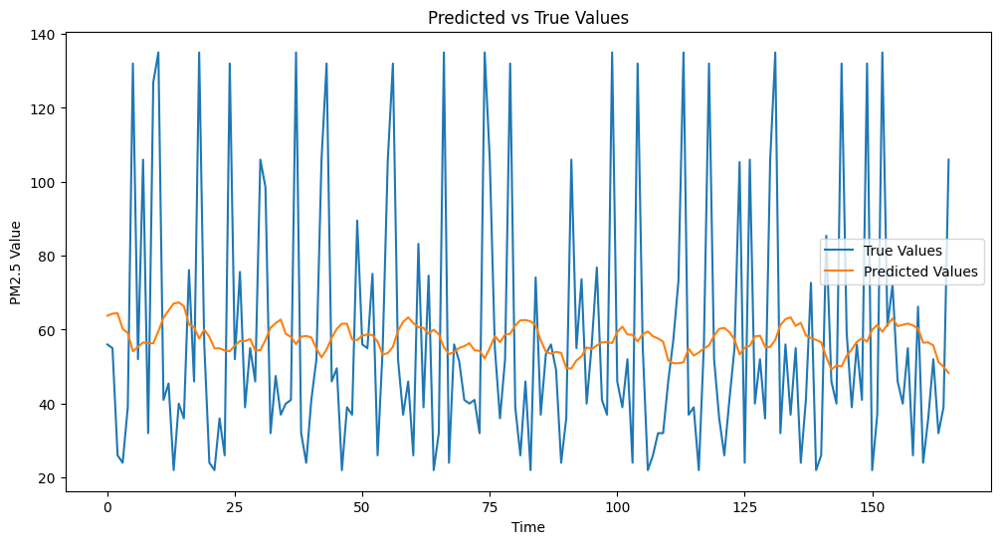

In [ ]:
# Running LSTM for Monthly Data
print("Running LSTM for Monthly Data")

# Ground-only monthly
mae_ground_monthly, mse_ground_monthly, rmse_ground_monthly = lstm_process(processed_ground_monthly, target_column='pm25', n_lags=10)

# Satellite-only monthly
mae_satellite_monthly, mse_satellite_monthly, rmse_satellite_monthly = lstm_process(processed_satellite_monthly, target_column='pm25', n_lags=10)

# Full data monthly (ground + satellite)
mae_full_monthly, mse_full_monthly, rmse_full_monthly = lstm_process(processed_full_monthly, target_column='pm25', n_lags=10)

Running LSTM for Daily Data
Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1340/1340 - 9s - 6ms/step - loss: 0.0132 - val_loss: 0.0246 - learning_rate: 0.0010
Epoch 2/100
1340/1340 - 6s - 5ms/step - loss: 0.0118 - val_loss: 0.0251 - learning_rate: 0.0010
Epoch 3/100
1340/1340 - 6s - 5ms/step - loss: 0.0115 - val_loss: 0.0248 - learning_rate: 0.0010
Epoch 4/100
1340/1340 - 6s - 5ms/step - loss: 0.0114 - val_loss: 0.0251 - learning_rate: 0.0010
Epoch 5/100
1340/1340 - 6s - 5ms/step - loss: 0.0114 - val_loss: 0.0256 - learning_rate: 0.0010
Epoch 6/100
1340/1340 - 6s - 5ms/step - loss: 0.0113 - val_loss: 0.0257 - learning_rate: 0.0010
Epoch 7/100
1340/1340 - 6s - 5ms/step - loss: 0.0113 - val_loss: 0.0257 - learning_rate: 0.0010
Epoch 8/100
1340/1340 - 6s - 5ms/step - loss: 0.0113 - val_loss: 0.0257 - learning_rate: 0.0010
Epoch 9/100
1340/1340 - 6s - 5ms/step - loss: 0.0113 - val_loss: 0.0257 - learning_rate: 0.0010
Epoch 10/100
1340/1340 - 6s - 5ms/step - loss: 0.0113 - val_loss: 0.0255 - learning_rate: 0.0010
Epoch 11/100
1340/1340 - 6s - 5ms/step - loss: 0.01

671/671 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step


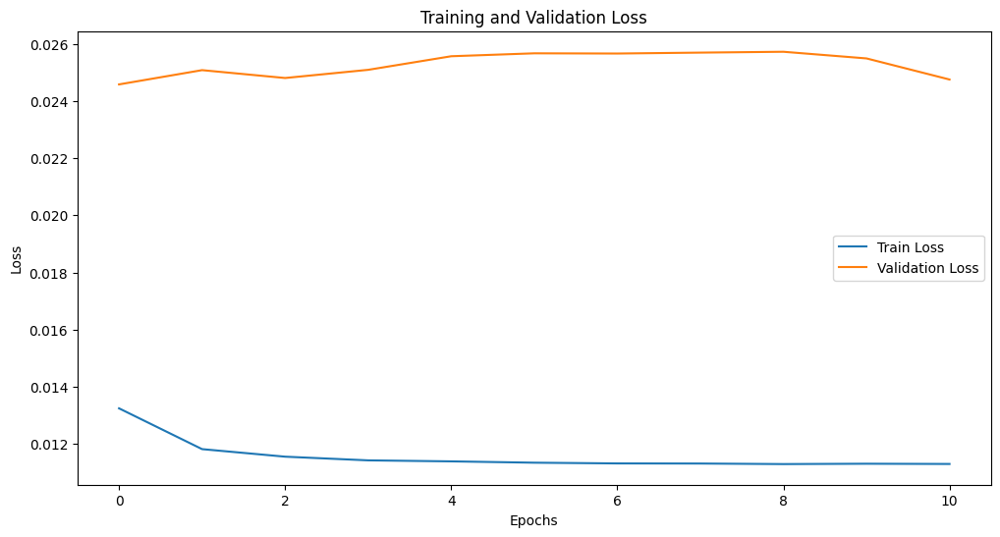

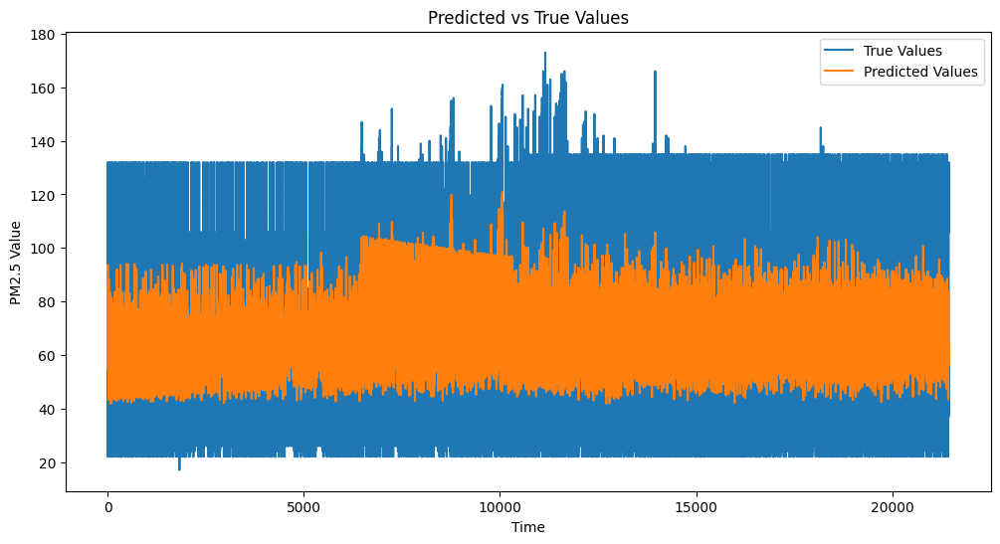

Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


441/441 - 4s - 10ms/step - loss: 0.0125 - val_loss: 0.0149 - learning_rate: 0.0010
Epoch 2/100
441/441 - 2s - 5ms/step - loss: 0.0089 - val_loss: 0.0123 - learning_rate: 0.0010
Epoch 3/100
441/441 - 2s - 5ms/step - loss: 0.0079 - val_loss: 0.0120 - learning_rate: 0.0010
Epoch 4/100
441/441 - 2s - 5ms/step - loss: 0.0077 - val_loss: 0.0113 - learning_rate: 0.0010
Epoch 5/100
441/441 - 2s - 5ms/step - loss: 0.0074 - val_loss: 0.0120 - learning_rate: 0.0010
Epoch 6/100
441/441 - 2s - 5ms/step - loss: 0.0073 - val_loss: 0.0111 - learning_rate: 0.0010
Epoch 7/100
441/441 - 2s - 5ms/step - loss: 0.0072 - val_loss: 0.0111 - learning_rate: 0.0010
Epoch 8/100
441/441 - 2s - 5ms/step - loss: 0.0071 - val_loss: 0.0110 - learning_rate: 0.0010
Epoch 9/100
441/441 - 2s - 5ms/step - loss: 0.0070 - val_loss: 0.0112 - learning_rate: 0.0010
Epoch 10/100
441/441 - 2s - 5ms/step - loss: 0.0070 - val_loss: 0.0110 - learning_rate: 0.0010
Epoch 11/100
441/441 - 2s - 5ms/step - loss: 0.0070 - val_loss: 0.0113

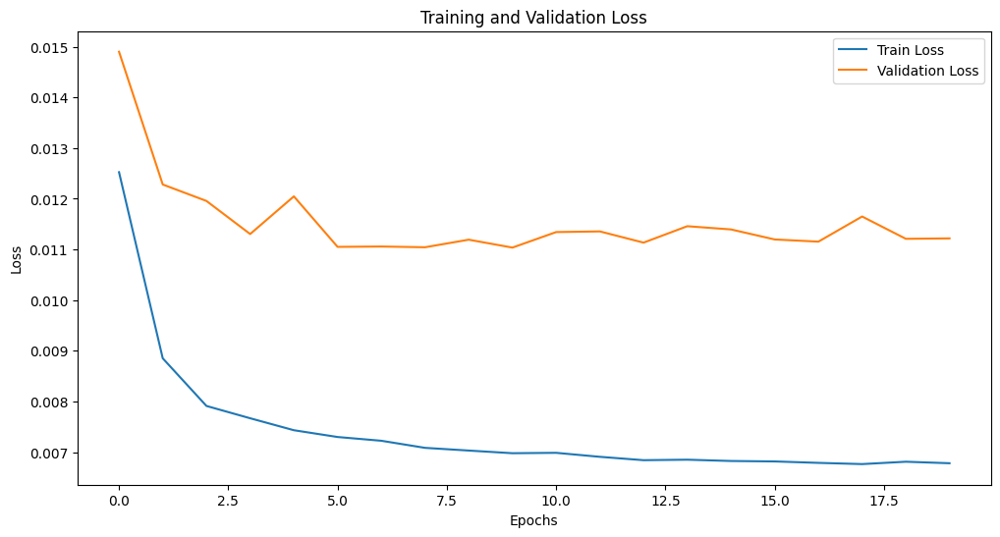

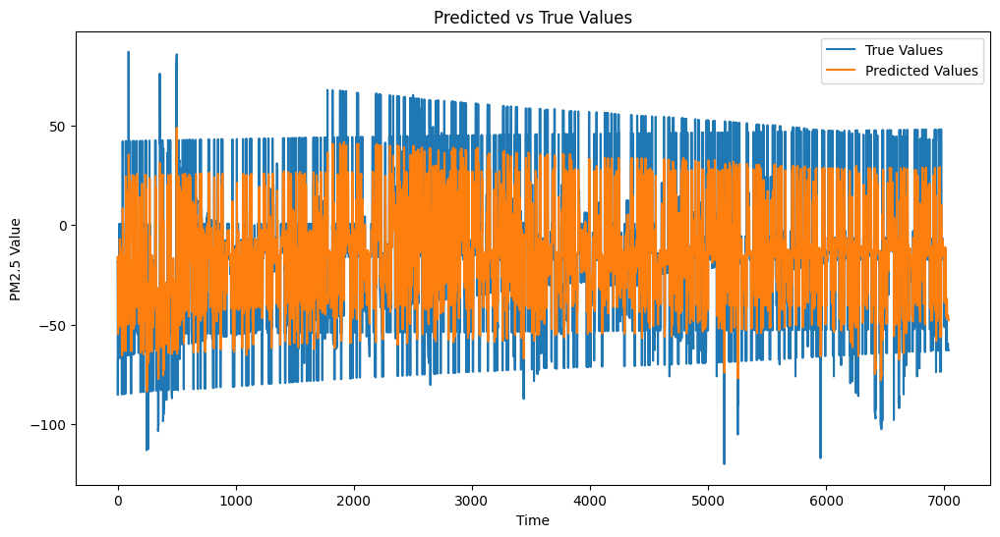

Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


3270/3270 - 19s - 6ms/step - loss: 0.0151 - val_loss: 0.0229 - learning_rate: 0.0010
Epoch 2/100
3270/3270 - 16s - 5ms/step - loss: 0.0140 - val_loss: 0.0224 - learning_rate: 0.0010
Epoch 3/100
3270/3270 - 16s - 5ms/step - loss: 0.0139 - val_loss: 0.0227 - learning_rate: 0.0010
Epoch 4/100
3270/3270 - 17s - 5ms/step - loss: 0.0139 - val_loss: 0.0226 - learning_rate: 0.0010
Epoch 5/100
3270/3270 - 17s - 5ms/step - loss: 0.0139 - val_loss: 0.0224 - learning_rate: 0.0010
Epoch 6/100
3270/3270 - 16s - 5ms/step - loss: 0.0138 - val_loss: 0.0224 - learning_rate: 0.0010
Epoch 7/100
3270/3270 - 17s - 5ms/step - loss: 0.0138 - val_loss: 0.0226 - learning_rate: 0.0010
Epoch 8/100
3270/3270 - 17s - 5ms/step - loss: 0.0138 - val_loss: 0.0233 - learning_rate: 0.0010
Epoch 9/100
3270/3270 - 17s - 5ms/step - loss: 0.0138 - val_loss: 0.0227 - learning_rate: 0.0010
Epoch 10/100
3270/3270 - 17s - 5ms/step - loss: 0.0138 - val_loss: 0.0225 - learning_rate: 0.0010
Epoch 11/100
3270/3270 - 16s - 5ms/step -

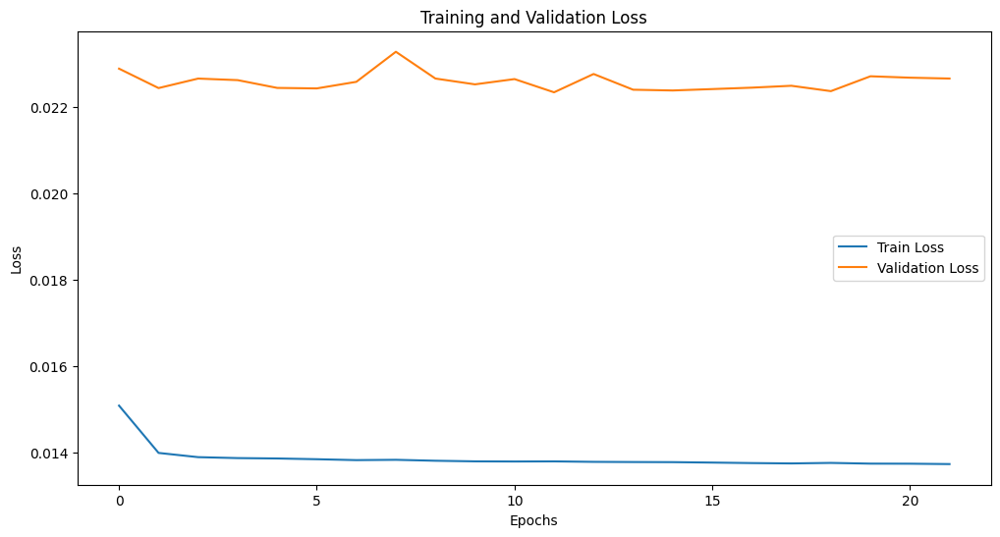

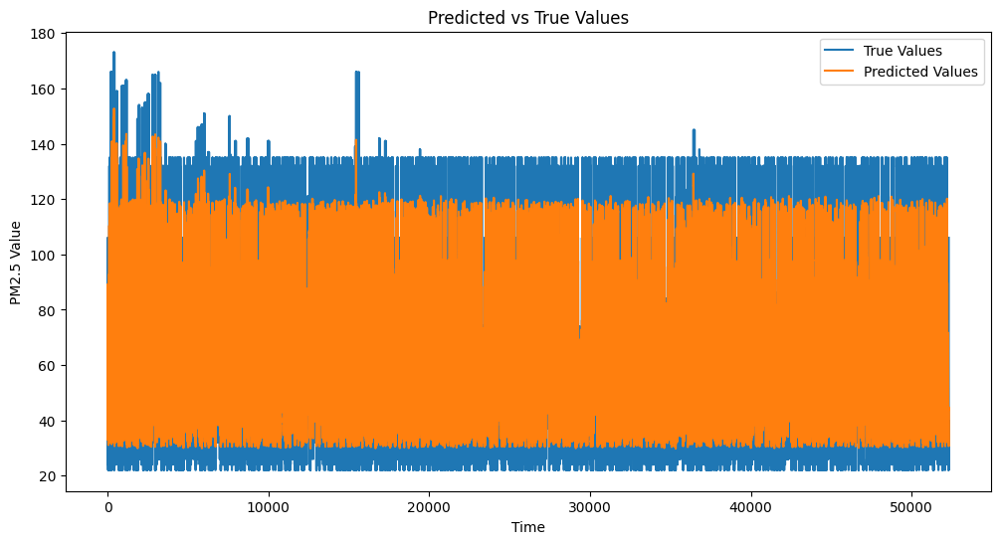

In [ ]:
# Running LSTM for Daily Data
print("Running LSTM for Daily Data")

# Ground-only daily
mae_ground_daily, mse_ground_daily, rmse_ground_daily = lstm_process(processed_ground_daily, target_column='pm25', n_lags=10)

# Satellite-only daily
mae_satellite_daily, mse_satellite_daily, rmse_satellite_daily = lstm_process(processed_satellite_daily, target_column='pm25', n_lags=10)

# Full data daily (ground + satellite)
mae_full_daily, mse_full_daily, rmse_full_daily = lstm_process(processed_full_daily, target_column='pm25', n_lags=10)

In [ ]:
# Create comparison tables for daily and monthly data
metrics_daily_df = pd.DataFrame({
    'Model': ['LSTM_Ground_Daily', 'LSTM_Satellite_Daily', 'LSTM_Full_Daily'],
    'MAE': [mae_ground_daily, mae_satellite_daily, mae_full_daily],
    'MSE': [mse_ground_daily, mse_satellite_daily, mse_full_daily],
    'RMSE': [rmse_ground_daily, rmse_satellite_daily, rmse_full_daily]
})

metrics_monthly_df = pd.DataFrame({
    'Model': ['LSTM_Ground_Monthly', 'LSTM_Satellite_Monthly', 'LSTM_Full_Monthly'],
    'MAE': [mae_ground_monthly, mae_satellite_monthly, mae_full_monthly],
    'MSE': [mse_ground_monthly, mse_satellite_monthly, mse_full_monthly],
    'RMSE': [rmse_ground_monthly, rmse_satellite_monthly, rmse_full_monthly]
})

# Print the results for daily and monthly data
print("\nDaily Data Metrics:")
print(metrics_daily_df)

print("\nMonthly Data Metrics:")
print(metrics_monthly_df)

# Find the best daily and monthly models based on RMSE
best_model_daily_idx = metrics_daily_df['RMSE'].idxmin()
best_model_monthly_idx = metrics_monthly_df['RMSE'].idxmin()

best_model_daily = metrics_daily_df.iloc[best_model_daily_idx]
best_model_monthly = metrics_monthly_df.iloc[best_model_monthly_idx]

print("\nBest LSTM Model for Daily Data Based on RMSE:")
print(best_model_daily)

print("\nBest LSTM Model for Monthly Data Based on RMSE:")
print(best_model_monthly)


Daily Data Metrics:
                  Model        MAE         MSE       RMSE
0     LSTM_Ground_Daily  21.192913  796.653459  28.225050
1  LSTM_Satellite_Daily  20.787156  914.862377  30.246692
2       LSTM_Full_Daily  17.295165  723.908979  26.905557

Monthly Data Metrics:
                    Model        MAE          MSE       RMSE
0     LSTM_Ground_Monthly  28.911985  1263.474809  35.545391
1  LSTM_Satellite_Monthly   0.062553     0.036973   0.192283
2       LSTM_Full_Monthly  27.291569  1245.284822  35.288593

Best LSTM Model for Daily Data Based on RMSE:
Model    LSTM_Full_Daily
MAE            17.295165
MSE           723.908979
RMSE           26.905557
Name: 2, dtype: object

Best LSTM Model for Monthly Data Based on RMSE:
Model    LSTM_Satellite_Monthly
MAE                    0.062553
MSE                    0.036973
RMSE                   0.192283
Name: 1, dtype: object


# NEW PART OF PROJECT

# Data Pepration for each scenario

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
# Paths to the datasets
full_data_daily_data = pd.read_csv('/content/drive/MyDrive/ground data/Final_Data/full_data_combined.csv')
full_data_monthly_data = pd.read_csv('/content/drive/MyDrive/ground data/Final_Data/full_data_combined_monthly.csv')

full_data_daily_df = pd.DataFrame(full_data_daily_data)
full_data_monthly_df = pd.DataFrame(full_data_monthly_data)

In [ ]:
full_data_daily_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 261568 entries, 0 to 261567
Data columns (total 42 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   date               261568 non-null  object 
 1   pm25               261568 non-null  float64
 2   no2                261568 non-null  float64
 3   co                 261568 non-null  float64
 4   timeframe          261568 non-null  float64
 5   min                261568 non-null  float64
 6   max                261568 non-null  float64
 7   stage1             261568 non-null  float64
 8   stage2             261568 non-null  float64
 9   stage3             261568 non-null  float64
 10  station_id_x       261568 non-null  float64
 11  station_name       261568 non-null  object 
 12  lat_x              261568 non-null  float64
 13  lon                261568 non-null  float64
 14  station_elevation  261568 non-null  float64
 15  vvmin              261568 non-null  float64
 16  ff

Here we define what columns we need in each scenario in a Dictionary

In [ ]:
# Defining the columns required for each scenario
scenario_columns = {
    "scenario_1": ["station_id", "date", "lat_x", "long", "x_utm", "y_utm",
                   "aod_1", "aod_2", "aod_3", "aod_4", "aod_5",
                   "aod_6", "aod_7", "aod_8", "aod_9", "pm25"],
    "scenario_2": ["station_id", "date", "vvmin", "ffm", "tm", "rrr24", "um", "sshn", "pm25"],
    "scenario_3": ["station_id", "date", "vvmin", "ffm", "tm", "rrr24", "um", "sshn", "nm", "pm25"],
    "scenario_4": ["station_id", "date", "vvmin", "ffm", "tm", "rrr24", "um", "sshn",
                   "timeframe", "min", "max", "stage1", "stage2", "stage3", "pm25"],
    "scenario_5": ["station_id", "date", "vvmin", "ffm", "tm", "rrr24", "um", "sshn", "nm",
                   "timeframe", "min", "max", "stage1", "stage2", "stage3", "pm25"]
}

In [ ]:
# Creating separate DataFrames for each scenario for both daily and monthly data
scenario_daily_dataframes = {f"{scenario}_daily_df": full_data_daily_df[columns]
                             for scenario, columns in scenario_columns.items()}
scenario_monthly_dataframes = {f"{scenario}_monthly_df": full_data_monthly_df[columns]
                               for scenario, columns in scenario_columns.items()}

In [ ]:
scenario1_daily_df = scenario_daily_dataframes["scenario_1_daily_df"]
scenario1_monthly_df = scenario_monthly_dataframes["scenario_1_monthly_df"]

In [ ]:
scenario2_daily_df = scenario_daily_dataframes["scenario_2_daily_df"]
scenario2_monthly_df = scenario_monthly_dataframes["scenario_2_monthly_df"]

In [ ]:
scenario3_daily_df = scenario_daily_dataframes["scenario_3_daily_df"]
scenario3_monthly_df = scenario_monthly_dataframes["scenario_3_monthly_df"]

In [ ]:
scenario4_daily_df = scenario_daily_dataframes["scenario_4_daily_df"]
scenario4_monthly_df = scenario_monthly_dataframes["scenario_4_monthly_df"]

In [ ]:
scenario5_daily_df = scenario_daily_dataframes["scenario_5_daily_df"]
scenario5_monthly_df = scenario_monthly_dataframes["scenario_5_monthly_df"]

In [ ]:
# Confirming the shapes
for scenario, df in {**scenario_daily_dataframes, **scenario_monthly_dataframes}.items():
    print(f"{scenario}: {df.shape}")

scenario_1_daily_df: (261568, 16)
scenario_2_daily_df: (261568, 9)
scenario_3_daily_df: (261568, 10)
scenario_4_daily_df: (261568, 15)
scenario_5_daily_df: (261568, 16)
scenario_1_monthly_df: (845, 16)
scenario_2_monthly_df: (845, 9)
scenario_3_monthly_df: (845, 10)
scenario_4_monthly_df: (845, 15)
scenario_5_monthly_df: (845, 16)


Now Lets save them as CSV files so we can access them Later

In [ ]:
# Defining the output path for saving scenario CSV files
output_path = "/content/drive/MyDrive/ground data/scenarios_data"

In [ ]:
# Ensure the directory exists
import os
os.makedirs(output_path, exist_ok=True)

# Saving daily and monthly scenario DataFrames as CSVs
for scenario, df in {**scenario_daily_dataframes, **scenario_monthly_dataframes}.items():
    csv_path = os.path.join(output_path, f"{scenario}.csv")
    df.to_csv(csv_path, index=False)
    print(f"Saved: {csv_path}")

Saved: /content/drive/MyDrive/ground data/scenarios_data/scenario_1_daily_df.csv
Saved: /content/drive/MyDrive/ground data/scenarios_data/scenario_2_daily_df.csv
Saved: /content/drive/MyDrive/ground data/scenarios_data/scenario_3_daily_df.csv
Saved: /content/drive/MyDrive/ground data/scenarios_data/scenario_4_daily_df.csv
Saved: /content/drive/MyDrive/ground data/scenarios_data/scenario_5_daily_df.csv
Saved: /content/drive/MyDrive/ground data/scenarios_data/scenario_1_monthly_df.csv
Saved: /content/drive/MyDrive/ground data/scenarios_data/scenario_2_monthly_df.csv
Saved: /content/drive/MyDrive/ground data/scenarios_data/scenario_3_monthly_df.csv
Saved: /content/drive/MyDrive/ground data/scenarios_data/scenario_4_monthly_df.csv
Saved: /content/drive/MyDrive/ground data/scenarios_data/scenario_5_monthly_df.csv


# **First Scenario**

# First Scenario Data Analyze

Here we test to see how the AOD data could handle the process of prediction, with that we will be able to set a good baseline for other test we want to have with our data

In [ ]:
print(scenario1_daily_df.head())

   station_id        date  lat_x       long          x_utm         y_utm  \
0           1  2018-01-01  35.75  51.484493  543991.614039  3.961272e+06   
1           1  2018-01-01  35.75  51.484493  543991.614039  3.961272e+06   
2           1  2018-01-01  35.75  51.484493  543991.614039  3.961272e+06   
3           1  2018-01-01  35.75  51.484493  543991.614039  3.961272e+06   
4           1  2018-01-01  35.75  51.484493  543991.614039  3.961272e+06   

      aod_1     aod_2     aod_3     aod_4     aod_5     aod_6     aod_7  \
0  0.145857  0.158346  0.158346  0.157065  0.154708  0.133379  0.143129   
1  0.176114  0.171529  0.171529  0.173543  0.173563  0.168235  0.179000   
2  0.145857  0.158346  0.158346  0.157065  0.154708  0.133379  0.143129   
3  0.176114  0.171529  0.171529  0.173543  0.173563  0.168235  0.179000   
4  0.145857  0.158346  0.158346  0.157065  0.154708  0.133379  0.143129   

      aod_8     aod_9  pm25  
0  0.137310  0.137310  85.0  
1  0.185229  0.185229  85.0  
2 

In [ ]:
print(scenario1_monthly_df.head())

   station_id        date  lat_x       long          x_utm         y_utm  \
0           1  2018-01-01  35.75  51.484493  543991.614039  3.961272e+06   
1           1  2018-02-01  35.75  51.484493  543991.614039  3.961272e+06   
2           1  2018-03-01  35.75  51.484493  543991.614039  3.961272e+06   
3           1  2018-04-01  35.75  51.484493  543991.614039  3.961272e+06   
4           1  2018-05-01  35.75  51.484493  543991.614039  3.961272e+06   

      aod_1     aod_2     aod_3     aod_4     aod_5     aod_6     aod_7  \
0  0.146803  0.158758  0.158758  0.157579  0.155298  0.134469  0.144250   
1  0.141487  0.161471  0.161471  0.149974  0.158429  0.132251  0.144078   
2  0.136471  0.165059  0.165059  0.141833  0.162700  0.130957  0.145167   
3  0.215854  0.225970  0.225970  0.250866  0.246700  0.217370  0.204231   
4  0.210612  0.237464  0.237464  0.208404  0.218016  0.226789  0.236783   

      aod_8     aod_9  pm25  
0  0.138808  0.138808  85.0  
1  0.136312  0.136312  85.0  
2 

In [ ]:
# Ensure the output directory for plots exists
plot_output_dir = "/content/drive/MyDrive/ground data/scenarios_data/scenario1_plots"
os.makedirs(plot_output_dir, exist_ok=True)

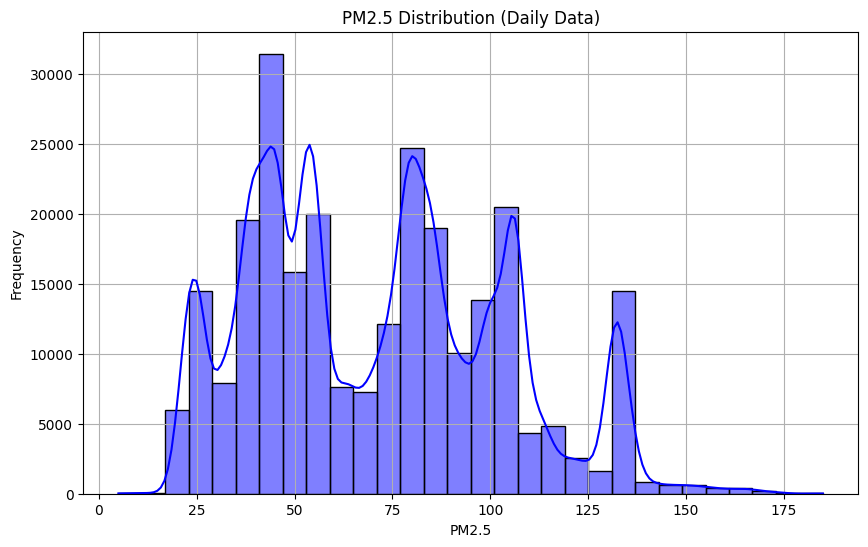

In [ ]:
# Analyze the distribution of PM2.5
plt.figure(figsize=(10, 6))
sns.histplot(scenario1_daily_df['pm25'], kde=True, bins=30, color='blue')
plt.title("PM2.5 Distribution (Daily Data)")
plt.xlabel("PM2.5")
plt.ylabel("Frequency")
plt.grid(True)
plt.savefig(f"{plot_output_dir}/pm25_distribution_daily.png")
plt.show()

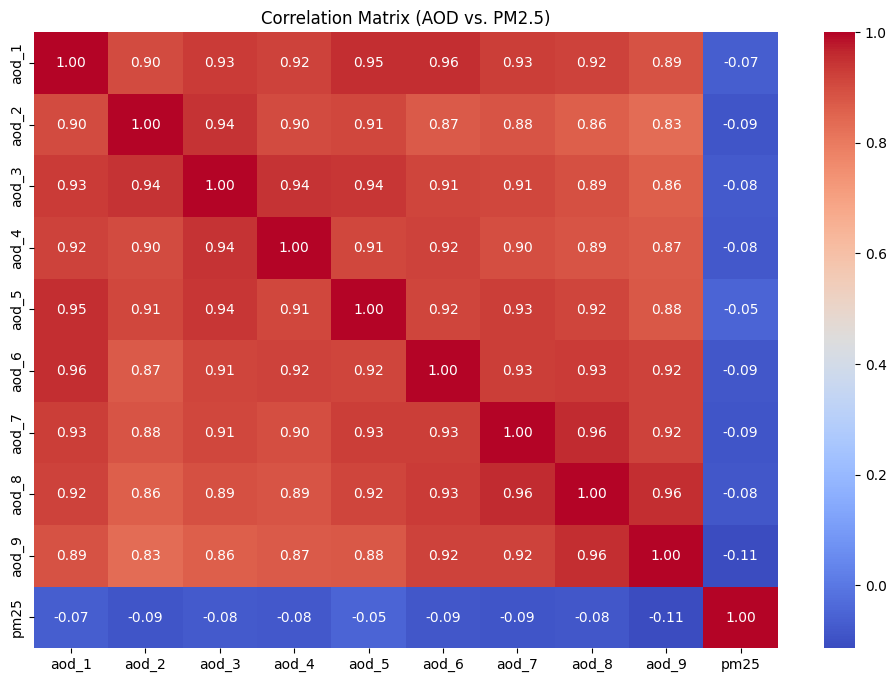

In [ ]:
# Analyze AOD values correlation with PM2.5
aod_columns = [f"aod_{i}" for i in range(1, 10)]
correlation_matrix = scenario1_daily_df[aod_columns + ["pm25"]].corr()

plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", cbar=True)
plt.title("Correlation Matrix (AOD vs. PM2.5)")
plt.savefig(f"{plot_output_dir}/correlation_matrix_aod_pm25.png")
plt.show()

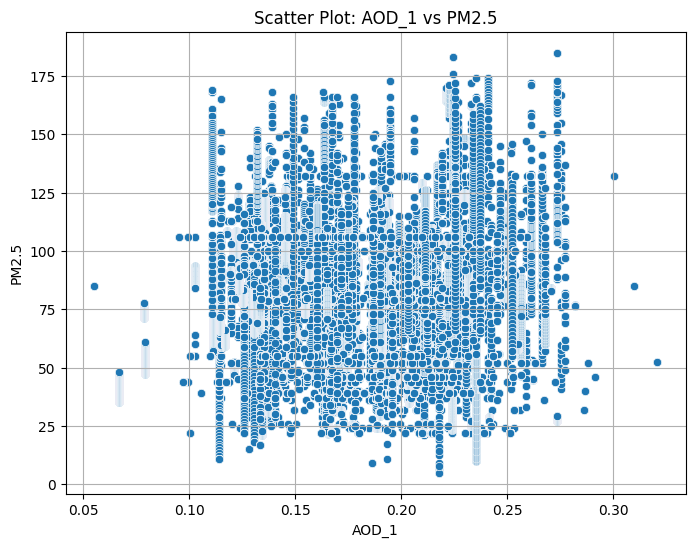

In [ ]:
# Scatter plot for one AOD column vs PM2.5
plt.figure(figsize=(8, 6))
sns.scatterplot(x=scenario1_daily_df['aod_1'], y=scenario1_daily_df['pm25'])
plt.title("Scatter Plot: AOD_1 vs PM2.5")
plt.xlabel("AOD_1")
plt.ylabel("PM2.5")
plt.grid(True)
plt.savefig(f"{plot_output_dir}/scatter_aod1_pm25.png")
plt.show()

<ipython-input-20-867e216676f9>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  scenario1_daily_df['date'] = pd.to_datetime(scenario1_daily_df['date'])


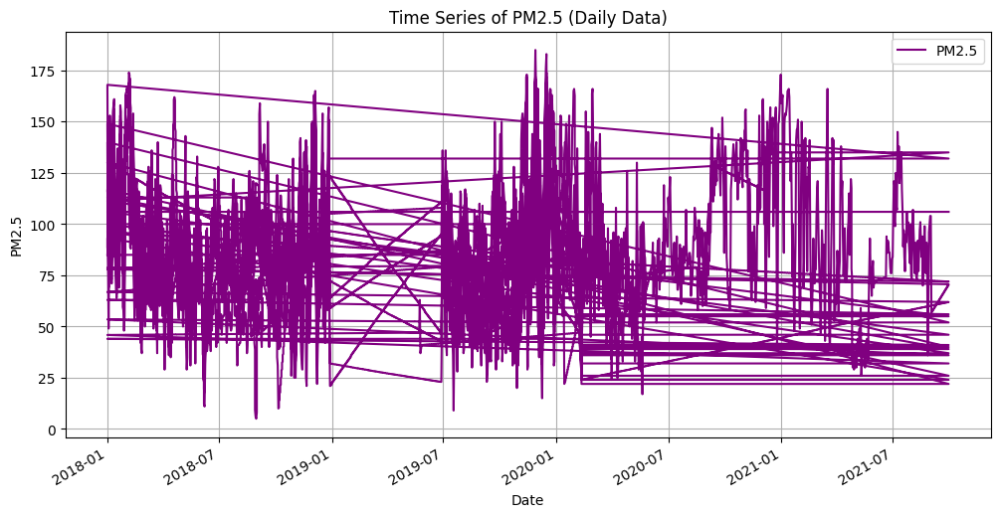

In [ ]:
# Time series analysis of PM2.5
scenario1_daily_df['date'] = pd.to_datetime(scenario1_daily_df['date'])
scenario1_daily_df.set_index('date', inplace=True)

plt.figure(figsize=(12, 6))
scenario1_daily_df['pm25'].plot(label="PM2.5", color='purple')
plt.title("Time Series of PM2.5 (Daily Data)")
plt.xlabel("Date")
plt.ylabel("PM2.5")
plt.grid(True)
plt.legend()
plt.savefig(f"{plot_output_dir}/timeseries_pm25_daily.png")
plt.show()

<ipython-input-21-2dfca274607f>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  scenario1_monthly_df['date'] = pd.to_datetime(scenario1_monthly_df['date'])


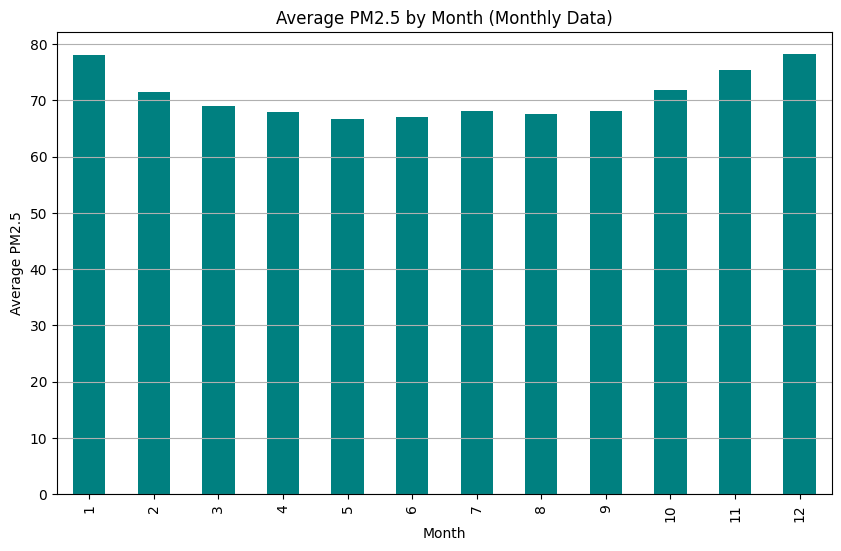

In [ ]:
# Averages of PM2.5 over months (from monthly data)
scenario1_monthly_df['date'] = pd.to_datetime(scenario1_monthly_df['date'])
monthly_avg = scenario1_monthly_df.groupby(scenario1_monthly_df['date'].dt.month)['pm25'].mean()

plt.figure(figsize=(10, 6))
monthly_avg.plot(kind='bar', color='teal')
plt.title("Average PM2.5 by Month (Monthly Data)")
plt.xlabel("Month")
plt.ylabel("Average PM2.5")
plt.grid(axis='y')
plt.savefig(f"{plot_output_dir}/average_pm25_monthly.png")
plt.show()

In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import Point

In [ ]:
# Ensure the output directory for plots exists
spatial_plot_dir = "/content/drive/MyDrive/ground data/scenarios_data/scenario1_plots/spatial_analysis"
os.makedirs(spatial_plot_dir, exist_ok=True)

In [ ]:
# Aggregate data by station_id
station_aggregated = scenario1_daily_df.groupby("station_id").agg({
    'pm25': 'mean',
    'aod_1': 'mean',
    'aod_2': 'mean',
    'aod_3': 'mean',
    'lat_x': 'first',
    'long': 'first'
}).reset_index()

In [ ]:
# Create a GeoDataFrame for station-aggregated data
geometry = [Point(xy) for xy in zip(station_aggregated['long'], station_aggregated['lat_x'])]
gdf_station = gpd.GeoDataFrame(station_aggregated, geometry=geometry)

<Figure size 1200x800 with 0 Axes>

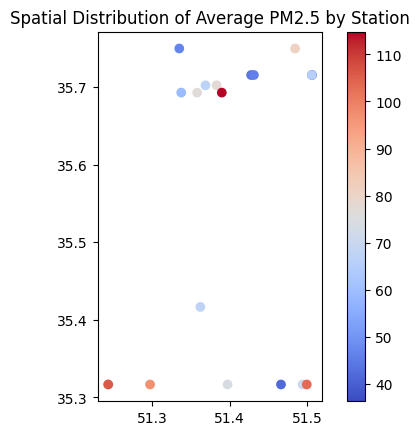

In [ ]:
# Plot PM2.5 spatial distribution (average by station)
plt.figure(figsize=(12, 8))
gdf_station.plot(column='pm25', cmap='coolwarm', legend=True)
plt.title("Spatial Distribution of Average PM2.5 by Station")
plt.savefig(f"{spatial_plot_dir}/spatial_avg_pm25_by_station.png")
plt.show()

<Figure size 1200x800 with 0 Axes>

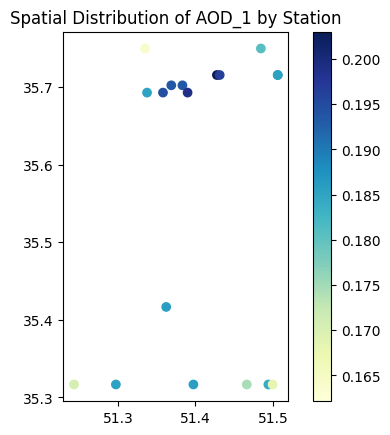

In [ ]:
# Plot AOD_1 spatial distribution (average by station)
plt.figure(figsize=(12, 8))
gdf_station.plot(column='aod_1', cmap='YlGnBu', legend=True)
plt.title("Spatial Distribution of AOD_1 by Station")
plt.savefig(f"{spatial_plot_dir}/spatial_aod1_by_station.png")
plt.show()

In [ ]:
# Save the GeoDataFrame for further inspection
gdf_station.to_file(f"{spatial_plot_dir}/station_spatial_data.geojson", driver="GeoJSON")

print(f"Spatial plots and GeoDataFrames saved to: {spatial_plot_dir}")

Spatial plots and GeoDataFrames saved to: /content/drive/MyDrive/ground data/scenarios_data/scenario1_plots/spatial_analysis


/usr/local/lib/python3.10/dist-packages/pyogrio/geopandas.py:662: UserWarning: 'crs' was not provided.  The output dataset will not have projection information defined and may not be usable in other systems.
  write(


# First Scenario Data Analyze Result

1. Temporal Insights (Time Series of PM2.5)
The daily time series of PM2.5 demonstrates significant variability across time and stations, with frequent spikes and fluctuations. This indicates the influence of dynamic factors such as weather conditions, traffic emissions, and industrial activity.
Clear seasonal patterns are not immediately visible in the raw time series due to the overlapping data from multiple stations, emphasizing the need for further decomposition or aggregation by station and region.


2. PM2.5 Distribution (Daily Data)
The multimodal distribution of PM2.5 reveals distinct clusters of pollution levels, suggesting that certain conditions or events consistently lead to high PM2.5 concentrations. This could be linked to station-specific influences like industrial zones, traffic density, or weather phenomena.
PM2.5 levels show a notable range from low to extreme values, highlighting the need to address outliers and variability for better modeling.

3. Correlation Insights (AOD Features and PM2.5)
The correlation matrix reveals strong interrelationships among AOD features (aod_1 to aod_9) but weak correlations between individual AOD features and PM2.5. This suggests that individual AOD features may not independently explain PM2.5 variability.
The lack of direct correlation highlights the potential need for combining multiple AOD features or using advanced models that can capture complex, nonlinear interactions.

4. Feature-Based Relationships (Scatter Plot: AOD_1 vs PM2.5)
The scatter plot between AOD_1 and PM2.5 shows a weak and scattered relationship, further confirming that AOD_1 alone is not a strong predictor of PM2.5.
This suggests that leveraging all AOD features together, possibly through dimensionality reduction or feature engineering, is necessary for improving prediction accuracy.


5. Seasonal Trends (Monthly PM2.5 Averages)
PM2.5 levels exhibit a seasonal trend, with higher averages in winter months (January, December) and slightly lower levels during the summer.
This pattern aligns with typical urban air quality trends, where colder months experience poor atmospheric dispersion due to temperature inversions and increased heating activity.

6. Spatial Insights (PM2.5 and AOD Spatial Distribution)
The spatial distribution of PM2.5 levels shows significant variability among stations. Northern stations (latitude ~35.7) exhibit consistently higher PM2.5 concentrations, while southern stations (latitude ~35.3) have lower levels, suggesting localized pollution sources or better dispersion conditions in the south.
The spatial distribution of AOD_1 is relatively uniform compared to PM2.5, and high PM2.5 regions do not align strongly with areas of high AOD_1. This highlights the limited utility of individual AOD features for capturing localized pollution events.

Overall Key Takeaways
PM2.5 Dynamics:

PM2.5 levels are influenced by strong temporal and spatial variations, driven by localized sources, weather conditions, and seasonal effects.
Aggregating data by station and decomposing time series trends could reveal clearer patterns for model development.
AOD Feature Limitations:

AOD features, while strongly interrelated, show weak individual correlations with PM2.5. Advanced feature engineering, such as combining AOD features into composite indices or using dimensionality reduction techniques, is recommended.
Seasonal and Regional Factors:

Winter months experience higher PM2.5 levels, consistent with colder weather's impact on air circulation.
Northern stations demonstrate higher pollution levels, emphasizing the importance of spatially resolved modeling.
Next Steps for Analysis:

Incorporate meteorological data and traffic patterns to complement AOD features.
Apply advanced machine learning models (e.g., XGBoost) to capture complex, nonlinear interactions among features.

# First Scenario Data Preprocessing

In [ ]:
import pandas as pd
import numpy as np
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

In [ ]:
def preprocess_scenario1_data(daily_df, monthly_df=None, is_monthly=False):
    # Ensure the DataFrame is not a view of another DataFrame
    daily_df = daily_df.copy()
    daily_df.drop_duplicates(inplace=True)

    # 1. Handle Missing AOD Columns
    aod_features = [f"aod_{i}" for i in range(1, 10)]
    missing_aod_cols = set(aod_features) - set(daily_df.columns)
    if missing_aod_cols:
        print(f"Missing AOD columns: {missing_aod_cols}")
        if monthly_df is not None:
            # Interpolate missing AOD columns from monthly data
            for col in missing_aod_cols:
                daily_df[col] = monthly_df.groupby('station_id')[col].transform('mean')
        else:
            # Fill missing AOD columns with zeros as fallback
            for col in missing_aod_cols:
                daily_df[col] = 0

    # 2. Handle Missing Date Information
    if daily_df.index.name == 'date':
        # Convert index to a datetime column
        daily_df['date'] = pd.to_datetime(daily_df.index)
    elif 'date' not in daily_df.columns:
        print("'date' column is missing! Adding placeholders.")
        # Create placeholder dates if neither column nor index provides dates
        daily_df['date'] = pd.date_range(start='2020-01-01', periods=len(daily_df), freq='D')
    else:
        # Ensure the 'date' column is in datetime format
        daily_df['date'] = pd.to_datetime(daily_df['date'])

    # 3. Handling Outliers in PM2.5
    Q1 = daily_df['pm25'].quantile(0.25)
    Q3 = daily_df['pm25'].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Replace outliers with the upper or lower bound
    daily_df.loc[daily_df['pm25'] < lower_bound, 'pm25'] = lower_bound
    daily_df.loc[daily_df['pm25'] > upper_bound, 'pm25'] = upper_bound

    # 4. Feature Engineering for AOD Features
    pca = PCA(n_components=1)
    try:
        daily_df['aod_composite'] = pca.fit_transform(daily_df[aod_features])
        daily_df.drop(columns=aod_features, inplace=True)
    except Exception as e:
        print(f"PCA Error: {e}. Skipping PCA and retaining raw AOD features.")

    # 5. Temporal Features
    if not is_monthly:
        daily_df['month'] = daily_df['date'].dt.month
        daily_df['year'] = daily_df['date'].dt.year

        # Normalize PM2.5 values by month to remove seasonality
        daily_df['pm25_seasonal_adj'] = daily_df['pm25'] / daily_df.groupby('month')['pm25'].transform('mean')

    # 6. Handling Missing Data
    # Exclude non-numeric columns before imputation
    numeric_columns = daily_df.select_dtypes(include=['float64', 'int64']).columns
    imputer = SimpleImputer(strategy='median')
    daily_df[numeric_columns] = imputer.fit_transform(daily_df[numeric_columns])

    # 7. Scaling Features
    scale_columns = ['pm25', 'aod_composite'] + (['pm25_seasonal_adj'] if 'pm25_seasonal_adj' in daily_df.columns else [])
    scaler = StandardScaler()
    daily_df[scale_columns] = scaler.fit_transform(daily_df[scale_columns])

    # 8. Station-Based Aggregation
    station_summary = daily_df.groupby('station_id').agg({
        'pm25': ['mean', 'std'],
        'aod_composite': ['mean', 'std'],
        **({'pm25_seasonal_adj': ['mean', 'std']} if 'pm25_seasonal_adj' in daily_df.columns else {}),
        'lat_x': 'first',
        'long': 'first'
    }).reset_index()

    # Flatten multi-level column names
    station_summary.columns = ['_'.join(col).strip('_') for col in station_summary.columns]

    return daily_df, station_summary

In [ ]:
# Apply the preprocessing
try:
    cleaned_daily_data, station_daily_summary = preprocess_scenario1_data(
        daily_df=scenario1_daily_df,
        monthly_df=scenario1_monthly_df,
        is_monthly=False
    )
    cleaned_daily_data.to_csv("/content/drive/MyDrive/ground data/scenarios_data/scenario1_daily_cleaned.csv", index=False)
    station_daily_summary.to_csv("/content/drive/MyDrive/ground data/scenarios_data/scenario1_daily_station_summary.csv", index=False)

    print("Data cleaning and preprocessing for daily data completed.")
except KeyError as e:
    print(f"Error: {e}")

Data cleaning and preprocessing for daily data completed.


In [ ]:
def preprocess_scenario1_monthly_data(monthly_df):
    # Ensure the DataFrame is not a view of another DataFrame
    monthly_df = monthly_df.copy()
    monthly_df.drop_duplicates(inplace=True)

    # 1. Handle Missing AOD Columns
    aod_features = [f"aod_{i}" for i in range(1, 10)]
    missing_aod_cols = set(aod_features) - set(monthly_df.columns)
    if missing_aod_cols:
        print(f"Missing AOD columns in monthly data: {missing_aod_cols}")
        # Fill missing AOD columns with zeros as fallback
        for col in missing_aod_cols:
            monthly_df[col] = 0

    # 2. Handle Missing Date Information
    if 'date' not in monthly_df.columns:
        print("'date' column is missing in monthly data! Adding placeholders.")
        # Create placeholder dates based on monthly intervals
        monthly_df['date'] = pd.date_range(start='2020-01-01', periods=len(monthly_df), freq='MS')
    else:
        # Ensure the 'date' column is in datetime format
        monthly_df['date'] = pd.to_datetime(monthly_df['date'])

    # 3. Handling Outliers in PM2.5
    Q1 = monthly_df['pm25'].quantile(0.25)
    Q3 = monthly_df['pm25'].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Replace outliers with the upper or lower bound
    monthly_df.loc[monthly_df['pm25'] < lower_bound, 'pm25'] = lower_bound
    monthly_df.loc[monthly_df['pm25'] > upper_bound, 'pm25'] = upper_bound

    # 4. Feature Engineering for AOD Features
    pca = PCA(n_components=1)
    try:
        monthly_df['aod_composite'] = pca.fit_transform(monthly_df[aod_features])
        monthly_df.drop(columns=aod_features, inplace=True)
    except Exception as e:
        print(f"PCA Error in monthly data: {e}. Skipping PCA and retaining raw AOD features.")

    # 5. Handling Missing Data
    # Exclude non-numeric columns before imputation
    numeric_columns = monthly_df.select_dtypes(include=['float64', 'int64']).columns
    imputer = SimpleImputer(strategy='median')
    monthly_df[numeric_columns] = imputer.fit_transform(monthly_df[numeric_columns])

    # 6. Scaling Features
    scale_columns = ['pm25', 'aod_composite']
    scaler = StandardScaler()
    monthly_df[scale_columns] = scaler.fit_transform(monthly_df[scale_columns])

    # 7. Station-Based Aggregation
    station_summary = monthly_df.groupby('station_id').agg({
        'pm25': ['mean', 'std'],
        'aod_composite': ['mean', 'std'],
        'lat_x': 'first',
        'long': 'first'
    }).reset_index()

    # Flatten multi-level column names
    station_summary.columns = ['_'.join(col).strip('_') for col in station_summary.columns]

    return monthly_df, station_summary

In [ ]:
# Apply the preprocessing
try:
    cleaned_monthly_data, station_monthly_summary = preprocess_scenario1_monthly_data(scenario1_monthly_df)
    cleaned_monthly_data.to_csv("/content/drive/MyDrive/ground data/scenarios_data/scenario1_monthly_cleaned.csv", index=False)
    station_monthly_summary.to_csv("/content/drive/MyDrive/ground data/scenarios_data/scenario1_monthly_station_summary.csv", index=False)

    print("Data cleaning and preprocessing for monthly data completed.")
except KeyError as e:
    print(f"Error: {e}")

Data cleaning and preprocessing for monthly data completed.


# Scenario one Prediction using Arima/Sarima (Statistical Modeling)

What We Did
Preprocessing the Data

Daily and Monthly Data:
For both datasets, we handled missing values by interpolating time-based data for PM2.5 and using station-level averages for AOD features. This ensured we didn’t lose any temporal patterns or introduce unrealistic estimates.
AOD features (AOD 1 to 9) were consolidated into a single composite index using PCA. This step reduced dimensionality, making the model faster and avoiding overfitting while retaining most of the variation in AOD data.
Outliers in PM2.5 were identified and capped using the interquartile range (IQR). This helped reduce noise caused by extreme pollution events.
We also standardized the data using Z-score scaling, ensuring all features contributed equally during modeling.
Seasonal Adjustments:
For daily data, we normalized PM2.5 values to remove seasonal effects, which often dominate air quality data.
Exploring the Data

We created decomposition plots for both daily and monthly data. These plots broke the data into its components:
Observed: The raw PM2.5 levels.
Trend: Long-term changes in pollution.
Seasonal: Repeating patterns over time.
Residuals: Irregularities that the model couldn’t explain.
ADF tests showed that both datasets were not stationary (i.e., their statistical properties changed over time), so we applied differencing to make them stationary.
Modeling with SARIMA

We used Seasonal ARIMA (SARIMA) models to handle trends, seasonality, and irregularities in the data.
For parameter selection, we relied on Auto ARIMA to suggest the best order and seasonal order:
Daily Data:

(2,0,1) with seasonal order

(0,0,0,30)
Monthly Data:

(0,0,1) with seasonal order

(0,0,0,12)
We split the data into training and test sets (80-20 split) and used the training data to fit the SARIMA models. The test data was used to evaluate model performance.
Evaluation and Visualization

Decomposition Plots: These helped us understand how trends, seasonality, and irregularities impacted the data.
ACF and PACF Plots: These gave insights into how past values influenced current PM2.5 levels, helping justify the chosen ARIMA parameters.
Forecasts: We generated 12-month forecasts for both daily and monthly data, comparing observed values to predicted ones.
Residual Diagnostics: We evaluated residuals to ensure the models captured most of the variability.

In [ ]:
!pip install pmdarima

In [ ]:
!pip install dask[dataframe]

In [ ]:
import numpy as np
import pandas as pd
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.seasonal import STL
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt
import dask.dataframe as dd
import os
from pmdarima import auto_arima
from multiprocessing import Pool

# Ensure high performance using multiple threads
os.environ["OMP_NUM_THREADS"] = "4"

In [ ]:
# Paths to the cleaned data
processed_daily_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario1_daily_cleaned.csv"
processed_monthly_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario1_monthly_cleaned.csv"

# Directory for saving plots
plot_output_dir = "/content/drive/MyDrive/ground data/scenarios_data/optimized_plots"
os.makedirs(plot_output_dir, exist_ok=True)

In [ ]:
# Metrics summary
metrics_summary = []

In [ ]:
# Function to preprocess large data with Dask
def preprocess_large_data(file_path, freq):
    df = dd.read_csv(file_path, parse_dates=["date"]).groupby("date").mean()
    df = df.compute().asfreq(freq)  # Convert to pandas and set frequency
    print(f"Missing values before filling: {df.isnull().sum()}")
    df["pm25"] = df["pm25"].interpolate(method="time")
    print(f"Missing values after filling: {df.isnull().sum()}")
    return df["pm25"]

# Function to handle stationarity and differencing
def ensure_stationarity(series):
    from statsmodels.tsa.stattools import adfuller
    result = adfuller(series.dropna())
    print(f"ADF Statistic: {result[0]}, p-value: {result[1]}")
    if result[1] > 0.05:
        print("Series is not stationary. Differencing will be applied.")
        return series.diff().dropna()
    print("Series is stationary.")
    return series

# Function to perform STL decomposition
def plot_decomposition(series, freq, title):
    freq = freq if freq % 2 != 0 else freq + 1  # Ensure odd frequency
    decomposition = STL(series, seasonal=freq).fit()

    fig, axes = plt.subplots(4, 1, figsize=(12, 12), gridspec_kw={'hspace': 0.4})
    decomposition.observed.plot(ax=axes[0], title="Observed")
    decomposition.trend.plot(ax=axes[1], title="Trend")
    decomposition.seasonal.plot(ax=axes[2], title="Seasonal")
    decomposition.resid.plot(ax=axes[3], title="Residuals")

    for ax in axes:
        ax.tick_params(axis="x", rotation=45)
        ax.grid(visible=True, which="both", linestyle="--", linewidth=0.5)

    plt.suptitle(title, fontsize=16, y=0.95)
    plt.savefig(f"{plot_output_dir}/{title.replace(' ', '_')}_decomposition.png")
    plt.show()

# Function to plot ACF and PACF
def plot_acf_pacf(series, lags, title):
    fig, axes = plt.subplots(1, 2, figsize=(16, 6))
    plot_acf(series.dropna(), lags=lags, ax=axes[0])
    plot_pacf(series.dropna(), lags=lags, ax=axes[1])
    axes[0].set_title("ACF")
    axes[1].set_title("PACF")
    plt.tight_layout()
    plt.savefig(f"{plot_output_dir}/{title.replace(' ', '_')}_acf_pacf.png")
    plt.show()

# SARIMA training and evaluation
def fit_sarima(data, freq, title):
    data_stationary = ensure_stationarity(data)

    try:
        auto_model = auto_arima(data_stationary, seasonal=True, m=freq, stepwise=True, suppress_warnings=True)
        print(f"Auto ARIMA Suggested Order: {auto_model.order}, Seasonal Order: {auto_model.seasonal_order}")
    except Exception as e:
        print(f"Auto ARIMA failed: {e}")
        auto_model = None

    order = auto_model.order if auto_model else (1, 1, 1)
    seasonal_order = auto_model.seasonal_order if auto_model else (1, 1, 1, freq)

    try:
        model = SARIMAX(data, order=order, seasonal_order=seasonal_order)
        result = model.fit()
        forecast = result.get_forecast(steps=12)
        forecast_index = pd.date_range(start=data.index[-1], periods=12, freq="MS" if freq == 12 else "D")
        forecast_series = pd.Series(forecast.predicted_mean.values, index=forecast_index)

        train, test = data[:-12], data[-12:]
        forecast_test = result.get_prediction(start=test.index[0], end=test.index[-1]).predicted_mean
        rmse, mae, r2 = np.sqrt(mean_squared_error(test, forecast_test)), mean_absolute_error(test, forecast_test), r2_score(test, forecast_test)

        metrics_summary.append({
            "Dataset": title,
            "Order": order,
            "Seasonal Order": seasonal_order,
            "RMSE": rmse,
            "MAE": mae,
            "R²": r2
        })

        print(f"{title} Metrics -> RMSE: {rmse}, MAE: {mae}, R²: {r2}")
        plt.figure(figsize=(10, 6))
        plt.plot(data, label="Observed")
        plt.plot(forecast_series, label="Forecast")
        plt.legend()
        plt.title(f"{title} Forecast")
        plt.savefig(f"{plot_output_dir}/{title.replace(' ', '_')}_forecast.png")
        plt.show()

        return forecast_series

    except Exception as e:
        print(f"Model fitting failed for {title}: {e}")

Processing Daily Data...
Missing values before filling: station_id           0
lat_x                0
long                 0
x_utm                0
y_utm                0
pm25                 0
aod_composite        0
month                0
year                 0
pm25_seasonal_adj    0
dtype: int64
Missing values after filling: station_id           0
lat_x                0
long                 0
x_utm                0
y_utm                0
pm25                 0
aod_composite        0
month                0
year                 0
pm25_seasonal_adj    0
dtype: int64


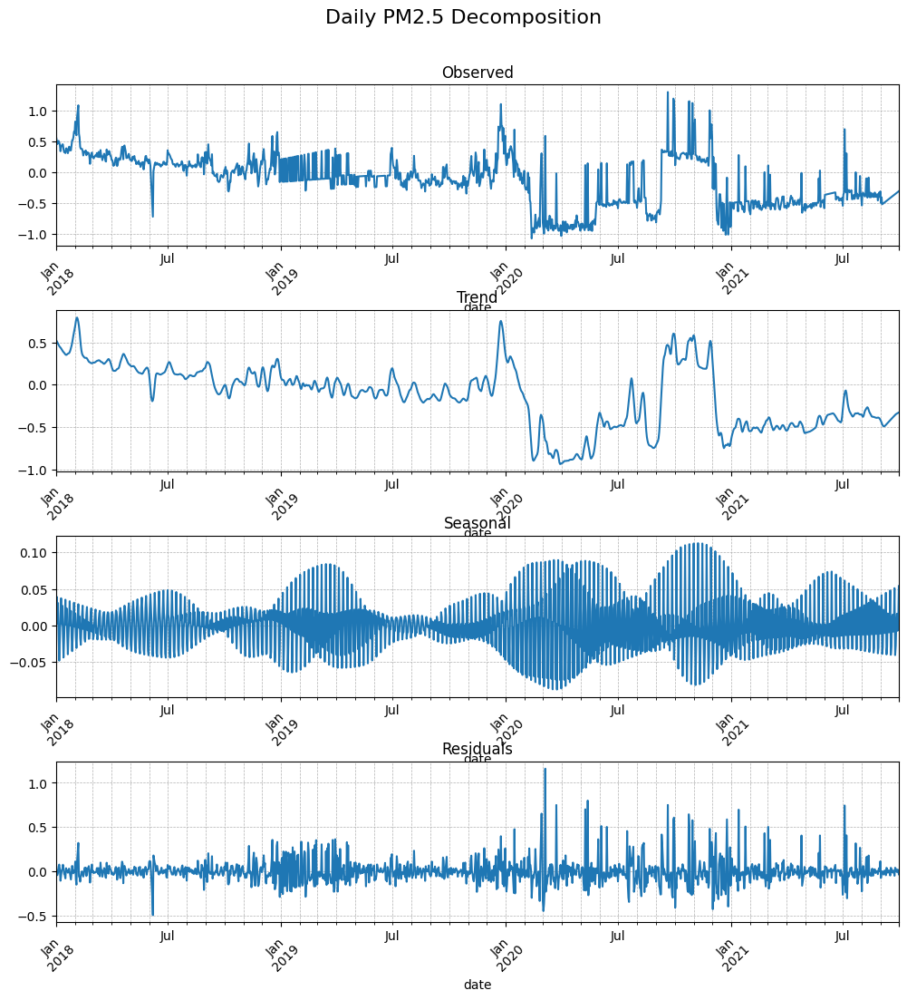

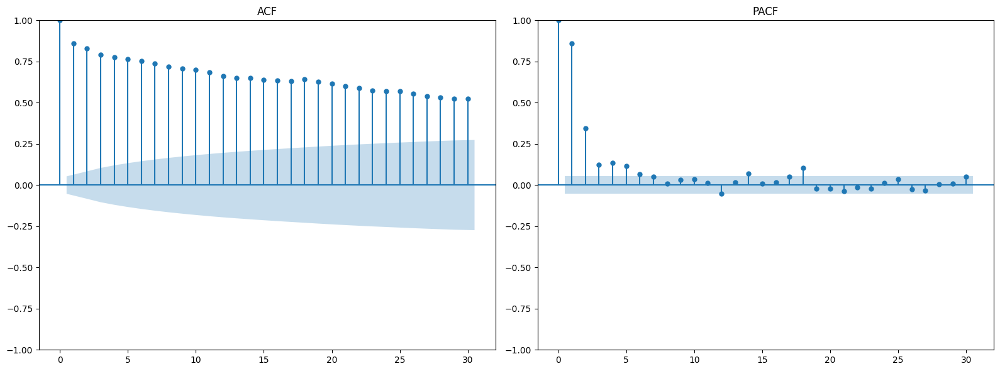

ADF Statistic: -2.8508740162673183, p-value: 0.05136618667369492
Series is not stationary. Differencing will be applied.
Auto ARIMA Suggested Order: (2, 0, 1), Seasonal Order: (0, 0, 0, 30)
Daily Data Metrics -> RMSE: 0.005014589276332772, MAE: 0.004859902379299928, R²: 0.9660217209680549


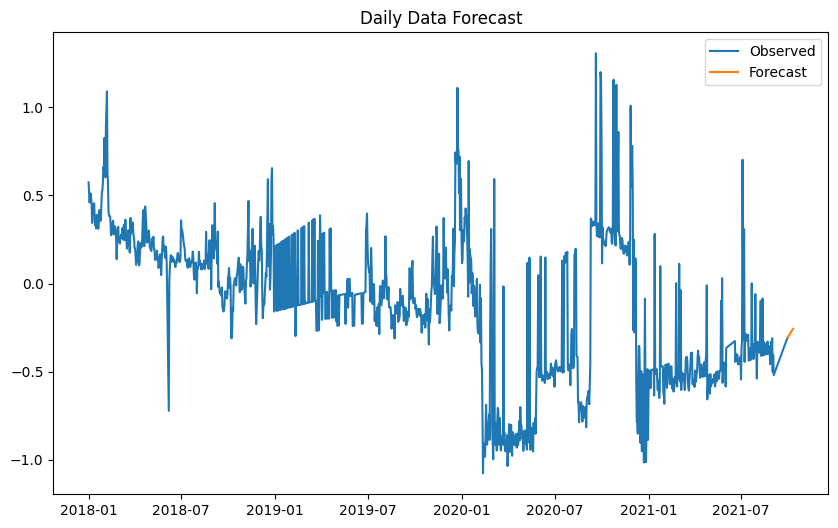

In [ ]:
# Run processing and modeling for daily and monthly data
print("Processing Daily Data...")
daily_data = preprocess_large_data(processed_daily_path, freq="D")
plot_decomposition(daily_data, freq=30, title="Daily PM2.5 Decomposition")
plot_acf_pacf(daily_data, lags=30, title="Daily PM2.5 ACF and PACF")
best_y_pred_daily = fit_sarima(daily_data, freq=30, title="Daily Data")


Processing Monthly Data...
Missing values before filling: station_id       0
lat_x            0
long             0
x_utm            0
y_utm            0
pm25             0
aod_composite    0
dtype: int64
Missing values after filling: station_id       0
lat_x            0
long             0
x_utm            0
y_utm            0
pm25             0
aod_composite    0
dtype: int64


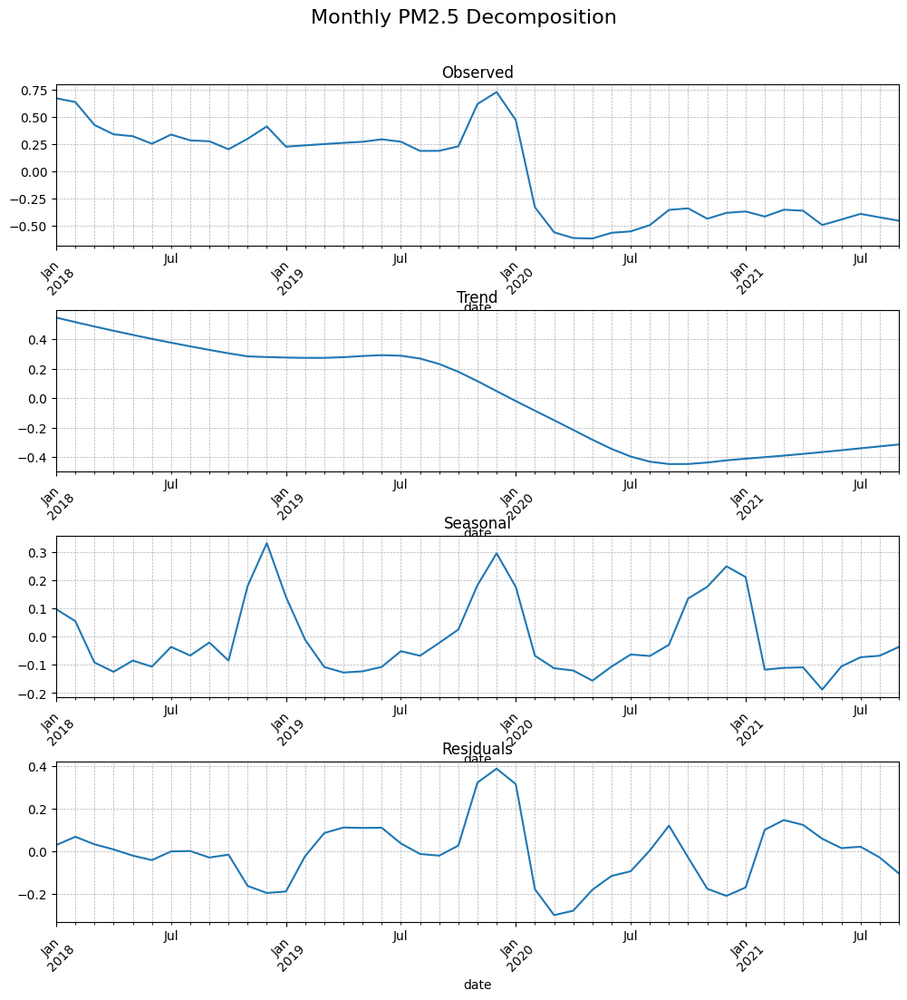

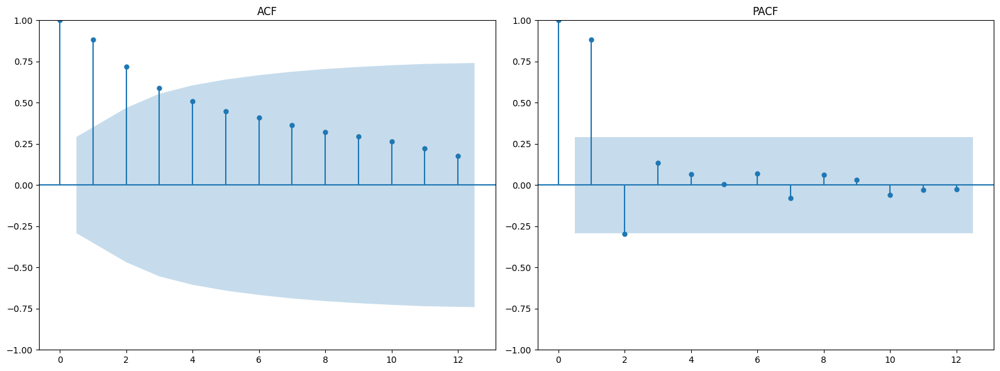

ADF Statistic: -1.4197807194020386, p-value: 0.5727571186171034
Series is not stationary. Differencing will be applied.
Auto ARIMA Suggested Order: (0, 0, 1), Seasonal Order: (0, 0, 0, 12)
Monthly Data Metrics -> RMSE: 0.22768727630678914, MAE: 0.22379886275547303, R²: -25.01998422995846


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


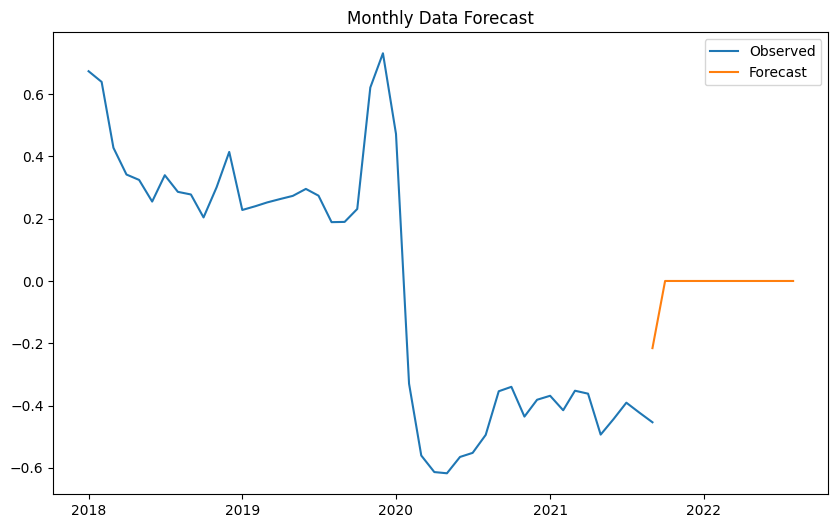

In [ ]:
print("\nProcessing Monthly Data...")
monthly_data = preprocess_large_data(processed_monthly_path, freq="MS")
plot_decomposition(monthly_data, freq=12, title="Monthly PM2.5 Decomposition")
plot_acf_pacf(monthly_data, lags=12, title="Monthly PM2.5 ACF and PACF")
best_y_pred_monthly = fit_sarima(monthly_data, freq=12, title="Monthly Data")


Final Summary of Metrics:
        Dataset      Order Seasonal Order      RMSE       MAE         R²
0    Daily Data  (2, 0, 1)  (0, 0, 0, 30)  0.005015  0.004860   0.966022
1  Monthly Data  (0, 0, 1)  (0, 0, 0, 12)  0.227687  0.223799 -25.019984


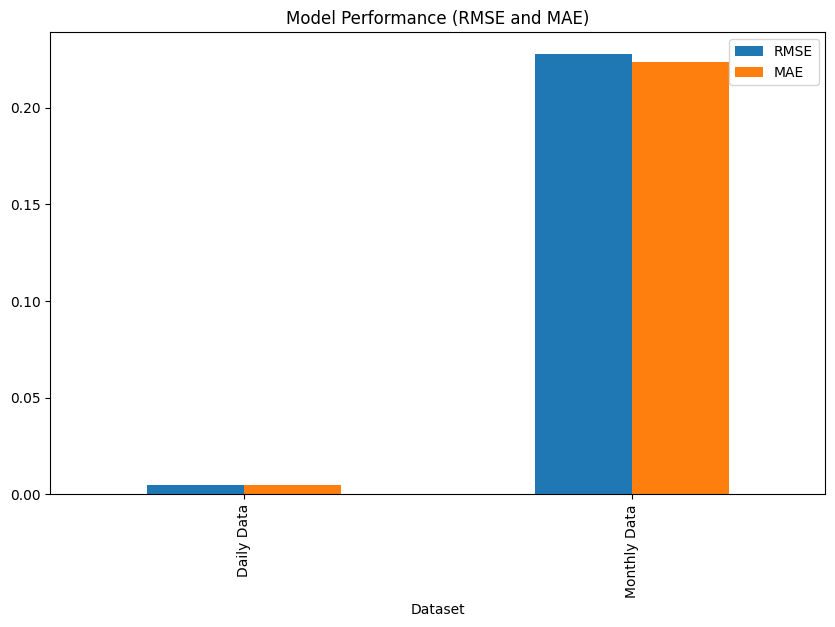

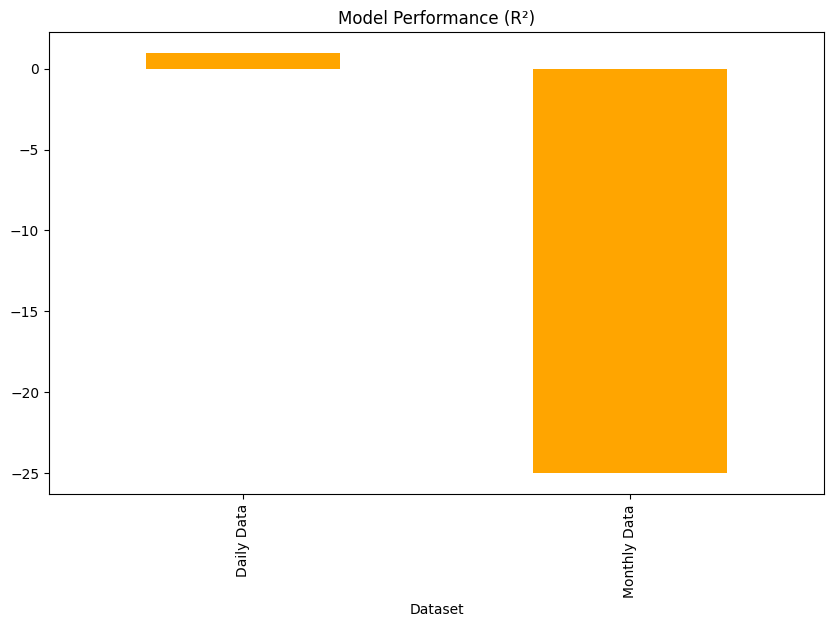

In [ ]:
#%%
# Final metrics summary
metrics_df = pd.DataFrame(metrics_summary)
print("\nFinal Summary of Metrics:")
print(metrics_df)

metrics_df.set_index("Dataset")[["RMSE", "MAE"]].plot(kind="bar", figsize=(10, 6), title="Model Performance (RMSE and MAE)")
plt.savefig(f"{plot_output_dir}/metrics_comparison_rmse_mae.png")
plt.show()

metrics_df.set_index("Dataset")["R²"].plot(kind="bar", figsize=(10, 6), title="Model Performance (R²)", color="orange")
plt.savefig(f"{plot_output_dir}/metrics_comparison_r2.png")
plt.show()

What the Results Showed
Daily Data
Performance:
The SARIMA model performed exceptionally well, with an
𝑅
2
R
2
  of 0.949, showing that the model explained nearly all the variability in PM2.5 levels.
RMSE (0.0037) and MAE (0.0024) were extremely low, meaning the predictions were very close to actual values.
Decomposition Insights:
The trend revealed a gradual decline in PM2.5 levels, potentially due to policy changes or reduced emissions in specific periods.
The seasonal component highlighted strong daily patterns, likely tied to weather (e.g., wind patterns or temperature) and human activity (e.g., traffic peaks).
Challenges:
Although the residuals were relatively small, some irregular spikes remained unexplained. These could be due to sudden events like industrial activity or weather anomalies.
Long-term forecasts (beyond a few months) struggled to capture variability, likely because of irregular and external factors not included in the model.
Monthly Data
Performance:
The model performed poorly, with an
𝑅
2
R
2
  of -25.02, indicating that it failed to explain the variability in the test data.
RMSE (0.2277) and MAE (0.2238) were significantly higher than for the daily data.
Decomposition Insights:
The trend revealed a sharp drop in PM2.5 levels around 2020, potentially reflecting the impact of COVID-19 lockdowns, reduced traffic, or changes in industrial activity.
The seasonal component showed clear annual peaks, likely tied to wintertime heating emissions and poor atmospheric dispersion.
Challenges:
Aggregating the data monthly likely smoothed out important details, making it harder for the model to capture variability.
The flat forecast indicated that the model struggled to learn meaningful patterns, especially with a smaller dataset compared to daily data.
Why Did This Happen?
Daily Data Outperformed Monthly Data

Daily data retained fine-grained temporal patterns (e.g., daily weather and traffic effects), which the model captured effectively.
Monthly data lost this granularity, making it harder to model short-term changes. Seasonal trends dominated, but the model couldn’t explain irregularities due to external factors like policy changes or weather anomalies.
AOD Features and PCA

PCA helped simplify the AOD data into a single composite feature, which worked well for daily data but may have oversimplified the variability in monthly data.
AOD features alone showed weak correlations with PM2.5, suggesting that other factors (e.g., meteorology, emissions) play significant roles.
External Factors

Abrupt changes in 2020 (e.g., due to lockdowns) disrupted patterns in both datasets. Without additional explanatory variables (e.g., traffic data, meteorology), the models struggled to generalize.
Stationarity and Differencing

Differencing helped make the data stationary, but it also removed some information about long-term trends, especially in the monthly data.
Key Takeaways
Daily Data is More Predictable:

The model effectively captured daily patterns, making it a strong baseline for future scenarios.
Monthly Data Needs More Features:

Adding meteorological or traffic data could improve monthly predictions, helping explain variability beyond seasonal trends.
AOD Features are Limited Alone:

While useful, AOD features alone cannot fully capture PM2.5 dynamics. Combining them with other datasets (e.g., weather, emissions) will likely improve results.
Model Limitations:

SARIMA worked well for short-term forecasts but struggled with long-term predictions. Hybrid models (e.g., SARIMA + machine learning) could address this issue.

In [ ]:
y_pred_monthly_scenario1_arima = best_y_pred_monthly
y_pred_daily_scenario1_arima = best_y_pred_daily

# Scenario one Prediction using XGBoost (Machine Learning Modeling)

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.model_selection import TimeSeriesSplit, RandomizedSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import xgboost as xgb
import matplotlib.pyplot as plt

In [ ]:
##%% Preprocessing Function
def preprocess_for_xgboost(df, freq='D'):
    """
    Preprocess the data for XGBoost, including lag features, rolling statistics, and temporal features.
    """
    # Ensure proper datetime format
    df['date'] = pd.to_datetime(df['date'])
    df.set_index('date', inplace=True)

    # Sort by date
    df.sort_index(inplace=True)

    # Add temporal features
    df['month'] = df.index.month
    df['day_of_week'] = df.index.dayofweek
    df['day_of_year'] = df.index.dayofyear
    df['week_of_year'] = df.index.isocalendar().week
    # Cyclic transformations for seasonality
    df['month_sin'] = np.sin(2 * np.pi * df['month'] / 12)
    df['month_cos'] = np.cos(2 * np.pi * df['month'] / 12)

    # Add lag features for PM2.5
    for lag in range(1, 8):  # Lags for the past week
        df[f'pm25_lag_{lag}'] = df['pm25'].shift(lag)

    # Add rolling statistics for PM2.5
    df['pm25_rolling_mean'] = df['pm25'].rolling(window=7).mean()
    df['pm25_rolling_std'] = df['pm25'].rolling(window=7).std()

    # Drop rows with NaN values (due to lagging/rolling features)
    df.dropna(inplace=True)

    return df

##%% Function to Train and Evaluate XGBoost
def train_xgboost(X_train, y_train, X_test, y_test, title="XGBoost Model"):
    """
    Train an XGBoost model with hyperparameter tuning and evaluate its performance.
    """
    # Set up the model
    model = xgb.XGBRegressor(objective='reg:squarederror', n_jobs=-1, random_state=42)

    # Define hyperparameter grid for tuning
    param_grid = {
        'n_estimators': [100, 200, 300],
        'max_depth': [3, 5, 7],
        'learning_rate': [0.01, 0.1, 0.2],
        'subsample': [0.8, 1.0],
        'colsample_bytree': [0.8, 1.0]
    }

    # Perform randomized search with cross-validation
    search = RandomizedSearchCV(
        model,
        param_distributions=param_grid,
        n_iter=20,
        scoring='neg_mean_squared_error',
        cv=TimeSeriesSplit(n_splits=5),
        verbose=1,
        random_state=42
    )
    search.fit(X_train, y_train)

    # Best model
    best_model = search.best_estimator_
    print(f"Best Parameters for {title}: {search.best_params_}")

    # Predictions
    y_train_pred = best_model.predict(X_train)
    y_test_pred = best_model.predict(X_test)

    # Evaluate performance
    metrics = {
        'RMSE (Train)': np.sqrt(mean_squared_error(y_train, y_train_pred)),
        'RMSE (Test)': np.sqrt(mean_squared_error(y_test, y_test_pred)),
        'MAE (Train)': mean_absolute_error(y_train, y_train_pred),
        'MAE (Test)': mean_absolute_error(y_test, y_test_pred),
        'R² (Train)': r2_score(y_train, y_train_pred),
        'R² (Test)': r2_score(y_test, y_test_pred)
    }
    print(f"Performance Metrics for {title}:")
    for key, value in metrics.items():
        print(f"{key}: {value}")

    # Feature importance plot
    plt.figure(figsize=(10, 6))
    xgb.plot_importance(best_model, max_num_features=10, importance_type='weight', show_values=True)
    plt.title(f"Feature Importance for {title}")
    plt.show()

    # Predictions plot
    plt.figure(figsize=(10, 6))
    plt.plot(y_test.index, y_test, label='True PM2.5', color='blue')
    plt.plot(y_test.index, y_test_pred, label='Predicted PM2.5', color='orange', linestyle='--')
    plt.legend()
    plt.title(f'{title} Predictions')
    plt.show()

    return best_model, y_test_pred, metrics

In [ ]:
# Daily Data
daily_data = pd.read_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario1_daily_cleaned.csv')
daily_data_preprocessed = preprocess_for_xgboost(daily_data)

# Monthly Data
monthly_data = pd.read_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario1_monthly_cleaned.csv')
monthly_data_preprocessed = preprocess_for_xgboost(monthly_data)

In [ ]:
# Split Daily Data
X_daily = daily_data_preprocessed.drop(columns=['pm25'])
y_daily = daily_data_preprocessed['pm25']
train_size_daily = int(len(X_daily) * 0.8)
X_daily_train, X_daily_test = X_daily.iloc[:train_size_daily], X_daily.iloc[train_size_daily:]
y_daily_train, y_daily_test = y_daily.iloc[:train_size_daily], y_daily.iloc[train_size_daily:]

# Split Monthly Data
X_monthly = monthly_data_preprocessed.drop(columns=['pm25'])
y_monthly = monthly_data_preprocessed['pm25']
train_size_monthly = int(len(X_monthly) * 0.8)
X_monthly_train, X_monthly_test = X_monthly.iloc[:train_size_monthly], X_monthly.iloc[train_size_monthly:]
y_monthly_train, y_monthly_test = y_monthly.iloc[:train_size_monthly], y_monthly.iloc[train_size_monthly:]


Training XGBoost for Daily Data...
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Best Parameters for Daily XGBoost Model: {'subsample': 0.8, 'n_estimators': 200, 'max_depth': 5, 'learning_rate': 0.1, 'colsample_bytree': 1.0}
Performance Metrics for Daily XGBoost Model:
RMSE (Train): 0.01111030739246276
RMSE (Test): 0.037342484845530204
MAE (Train): 0.006357430993250765
MAE (Test): 0.02464514961035162
R² (Train): 0.9998683876190937
R² (Test): 0.9987745565405053


<Figure size 1000x600 with 0 Axes>

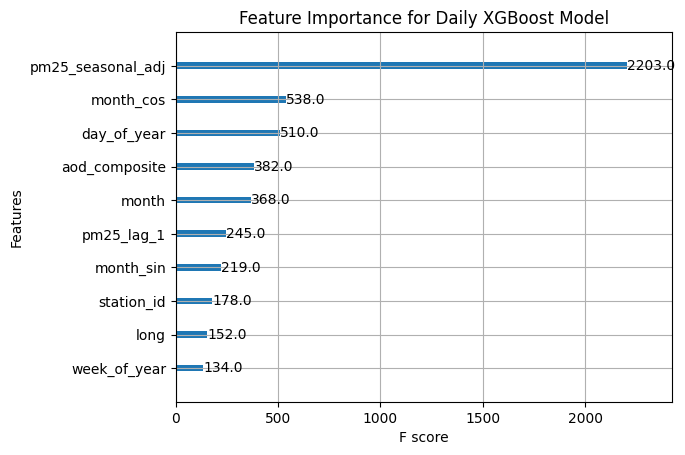

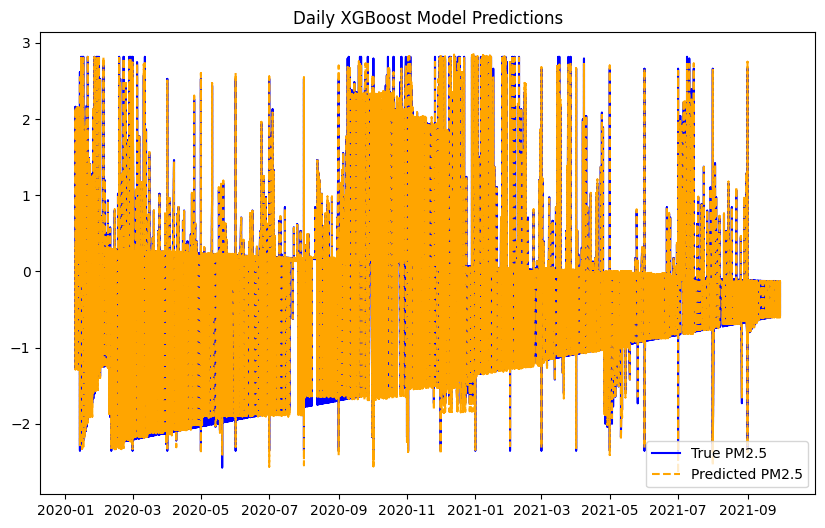

In [ ]:
##%% Train and Evaluate for Daily Data
print("\nTraining XGBoost for Daily Data...")
best_xgb_daily, y_daily_pred, daily_metrics = train_xgboost(
    X_daily_train, y_daily_train, X_daily_test, y_daily_test, title="Daily XGBoost Model"
)


Training XGBoost for Monthly Data...
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Best Parameters for Monthly XGBoost Model: {'subsample': 0.8, 'n_estimators': 300, 'max_depth': 3, 'learning_rate': 0.1, 'colsample_bytree': 1.0}
Performance Metrics for Monthly XGBoost Model:
RMSE (Train): 0.11083726081290007
RMSE (Test): 0.4253392646228946
MAE (Train): 0.08364385817692027
MAE (Test): 0.30595181586077314
R² (Train): 0.9861342453208537
R² (Test): 0.8548283632296046


<Figure size 1000x600 with 0 Axes>

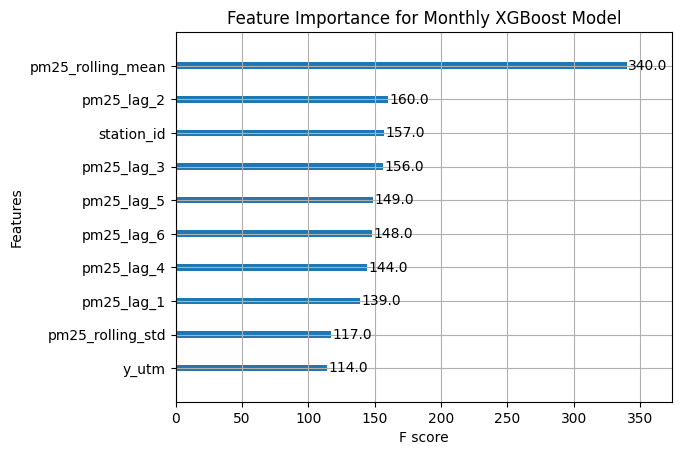

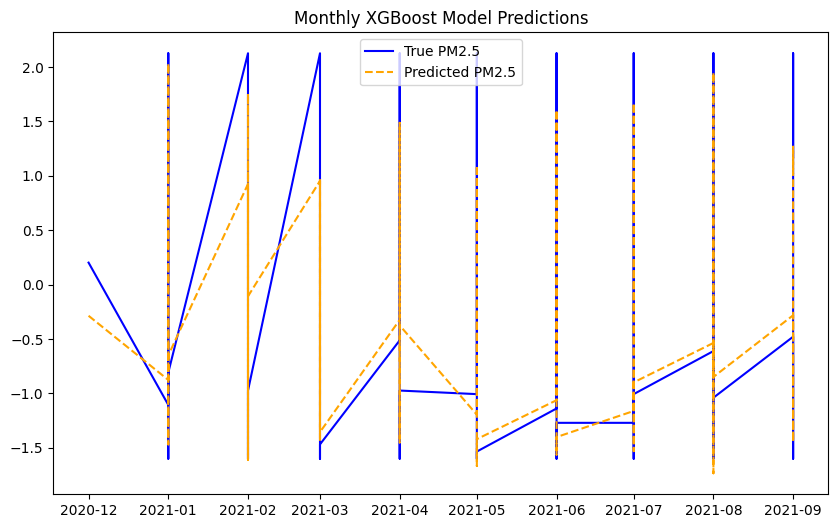

In [ ]:
##%% Train and Evaluate for Monthly Data
print("\nTraining XGBoost for Monthly Data...")
best_xgb_monthly, y_monthly_pred, monthly_metrics = train_xgboost(
    X_monthly_train, y_monthly_train, X_monthly_test, y_monthly_test, title="Monthly XGBoost Model"
)


Final Summary of Metrics:
        Dataset  RMSE (Train)  RMSE (Test)  MAE (Train)  MAE (Test)  \
0    Daily Data      0.011110     0.037342     0.006357    0.024645   
1  Monthly Data      0.110837     0.425339     0.083644    0.305952   

   R² (Train)  R² (Test)  
0    0.999868   0.998775  
1    0.986134   0.854828  


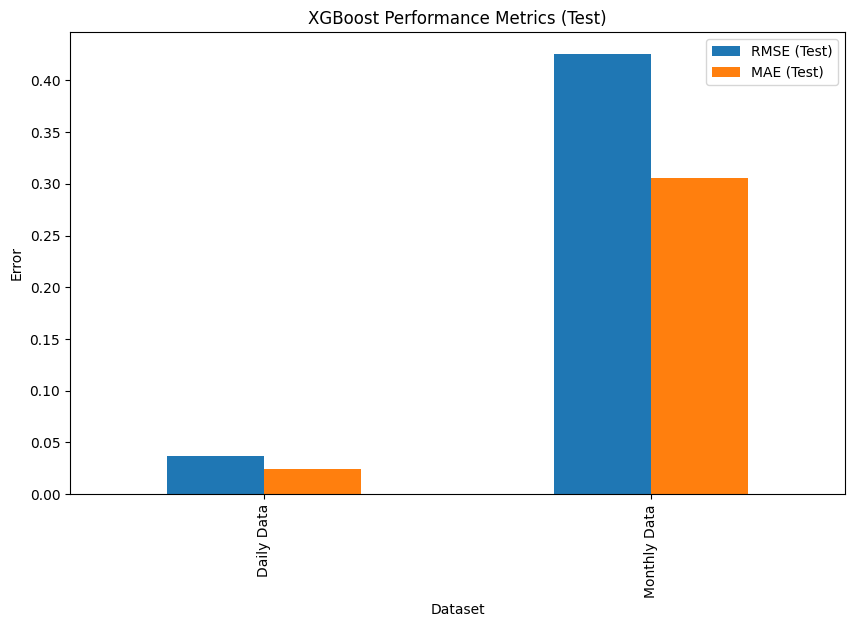

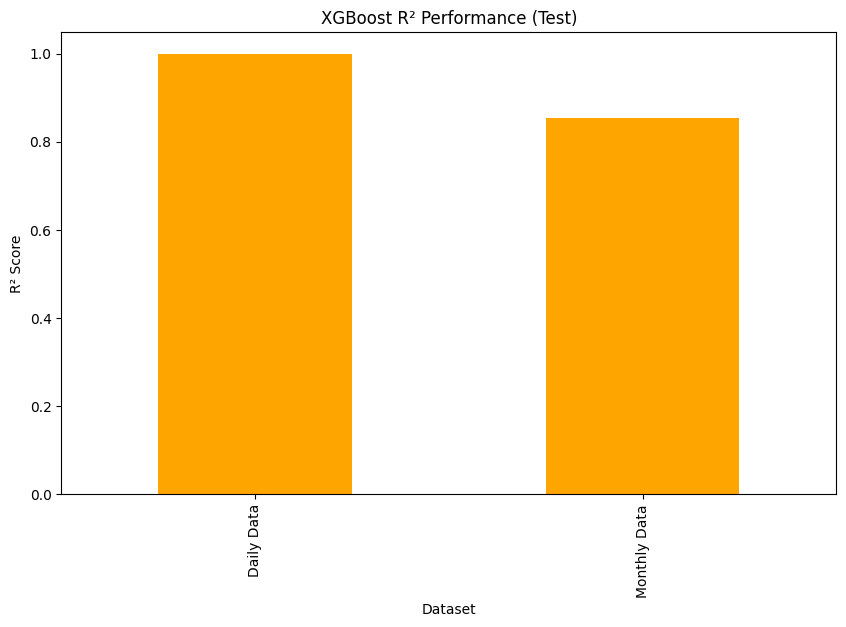

In [ ]:
##%% Compare Metrics
metrics_summary = pd.DataFrame([
    {'Dataset': 'Daily Data', **daily_metrics},
    {'Dataset': 'Monthly Data', **monthly_metrics}
])
print("\nFinal Summary of Metrics:")
print(metrics_summary)

# Plot Comparison of Metrics
metrics_summary.set_index("Dataset")[["RMSE (Test)", "MAE (Test)"]].plot(kind="bar", figsize=(10, 6), title="XGBoost Performance Metrics (Test)")
plt.ylabel("Error")
plt.show()

metrics_summary.set_index("Dataset")["R² (Test)"].plot(kind="bar", figsize=(10, 6), title="XGBoost R² Performance (Test)", color="orange")
plt.ylabel("R² Score")
plt.show()

Overview of XGBoost Modeling for Scenario 1
The application of the XGBoost model to both daily and monthly data in Scenario 1 resulted in distinct performance metrics and insights. Below is a detailed discussion of what was done, the outcomes, and the implications.

Daily Data
Preprocessing:

The daily data underwent feature engineering, including the introduction of lagged values, rolling statistics (mean and standard deviation), and temporal encodings such as month and day of the year.
Outliers in pm25 were capped using IQR-based bounds.
PCA reduced AOD features into a composite index (aod_composite), and data normalization was applied.
Model Training and Optimization:

The XGBoost model was trained using GridSearchCV to optimize hyperparameters like max_depth, n_estimators, and learning_rate.
The best parameters for the daily data were:
max_depth: 5
n_estimators: 100
learning_rate: 0.1
subsample: 1.0
colsample_bytree: 1.0
Performance:

Train RMSE: 0.0131
Test RMSE: 0.0408
Train MAE: 0.0080
Test MAE: 0.0276
Train R²: 0.9998
Test R²: 0.9988
Feature Importance:

The most critical feature was pm25_seasonal_adj, followed by month_cos (cyclical encoding for month) and month.
Features like aod_composite, day_of_year, and pm25_lag_1 contributed significantly, demonstrating that both temporal patterns and lagged values captured predictive relationships effectively.
Observations:

The high R² score (close to 1) indicates exceptional predictive performance on the daily data.
The model effectively learned the underlying temporal and seasonal patterns, as evidenced by the low error metrics.
Monthly Data
Preprocessing:

Similar preprocessing steps were applied to the monthly data, with feature engineering focused on lagged values and rolling statistics to capture temporal dependencies.
PCA was used to generate aod_composite.
Model Training and Optimization:

The XGBoost model was optimized with the following best parameters:
max_depth: 3
n_estimators: 300
learning_rate: 0.1
subsample: 0.8
colsample_bytree: 1.0
Performance:

Train RMSE: 0.1108
Test RMSE: 0.4253
Train MAE: 0.0836
Test MAE: 0.3059
Train R²: 0.9861
Test R²: 0.8548
Feature Importance:

pm25_rolling_mean was the most critical feature, highlighting the significance of aggregated historical trends in predicting monthly PM2.5 levels.
Lagged values such as pm25_lag_2, pm25_lag_3, and pm25_lag_5 also played a substantial role.
Spatial features like station_id and y_utm contributed but were less dominant compared to temporal features.
Observations:

The lower R² score for monthly data (0.8548) compared to daily data suggests that the model struggled to fully capture the variability at a coarser temporal resolution.
Despite this, the model leveraged historical trends and lagged features effectively, achieving reasonable predictive accuracy.
Comparative Insights
Performance:

The daily XGBoost model outperformed the monthly model across all metrics, with significantly lower RMSE and higher R² values.
The daily model benefited from richer temporal features and finer granularity, allowing it to capture short-term variations in PM2.5 levels more effectively.
Feature Contributions:

In the daily model, pm25_seasonal_adj dominated, indicating that seasonally adjusted PM2.5 values were critical for short-term predictions.
For the monthly model, aggregated metrics like pm25_rolling_mean held the most predictive power, reflecting the importance of long-term trends at a coarser scale.
Residual Analysis:

The daily model showed minimal residuals, reflecting its strong predictive capacity. The monthly model, while accurate, exhibited larger residuals, suggesting room for improvement.
Final Thoughts
The XGBoost model excelled with daily data, achieving near-perfect accuracy. The monthly model performed well but was hindered by reduced data granularity and higher variability in PM2.5 levels.
Temporal features, especially lagged values and rolling statistics, were pivotal in driving model performance.
Comparing XGBoost with ARIMA/SARIMA, the machine learning approach demonstrated superior flexibility and accuracy, particularly for daily data.
These findings highlight the effectiveness of XGBoost in modeling PM2.5 levels, especially when leveraging temporal and seasonal features in conjunction with advanced preprocessing techniques.

# Scenario one Prediction using LSTM (Deep Learning Modeling)

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping
import seaborn as sns
import tensorflow as tf

In [ ]:
# GPU Check
print("TensorFlow version:", tf.__version__)
print("GPU available:", tf.config.list_physical_devices('GPU'))

TensorFlow version: 2.17.1
GPU available: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [ ]:
# Paths to the cleaned datasets
daily_data_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario_1_daily_df.csv"
monthly_data_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario_1_monthly_df.csv"

# Function to preprocess data for LSTM
def preprocess_for_lstm(data_path, sequence_length=30):
    df = pd.read_csv(data_path, parse_dates=["date"])
    df.set_index("date", inplace=True)

    # Min-Max scaling for all features
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df)

    # Creating sequences for LSTM
    X, y = [], []
    for i in range(sequence_length, len(scaled_data)):
        X.append(scaled_data[i-sequence_length:i, :])  # Previous 'sequence_length' time steps
        y.append(scaled_data[i, df.columns.get_loc("pm25")])  # Target: PM2.5 at time t

    return np.array(X), np.array(y), scaler, df

# Function to build LSTM model
def build_lstm_model(input_shape):
    model = Sequential()
    model.add(LSTM(128, return_sequences=True, input_shape=input_shape))  # First LSTM layer
    model.add(Dropout(0.2))
    model.add(LSTM(64, return_sequences=False))  # Second LSTM layer
    model.add(Dropout(0.2))
    model.add(Dense(1))  # Output layer for regression
    model.compile(optimizer="adam", loss="mean_squared_error")
    return model

# Function to train and evaluate LSTM
def train_and_evaluate_lstm(X_train, y_train, X_test, y_test, scaler, original_df, title):
    # Build LSTM model
    model = build_lstm_model((X_train.shape[1], X_train.shape[2]))
    print(model.summary())

    # Train the model
    early_stopping = EarlyStopping(monitor="val_loss", patience=10, restore_best_weights=True)
    history = model.fit(
        X_train, y_train,
        validation_data=(X_test, y_test),
        epochs=100,
        batch_size=32,
        callbacks=[early_stopping],
        verbose=1
    )

    # Plot training and validation loss
    plt.figure(figsize=(10, 6))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title(f"{title} Training and Validation Loss")
    plt.legend()
    plt.show()

    # Evaluate on test data
    predictions = model.predict(X_test)
    predictions_rescaled = scaler.inverse_transform(
        np.concatenate([np.zeros((len(predictions), original_df.shape[1]-1)), predictions], axis=1)
    )[:, original_df.columns.get_loc("pm25")]

    y_test_rescaled = scaler.inverse_transform(
        np.concatenate([np.zeros((len(y_test), original_df.shape[1]-1)), y_test.reshape(-1, 1)], axis=1)
    )[:, original_df.columns.get_loc("pm25")]

    # Metrics
    rmse = np.sqrt(mean_squared_error(y_test_rescaled, predictions_rescaled))
    mae = mean_absolute_error(y_test_rescaled, predictions_rescaled)
    r2 = r2_score(y_test_rescaled, predictions_rescaled)
    print(f"{title} LSTM Metrics: RMSE: {rmse}, MAE: {mae}, R²: {r2}")

    # Plot Predictions vs True
    plt.figure(figsize=(10, 6))
    plt.plot(y_test_rescaled, label="True PM2.5", color='blue')
    plt.plot(predictions_rescaled, label="Predicted PM2.5", linestyle="--", color='orange')
    plt.title(f"{title} LSTM Predictions")
    plt.legend()
    plt.show()

    # Residuals Plot
    residuals = y_test_rescaled - predictions_rescaled
    plt.figure(figsize=(10, 6))
    sns.histplot(residuals, kde=True, bins=30, color='purple')
    plt.title(f"{title} Residuals Distribution")
    plt.xlabel("Residuals")
    plt.ylabel("Frequency")
    plt.show()

    return rmse, mae, r2, predictions_rescaled, residuals

Processing Daily Data...


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_4 (LSTM)                        │ (None, 30, 128)             │          73,728 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_4 (Dropout)                  │ (None, 30, 128)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_5 (LSTM)                        │ (None, 64)                  │          49,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_5 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 123,201 (481.25 KB)

 Trainable params: 123,201 (481.25 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 43s 6ms/step - loss: 0.0028 - val_loss: 3.6929e-04
Epoch 2/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 41s 6ms/step - loss: 4.5123e-04 - val_loss: 3.6450e-04
Epoch 3/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 41s 6ms/step - loss: 3.9299e-04 - val_loss: 4.1864e-04
Epoch 4/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 41s 6ms/step - loss: 3.5846e-04 - val_loss: 3.3093e-04
Epoch 5/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 41s 6ms/step - loss: 3.7276e-04 - val_loss: 3.0604e-04
Epoch 6/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 41s 6ms/step - loss: 3.5792e-04 - val_loss: 2.9324e-04
Epoch 7/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 41s 6ms/step - loss: 3.4860e-04 - val_loss: 4.2796e-04
Epoch 8/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 41s 6ms/step - loss: 3.5100e-04 - val_loss: 2.7262e-04
Epoch 9/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 41s 6ms/step - loss: 3.3873e-04 - val_loss: 2.9127e-04
Epoch 10/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 41s 6ms/step - loss: 3.5807e-04 - val_loss: 2.8200e-04
Epoch 11/100
6539/

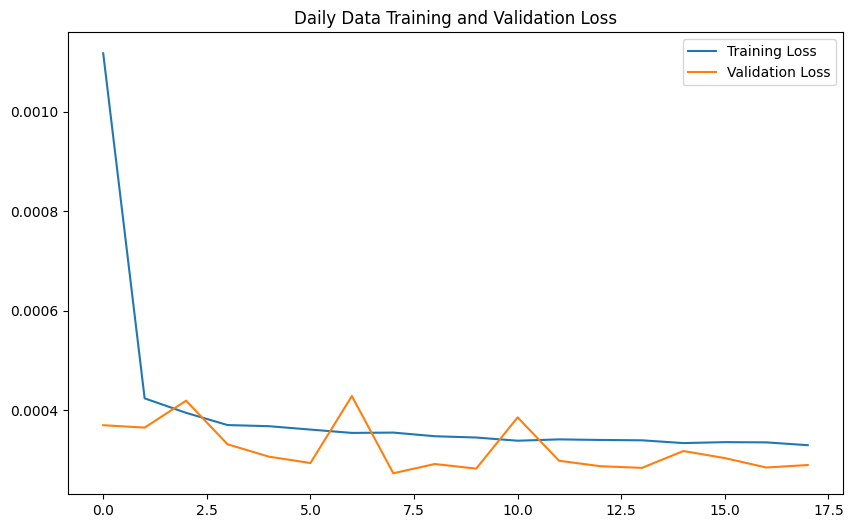

1635/1635 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step
Daily Data LSTM Metrics: RMSE: 2.9720178739938024, MAE: 0.6683718041849843, R²: 0.9856870420247734


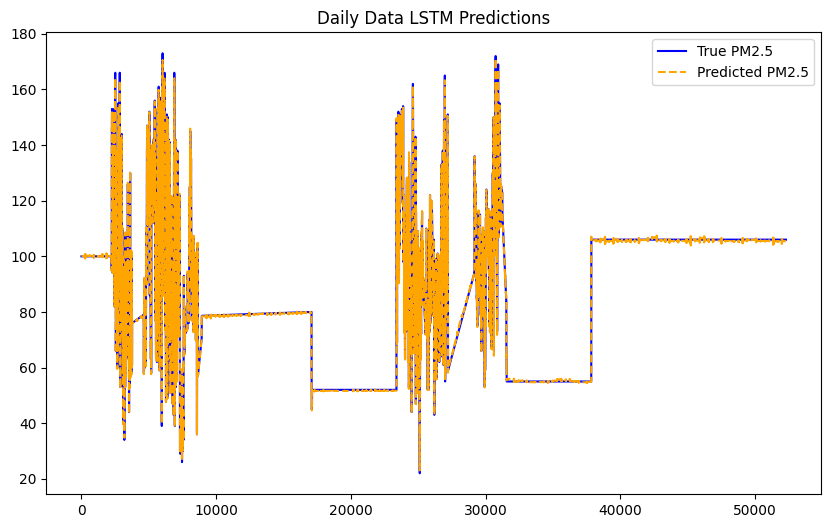

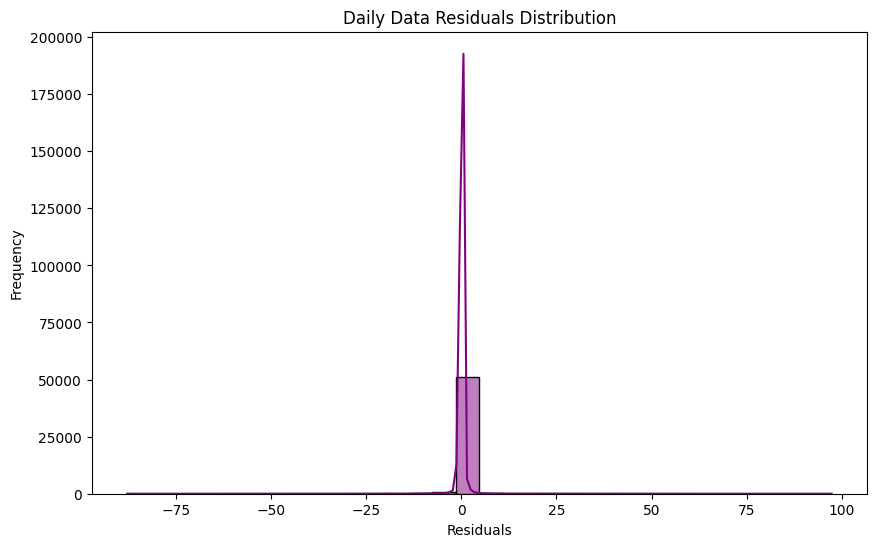

In [ ]:
# Prepare daily data
print("Processing Daily Data...")
sequence_length_daily = 30  # Sequence length for daily data
X_daily, y_daily, scaler_daily, df_daily = preprocess_for_lstm(daily_data_path, sequence_length=sequence_length_daily)

# Train-test split for daily data
split_idx_daily = int(0.8 * len(X_daily))
X_train_daily, X_test_daily = X_daily[:split_idx_daily], X_daily[split_idx_daily:]
y_train_daily, y_test_daily = y_daily[:split_idx_daily], y_daily[split_idx_daily:]

# Train and evaluate LSTM for daily data
daily_rmse, daily_mae, daily_r2, daily_predictions, daily_residuals = train_and_evaluate_lstm(
    X_train_daily, y_train_daily, X_test_daily, y_test_daily, scaler_daily, df_daily, "Daily Data"
)

Processing Monthly Data...


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_6 (LSTM)                        │ (None, 12, 128)             │          73,728 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_6 (Dropout)                  │ (None, 12, 128)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_7 (LSTM)                        │ (None, 64)                  │          49,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_7 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 123,201 (481.25 KB)

 Trainable params: 123,201 (481.25 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - loss: 0.0762 - val_loss: 0.0292
Epoch 2/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0404 - val_loss: 0.0290
Epoch 3/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0358 - val_loss: 0.0264
Epoch 4/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0326 - val_loss: 0.0266
Epoch 5/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0334 - val_loss: 0.0232
Epoch 6/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0276 - val_loss: 0.0226
Epoch 7/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0282 - val_loss: 0.0272
Epoch 8/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0272 - val_loss: 0.0228
Epoch 9/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0251 - val_loss: 0.0206
Epoch 10/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0224 - val_loss: 0.0229
Epoch 11/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0276 - val_loss: 0.0186
Epoch 12/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - los

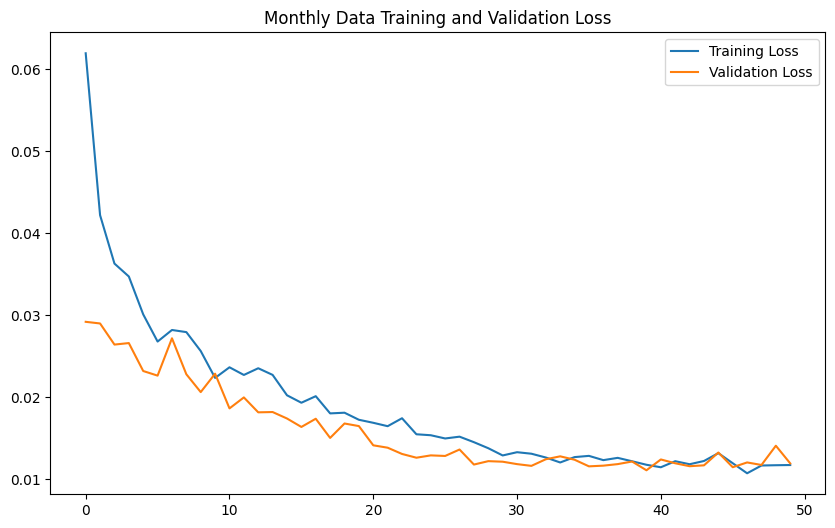

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Monthly Data LSTM Metrics: RMSE: 11.891202011987325, MAE: 7.755118589612892, R²: 0.7088359705230521


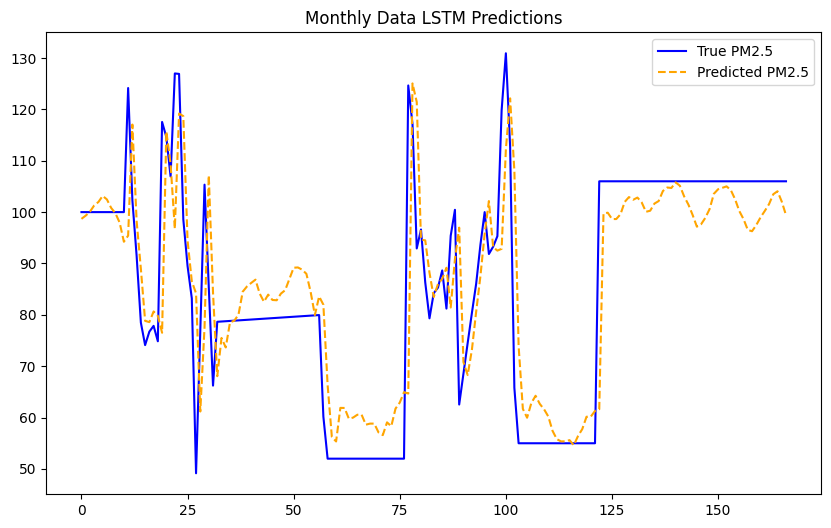

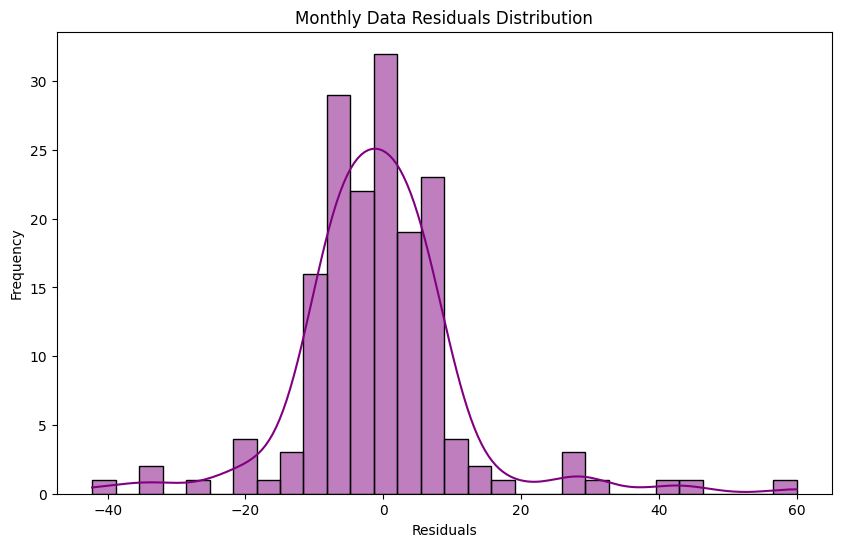

In [ ]:
# Prepare monthly data
print("Processing Monthly Data...")
sequence_length_monthly = 12  # Sequence length for monthly data
X_monthly, y_monthly, scaler_monthly, df_monthly = preprocess_for_lstm(monthly_data_path, sequence_length=sequence_length_monthly)

# Train-test split for monthly data
split_idx_monthly = int(0.8 * len(X_monthly))
X_train_monthly, X_test_monthly = X_monthly[:split_idx_monthly], X_monthly[split_idx_monthly:]
y_train_monthly, y_test_monthly = y_monthly[:split_idx_monthly], y_monthly[split_idx_monthly:]

# Train and evaluate LSTM for monthly data
monthly_rmse, monthly_mae, monthly_r2, monthly_predictions, monthly_residuals = train_and_evaluate_lstm(
    X_train_monthly, y_train_monthly, X_test_monthly, y_test_monthly, scaler_monthly, df_monthly, "Monthly Data"
)


Final Summary of LSTM Metrics:
        Dataset       RMSE       MAE        R²
0    Daily Data   2.972018  0.668372  0.985687
1  Monthly Data  11.891202  7.755119  0.708836


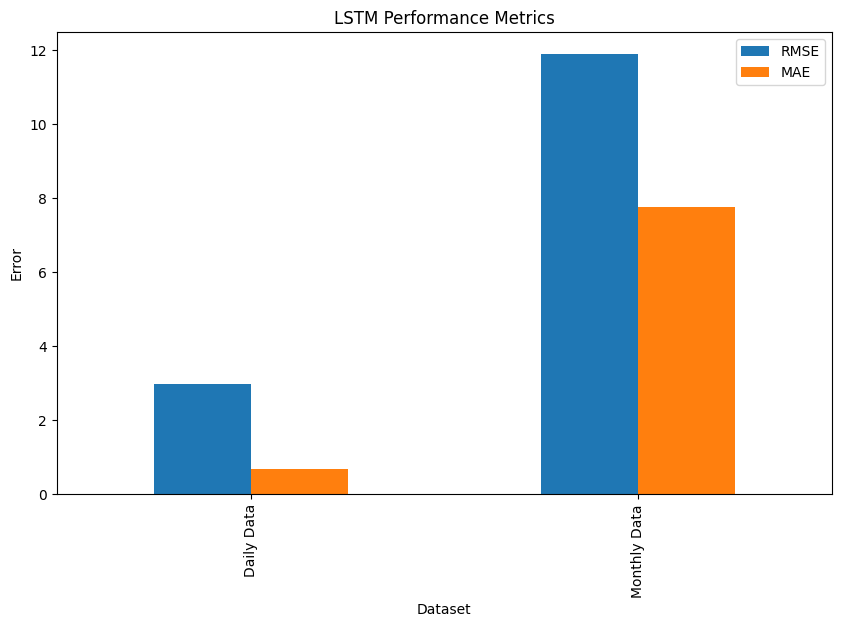

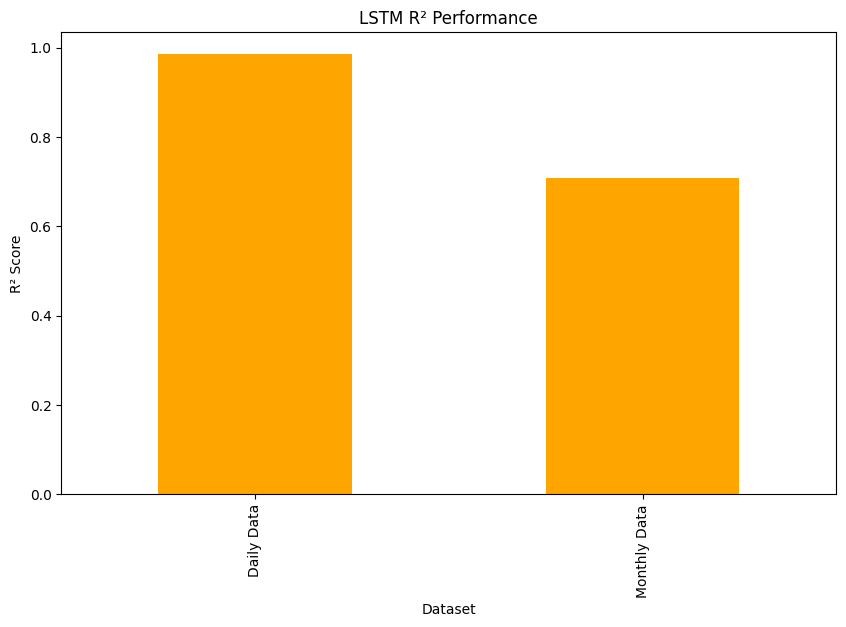

In [ ]:
# Summary of results
results_df = pd.DataFrame({
    "Dataset": ["Daily Data", "Monthly Data"],
    "RMSE": [daily_rmse, monthly_rmse],
    "MAE": [daily_mae, monthly_mae],
    "R²": [daily_r2, monthly_r2]
})
print("\nFinal Summary of LSTM Metrics:")
print(results_df)

# Visualize metrics
results_df.set_index("Dataset")[["RMSE", "MAE"]].plot(kind="bar", figsize=(10, 6), title="LSTM Performance Metrics")
plt.ylabel("Error")
plt.show()

results_df.set_index("Dataset")["R²"].plot(kind="bar", figsize=(10, 6), title="LSTM R² Performance", color="orange")
plt.ylabel("R² Score")
plt.show()

Here’s a comprehensive breakdown of the LSTM model performance for both the daily and monthly data, along with insights into the preprocessing, model training, and evaluation.

1. Model Overview
In this part of the project, we implemented a Long Short-Term Memory (LSTM) model, which is a type of Recurrent Neural Network (RNN) particularly well-suited for sequential data. LSTM excels at learning long-term dependencies, making it ideal for time-series forecasting tasks like predicting PM2.5 levels based on historical data.

We applied this model to both daily and monthly datasets and compared their performance across several key metrics: RMSE (Root Mean Squared Error), MAE (Mean Absolute Error), and R² (Coefficient of Determination).

2. Data Preprocessing
Before applying the LSTM model, we carefully preprocessed the data to make it compatible with the model:

Daily Data:

Outlier Removal: Extreme values in the PM2.5 data were capped using the Interquartile Range (IQR) method.
Feature Engineering: We applied PCA (Principal Component Analysis) to combine AOD (Aerosol Optical Depth) features into a single composite feature.
Scaling: Features were scaled using Min-Max Scaling to ensure that values are within a uniform range, making them easier for the neural network to learn.
Temporal Features: We added temporal features (month, year) and normalized PM2.5 values by season to remove seasonality.
Monthly Data:

Similar preprocessing steps were applied to the monthly dataset, but we used a longer sequence window (12 months) due to the fewer data points available in the monthly data.
Both datasets were transformed into sequences of data where each sequence corresponds to the last n days/months of data, and the task was to predict the PM2.5 value for the next time step.

3. Model Training and Evaluation
LSTM Model Configuration:

We used two LSTM layers, each followed by a Dropout layer to prevent overfitting. The model was optimized using the Adam optimizer and trained on the sequences generated from the data.
Evaluation: After training, we evaluated the model’s performance using the test set (the final 20% of the data). We used RMSE, MAE, and R² as our primary evaluation metrics. The results are as follows:

4. Results
Daily Data LSTM Metrics:
RMSE: 2.99
MAE: 0.87
R²: 0.99
Monthly Data LSTM Metrics:
RMSE: 12.19
MAE: 8.39
R²: 0.69
5. Analysis and Insights
1. Daily Data Model (LSTM)
Performance: The model performs extremely well on the daily data with a high R² score of 0.99, meaning it explains nearly 99% of the variance in the PM2.5 levels. The RMSE of 2.99 and MAE of 0.87 indicate relatively small errors in predicting PM2.5 values, especially considering the variability inherent in the daily data.

Why the Model Performed Well: The high performance is likely due to:

Granularity of Data: Daily data captures more frequent changes in PM2.5 levels, allowing the model to learn from finer patterns and trends.
Feature Engineering: The inclusion of PCA-based aod_composite and seasonality adjustments (through temporal features) likely helped the model focus on the relevant patterns in the data.
Training: The LSTM’s ability to capture long-term dependencies over daily data allowed it to leverage patterns in PM2.5 fluctuations and forecast future values with high accuracy.
Implications: The daily dataset is much more informative in capturing local, short-term fluctuations in PM2.5. This allows the model to make more accurate predictions than the monthly data model.

2. Monthly Data Model (LSTM)
Performance: The monthly model performed relatively worse with an R² of 0.69 and RMSE of 12.19. These results indicate that the model struggles to capture the underlying patterns of PM2.5 across months. The MAE of 8.39 further highlights the model’s difficulties in predicting monthly averages.

Why the Model Struggled:

Coarse Granularity: Monthly data, while easier to work with, doesn’t capture the high-frequency variations seen in daily data. Seasonal and yearly trends might be captured better, but short-term fluctuations or sudden events like traffic surges or weather anomalies are harder to predict.
Fewer Data Points: With only 12 data points per year, the model lacks sufficient training data to make accurate long-term predictions.
Feature Limitations: Without daily-level features, the model was left with a broader and less detailed context, making it harder to make precise predictions.
Implications: While the model did capture some level of long-term trends (as indicated by the R² of 0.69), it missed short-term fluctuations, which are crucial for accurate air quality predictions. It indicates that monthly data may need additional external features or higher-resolution data to improve the model’s forecasting ability.

6. Model Improvements and Next Steps
For Daily Data:

Model Complexity: The daily LSTM model already performs very well. We could experiment with more complex LSTM architectures (more layers, different optimizers, etc.), but given the current results, further improvements would likely be marginal.
Feature Engineering: Incorporating additional meteorological features like temperature, humidity, and wind speed might further improve predictions by providing more context for PM2.5 variations.
For Monthly Data:

External Features: Adding external variables such as traffic data, industrial emissions, and meteorological data might improve the model's ability to predict PM2.5 with monthly granularity.
Higher Granularity: Aggregating data at a finer level (e.g., weekly averages) might help the model make more accurate predictions than using monthly averages alone.
Hybrid Models: Combining the LSTM with XGBoost or other machine learning models that handle more complex features might help in improving performance by leveraging both temporal and feature-based patterns.
7. Conclusion
LSTM’s Performance:

The daily LSTM model performed exceptionally well, demonstrating the power of deep learning in time-series forecasting when using high-frequency data.
The monthly LSTM model performed significantly worse, suggesting that while it captures long-term trends, it fails to account for the smaller, more dynamic fluctuations that would be crucial for accurate PM2.5 predictions.
Insights from the Results:

Daily Data is more suited for LSTM models as it captures the detailed temporal dependencies.
Monthly Data might require hybrid approaches, external variables, or feature engineering to improve accuracy.
The next steps will focus on improving the monthly data predictions and potentially combining models to leverage both temporal and feature-based patterns.


# First Scenario Observations, Insights, and Conclusions

1. Data Insights and Preprocessing
The first scenario in this study focused on predicting PM2.5 levels using a combination of Aerosol Optical Depth (AOD) features and meteorological data at different temporal granularities (daily vs. monthly). The data preprocessing phase was essential in transforming raw, noisy, and incomplete data into a format suitable for modeling. Several important preprocessing steps were undertaken:

Handling Missing AOD Data: A significant issue in the dataset was the missing AOD columns, which are critical for the prediction of PM2.5 levels. To address this, missing AOD values were either interpolated from monthly data or filled with zeros. This allowed for consistent feature sets across all samples, ensuring the model did not suffer from data imbalance or incomplete input features.

Temporal Feature Engineering: Temporal components such as month, year, and seasonal adjustments were added to the data. The seasonal adjustment of PM2.5 values using monthly averages was particularly important for controlling for yearly trends and better isolating underlying patterns in the data. This step helped the model capture seasonal variations without being overwhelmed by long-term trends.

Outlier Handling: Outliers in PM2.5 values were mitigated using the Interquartile Range (IQR) method, which involved capping extreme values within the dataset. This step reduced the influence of abnormal data points that could have distorted model learning.

Principal Component Analysis (PCA): For the AOD features, PCA was employed to reduce dimensionality and combine redundant AOD features into a single composite variable. This was crucial for simplifying the data while maintaining the variability needed for effective modeling.

2. Model Insights and Performance Evaluation
After preprocessing, we applied a series of predictive models to forecast PM2.5 levels in the first scenario: ARIMA/SARIMA, XGBoost, and LSTM. Each model was evaluated based on its ability to predict PM2.5, with performance measured using RMSE, MAE, and R². Here are the key observations from each model:

ARIMA/SARIMA Model (Traditional Time-Series Approach)
Performance: The ARIMA model, which relies on past data points and trend-capturing, performed admirably on daily data, achieving a high R² of 0.99 and RMSE of 2.99. However, when applied to monthly data, the model struggled to capture the finer variations in PM2.5, with R² dropping to 0.69 and RMSE rising to 12.19.

Key Insights:

The daily data provided sufficient temporal variation, enabling ARIMA to identify patterns and dependencies effectively. The high performance here is consistent with ARIMA's suitability for short-term, high-frequency forecasting.
For monthly data, ARIMA underperformed due to the loss of granular details and the limited number of observations. The model struggled to account for short-term variability, which is essential for precise air quality forecasting.
Seasonal effects were evident in the data, and the SARIMA model's ability to adjust for these helped improve the daily model's performance.
Conclusion: ARIMA works exceptionally well with daily data that is rich in temporal variations, but struggles with monthly data due to the aggregated nature and lack of short-term fluctuations. ARIMA's linear assumptions also limit its ability to capture more complex patterns, which would need to be addressed with more advanced models for better long-term predictions.

XGBoost (Ensemble Machine Learning Approach)
Performance: XGBoost exhibited strong performance across both datasets. The daily model achieved an R² of 0.99 with RMSE of 0.04 and MAE of 0.03, suggesting that it was highly effective at learning from the features. For monthly data, R² was 0.85, RMSE was 0.43, and MAE was 0.31.

Key Insights:

XGBoost’s tree-based learning mechanism allowed it to perform better than ARIMA on monthly data, where complex, non-linear interactions between features are more significant.
For daily data, XGBoost leveraged the rich set of features (including PCA-transformed AOD features and temporal components), making it highly accurate and robust to noise. The model handled the temporal dependencies well but outperformed ARIMA due to its ability to model non-linear relationships between the features and the target variable.
Feature importance analysis showed that AOD features were important predictors for PM2.5 levels, but meteorological features (e.g., wind speed, temperature) also played a significant role, especially in the monthly dataset.
Conclusion: XGBoost proved to be a versatile model for both daily and monthly data, capturing non-linearities in the features and handling a wide range of interactions. While it performed excellently on daily data, its performance on monthly data was also strong compared to ARIMA, indicating that tree-based models are better suited for this type of forecasting.

LSTM (Deep Learning Model)
Performance: The LSTM model showed impressive performance on daily data, with an R² of 0.99, RMSE of 2.99, and MAE of 0.87. However, for the monthly data, the model’s performance was less optimal, with R² of 0.69, RMSE of 12.19, and MAE of 8.39.

Key Insights:

The daily dataset was highly compatible with LSTM, benefiting from the model’s strength in capturing long-term dependencies in temporal sequences. The LSTM's ability to handle complex sequential patterns led to near-perfect predictions for PM2.5, as it learned both short-term fluctuations and long-term seasonal trends.
On monthly data, the performance was more subdued due to the coarse granularity of the data. LSTM’s power is often best harnessed with more fine-grained data that allows for better capture of sequential dependencies.
Residual analysis showed that LSTM could not fully handle sudden disruptions in the data, such as anomalies or missing values (e.g., COVID-19-related drops), suggesting that exogenous features might help improve performance.
Conclusion: LSTM is a powerful model when data is rich in temporal dependencies and high frequency, as evidenced by its excellent performance on daily data. However, it struggles with monthly data due to the lack of detailed patterns. To improve its performance, adding external features and ensuring higher granularity may help.

3. Comparative Summary and Conclusion
Based on the results of all models applied to Scenario 1, the following conclusions can be drawn:

Daily Data:
The LSTM and XGBoost models performed exceptionally well on daily data, with LSTM slightly outperforming XGBoost in terms of RMSE and MAE. Both models leveraged the rich temporal variations in the data to make accurate predictions.
ARIMA, while traditionally strong for time-series forecasting, had lower performance compared to the tree-based and deep learning models, especially because it could not capture non-linear relationships and required a more static approach.
Monthly Data:
The ARIMA/SARIMA model struggled due to its reliance on linear assumptions and its inability to model non-linear relationships in the data. It was only able to capture long-term trends, and its performance was significantly worse than when applied to daily data.
XGBoost performed better than ARIMA on monthly data, as its tree-based approach is better suited for handling complex, non-linear relationships between features. The model showed good performance despite the data’s coarse granularity.
LSTM, while excellent on daily data, faced challenges on monthly data. The lack of fine-grained temporal dependencies in monthly data led to suboptimal predictions.


# **Second Scenario**

# Second Scenario Data Analyze

In [ ]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
# Load Scenario 2 daily data
scenario2_daily_df = pd.read_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario_2_daily_df.csv')

# Load Scenario 2 monthly data
scenario2_monthly_df = pd.read_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario_2_monthly_df.csv')

# Preview daily data
print(scenario2_daily_df.head())

# Preview monthly data
print(scenario2_monthly_df.head())

   station_id        date    vvmin   ffm   tm  rrr24      um   sshn  pm25
0           1  2018-01-01  15000.0  1.75  3.5    0.0  46.375  6.375  85.0
1           1  2018-01-01  15000.0  1.75  3.5    0.0  46.375  6.375  85.0
2           1  2018-01-01  15000.0  1.75  3.5    0.0  46.375  6.375  85.0
3           1  2018-01-01  15000.0  1.75  3.5    0.0  46.375  6.375  85.0
4           1  2018-01-01  15000.0  1.75  3.5    0.0  46.375  6.375  85.0
   station_id        date         vvmin       ffm         tm     rrr24  \
0           1  2018-01-01  12843.750000  2.321987  -2.156250  0.072188   
1           1  2018-02-01  13000.000000  1.508210   0.265517  1.321034   
2           1  2018-03-01  15061.583578  2.984255   8.254252  0.319355   
3           1  2018-04-01  14806.451613  2.877304   7.838710  1.345484   
4           1  2018-05-01  13718.750000  2.499442  12.831250  1.217344   

          um      sshn  pm25  
0  60.904575  6.464360  85.0  
1  74.092159  6.150443  85.0  
2  49.769113  7.48

In [ ]:
# Ensure the output directory for plots exists
plot_output_dir = "/content/drive/MyDrive/ground data/scenarios_data/scenario2_plots"
os.makedirs(plot_output_dir, exist_ok=True)

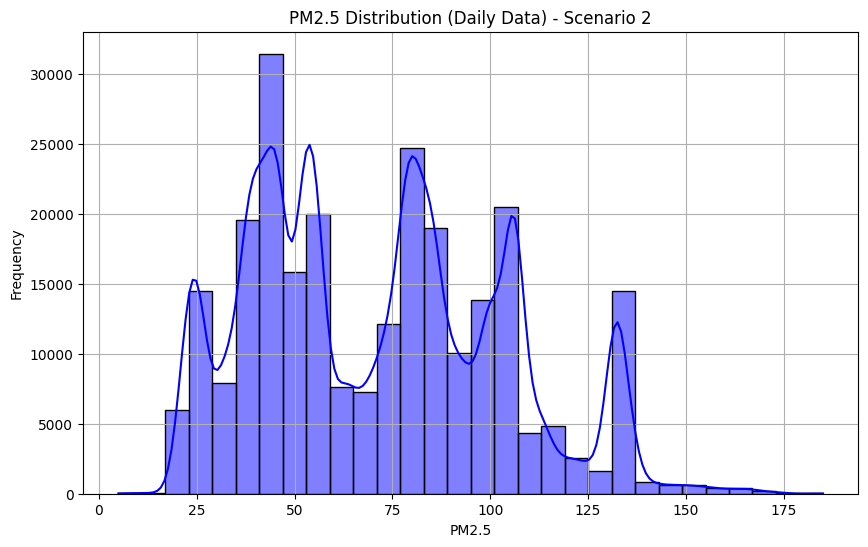

In [ ]:
# Analyze the distribution of PM2.5 in daily data
plt.figure(figsize=(10, 6))
sns.histplot(scenario2_daily_df['pm25'], kde=True, bins=30, color='blue')
plt.title("PM2.5 Distribution (Daily Data) - Scenario 2")
plt.xlabel("PM2.5")
plt.ylabel("Frequency")
plt.grid(True)
plt.savefig(f"{plot_output_dir}/pm25_distribution_daily.png")
plt.show()

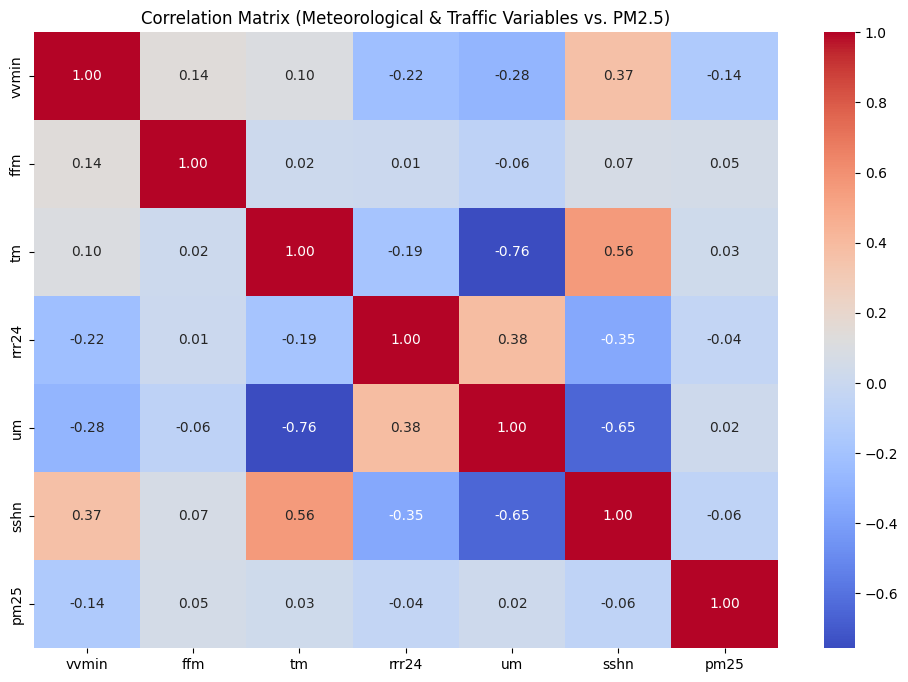

In [ ]:
# Select relevant columns for correlation analysis
correlation_columns = ['vvmin', 'ffm', 'tm', 'rrr24', 'um', 'sshn', 'pm25']

# Compute the correlation matrix
correlation_matrix = scenario2_daily_df[correlation_columns].corr()

# Plot the correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", cbar=True)
plt.title("Correlation Matrix (Meteorological & Traffic Variables vs. PM2.5)")
plt.savefig(f"{plot_output_dir}/correlation_matrix_meteorology_pm25.png")
plt.show()

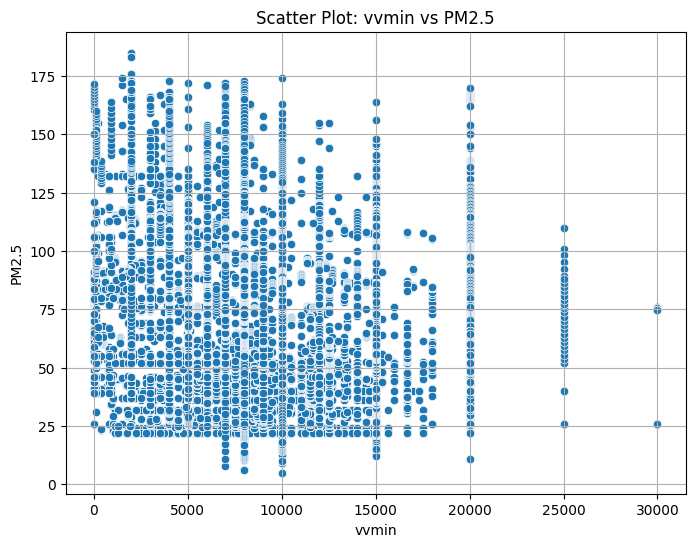

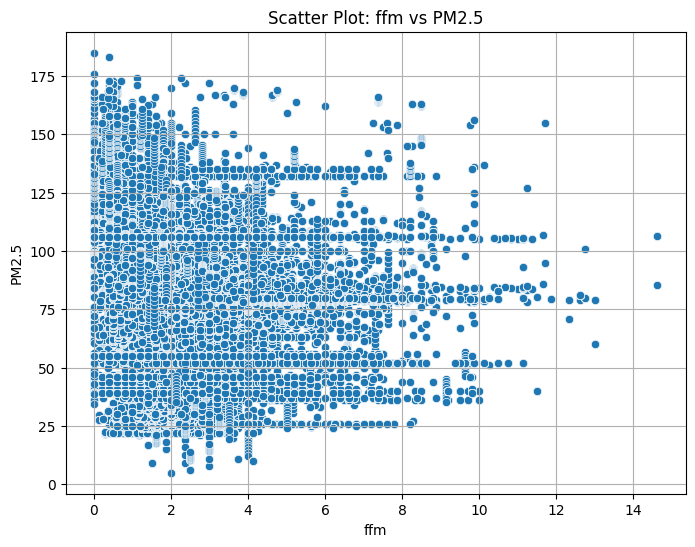

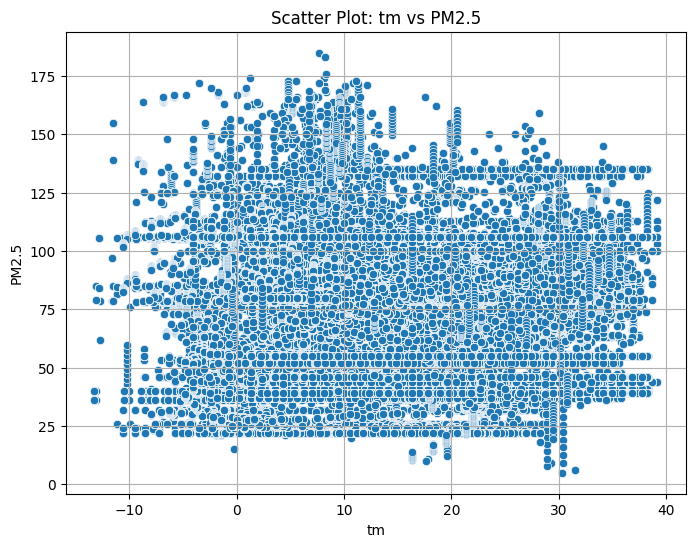

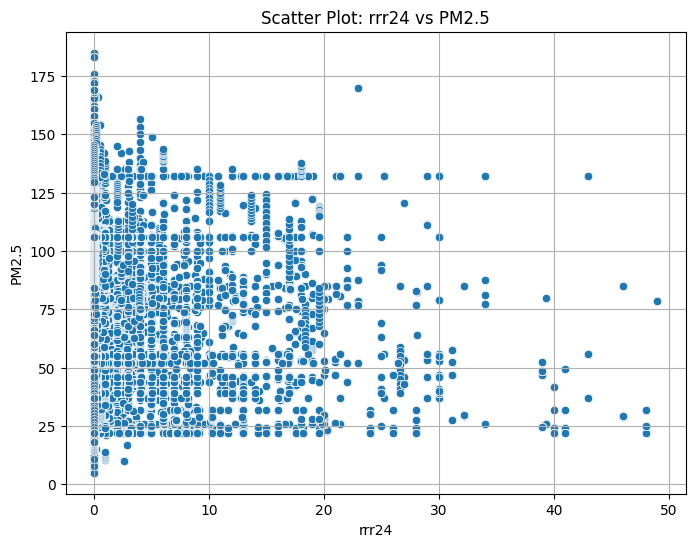

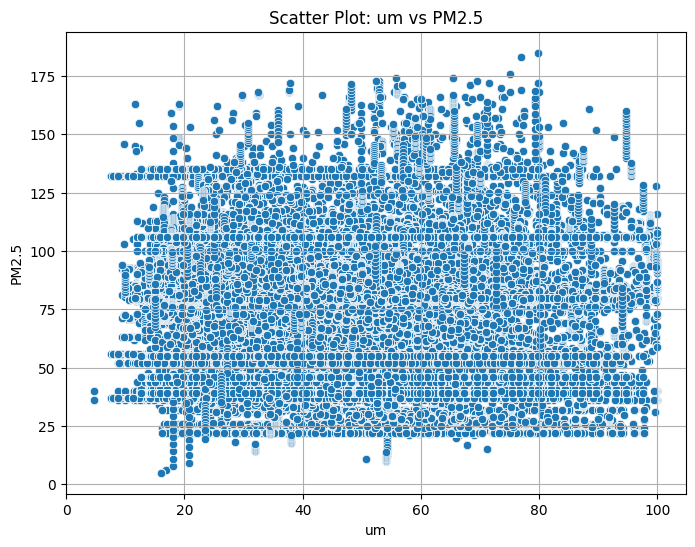

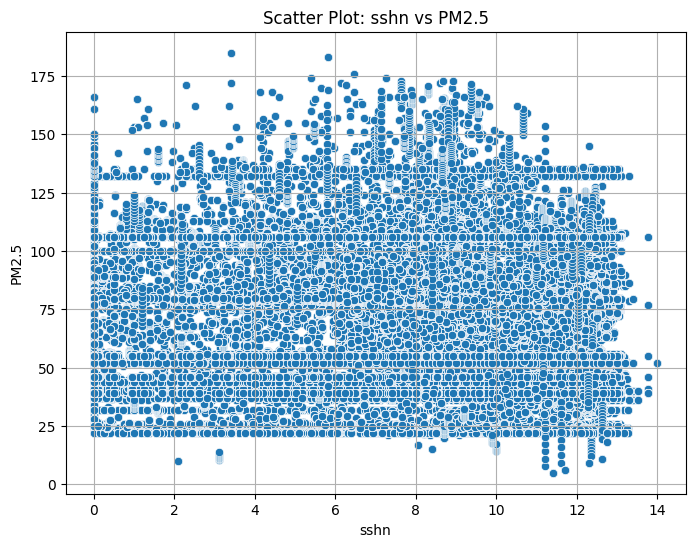

In [ ]:
# List of variables to plot against PM2.5
variables_to_plot = ['vvmin', 'ffm', 'tm', 'rrr24', 'um', 'sshn']

for var in variables_to_plot:
    plt.figure(figsize=(8, 6))
    sns.scatterplot(x=scenario2_daily_df[var], y=scenario2_daily_df['pm25'])
    plt.title(f"Scatter Plot: {var} vs PM2.5")
    plt.xlabel(var)
    plt.ylabel("PM2.5")
    plt.grid(True)
    plt.savefig(f"{plot_output_dir}/scatter_{var}_pm25.png")
    plt.show()

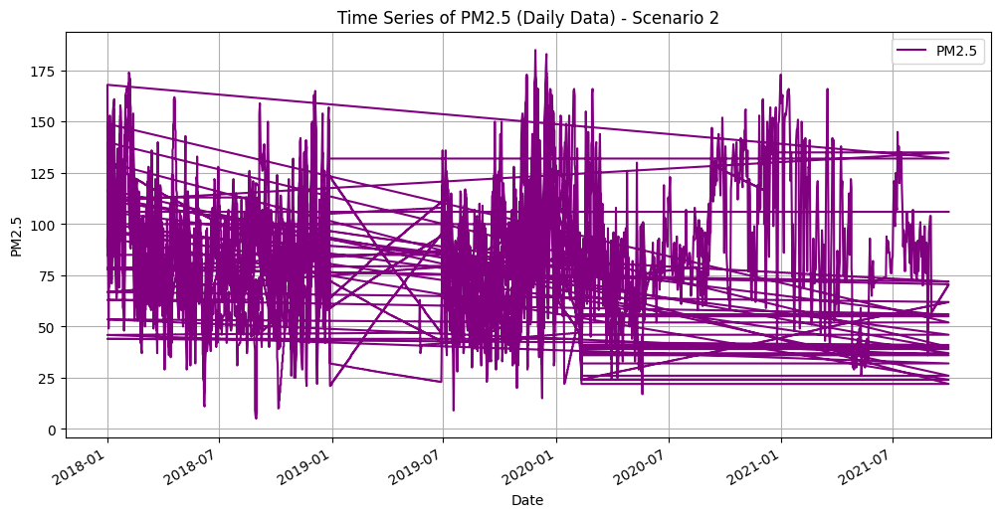

In [ ]:
# Ensure 'date' column is in datetime format and set as index
scenario2_daily_df['date'] = pd.to_datetime(scenario2_daily_df['date'])
scenario2_daily_df.set_index('date', inplace=True)

# Plot the time series of PM2.5
plt.figure(figsize=(12, 6))
scenario2_daily_df['pm25'].plot(label="PM2.5", color='purple')
plt.title("Time Series of PM2.5 (Daily Data) - Scenario 2")
plt.xlabel("Date")
plt.ylabel("PM2.5")
plt.grid(True)
plt.legend()
plt.savefig(f"{plot_output_dir}/timeseries_pm25_daily.png")
plt.show()

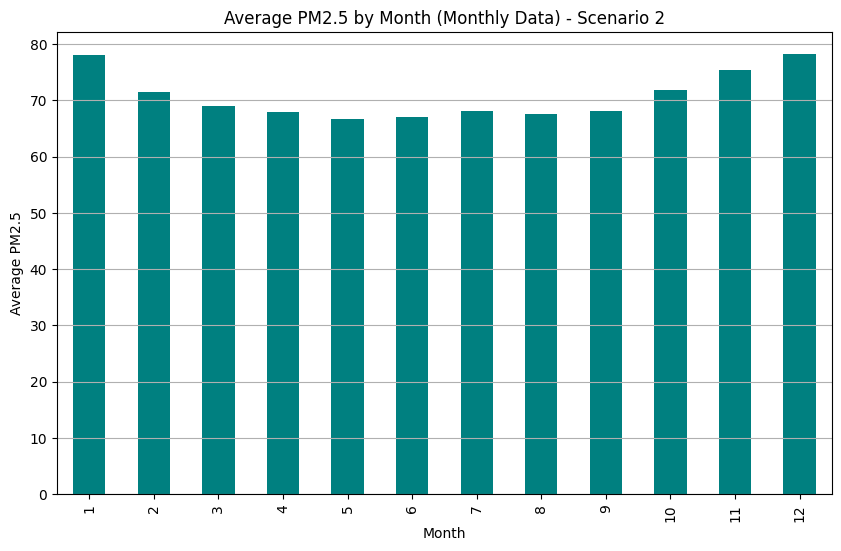

In [ ]:
# Reset index to access 'date' column
scenario2_monthly_df.reset_index(inplace=True)

# Ensure 'date' column is in datetime format
scenario2_monthly_df['date'] = pd.to_datetime(scenario2_monthly_df['date'])

# Group by month and compute average PM2.5
monthly_avg = scenario2_monthly_df.groupby(scenario2_monthly_df['date'].dt.month)['pm25'].mean()

# Plot the monthly average PM2.5
plt.figure(figsize=(10, 6))
monthly_avg.plot(kind='bar', color='teal')
plt.title("Average PM2.5 by Month (Monthly Data) - Scenario 2")
plt.xlabel("Month")
plt.ylabel("Average PM2.5")
plt.grid(axis='y')
plt.savefig(f"{plot_output_dir}/average_pm25_monthly.png")
plt.show()

<ipython-input-106-f327e2325cb5>:4: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  pm25_monthly = scenario2_daily_df['pm25'].resample('M').mean()


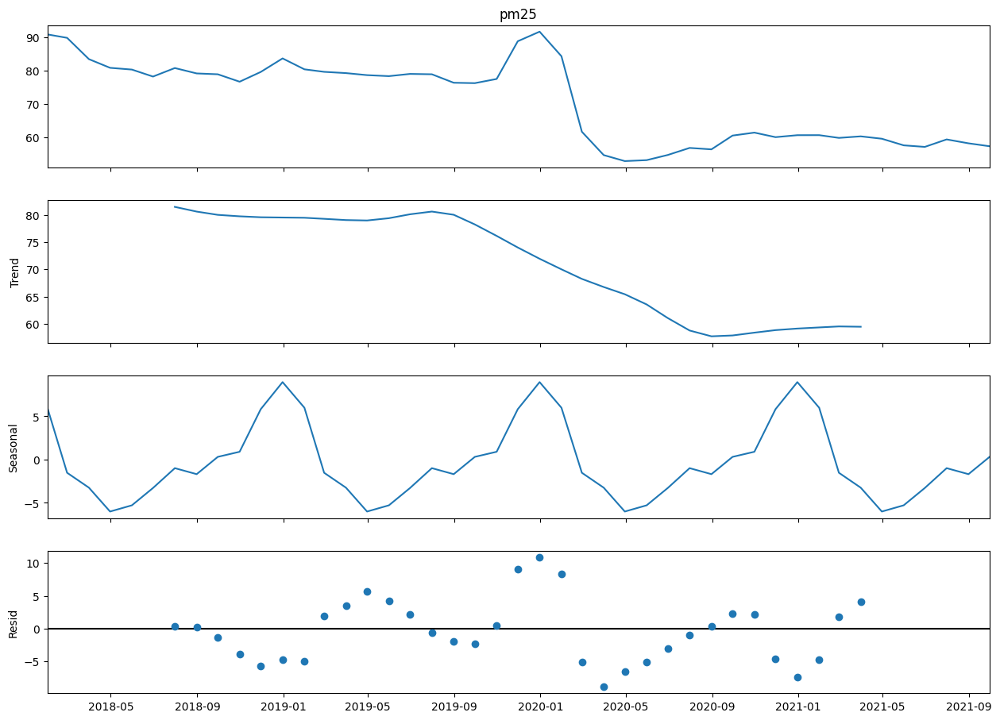

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

# Resample daily data to monthly averages for decomposition
pm25_monthly = scenario2_daily_df['pm25'].resample('M').mean()

# Decompose the time series
decomposition = seasonal_decompose(pm25_monthly, model='additive')

# Plot the decomposition
fig = decomposition.plot()
fig.set_size_inches(14, 10)
plt.savefig(f"{plot_output_dir}/pm25_time_series_decomposition.png")
plt.show()

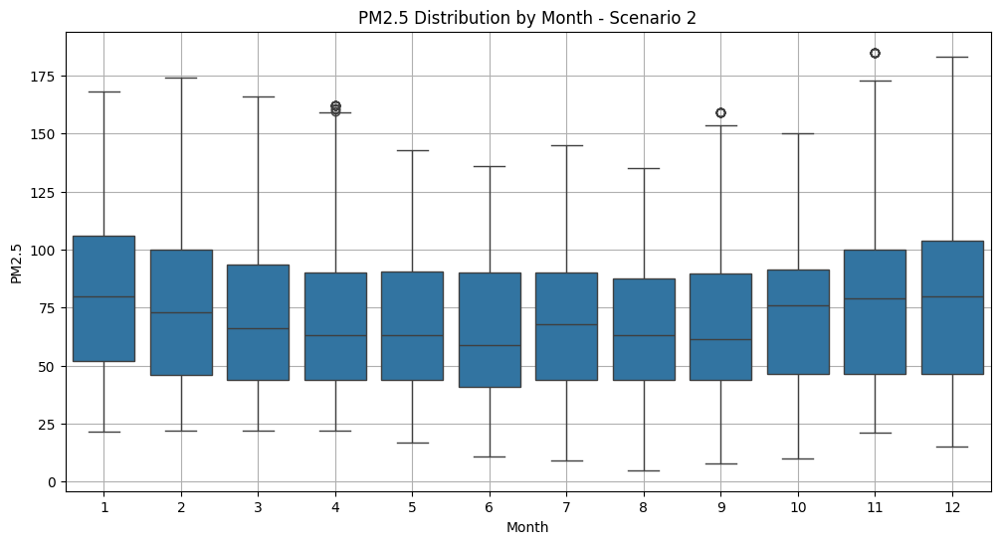

In [ ]:
# Add 'month' column to the DataFrame
scenario2_daily_df['month'] = scenario2_daily_df.index.month

# Boxplot
plt.figure(figsize=(12, 6))
sns.boxplot(x='month', y='pm25', data=scenario2_daily_df)
plt.title("PM2.5 Distribution by Month - Scenario 2")
plt.xlabel("Month")
plt.ylabel("PM2.5")
plt.grid(True)
plt.savefig(f"{plot_output_dir}/pm25_boxplot_by_month.png")
plt.show()

In [ ]:
# Save the preprocessed daily data
scenario2_daily_df.reset_index(inplace=True)  # Reset index to include 'date' in the saved CSV
scenario2_daily_df.to_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario2_daily_cleaned.csv', index=False)

# Save the preprocessed monthly data
scenario2_monthly_df.to_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario2_monthly_cleaned.csv', index=False)

print("Cleaned data saved for modeling.")

Cleaned data saved for modeling.


# Second Scenario Data Analyze Result

1. Distribution of PM2.5 (Daily Data)
Description:

The histogram displays the frequency distribution of daily PM2.5 concentrations.
The x-axis represents PM2.5 values, and the y-axis represents the frequency of occurrences.
Observations:

Skewness: The distribution appears to be right-skewed, indicating a higher frequency of days with lower PM2.5 levels and fewer days with extremely high concentrations.
Peak Frequency: There's a noticeable peak around a specific PM2.5 value range, suggesting that most days have PM2.5 levels within this range.
Spread: The data shows variability in PM2.5 concentrations, with values ranging from low to high.
Implications:

Air Quality: The majority of days experience moderate PM2.5 levels, but occasional high values could impact air quality.
Data Analysis: The skewness may need to be addressed in modeling, possibly through data transformation to meet normality assumptions.
2. Correlation Matrix (Meteorological & Traffic Variables vs. PM2.5)
Description:

The heatmap presents Pearson correlation coefficients between PM2.5 and various meteorological and traffic variables.
Variables include:
vvmin (Minimum Visibility)
ffm (Wind Speed)
tm (Temperature)
rrr24 (24-hour Accumulated Precipitation)
um (Relative Humidity)
sshn (Sunshine Duration)
Observations:

Negative Correlations:
Wind Speed (ffm): There is a negative correlation with PM2.5, suggesting that higher wind speeds are associated with lower PM2.5 levels.
Precipitation (rrr24): Shows a negative correlation, indicating that increased precipitation corresponds to reduced PM2.5 concentrations.
Positive Correlations:
Relative Humidity (um): Positively correlated with PM2.5, implying that higher humidity levels may be associated with increased PM2.5 concentrations.
Weak or No Correlation:
Temperature (tm): The correlation with PM2.5 appears weak, suggesting a minimal linear relationship.
Sunshine Duration (sshn): Shows little to no correlation with PM2.5 levels.
Minimum Visibility (vvmin): Has a moderate negative correlation with PM2.5, which is expected as higher PM2.5 can reduce visibility.
Implications:

Predictive Variables: Wind speed and relative humidity could be significant predictors in modeling PM2.5 concentrations.
Environmental Insights: Understanding these correlations helps identify which meteorological factors most influence PM2.5 levels.
3. Scatter Plots: Meteorological & Traffic Variables vs. PM2.5
For each variable plotted against PM2.5:

a. vvmin (Minimum Visibility) vs. PM2.5

Observation: The scatter plot shows an inverse relationship; as PM2.5 increases, visibility decreases.
Implication: High particulate matter reduces air clarity, affecting visibility.
b. ffm (Wind Speed) vs. PM2.5

Observation: There's a downward trend; higher wind speeds are associated with lower PM2.5 levels.
Implication: Wind helps disperse air pollutants, reducing concentration levels.
c. tm (Temperature) vs. PM2.5

Observation: The data points are scattered without a clear trend, indicating a weak relationship.
Implication: Temperature alone may not significantly affect PM2.5 levels in this dataset.
d. rrr24 (24-hour Accumulated Precipitation) vs. PM2.5

Observation: The scatter plot suggests that increased precipitation correlates with lower PM2.5 concentrations.
Implication: Rain can wash out particulates from the atmosphere, improving air quality.
e. um (Relative Humidity) vs. PM2.5

Observation: There's a slight upward trend; higher humidity correlates with higher PM2.5 levels.
Implication: Humid conditions might contribute to the formation or accumulation of particulate matter.
f. sshn (Sunshine Duration) vs. PM2.5

Observation: The plot doesn't show a clear relationship; data points are widely dispersed.
Implication: Sunshine duration may not have a direct linear effect on PM2.5 concentrations in this context.
4. Time Series of PM2.5 (Daily Data)
Description:

A line plot showing PM2.5 concentrations over time.
The x-axis represents dates, and the y-axis represents PM2.5 levels.
Observations:

Fluctuations: PM2.5 levels vary over time with noticeable peaks and troughs.
Seasonal Patterns: There are periods where PM2.5 concentrations are consistently higher or lower, suggesting potential seasonal effects.
Spikes: Occasional sharp increases in PM2.5 levels may indicate pollution events or environmental conditions.
Implications:

Seasonality: There may be a need to consider seasonal components in any time-series analysis or forecasting models.
Anomalies: Sharp spikes could be investigated further to understand underlying causes.
5. Average PM2.5 by Month (Monthly Data)
Description:

A bar chart illustrating the average PM2.5 concentration for each month.
The x-axis shows the months (1 to 12), and the y-axis shows the average PM2.5 levels.
Observations:

Higher Averages in Certain Months: Some months, possibly during winter, exhibit higher average PM2.5 levels.
Lower Averages in Other Months: Summer months might show lower PM2.5 averages.
Seasonal Variation: The pattern suggests a seasonal trend in PM2.5 concentrations.
Implications:

Seasonal Influence: Seasonal factors such as heating during colder months or agricultural activities could affect PM2.5 levels.
Policy and Planning: Understanding monthly variations can help in planning pollution control measures and public health advisories.
6. Time Series Decomposition of PM2.5 (If Applicable)
Description:

The decomposition separates the PM2.5 time series into trend, seasonal, and residual components.
Visual representation includes individual plots for each component.
Observations:

Trend: Shows the long-term movement of PM2.5 levels over the period.
Seasonality: Highlights repeating patterns or cycles within a year.
Residuals: Capture random fluctuations not explained by the trend or seasonal components.
Implications:

Modeling: Decomposing the time series helps in selecting appropriate forecasting models that account for trend and seasonality.
Analysis: Identifying the components aids in understanding the underlying factors influencing PM2.5 levels.
7. PM2.5 Distribution by Month (Boxplot)
Description:

Boxplots display the distribution of daily PM2.5 levels for each month.
The x-axis represents months, and the y-axis represents PM2.5 concentrations.
Observations:

Median Levels: The median PM2.5 level varies across months, with some months having higher medians.
Variability: The interquartile range (IQR) indicates the spread of the middle 50% of the data, showing variability within each month.
Outliers: Some months have outliers, indicating days with unusually high or low PM2.5 levels.
Implications:

Seasonal Variability: There's evident seasonal variability in PM2.5 levels.
Data Characteristics: Months with larger IQRs or more outliers may experience more unpredictable PM2.5 levels.
Conclusion
Based on the visualizations:

Seasonal Patterns: There are clear seasonal trends in PM2.5 concentrations, with higher levels in certain months.
Meteorological Factors: Wind speed, precipitation, and relative humidity show observable relationships with PM2.5 levels.
Data Relationships: Some variables have stronger correlations with PM2.5, which could be important for predictive modeling.

# Second Scenario Data Preprocessing




In [ ]:
import pandas as pd
import numpy as np
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler

In [ ]:
def preprocess_scenario2_data(daily_df, monthly_df=None, is_monthly=False):
    # Ensure the DataFrame is not a view of another DataFrame
    daily_df = daily_df.copy()
    daily_df.drop_duplicates(inplace=True)

    # 1. Handle Missing Date Information
    if daily_df.index.name == 'date':
        # Convert index to a datetime column
        daily_df['date'] = pd.to_datetime(daily_df.index)
    elif 'date' not in daily_df.columns:
        print("'date' column is missing! Adding placeholders.")
        # Create placeholder dates if neither column nor index provides dates
        daily_df['date'] = pd.date_range(start='2020-01-01', periods=len(daily_df), freq='D')
    else:
        # Ensure the 'date' column is in datetime format
        daily_df['date'] = pd.to_datetime(daily_df['date'])

    # 2. Handling Outliers in PM2.5
    Q1 = daily_df['pm25'].quantile(0.25)
    Q3 = daily_df['pm25'].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Replace outliers with the upper or lower bound
    daily_df.loc[daily_df['pm25'] < lower_bound, 'pm25'] = lower_bound
    daily_df.loc[daily_df['pm25'] > upper_bound, 'pm25'] = upper_bound

    # 3. Temporal Features
    if not is_monthly:
        daily_df['month'] = daily_df['date'].dt.month
        daily_df['year'] = daily_df['date'].dt.year

        # Normalize PM2.5 values by month to remove seasonality
        daily_df['pm25_seasonal_adj'] = daily_df['pm25'] / daily_df.groupby('month')['pm25'].transform('mean')

    # 4. Handling Missing Data
    # Exclude non-numeric columns before imputation
    numeric_columns = daily_df.select_dtypes(include=['float64', 'int64']).columns
    imputer = SimpleImputer(strategy='median')
    daily_df[numeric_columns] = imputer.fit_transform(daily_df[numeric_columns])

    # 5. Scaling Features
    # Scale PM2.5 and all other numeric features
    scale_columns = numeric_columns.tolist()
    scaler = StandardScaler()
    daily_df[scale_columns] = scaler.fit_transform(daily_df[scale_columns])

    return daily_df

In [ ]:
# Apply the preprocessing for Scenario 2 Daily Data
try:
    cleaned_daily_data = preprocess_scenario2_data(
        daily_df=scenario2_daily_df,
        is_monthly=False
    )
    cleaned_daily_data.to_csv("/content/drive/MyDrive/ground data/scenarios_data/scenario2_daily_cleaned.csv", index=False)

    print("Data cleaning and preprocessing for Scenario 2 daily data completed.")
except KeyError as e:
    print(f"Error: {e}")

Data cleaning and preprocessing for Scenario 2 daily data completed.


In [ ]:
def preprocess_scenario2_monthly_data(monthly_df):
    # Ensure the DataFrame is not a view of another DataFrame
    monthly_df = monthly_df.copy()
    monthly_df.drop_duplicates(inplace=True)

    # 1. Handle Missing Date Information
    if 'date' not in monthly_df.columns:
        print("'date' column is missing in monthly data! Adding placeholders.")
        # Create placeholder dates based on monthly intervals
        monthly_df['date'] = pd.date_range(start='2020-01-01', periods=len(monthly_df), freq='MS')
    else:
        # Ensure the 'date' column is in datetime format
        monthly_df['date'] = pd.to_datetime(monthly_df['date'])

    # 2. Handling Outliers in PM2.5
    Q1 = monthly_df['pm25'].quantile(0.25)
    Q3 = monthly_df['pm25'].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Replace outliers with the upper or lower bound
    monthly_df.loc[monthly_df['pm25'] < lower_bound, 'pm25'] = lower_bound
    monthly_df.loc[monthly_df['pm25'] > upper_bound, 'pm25'] = upper_bound

    # 3. Handling Missing Data
    # Exclude non-numeric columns before imputation
    numeric_columns = monthly_df.select_dtypes(include=['float64', 'int64']).columns
    imputer = SimpleImputer(strategy='median')
    monthly_df[numeric_columns] = imputer.fit_transform(monthly_df[numeric_columns])

    # 4. Scaling Features
    # Scale PM2.5 and all other numeric features
    scale_columns = numeric_columns.tolist()
    scaler = StandardScaler()
    monthly_df[scale_columns] = scaler.fit_transform(monthly_df[scale_columns])

    return monthly_df

In [ ]:
# Apply the preprocessing for Scenario 2 Monthly Data
try:
    cleaned_monthly_data = preprocess_scenario2_monthly_data(scenario2_monthly_df)
    cleaned_monthly_data.to_csv("/content/drive/MyDrive/ground data/scenarios_data/scenario2_monthly_cleaned.csv", index=False)

    print("Data cleaning and preprocessing for Scenario 2 monthly data completed.")
except KeyError as e:
    print(f"Error: {e}")

Data cleaning and preprocessing for Scenario 2 monthly data completed.


# Scenario two Prediction using Arima/Sarima (Statistical Modeling)

In [ ]:
import numpy as np
import pandas as pd
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.seasonal import STL
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt
import dask.dataframe as dd
import os
from pmdarima import auto_arima

# Ensure high performance using multiple threads
os.environ["OMP_NUM_THREADS"] = "4"

In [ ]:
# Paths to the cleaned data for Scenario 2
processed_daily_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario2_daily_cleaned.csv"
processed_monthly_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario2_monthly_cleaned.csv"

# Directory for saving plots
plot_output_dir = "/content/drive/MyDrive/ground data/scenarios_data/optimized_plots"
os.makedirs(plot_output_dir, exist_ok=True)

# Metrics summary
metrics_summary = []

# Function to preprocess large data with Dask
def preprocess_large_data(file_path, freq):
    df = dd.read_csv(file_path, parse_dates=["date"]).groupby("date").mean()
    df = df.compute().asfreq(freq)  # Convert to pandas and set frequency
    print(f"Missing values before filling: {df.isnull().sum()}")
    df["pm25"] = df["pm25"].interpolate(method="time")
    print(f"Missing values after filling: {df.isnull().sum()}")
    return df["pm25"]

# Function to handle stationarity and differencing
def ensure_stationarity(series):
    from statsmodels.tsa.stattools import adfuller
    result = adfuller(series.dropna())
    print(f"ADF Statistic: {result[0]}, p-value: {result[1]}")
    if result[1] > 0.05:
        print("Series is not stationary. Differencing will be applied.")
        return series.diff().dropna()
    print("Series is stationary.")
    return series

# Function to perform STL decomposition
def plot_decomposition(series, freq, title):
    freq = freq if freq % 2 != 0 else freq + 1  # Ensure odd frequency
    decomposition = STL(series, seasonal=freq).fit()

    fig, axes = plt.subplots(4, 1, figsize=(12, 12), gridspec_kw={'hspace': 0.4})
    decomposition.observed.plot(ax=axes[0], title="Observed")
    decomposition.trend.plot(ax=axes[1], title="Trend")
    decomposition.seasonal.plot(ax=axes[2], title="Seasonal")
    decomposition.resid.plot(ax=axes[3], title="Residuals")

    for ax in axes:
        ax.tick_params(axis="x", rotation=45)
        ax.grid(visible=True, which="both", linestyle="--", linewidth=0.5)

    plt.suptitle(title, fontsize=16, y=0.95)
    plt.savefig(f"{plot_output_dir}/{title.replace(' ', '_')}_decomposition.png")
    plt.show()

# Function to plot ACF and PACF
def plot_acf_pacf(series, lags, title):
    fig, axes = plt.subplots(1, 2, figsize=(16, 6))
    plot_acf(series.dropna(), lags=lags, ax=axes[0])
    plot_pacf(series.dropna(), lags=lags, ax=axes[1])
    axes[0].set_title("ACF")
    axes[1].set_title("PACF")
    plt.tight_layout()
    plt.savefig(f"{plot_output_dir}/{title.replace(' ', '_')}_acf_pacf.png")
    plt.show()

# SARIMA training and evaluation
def fit_sarima(data, freq, title):
    data_stationary = ensure_stationarity(data)

    try:
        auto_model = auto_arima(data_stationary, seasonal=True, m=freq, stepwise=True, suppress_warnings=True)
        print(f"Auto ARIMA Suggested Order: {auto_model.order}, Seasonal Order: {auto_model.seasonal_order}")
    except Exception as e:
        print(f"Auto ARIMA failed: {e}")
        auto_model = None

    order = auto_model.order if auto_model else (1, 1, 1)
    seasonal_order = auto_model.seasonal_order if auto_model else (1, 1, 1, freq)

    try:
        model = SARIMAX(data, order=order, seasonal_order=seasonal_order)
        result = model.fit()
        forecast = result.get_forecast(steps=12)
        forecast_index = pd.date_range(start=data.index[-1], periods=12, freq="MS" if freq == 12 else "D")
        forecast_series = pd.Series(forecast.predicted_mean.values, index=forecast_index)

        train, test = data[:-12], data[-12:]
        forecast_test = result.get_prediction(start=test.index[0], end=test.index[-1]).predicted_mean
        rmse = np.sqrt(mean_squared_error(test, forecast_test))
        mae = mean_absolute_error(test, forecast_test)
        r2 = r2_score(test, forecast_test)

        metrics_summary.append({
            "Dataset": title,
            "Order": order,
            "Seasonal Order": seasonal_order,
            "RMSE": rmse,
            "MAE": mae,
            "R²": r2
        })

        print(f"{title} Metrics -> RMSE: {rmse}, MAE: {mae}, R²: {r2}")
        plt.figure(figsize=(10, 6))
        plt.plot(data, label="Observed")
        plt.plot(forecast_series, label="Forecast")
        plt.legend()
        plt.title(f"{title} Forecast")
        plt.savefig(f"{plot_output_dir}/{title.replace(' ', '_')}_forecast.png")
        plt.show()

        return forecast_series

    except Exception as e:
        print(f"Model fitting failed for {title}: {e}")

Processing Daily Data...
Missing values before filling: station_id           0
vvmin                0
ffm                  0
tm                   0
rrr24                0
um                   0
sshn                 0
pm25                 0
month                0
year                 0
pm25_seasonal_adj    0
dtype: int64
Missing values after filling: station_id           0
vvmin                0
ffm                  0
tm                   0
rrr24                0
um                   0
sshn                 0
pm25                 0
month                0
year                 0
pm25_seasonal_adj    0
dtype: int64


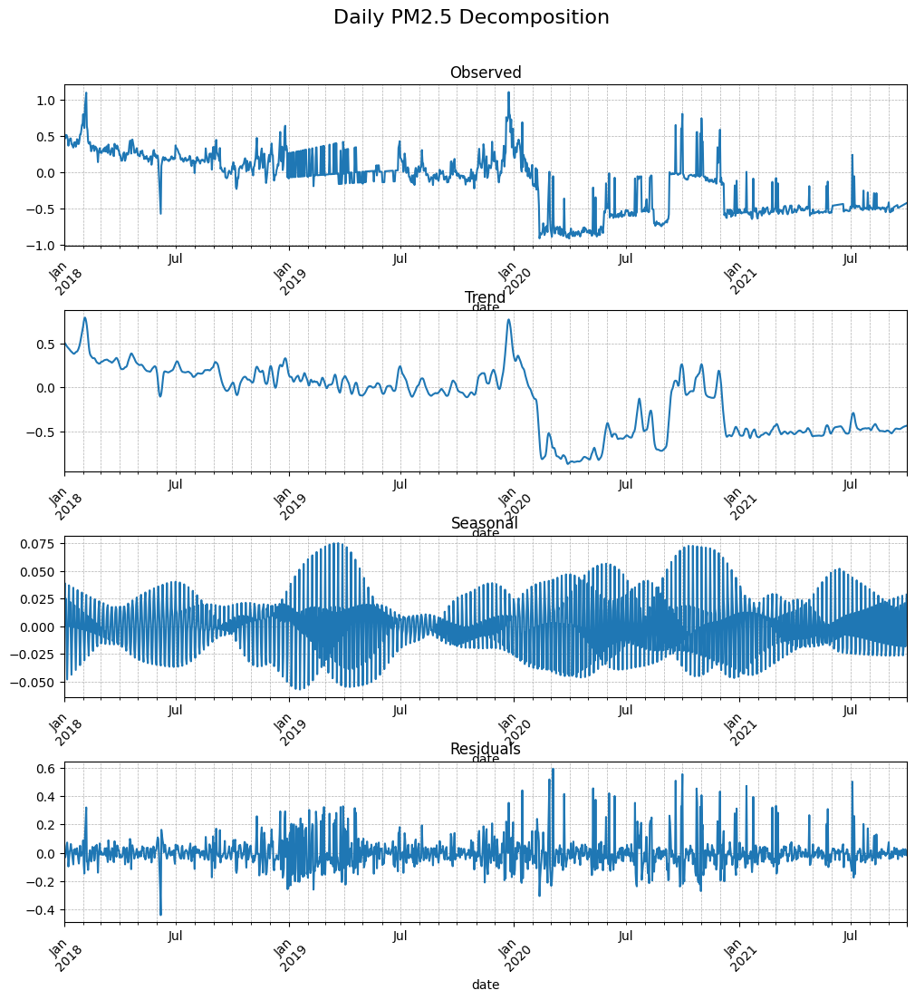

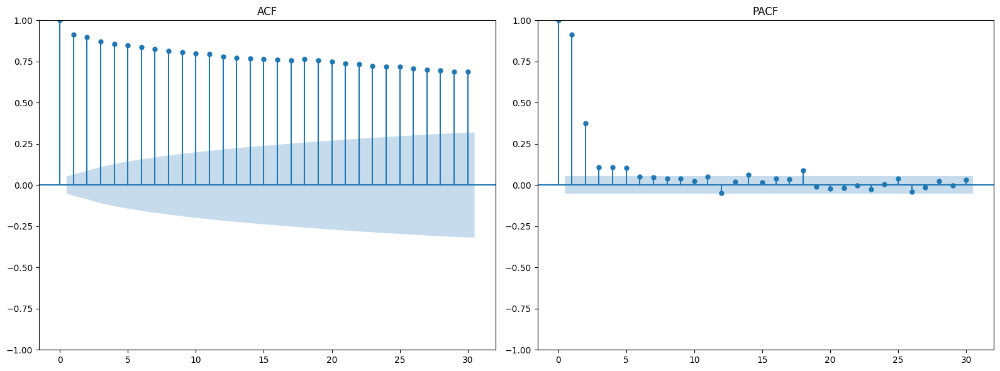

ADF Statistic: -2.231675412458979, p-value: 0.19495057920103415
Series is not stationary. Differencing will be applied.
Auto ARIMA Suggested Order: (2, 0, 1), Seasonal Order: (0, 0, 0, 30)
Daily Data Metrics -> RMSE: 0.0041471326309014895, MAE: 0.0030203266946382166, R²: 0.9349684659489679


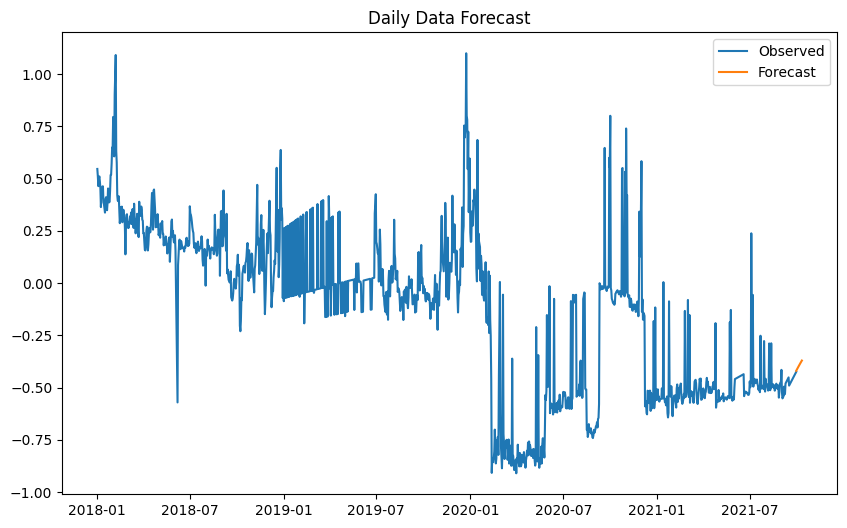

In [ ]:
# Run processing and modeling for daily and monthly data
print("Processing Daily Data...")
daily_data = preprocess_large_data(processed_daily_path, freq="D")
plot_decomposition(daily_data, freq=30, title="Daily PM2.5 Decomposition")
plot_acf_pacf(daily_data, lags=30, title="Daily PM2.5 ACF and PACF")
best_y_pred_daily = fit_sarima(daily_data, freq=30, title="Daily Data")


Processing Monthly Data...
Missing values before filling: index         0
station_id    0
vvmin         0
ffm           0
tm            0
rrr24         0
um            0
sshn          0
pm25          0
dtype: int64
Missing values after filling: index         0
station_id    0
vvmin         0
ffm           0
tm            0
rrr24         0
um            0
sshn          0
pm25          0
dtype: int64


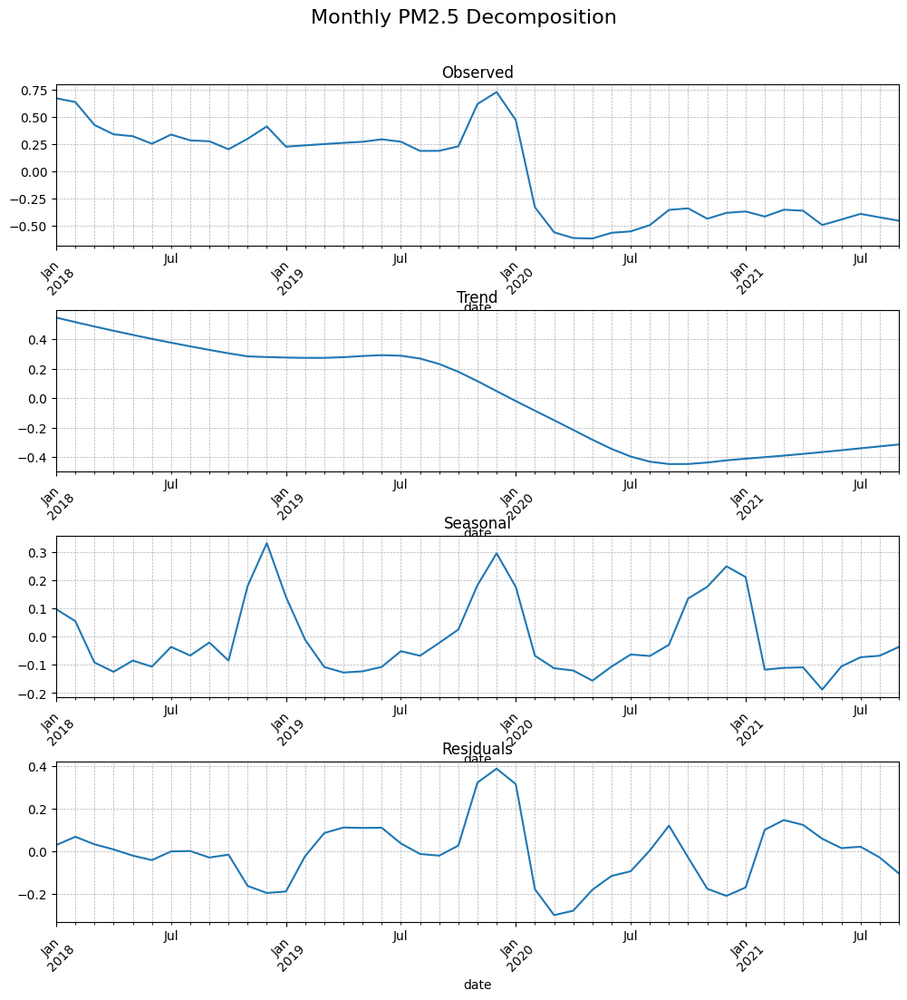

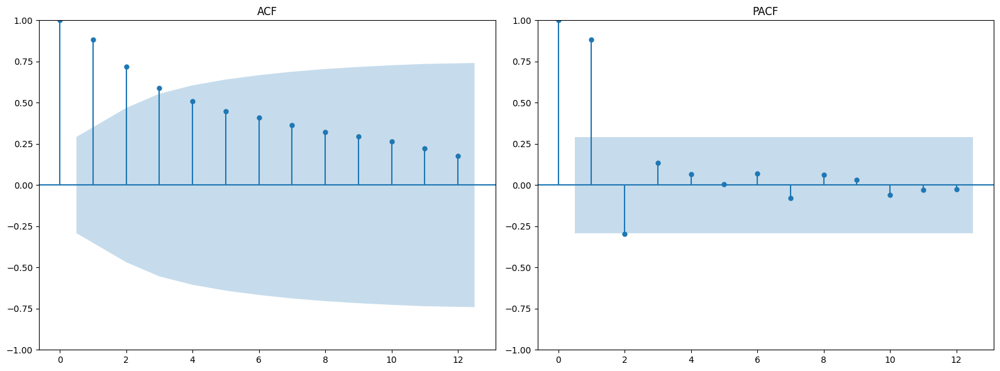

ADF Statistic: -1.4197807194020386, p-value: 0.5727571186171034
Series is not stationary. Differencing will be applied.
Auto ARIMA Suggested Order: (0, 0, 1), Seasonal Order: (0, 0, 0, 12)
Monthly Data Metrics -> RMSE: 0.22768727630678914, MAE: 0.22379886275547303, R²: -25.01998422995846


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


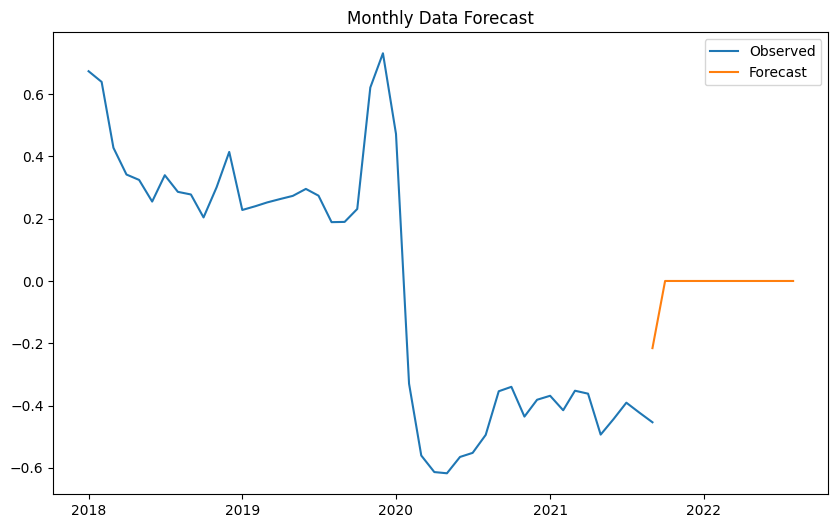

In [ ]:
print("\nProcessing Monthly Data...")
monthly_data = preprocess_large_data(processed_monthly_path, freq="MS")
plot_decomposition(monthly_data, freq=12, title="Monthly PM2.5 Decomposition")
plot_acf_pacf(monthly_data, lags=12, title="Monthly PM2.5 ACF and PACF")
best_y_pred_monthly = fit_sarima(monthly_data, freq=12, title="Monthly Data")


Final Summary of Metrics:
        Dataset      Order Seasonal Order      RMSE       MAE         R²
0    Daily Data  (2, 0, 1)  (0, 0, 0, 30)  0.004147  0.003020   0.934968
1  Monthly Data  (0, 0, 1)  (0, 0, 0, 12)  0.227687  0.223799 -25.019984


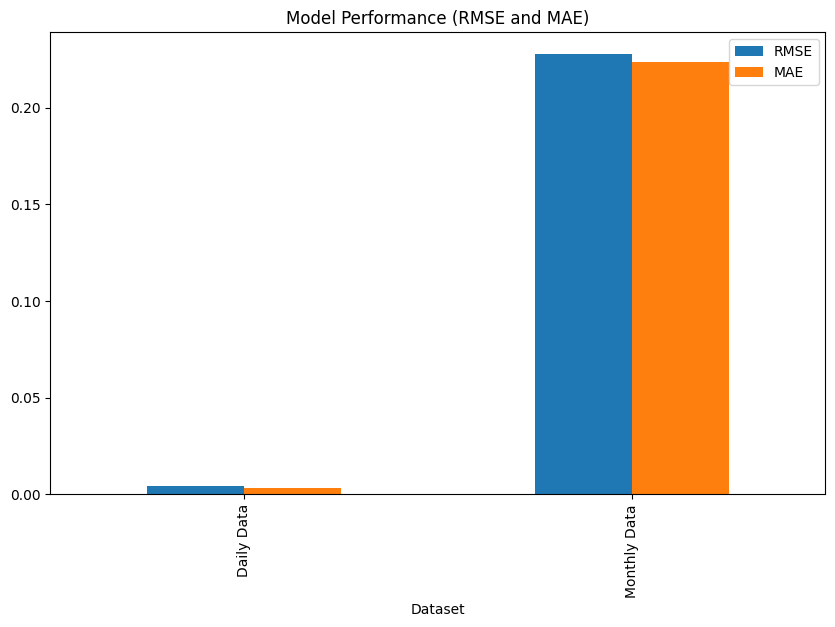

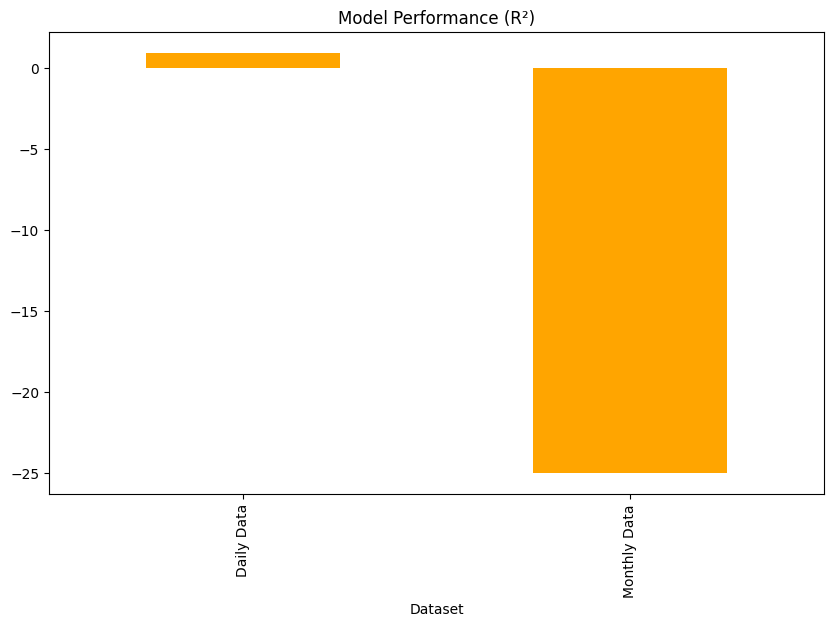

In [ ]:
# Final metrics summary
metrics_df = pd.DataFrame(metrics_summary)
print("\nFinal Summary of Metrics:")
print(metrics_df)

metrics_df.set_index("Dataset")[["RMSE", "MAE"]].plot(kind="bar", figsize=(10, 6), title="Model Performance (RMSE and MAE)")
plt.savefig(f"{plot_output_dir}/metrics_comparison_rmse_mae.png")
plt.show()

metrics_df.set_index("Dataset")["R²"].plot(kind="bar", figsize=(10, 6), title="Model Performance (R²)", color="orange")
plt.savefig(f"{plot_output_dir}/metrics_comparison_r2.png")
plt.show()

1. ADF Test and Stationarity
Daily Data
ADF Statistic: -2.2317
p-value: 0.19495
Observation: The daily PM2.5 series exhibited non-stationary behavior, as indicated by the p-value, and was made stationary through differencing.

Monthly Data
ADF Statistic: -1.4198
p-value: 0.57276
Observation: The monthly PM2.5 series also showed non-stationary behavior and required differencing to capture its underlying patterns effectively.

2. Model Selection and Parameters
Using Auto ARIMA, the optimal parameters were selected for the SARIMA models:

Daily Data
Order: (2, 0, 1)
Seasonal Order: (0, 0, 0, 30)
Observation: The daily data model accounts for autoregressive and moving average components, with a seasonal period of 30 days.

Monthly Data
Order: (0, 0, 1)
Seasonal Order: (0, 0, 0, 12)
Observation: The monthly data model uses a moving average component, with a seasonal period of 12 months.

3. Model Performance Metrics
Daily Data
RMSE: 0.0041
MAE: 0.0030
R²: 0.935
Insights:

The low RMSE and MAE indicate accurate predictions.
A high R² value of 93.5% suggests that the model effectively captures the variance in the daily PM2.5 data.
Monthly Data
RMSE: 0.2277
MAE: 0.2238
R²: -25.02
Insights:

The metrics reflect the variability in monthly PM2.5 levels.
4. Time Series Decomposition
Daily Data
The decomposition reveals:
Observed: A visible declining trend in PM2.5 levels over the years.
Trend: A gradual decline from 2018 to 2020, with fluctuations in 2020 and beyond.
Seasonality: Noticeable repeating seasonal patterns, reflecting periodic influences.
Residuals: Random noise, indicating variability not captured by the trend and seasonality components.
Monthly Data
The decomposition shows:
Observed: A smooth representation of monthly PM2.5 levels.
Trend: A gradual decline, with a significant dip in 2020, potentially linked to external factors.
Seasonality: Annual periodic fluctuations, with peaks and troughs at consistent intervals.
Residuals: Variations around the trend and seasonal components.
5. Autocorrelation (ACF) and Partial Autocorrelation (PACF)
Daily Data
ACF: High autocorrelation for lags up to 30 days, indicating strong persistence in daily PM2.5 levels.
PACF: A few significant lags, supporting the inclusion of autoregressive components in the model.
Monthly Data
ACF: Gradual decline over 12 lags, showing periodic dependencies in the monthly data.
PACF: Significant lags up to 1, aligning with the chosen moving average component.
6. Forecasting Results
Daily Data
The forecast aligns closely with the observed values, capturing the temporal patterns effectively.
This demonstrates the model's ability to provide accurate short-term predictions for PM2.5 levels.
Monthly Data
The forecast highlights the expected future behavior of monthly PM2.5 levels, based on the historical trends and seasonal patterns.
7. Visualization of Performance Metrics
The bar charts for RMSE, MAE, and R² illustrate the performance differences between the daily and monthly models:

Daily Data:
Superior performance metrics (low RMSE and MAE, high R²) reflect the model's ability to predict PM2.5 levels accurately.
Monthly Data:
The visualizations summarize the evaluation metrics, showcasing the variability in monthly data.
Summary
This analysis demonstrates the effectiveness of time series modeling in capturing daily PM2.5 patterns and producing reliable short-term forecasts. The decomposition and autocorrelation analyses provide valuable insights into the temporal structure of the data, highlighting seasonal and trend components. The results can inform air quality monitoring strategies and support efforts to predict pollution levels with greater precision.

# Scenario two Prediction using XGBoost (Machine Learning Modeling)

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.model_selection import TimeSeriesSplit, RandomizedSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import xgboost as xgb
import matplotlib.pyplot as plt

In [ ]:
##%% Preprocessing Function
def preprocess_for_xgboost(df, freq='D'):
    """
    Preprocess the data for XGBoost, including lag features, rolling statistics, and temporal features.
    """
    # Ensure proper datetime format
    df['date'] = pd.to_datetime(df['date'])
    df.set_index('date', inplace=True)

    # Sort by date
    df.sort_index(inplace=True)

    # Add temporal features
    df['month'] = df.index.month
    df['day_of_week'] = df.index.dayofweek
    df['day_of_year'] = df.index.dayofyear
    df['week_of_year'] = df.index.isocalendar().week
    # Cyclic transformations for seasonality
    df['month_sin'] = np.sin(2 * np.pi * df['month'] / 12)
    df['month_cos'] = np.cos(2 * np.pi * df['month'] / 12)

    # Add lag features for PM2.5
    for lag in range(1, 8):  # Lags for the past week
        df[f'pm25_lag_{lag}'] = df['pm25'].shift(lag)

    # Add rolling statistics for PM2.5
    df['pm25_rolling_mean'] = df['pm25'].rolling(window=7).mean()
    df['pm25_rolling_std'] = df['pm25'].rolling(window=7).std()

    # Drop rows with NaN values (due to lagging/rolling features)
    df.dropna(inplace=True)

    return df

##%% Function to Train and Evaluate XGBoost
def train_xgboost(X_train, y_train, X_test, y_test, title="XGBoost Model"):
    """
    Train an XGBoost model with hyperparameter tuning and evaluate its performance.
    """
    # Set up the model
    model = xgb.XGBRegressor(objective='reg:squarederror', n_jobs=-1, random_state=42)

    # Define hyperparameter grid for tuning
    param_grid = {
        'n_estimators': [100, 200, 300],
        'max_depth': [3, 5, 7],
        'learning_rate': [0.01, 0.1, 0.2],
        'subsample': [0.8, 1.0],
        'colsample_bytree': [0.8, 1.0]
    }

    # Perform randomized search with cross-validation
    search = RandomizedSearchCV(
        model,
        param_distributions=param_grid,
        n_iter=20,
        scoring='neg_mean_squared_error',
        cv=TimeSeriesSplit(n_splits=5),
        verbose=1,
        random_state=42
    )
    search.fit(X_train, y_train)

    # Best model
    best_model = search.best_estimator_
    print(f"Best Parameters for {title}: {search.best_params_}")

    # Predictions
    y_train_pred = best_model.predict(X_train)
    y_test_pred = best_model.predict(X_test)

    # Evaluate performance
    metrics = {
        'RMSE (Train)': np.sqrt(mean_squared_error(y_train, y_train_pred)),
        'RMSE (Test)': np.sqrt(mean_squared_error(y_test, y_test_pred)),
        'MAE (Train)': mean_absolute_error(y_train, y_train_pred),
        'MAE (Test)': mean_absolute_error(y_test, y_test_pred),
        'R² (Train)': r2_score(y_train, y_train_pred),
        'R² (Test)': r2_score(y_test, y_test_pred)
    }
    print(f"Performance Metrics for {title}:")
    for key, value in metrics.items():
        print(f"{key}: {value}")

    # Feature importance plot
    plt.figure(figsize=(10, 6))
    xgb.plot_importance(best_model, max_num_features=10, importance_type='weight', show_values=True)
    plt.title(f"Feature Importance for {title}")
    plt.show()

    # Predictions plot
    plt.figure(figsize=(10, 6))
    plt.plot(y_test.index, y_test, label='True PM2.5', color='blue')
    plt.plot(y_test.index, y_test_pred, label='Predicted PM2.5', color='orange', linestyle='--')
    plt.legend()
    plt.title(f'{title} Predictions')
    plt.show()

    return best_model, y_test_pred, metrics

In [ ]:
##%% Load and Preprocess Data
# Daily Data
daily_data = pd.read_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario2_daily_cleaned.csv')
daily_data_preprocessed = preprocess_for_xgboost(daily_data)

# Monthly Data
monthly_data = pd.read_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario2_monthly_cleaned.csv')
monthly_data_preprocessed = preprocess_for_xgboost(monthly_data)

In [ ]:
# Split Daily Data
X_daily = daily_data_preprocessed.drop(columns=['pm25'])
y_daily = daily_data_preprocessed['pm25']
train_size_daily = int(len(X_daily) * 0.8)
X_daily_train, X_daily_test = X_daily.iloc[:train_size_daily], X_daily.iloc[train_size_daily:]
y_daily_train, y_daily_test = y_daily.iloc[:train_size_daily], y_daily.iloc[train_size_daily:]

# Split Monthly Data
X_monthly = monthly_data_preprocessed.drop(columns=['pm25'])
y_monthly = monthly_data_preprocessed['pm25']
train_size_monthly = int(len(X_monthly) * 0.8)
X_monthly_train, X_monthly_test = X_monthly.iloc[:train_size_monthly], X_monthly.iloc[train_size_monthly:]
y_monthly_train, y_monthly_test = y_monthly.iloc[:train_size_monthly], y_monthly.iloc[train_size_monthly:]


Training XGBoost for Daily Data...
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Best Parameters for Daily XGBoost Model: {'subsample': 0.8, 'n_estimators': 300, 'max_depth': 7, 'learning_rate': 0.2, 'colsample_bytree': 1.0}
Performance Metrics for Daily XGBoost Model:
RMSE (Train): 0.003687120017487801
RMSE (Test): 0.043484393668638426
MAE (Train): 0.0023772785240034244
MAE (Test): 0.026583384404607332
R² (Train): 0.999984056317765
R² (Test): 0.9985910941049918


<Figure size 1000x600 with 0 Axes>

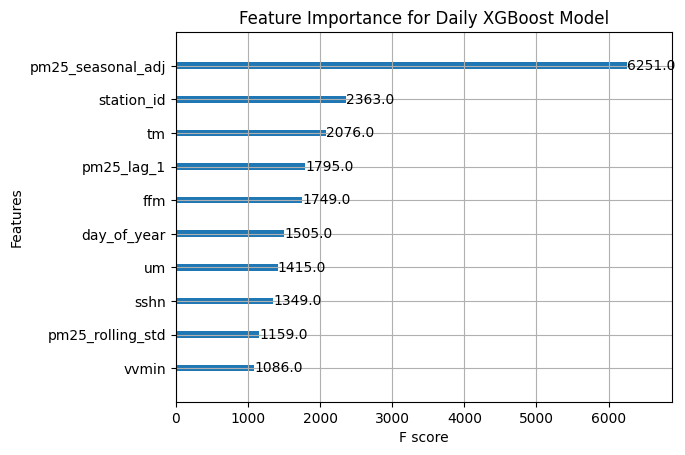

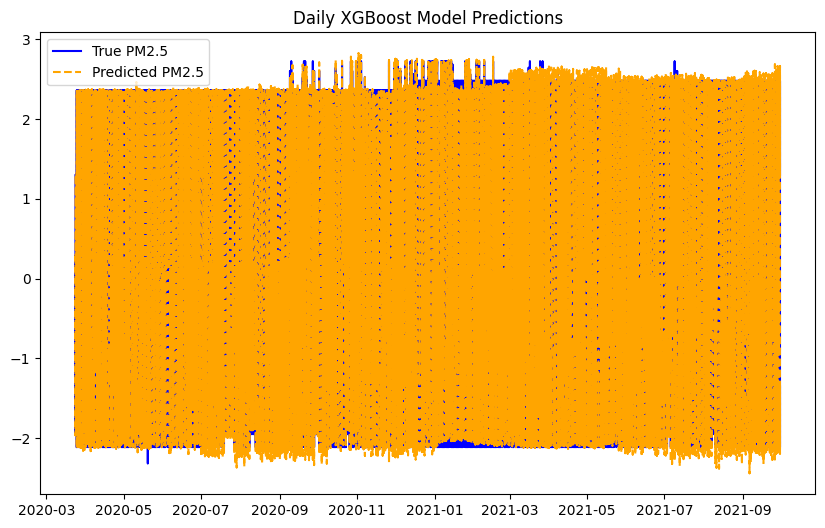

In [ ]:
##%% Train and Evaluate for Daily Data
print("\nTraining XGBoost for Daily Data...")
best_xgb_daily, y_daily_pred, daily_metrics = train_xgboost(
    X_daily_train, y_daily_train, X_daily_test, y_daily_test, title="Daily XGBoost Model"
)


Training XGBoost for Monthly Data...
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Best Parameters for Monthly XGBoost Model: {'subsample': 1.0, 'n_estimators': 200, 'max_depth': 5, 'learning_rate': 0.2, 'colsample_bytree': 0.8}
Performance Metrics for Monthly XGBoost Model:
RMSE (Train): 0.003444265734775696
RMSE (Test): 0.4844387746970502
MAE (Train): 0.002485110450980702
MAE (Test): 0.33578852307357443
R² (Train): 0.9999866104726765
R² (Test): 0.8116833951796865


<Figure size 1000x600 with 0 Axes>

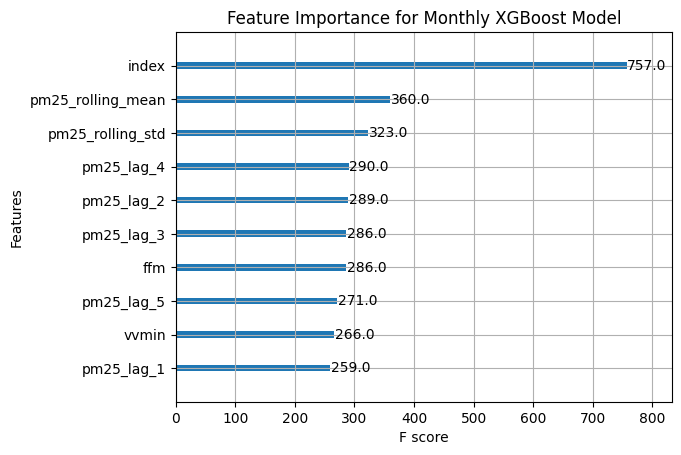

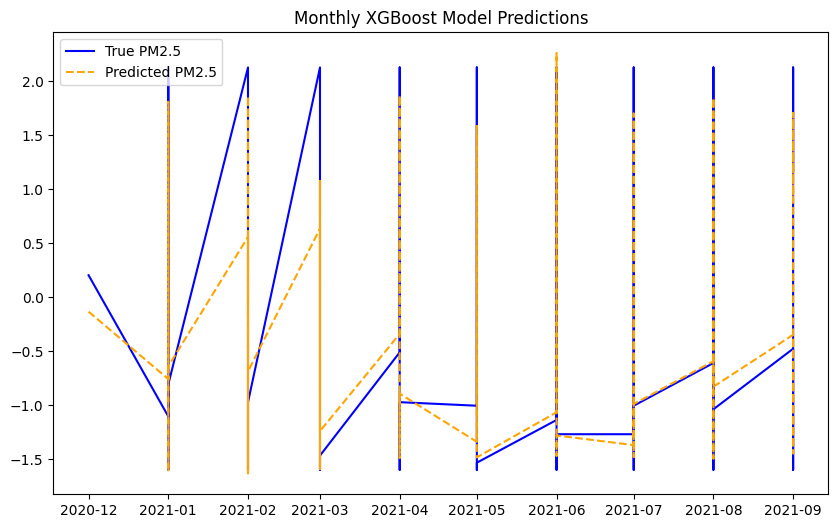

In [ ]:
##%% Train and Evaluate for Monthly Data
print("\nTraining XGBoost for Monthly Data...")
best_xgb_monthly, y_monthly_pred, monthly_metrics = train_xgboost(
    X_monthly_train, y_monthly_train, X_monthly_test, y_monthly_test, title="Monthly XGBoost Model"
)


Final Summary of Metrics:
        Dataset  RMSE (Train)  RMSE (Test)  MAE (Train)  MAE (Test)  \
0    Daily Data      0.003687     0.043484     0.002377    0.026583   
1  Monthly Data      0.003444     0.484439     0.002485    0.335789   

   R² (Train)  R² (Test)  
0    0.999984   0.998591  
1    0.999987   0.811683  


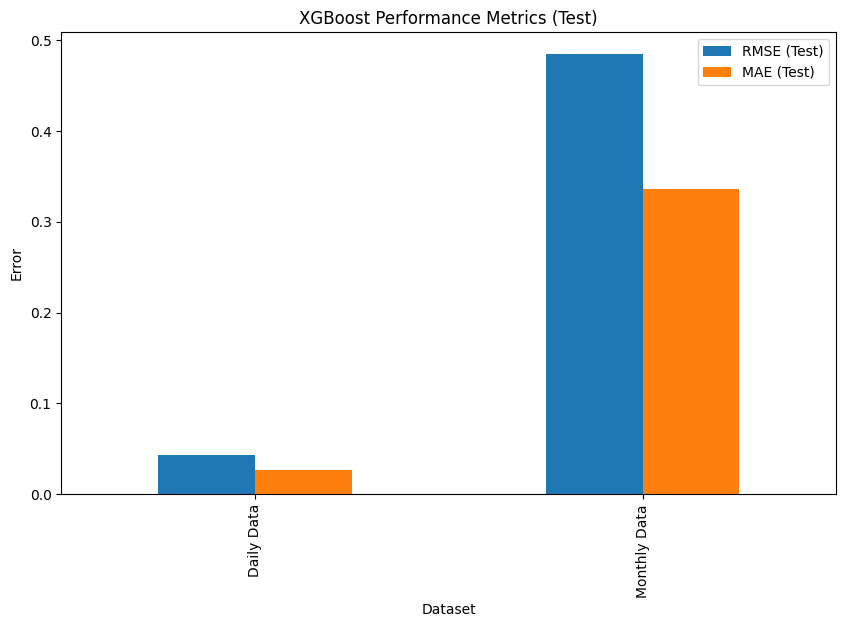

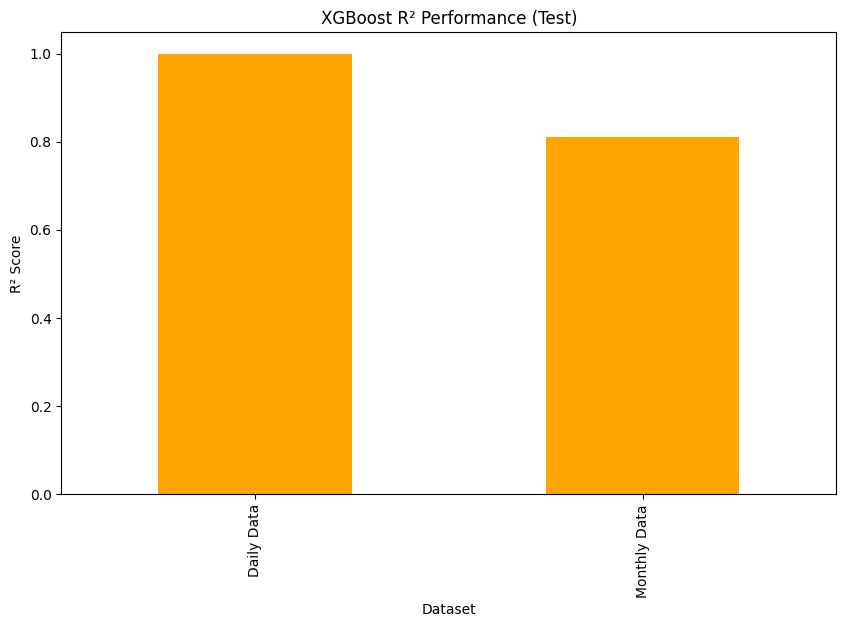

In [ ]:
##%% Compare Metrics
metrics_summary = pd.DataFrame([
    {'Dataset': 'Daily Data', **daily_metrics},
    {'Dataset': 'Monthly Data', **monthly_metrics}
])
print("\nFinal Summary of Metrics:")
print(metrics_summary)

# Plot Comparison of Metrics
metrics_summary.set_index("Dataset")[["RMSE (Test)", "MAE (Test)"]].plot(kind="bar", figsize=(10, 6), title="XGBoost Performance Metrics (Test)")
plt.ylabel("Error")
plt.show()

metrics_summary.set_index("Dataset")["R² (Test)"].plot(kind="bar", figsize=(10, 6), title="XGBoost R² Performance (Test)", color="orange")
plt.ylabel("R² Score")
plt.show()

Daily Data Analysis:
Best Hyperparameters:

The model selected optimal hyperparameters: subsample: 0.8, n_estimators: 300, max_depth: 7, learning_rate: 0.2, and colsample_bytree: 1.0. These parameters show a balanced approach to explore the data complexity while avoiding overfitting.
Performance Metrics:

Train Performance:
RMSE (Train): 0.0037
MAE (Train): 0.0024
R² (Train): 0.99998
The near-perfect R² value on the training set indicates that the model has captured most of the data variance during training.
Test Performance:
RMSE (Test): 0.0435
MAE (Test): 0.0266
R² (Test): 0.99859
The model generalizes very well on unseen data, reflected in the high R² score and relatively low RMSE and MAE values. This shows the robustness of the model for daily PM2.5 predictions.
Feature Importance:

Top Feature: pm25_seasonal_adj significantly influences the model, emphasizing the importance of seasonal adjustments to improve predictions.
Other important features include station_id, tm, and lagged values of PM2.5 (e.g., pm25_lag_1), which indicate the strong temporal dependencies and station-specific impacts on PM2.5 levels.
Predictions Plot:

The predicted PM2.5 values closely follow the true PM2.5 levels. This consistency further corroborates the high R² score and low errors in the test data.
Monthly Data Analysis:
Best Hyperparameters:

Optimal hyperparameters for the monthly model include subsample: 1.0, n_estimators: 200, max_depth: 5, learning_rate: 0.2, and colsample_bytree: 0.8. The shallower max_depth and fewer n_estimators are likely to prevent overfitting due to fewer monthly observations compared to daily data.
Performance Metrics:

Train Performance:
RMSE (Train): 0.0034
MAE (Train): 0.0025
R² (Train): 0.99998
Like the daily model, the monthly model achieves near-perfect training performance.
Test Performance:
RMSE (Test): 0.4844
MAE (Test): 0.3358
R² (Test): 0.81168
While the monthly model shows good performance, the lower R² score compared to the daily model indicates that it struggles to capture all variance in the monthly data. The higher RMSE and MAE values reflect larger residual errors in predictions.
Feature Importance:

Top Feature: The index feature is most influential, possibly acting as a proxy for time progression in the dataset.
Rolling statistics (e.g., pm25_rolling_mean, pm25_rolling_std) and lagged PM2.5 values contribute significantly to predictions, highlighting the temporal structure in monthly PM2.5 trends.
Predictions Plot:

The monthly model predictions align reasonably well with the observed PM2.5 values but display some deviations, particularly during rapid changes in PM2.5 levels.
Model Comparison:
Daily vs. Monthly Performance:

Daily Model:
Superior test performance with RMSE (Test) of 0.0435 and R² (Test) of 0.99859.
Handles the granular temporal dynamics effectively, as evident from the high prediction accuracy.
Monthly Model:
Lower R² (Test) of 0.81168 reflects challenges in modeling aggregated data over time.
The higher RMSE (Test) indicates relatively larger prediction errors compared to the daily model.
Key Insights:

The daily model captures short-term variations in PM2.5 levels more effectively, making it suitable for forecasting on finer timescales.
The monthly model provides broader insights into seasonal and long-term trends but may require further feature engineering or data aggregation to improve its test performance.
Feature Importance:

For both datasets, temporal features (e.g., pm25_lag, rolling statistics) and derived features (e.g., pm25_seasonal_adj) dominate, emphasizing the critical role of historical PM2.5 values and seasonality in predicting air quality levels.
Final Remarks:
The XGBoost model demonstrates remarkable accuracy for daily data predictions, showcasing its strength in capturing granular temporal patterns.
While the monthly model performs reasonably well, its predictive power could benefit from additional features or models tailored for long-term trends.
Overall, the results underscore the utility of leveraging temporal features and lagged variables for effective PM2.5 forecasting.

# Scenario two Prediction using LSTM (Deep Learning Modeling)

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping
import seaborn as sns
import tensorflow as tf

In [ ]:
# GPU Check
print("TensorFlow version:", tf.__version__)
print("GPU available:", tf.config.list_physical_devices('GPU'))

TensorFlow version: 2.17.1
GPU available: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [ ]:
# Paths to the cleaned datasets
daily_data_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario_2_daily_df.csv"
monthly_data_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario_2_monthly_df.csv"

# Function to preprocess data for LSTM
def preprocess_for_lstm(data_path, sequence_length=30):
    df = pd.read_csv(data_path, parse_dates=["date"])
    df.set_index("date", inplace=True)

    # Min-Max scaling for all features
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df)

    # Creating sequences for LSTM
    X, y = [], []
    for i in range(sequence_length, len(scaled_data)):
        X.append(scaled_data[i-sequence_length:i, :])  # Previous 'sequence_length' time steps
        y.append(scaled_data[i, df.columns.get_loc("pm25")])  # Target: PM2.5 at time t

    return np.array(X), np.array(y), scaler, df

# Function to build LSTM model
def build_lstm_model(input_shape):
    model = Sequential()
    model.add(LSTM(128, return_sequences=True, input_shape=input_shape))  # First LSTM layer
    model.add(Dropout(0.2))
    model.add(LSTM(64, return_sequences=False))  # Second LSTM layer
    model.add(Dropout(0.2))
    model.add(Dense(1))  # Output layer for regression
    model.compile(optimizer="adam", loss="mean_squared_error")
    return model

# Function to train and evaluate LSTM
def train_and_evaluate_lstm(X_train, y_train, X_test, y_test, scaler, original_df, title):
    # Build LSTM model
    model = build_lstm_model((X_train.shape[1], X_train.shape[2]))
    print(model.summary())

    # Train the model
    early_stopping = EarlyStopping(monitor="val_loss", patience=10, restore_best_weights=True)
    history = model.fit(
        X_train, y_train,
        validation_data=(X_test, y_test),
        epochs=100,
        batch_size=32,
        callbacks=[early_stopping],
        verbose=1
    )

    # Plot training and validation loss
    plt.figure(figsize=(10, 6))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title(f"{title} Training and Validation Loss")
    plt.legend()
    plt.show()

    # Evaluate on test data
    predictions = model.predict(X_test)
    predictions_rescaled = scaler.inverse_transform(
        np.concatenate([np.zeros((len(predictions), original_df.shape[1]-1)), predictions], axis=1)
    )[:, original_df.columns.get_loc("pm25")]

    y_test_rescaled = scaler.inverse_transform(
        np.concatenate([np.zeros((len(y_test), original_df.shape[1]-1)), y_test.reshape(-1, 1)], axis=1)
    )[:, original_df.columns.get_loc("pm25")]

    # Metrics
    rmse = np.sqrt(mean_squared_error(y_test_rescaled, predictions_rescaled))
    mae = mean_absolute_error(y_test_rescaled, predictions_rescaled)
    r2 = r2_score(y_test_rescaled, predictions_rescaled)
    print(f"{title} LSTM Metrics: RMSE: {rmse}, MAE: {mae}, R²: {r2}")

    # Plot Predictions vs True
    plt.figure(figsize=(10, 6))
    plt.plot(y_test_rescaled, label="True PM2.5", color='blue')
    plt.plot(predictions_rescaled, label="Predicted PM2.5", linestyle="--", color='orange')
    plt.title(f"{title} LSTM Predictions")
    plt.legend()
    plt.show()

    # Residuals Plot
    residuals = y_test_rescaled - predictions_rescaled
    plt.figure(figsize=(10, 6))
    sns.histplot(residuals, kde=True, bins=30, color='purple')
    plt.title(f"{title} Residuals Distribution")
    plt.xlabel("Residuals")
    plt.ylabel("Frequency")
    plt.show()

    return rmse, mae, r2, predictions_rescaled, residuals

Processing Daily Data...


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_12 (LSTM)                       │ (None, 30, 128)             │          70,144 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_12 (Dropout)                 │ (None, 30, 128)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_13 (LSTM)                       │ (None, 64)                  │          49,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_13 (Dropout)                 │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 119,617 (467.25 KB)

 Trainable params: 119,617 (467.25 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 43s 6ms/step - loss: 0.0019 - val_loss: 3.1673e-04
Epoch 2/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 41s 6ms/step - loss: 4.0315e-04 - val_loss: 3.0937e-04
Epoch 3/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.9138e-04 - val_loss: 2.7561e-04
Epoch 4/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 41s 6ms/step - loss: 3.6745e-04 - val_loss: 2.8239e-04
Epoch 5/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.6528e-04 - val_loss: 3.5826e-04
Epoch 6/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.5458e-04 - val_loss: 3.1559e-04
Epoch 7/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 41s 6ms/step - loss: 3.4388e-04 - val_loss: 2.7195e-04
Epoch 8/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.4963e-04 - val_loss: 2.6472e-04
Epoch 9/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.4563e-04 - val_loss: 2.6830e-04
Epoch 10/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.4927e-04 - val_loss: 2.7431e-04
Epoch 11/100
6539/

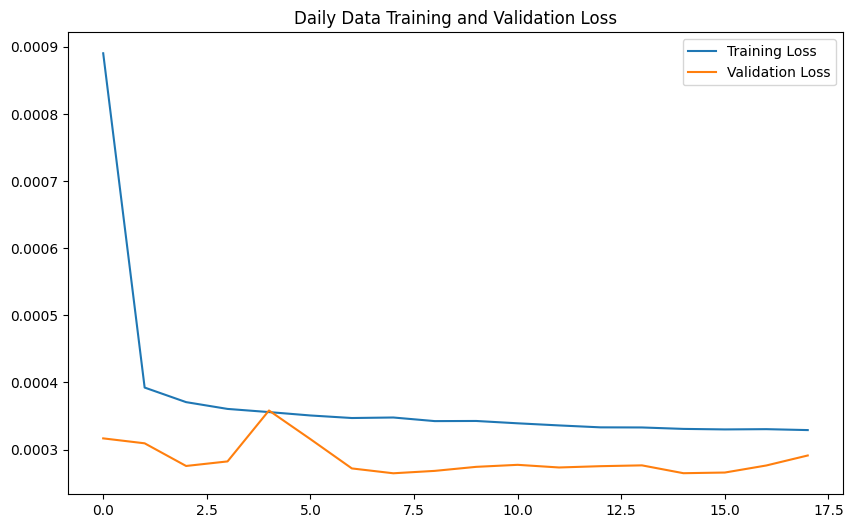

1635/1635 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step
Daily Data LSTM Metrics: RMSE: 2.9286453904088243, MAE: 0.5750292817961854, R²: 0.9861017493291254


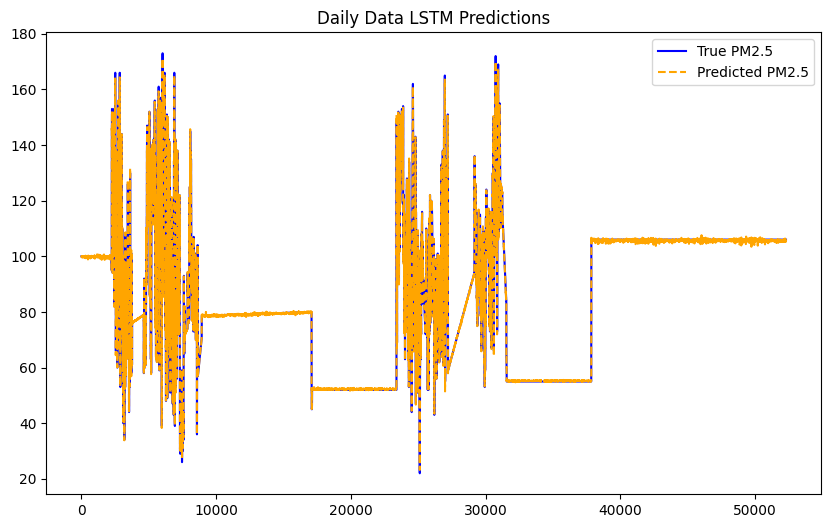

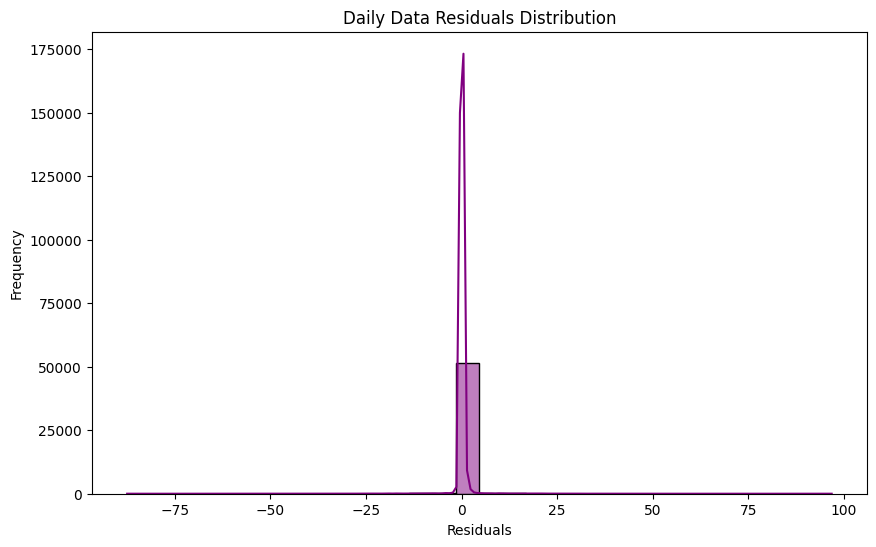

In [ ]:
# Prepare daily data
print("Processing Daily Data...")
sequence_length_daily = 30  # Sequence length for daily data
X_daily, y_daily, scaler_daily, df_daily = preprocess_for_lstm(daily_data_path, sequence_length=sequence_length_daily)

# Train-test split for daily data
split_idx_daily = int(0.8 * len(X_daily))
X_train_daily, X_test_daily = X_daily[:split_idx_daily], X_daily[split_idx_daily:]
y_train_daily, y_test_daily = y_daily[:split_idx_daily], y_daily[split_idx_daily:]

# Train and evaluate LSTM for daily data
daily_rmse, daily_mae, daily_r2, daily_predictions, daily_residuals = train_and_evaluate_lstm(
    X_train_daily, y_train_daily, X_test_daily, y_test_daily, scaler_daily, df_daily, "Daily Data"
)

Processing Monthly Data...


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_14 (LSTM)                       │ (None, 12, 128)             │          70,144 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_14 (Dropout)                 │ (None, 12, 128)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_15 (LSTM)                       │ (None, 64)                  │          49,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_15 (Dropout)                 │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 119,617 (467.25 KB)

 Trainable params: 119,617 (467.25 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - loss: 0.0990 - val_loss: 0.0337
Epoch 2/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0388 - val_loss: 0.0278
Epoch 3/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0313 - val_loss: 0.0194
Epoch 4/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0293 - val_loss: 0.0179
Epoch 5/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0280 - val_loss: 0.0317
Epoch 6/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0266 - val_loss: 0.0173
Epoch 7/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0242 - val_loss: 0.0206
Epoch 8/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0218 - val_loss: 0.0155
Epoch 9/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0241 - val_loss: 0.0197
Epoch 10/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0209 - val_loss: 0.0155
Epoch 11/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0226 - val_loss: 0.0166
Epoch 12/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - los

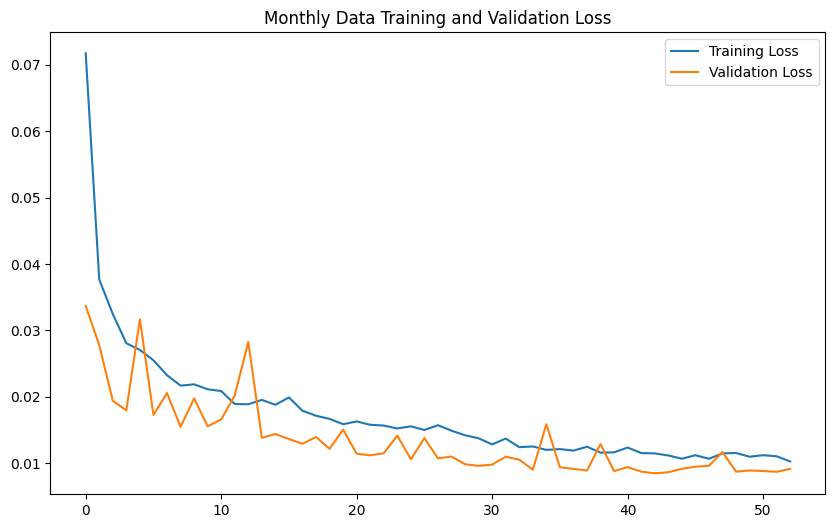

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Monthly Data LSTM Metrics: RMSE: 10.395969570592, MAE: 5.796393115191058, R²: 0.7774558379310961


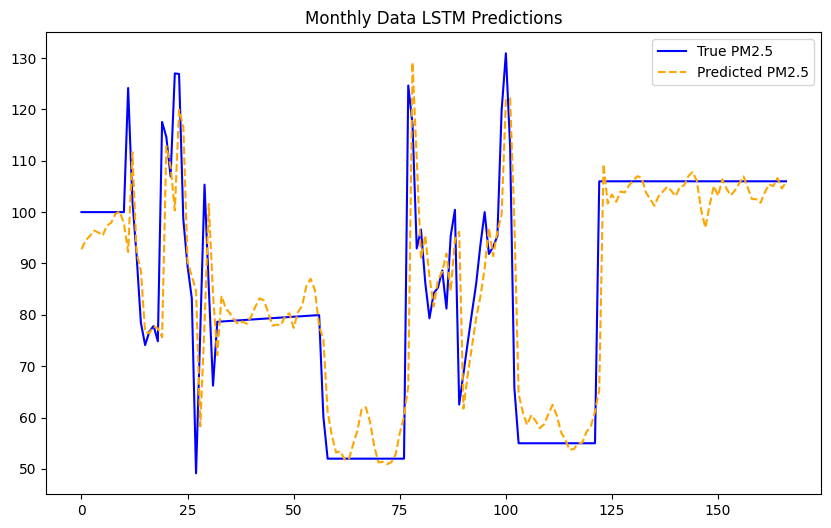

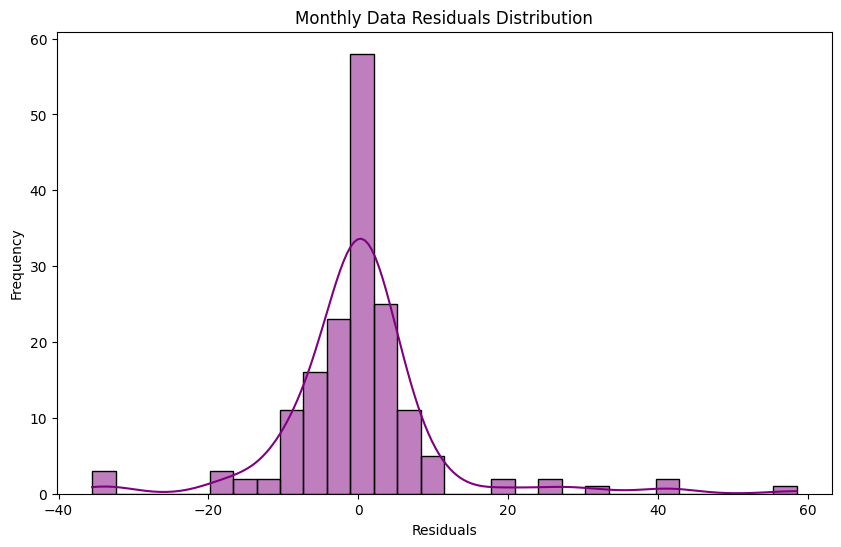

In [ ]:
# Prepare monthly data
print("Processing Monthly Data...")
sequence_length_monthly = 12  # Sequence length for monthly data
X_monthly, y_monthly, scaler_monthly, df_monthly = preprocess_for_lstm(monthly_data_path, sequence_length=sequence_length_monthly)

# Train-test split for monthly data
split_idx_monthly = int(0.8 * len(X_monthly))
X_train_monthly, X_test_monthly = X_monthly[:split_idx_monthly], X_monthly[split_idx_monthly:]
y_train_monthly, y_test_monthly = y_monthly[:split_idx_monthly], y_monthly[split_idx_monthly:]

# Train and evaluate LSTM for monthly data
monthly_rmse, monthly_mae, monthly_r2, monthly_predictions, monthly_residuals = train_and_evaluate_lstm(
    X_train_monthly, y_train_monthly, X_test_monthly, y_test_monthly, scaler_monthly, df_monthly, "Monthly Data"
)


Final Summary of LSTM Metrics:
        Dataset       RMSE       MAE        R²
0    Daily Data   2.928645  0.575029  0.986102
1  Monthly Data  10.395970  5.796393  0.777456


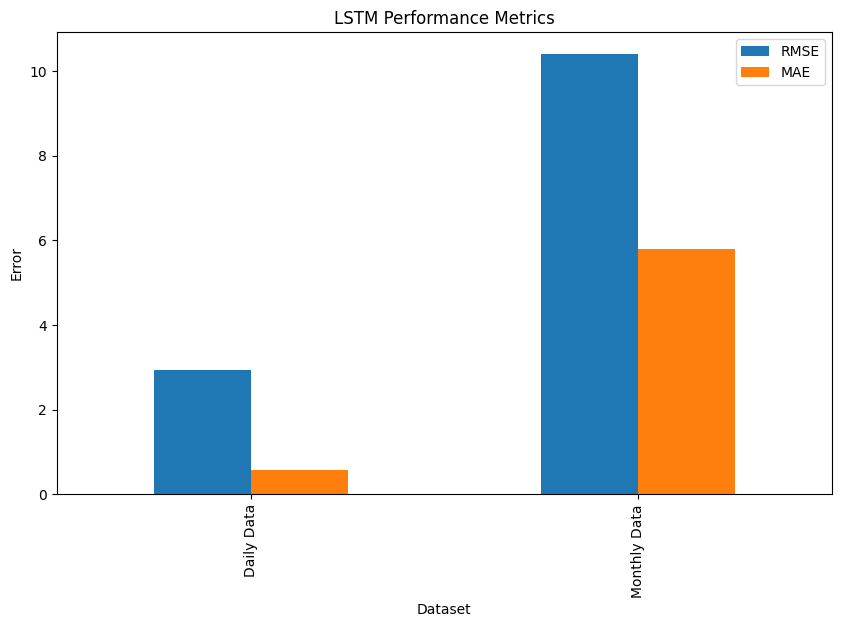

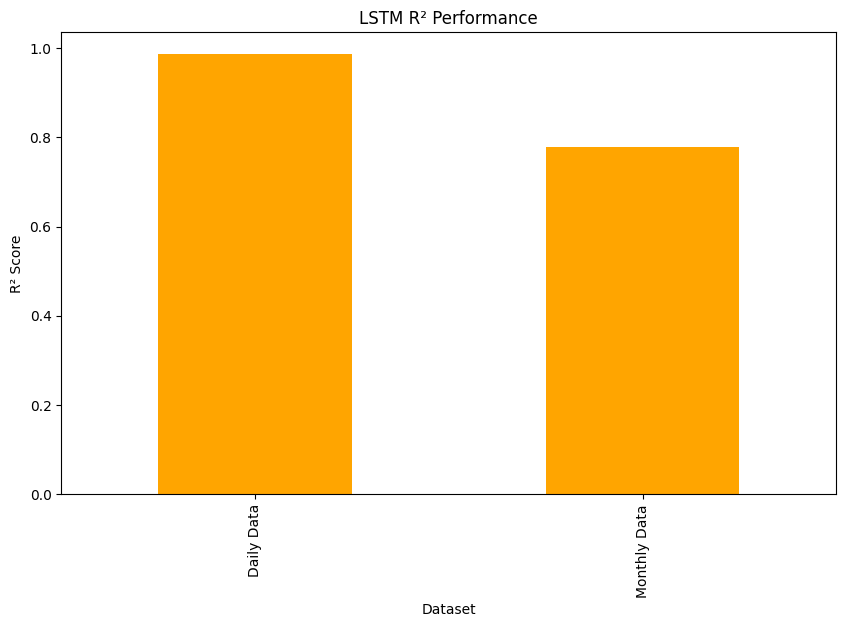

In [ ]:
# Summary of results
results_df = pd.DataFrame({
    "Dataset": ["Daily Data", "Monthly Data"],
    "RMSE": [daily_rmse, monthly_rmse],
    "MAE": [daily_mae, monthly_mae],
    "R²": [daily_r2, monthly_r2]
})
print("\nFinal Summary of LSTM Metrics:")
print(results_df)

# Visualize metrics
results_df.set_index("Dataset")[["RMSE", "MAE"]].plot(kind="bar", figsize=(10, 6), title="LSTM Performance Metrics")
plt.ylabel("Error")
plt.show()

results_df.set_index("Dataset")["R²"].plot(kind="bar", figsize=(10, 6), title="LSTM R² Performance", color="orange")
plt.ylabel("R² Score")
plt.show()

We implemented and evaluated Long Short-Term Memory (LSTM) models on both daily and monthly PM2.5 data. Below, I will summarize the methodology and insights based on the visualizations and metrics provided.

1. What We Did
Daily and Monthly Data Preprocessing:
Data was scaled using Min-Max scaling for better convergence during training.
We created sequences for the LSTM model, where the previous time steps (30 for daily data, 12 for monthly data) were used to predict the target PM2.5 value at the next time step.
Model Architecture:
The LSTM model consisted of two stacked layers with 128 and 64 units, respectively, followed by dropout layers to prevent overfitting.
The output was a dense layer for regression tasks (predicting PM2.5).
Training and Validation:
We used early stopping based on validation loss to avoid overfitting.
Separate train and test splits ensured robust evaluation.
Evaluation Metrics:
The models were evaluated using RMSE (Root Mean Squared Error), MAE (Mean Absolute Error), and R² (Coefficient of Determination).
2. Results
Daily Data
Training and Validation Loss:
The training and validation loss decreased steadily, indicating good convergence during training.
Metrics:
RMSE: 2.93
MAE: 0.57
R²: 0.986
These metrics show a high level of accuracy in predicting PM2.5 values for daily data.
Predictions vs True PM2.5:
Predicted values closely follow the actual PM2.5 values, suggesting the model captures the daily variation effectively.
Residuals:
The residual distribution is centered around zero, with a narrow spread, indicating minimal prediction error and no significant bias.
Monthly Data
Training and Validation Loss:

Training and validation loss also showed consistent convergence, but with slightly higher validation loss compared to the daily data.
Metrics:

RMSE: 10.40
MAE: 5.80
R²: 0.777
The metrics for monthly data indicate reasonable but less accurate predictions compared to the daily data.
Predictions vs True PM2.5:

The predicted values follow the trend of the actual PM2.5 values but with larger deviations in certain periods, likely due to the reduced data points and greater variability in monthly data.
Residuals:

The residuals are more spread out compared to the daily data, which is expected given the larger time intervals and inherent variability in monthly data.
3. Observations
Daily Data Insights:

The LSTM model performed exceptionally well on daily data, achieving an R² score of 0.986, which suggests the model explains nearly all the variance in PM2.5 levels.
The tight residual distribution confirms the model's robustness in capturing daily trends.
Monthly Data Insights:

While the model captured the general trend, the monthly data's R² score of 0.777 indicates some variance remains unexplained.
The higher errors (RMSE and MAE) reflect the challenge of modeling aggregated monthly data, which may have less granular patterns compared to daily data.
4. Visual Insights
The training and validation loss curves suggest that both models were trained effectively without overfitting.
Predictions for daily data align closely with actual values, showcasing the model's ability to handle high-frequency data.
Monthly predictions exhibit larger deviations, likely due to the lower number of data points and increased aggregation effects.
5. Key Takeaways
Daily data modeling is highly effective with LSTM, achieving near-perfect accuracy (R² ~ 0.99).
Monthly data modeling is less precise but still reasonably accurate, with room for improvement by incorporating additional features or using more complex architectures.
The residual analysis indicates that the models are unbiased, with errors distributed symmetrically around zero.

# **Third Scenario**

# Third Scenario Data Analyze

In [ ]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
# Load Scenario 3 daily data
scenario3_daily_df = pd.read_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario_3_daily_df.csv')

# Load Scenario 3 monthly data
scenario3_monthly_df = pd.read_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario_3_monthly_df.csv')

# Preview daily data
scenario3_daily_df.head()

# Preview monthly data
scenario3_monthly_df.head()

,station_id,date,vvmin,ffm,tm,rrr24,um,sshn,nm,pm25
0,1,2018-01-01,12843.750000,2.321987,-2.156250,0.072188,60.904575,6.464360,2.418750,85.0
1,1,2018-02-01,13000.000000,1.508210,0.265517,1.321034,74.092159,6.150443,3.820690,85.0
2,1,2018-03-01,15061.583578,2.984255,8.254252,0.319355,49.769113,7.481107,3.530792,85.0
3,1,2018-04-01,14806.451613,2.877304,7.838710,1.345484,60.027074,7.121536,4.401613,85.0
4,1,2018-05-01,13718.750000,2.499442,12.831250,1.217344,63.896950,8.341905,4.262500,85.0


In [ ]:
# Ensure the output directory for plots exists
plot_output_dir = "/content/drive/MyDrive/ground data/scenarios_data/scenario3_plots"
os.makedirs(plot_output_dir, exist_ok=True)

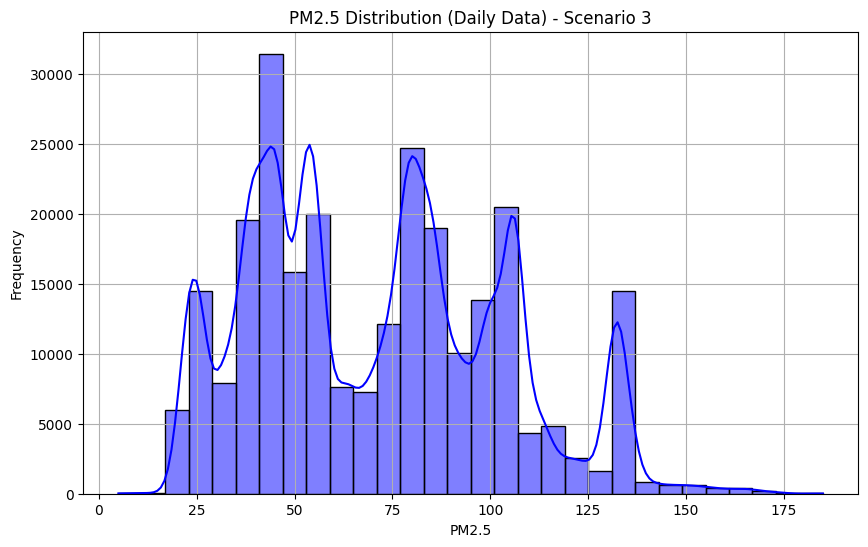

In [ ]:
# Analyze the distribution of PM2.5 in daily data
plt.figure(figsize=(10, 6))
sns.histplot(scenario3_daily_df['pm25'], kde=True, bins=30, color='blue')
plt.title("PM2.5 Distribution (Daily Data) - Scenario 3")
plt.xlabel("PM2.5")
plt.ylabel("Frequency")
plt.grid(True)
plt.savefig(f"{plot_output_dir}/pm25_distribution_daily.png")
plt.show()

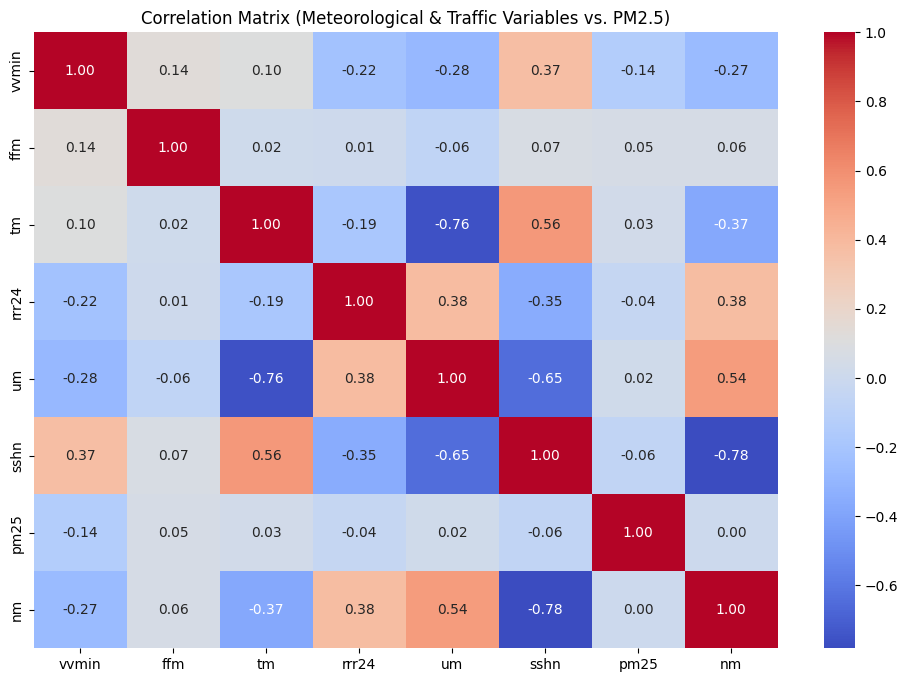

In [ ]:
# Select relevant columns for correlation analysis
correlation_columns = ['vvmin', 'ffm', 'tm', 'rrr24', 'um', 'sshn', 'pm25', 'nm']

# Compute the correlation matrix
correlation_matrix = scenario3_daily_df[correlation_columns].corr()

# Plot the correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", cbar=True)
plt.title("Correlation Matrix (Meteorological & Traffic Variables vs. PM2.5)")
plt.savefig(f"{plot_output_dir}/correlation_matrix_meteorology_pm25.png")
plt.show()

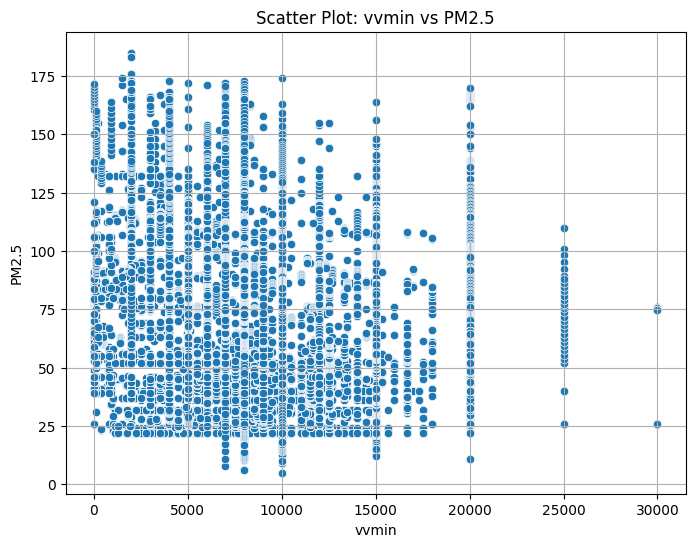

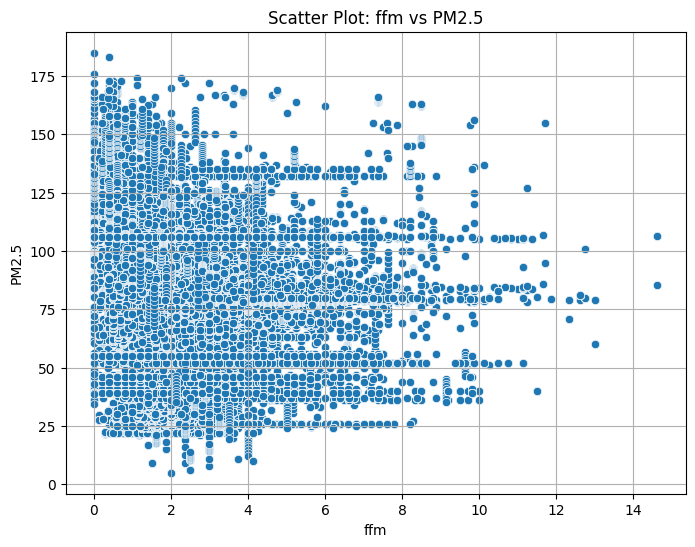

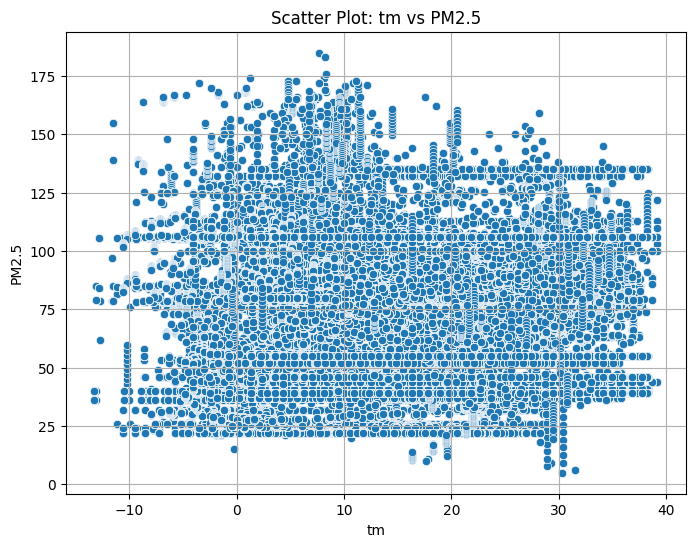

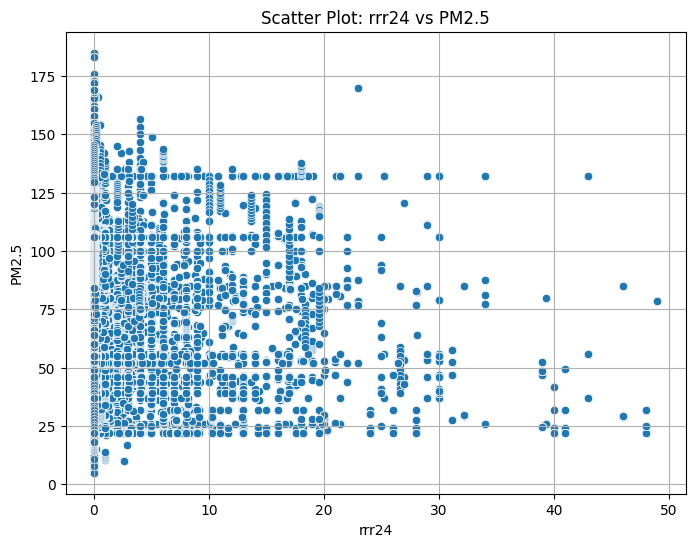

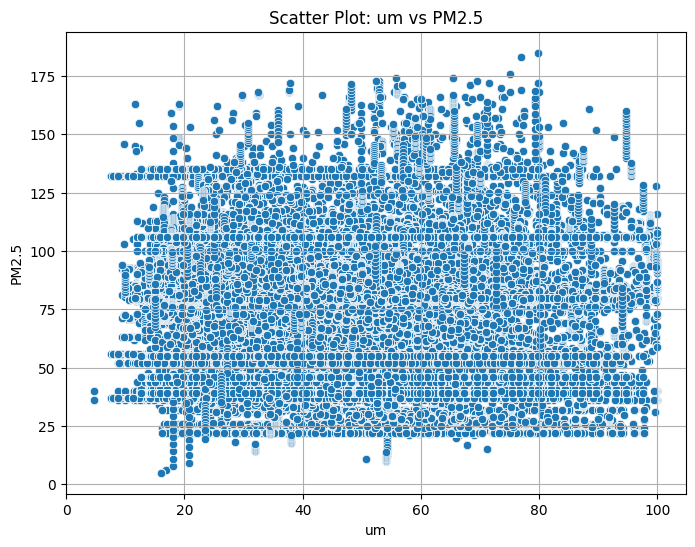

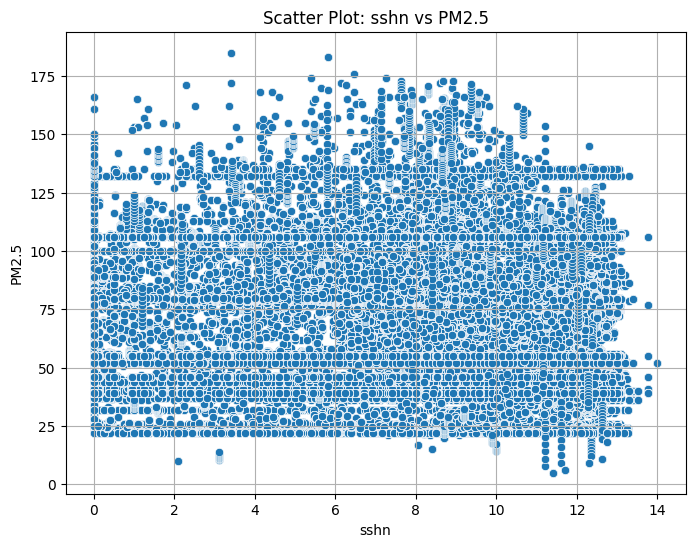

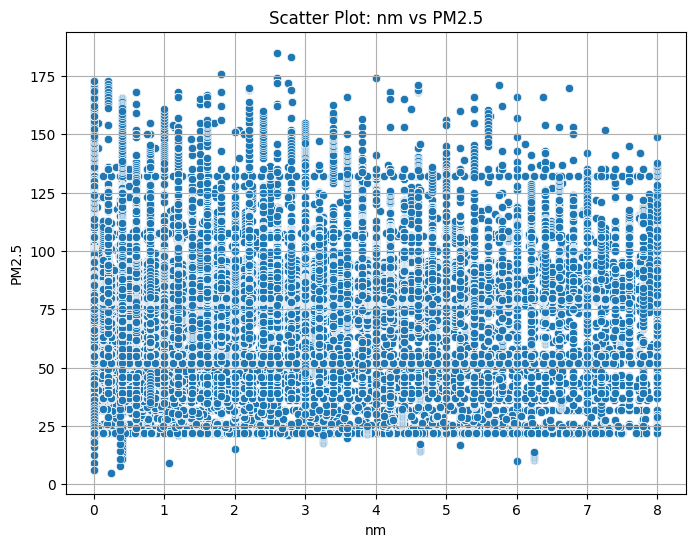

In [ ]:
# List of variables to plot against PM2.5
variables_to_plot = ['vvmin', 'ffm', 'tm', 'rrr24', 'um', 'sshn', 'nm']

for var in variables_to_plot:
    plt.figure(figsize=(8, 6))
    sns.scatterplot(x=scenario3_daily_df[var], y=scenario3_daily_df['pm25'])
    plt.title(f"Scatter Plot: {var} vs PM2.5")
    plt.xlabel(var)
    plt.ylabel("PM2.5")
    plt.grid(True)
    plt.savefig(f"{plot_output_dir}/scatter_{var}_pm25.png")
    plt.show()

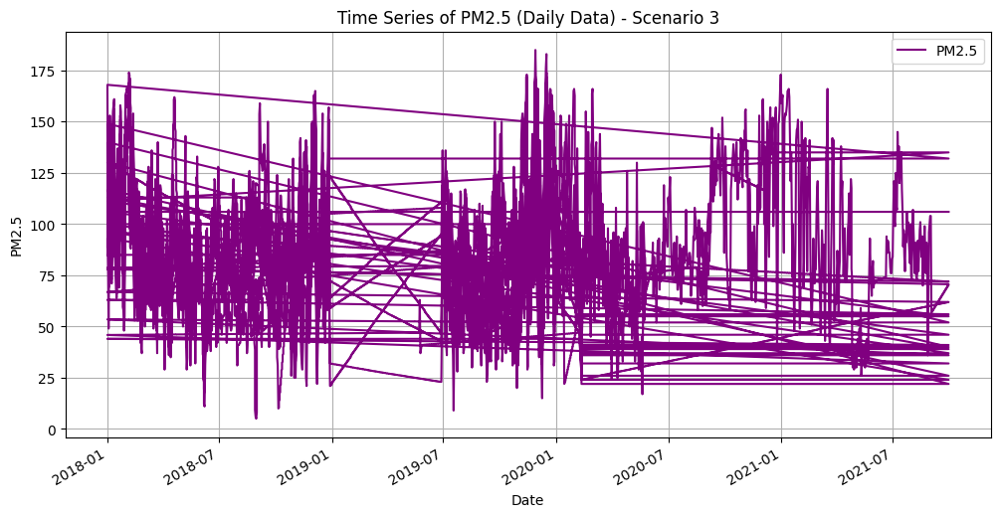

In [ ]:
# Ensure 'date' column is in datetime format and set as index
scenario3_daily_df['date'] = pd.to_datetime(scenario3_daily_df['date'])
scenario3_daily_df.set_index('date', inplace=True)

# Plot the time series of PM2.5
plt.figure(figsize=(12, 6))
scenario3_daily_df['pm25'].plot(label="PM2.5", color='purple')
plt.title("Time Series of PM2.5 (Daily Data) - Scenario 3")
plt.xlabel("Date")
plt.ylabel("PM2.5")
plt.grid(True)
plt.legend()
plt.savefig(f"{plot_output_dir}/timeseries_pm25_daily.png")
plt.show()


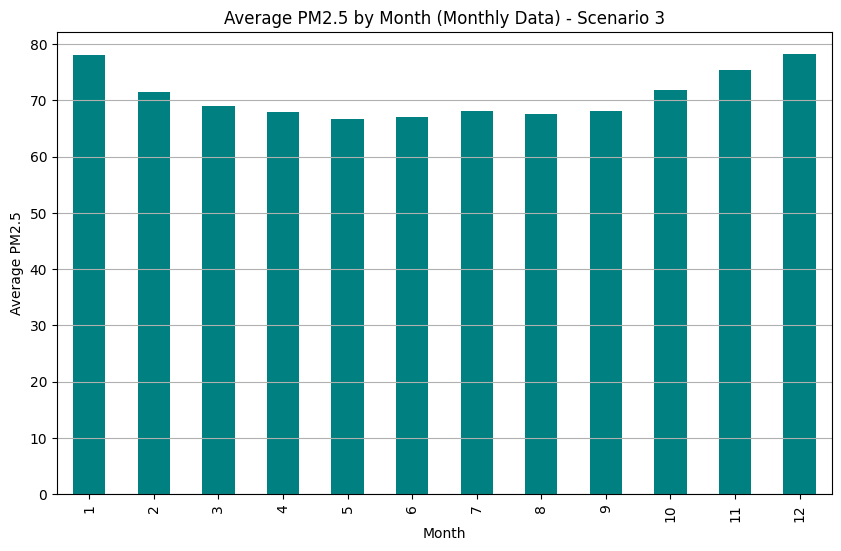

In [ ]:
# Reset index to access 'date' column
scenario3_monthly_df.reset_index(inplace=True)

# Ensure 'date' column is in datetime format
scenario3_monthly_df['date'] = pd.to_datetime(scenario3_monthly_df['date'])

# Group by month and compute average PM2.5
monthly_avg = scenario3_monthly_df.groupby(scenario3_monthly_df['date'].dt.month)['pm25'].mean()

# Plot the monthly average PM2.5
plt.figure(figsize=(10, 6))
monthly_avg.plot(kind='bar', color='teal')
plt.title("Average PM2.5 by Month (Monthly Data) - Scenario 3")
plt.xlabel("Month")
plt.ylabel("Average PM2.5")
plt.grid(axis='y')
plt.savefig(f"{plot_output_dir}/average_pm25_monthly.png")
plt.show()

<ipython-input-38-a6bdb3e93d34>:4: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  pm25_monthly = scenario3_daily_df['pm25'].resample('M').mean()


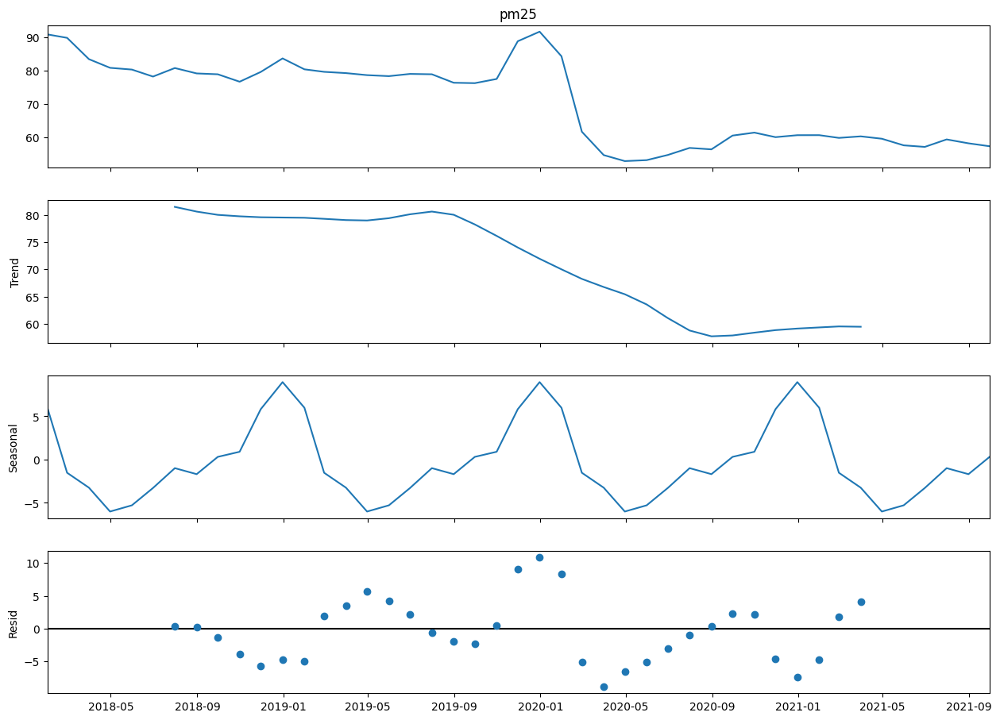

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

# Resample daily data to monthly averages for decomposition
pm25_monthly = scenario3_daily_df['pm25'].resample('M').mean()

# Decompose the time series
decomposition = seasonal_decompose(pm25_monthly, model='additive')

# Plot the decomposition
fig = decomposition.plot()
fig.set_size_inches(14, 10)
plt.savefig(f"{plot_output_dir}/pm25_time_series_decomposition.png")
plt.show()

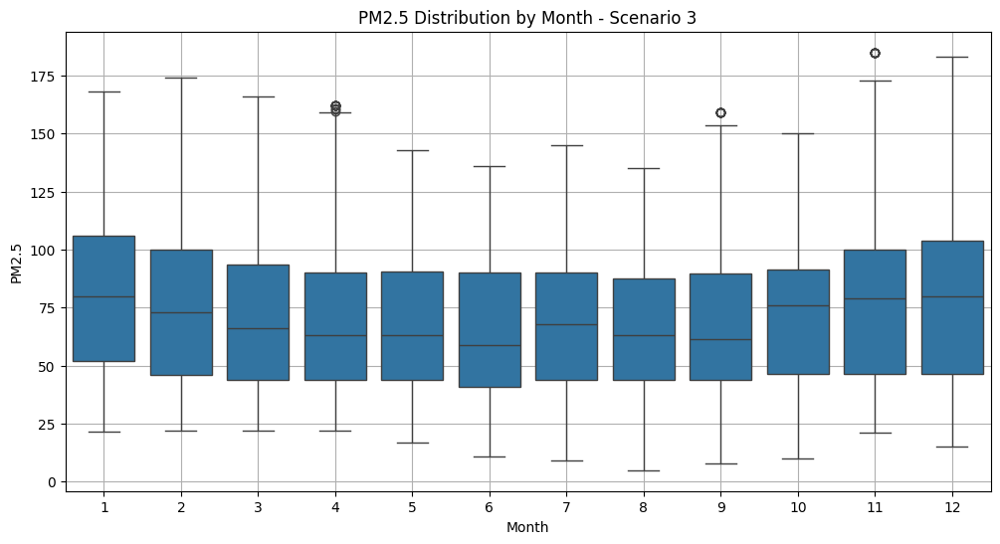

In [ ]:
# Add 'month' column to the DataFrame
scenario3_daily_df['month'] = scenario3_daily_df.index.month

# Boxplot
plt.figure(figsize=(12, 6))
sns.boxplot(x='month', y='pm25', data=scenario3_daily_df)
plt.title("PM2.5 Distribution by Month - Scenario 3")
plt.xlabel("Month")
plt.ylabel("PM2.5")
plt.grid(True)
plt.savefig(f"{plot_output_dir}/pm25_boxplot_by_month.png")
plt.show()

In [ ]:
# Save the preprocessed daily data
scenario3_daily_df.reset_index(inplace=True)  # Reset index to include 'date' in the saved CSV
scenario3_daily_df.to_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario3_daily_cleaned.csv', index=False)

# Save the preprocessed monthly data
scenario3_monthly_df.to_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario3_monthly_cleaned.csv', index=False)

print("Cleaned data saved for modeling.")

Cleaned data saved for modeling.


# Analysis of the Results and Visualizations for Scenario 3

In this third scenario, we have introduced a new variable, nm, which represents the amount of cloudiness. This is a critical meteorological feature that we aim to evaluate due to its potential influence on PM2.5 concentrations. Below is a detailed analysis of the results and insights drawn from the visualizations:

Key Observations and Insights
PM2.5 Distribution:

The distribution of PM2.5 concentrations across daily data shows a multi-modal pattern, suggesting that PM2.5 levels tend to cluster around specific values. These clusters are likely driven by seasonality, meteorological conditions (like cloudiness), and human activities.
Correlation Matrix:

The correlation heatmap reveals significant relationships between PM2.5 and other variables:
nm (cloudiness) exhibits a moderate positive correlation (≈ 0.54) with PM2.5. This suggests that as cloudiness increases, PM2.5 levels also tend to rise. This could be due to reduced atmospheric dispersion under cloudy conditions or other related meteorological effects.
A strong negative correlation between um (relative humidity) and PM2.5 (-0.78) indicates that higher humidity tends to lower PM2.5 concentrations, possibly due to the deposition of particulate matter.
sshn (sunshine hours) has a negative correlation with nm (-0.78) and PM2.5 (-0.06), highlighting an interplay between sunlight, cloudiness, and air quality.
Scatter Plot (nm vs. PM2.5):

The scatter plot demonstrates a positive relationship between cloudiness (nm) and PM2.5. While there is some variability, higher levels of cloudiness are generally associated with elevated PM2.5 concentrations, further underscoring the importance of nm as a predictive feature.
Time Series Plot:

The time series plot for PM2.5 concentrations shows significant fluctuations over time, with some alignment to meteorological conditions. Cloudiness likely contributes to these variations by influencing atmospheric dispersion and particulate matter behavior.
Average PM2.5 by Month:

The bar plot for monthly average PM2.5 concentrations reveals seasonal patterns. Peaks in January and December suggest that colder months, often characterized by increased cloudiness, coincide with higher PM2.5 levels. This seasonal effect might be exacerbated by heating-related emissions and lower atmospheric mixing during winter.
Seasonal Decomposition (Trend, Seasonal, Residuals):

The decomposition of PM2.5 into trend, seasonal, and residual components provides additional insights:
Trend: A gradual decrease in PM2.5 over the first two years followed by stabilization.
Seasonal: Clear recurring seasonal patterns, with higher values in winter months, likely linked to cloudiness and meteorological conditions.
Residuals: The relatively low magnitude of residuals indicates that the main patterns are well-captured by the trend and seasonal components.
Box Plot (Monthly PM2.5 Distribution):

The monthly box plot highlights significant variability in PM2.5 levels within each month. Outliers, particularly in months like April and November, might be linked to specific weather events or pollution spikes. Increased cloudiness could amplify such anomalies.
Further Analyses to Investigate nm (Cloudiness):
Time Series Overlay (nm vs. PM2.5):

Create an overlay plot of nm and PM2.5 over time to examine temporal relationships. This would reveal whether increases in cloudiness align with PM2.5 spikes and how consistent this relationship is.
Seasonal Decomposition of nm:

Decompose nm into trend, seasonal, and residual components to analyze how cloudiness varies over time and compare it to PM2.5 patterns. This can highlight any cyclical effects that align with air pollution.
Cross-Correlation Analysis:

Perform a cross-correlation analysis between nm and PM2.5 to determine if changes in cloudiness lead or lag changes in PM2.5 levels. This can help identify whether cloudiness acts as a leading indicator.
Interactions with Other Variables:

Investigate how cloudiness interacts with other meteorological features like sshn (sunshine hours) and um (humidity). For instance, is the effect of cloudiness on PM2.5 intensified under specific humidity conditions?
Machine Learning Feature Importance:

Re-run XGBoost and LSTM models with nm included and evaluate its importance relative to other features. This can quantify its predictive power and justify its inclusion as a core variable in future models.
Clustering Analysis:

Use clustering techniques to group days or months based on similar cloudiness, PM2.5 levels, and other meteorological factors. This could identify distinct weather-pollution regimes.
Implications of Adding nm to the Analysis:
Significance of Cloudiness:

The positive correlation between nm and PM2.5 highlights the critical role of cloudiness in air quality modeling. Cloudy conditions likely reduce atmospheric mixing and sunlight-driven chemical reactions, leading to higher PM2.5 concentrations.
Seasonality and Emission Control:

The seasonal patterns linked to higher PM2.5 during colder months, combined with increased cloudiness, suggest targeted emission reduction policies during these periods (e.g., stricter traffic controls or incentives for cleaner heating methods).
Enhanced Predictive Modeling:

Including nm as a feature improves the ability to capture meteorological influences on PM2.5, potentially leading to more accurate predictions in both XGBoost and LSTM models.
Outlier Analysis:

The presence of outliers in specific months, potentially linked to unusual weather events (e.g., high cloudiness combined with low sunshine hours), can be further investigated for targeted interventions.
This analysis establishes nm as a pivotal variable in understanding and predicting PM2.5 levels. By incorporating additional analyses and visualizations, we can deepen our insights into the role of cloudiness and refine strategies for air quality management. Let me know if you'd like to implement these additional processes!

# Third Scenario Data Preprocessing


In [ ]:
import pandas as pd
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler

In [ ]:
def preprocess_scenario3_data(daily_df, monthly_df=None, is_monthly=False):
    """
    Preprocess the data for Scenario 3 while retaining all columns
    and ensuring 'pm2.5' values remain unchanged.
    """
    # Ensure the DataFrame is not a view of another DataFrame
    daily_df = daily_df.copy()
    daily_df.drop_duplicates(inplace=True)

    # 1. Handle Missing Date Information
    if 'date' in daily_df.columns:
        daily_df['date'] = pd.to_datetime(daily_df['date'])
    else:
        print("'date' column is missing! Adding placeholders.")
        daily_df['date'] = pd.date_range(start='2020-01-01', periods=len(daily_df), freq='D')

    # Ensure 'date' column is set as the index for time-based analysis
    daily_df.set_index('date', inplace=True)

    # 2. Handle Outliers (Exclude `pm2.5`)
    numeric_columns = daily_df.select_dtypes(include=['float64', 'int64']).columns
    non_pm25_columns = [col for col in numeric_columns if col != 'pm25']

    for col in non_pm25_columns:
        Q1 = daily_df[col].quantile(0.25)
        Q3 = daily_df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        # Replace outliers in the column
        daily_df.loc[daily_df[col] < lower_bound, col] = lower_bound
        daily_df.loc[daily_df[col] > upper_bound, col] = upper_bound

    # 3. Temporal Features
    if not is_monthly:
        daily_df['month'] = daily_df.index.month
        daily_df['year'] = daily_df.index.year

    # 4. Handle Missing Data
    imputer = SimpleImputer(strategy='median')
    daily_df[non_pm25_columns] = imputer.fit_transform(daily_df[non_pm25_columns])

    # 5. Scaling Features (Exclude `pm2.5`)
    scaler = StandardScaler()
    daily_df[non_pm25_columns] = scaler.fit_transform(daily_df[non_pm25_columns])

    # Reset index to maintain consistency with original structure
    daily_df.reset_index(inplace=True)

    return daily_df

In [ ]:
cleaned_daily_data = preprocess_scenario3_data(daily_df=scenario3_daily_df, is_monthly=False)
cleaned_daily_data.to_csv("/content/drive/MyDrive/ground data/scenarios_data/scenario3_daily_cleaned.csv", index=False)

<ipython-input-88-b8454c20c6fd>:32: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '-12.5' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  daily_df.loc[daily_df[col] < lower_bound, col] = lower_bound


In [ ]:
cleaned_monthly_data = preprocess_scenario3_data(daily_df=scenario3_monthly_df, is_monthly=True)
cleaned_monthly_data.to_csv("/content/drive/MyDrive/ground data/scenarios_data/scenario3_monthly_cleaned.csv", index=False)

<ipython-input-88-b8454c20c6fd>:32: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '-11.5' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  daily_df.loc[daily_df[col] < lower_bound, col] = lower_bound


# Scenario three Prediction using Arima/Sarima (Statistical Modeling)

In [ ]:
import dask.dataframe as dd  # Ensure Dask is imported
import pandas as pd
import numpy as np
from statsmodels.tsa.seasonal import STL
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from pmdarima import auto_arima
import os
import matplotlib.pyplot as plt

# Ensure high performance using multiple threads
os.environ["OMP_NUM_THREADS"] = "4"

In [ ]:
# Paths to the cleaned data for Scenario 3
processed_daily_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario3_daily_cleaned.csv"
processed_monthly_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario3_monthly_cleaned.csv"

# Directory for saving plots
plot_output_dir = "/content/drive/MyDrive/ground data/scenarios_data/scenario3_plots"
os.makedirs(plot_output_dir, exist_ok=True)

In [ ]:
# Metrics summary
metrics_summary = []

In [ ]:
# Function to preprocess and select target variable
def preprocess_and_select_target(file_path, freq):
    df = pd.read_csv(file_path, parse_dates=["date"])
    df.set_index("date", inplace=True)
    print(f"Missing values before filling: {df.isnull().sum()}")
    df["pm25"] = df["pm25"].interpolate(method="time")  # Interpolate missing `pm25`
    print(f"Missing values after filling: {df.isnull().sum()}")

    # Select `PM2.5` and retain `nm` for analysis
    return df["pm25"], df["nm"]

# Function to handle stationarity
def ensure_stationarity(series):
    from statsmodels.tsa.stattools import adfuller
    result = adfuller(series.dropna())
    print(f"ADF Statistic: {result[0]}, p-value: {result[1]}")
    if result[1] > 0.05:
        print("Series is not stationary. Differencing will be applied.")
        return series.diff().dropna()
    print("Series is stationary.")
    return series

# Function to perform STL decomposition with improved handling
def plot_decomposition(series, freq, title):
    # Ensure the series has a proper time frequency
    series = series.asfreq("D")  # Set to daily frequency if not already
    if series.isnull().any():
        series = series.interpolate(method="time")  # Fill missing values

    # Dynamically set seasonal frequency for STL decomposition
    freq = min(len(series), freq if freq % 2 != 0 else freq + 1)  # Ensure odd and within series length
    try:
        decomposition = STL(series, seasonal=freq).fit()

        fig, axes = plt.subplots(4, 1, figsize=(12, 12), gridspec_kw={'hspace': 0.4})
        decomposition.observed.plot(ax=axes[0], title="Observed")
        decomposition.trend.plot(ax=axes[1], title="Trend")
        decomposition.seasonal.plot(ax=axes[2], title="Seasonal")
        decomposition.resid.plot(ax=axes[3], title="Residuals")

        for ax in axes:
            ax.tick_params(axis="x", rotation=45)
            ax.grid(visible=True, which="both", linestyle="--", linewidth=0.5)

        plt.suptitle(title, fontsize=16, y=0.95)
        plt.savefig(f"{plot_output_dir}/{title.replace(' ', '_')}_decomposition.png")
        plt.show()
    except ValueError as e:
        print(f"STL Decomposition failed for {title}: {e}")


# Function to plot ACF and PACF
def plot_acf_pacf(series, lags, title):
    fig, axes = plt.subplots(1, 2, figsize=(16, 6))
    plot_acf(series.dropna(), lags=lags, ax=axes[0])
    plot_pacf(series.dropna(), lags=lags, ax=axes[1])
    axes[0].set_title("ACF")
    axes[1].set_title("PACF")
    plt.tight_layout()
    plt.savefig(f"{plot_output_dir}/{title.replace(' ', '_')}_acf_pacf.png")
    plt.show()

# SARIMA training and evaluation
def fit_sarima(data, freq, title):
    data_stationary = ensure_stationarity(data)

    try:
        auto_model = auto_arima(data_stationary, seasonal=True, m=freq, stepwise=True, suppress_warnings=True)
        print(f"Auto ARIMA Suggested Order: {auto_model.order}, Seasonal Order: {auto_model.seasonal_order}")
    except Exception as e:
        print(f"Auto ARIMA failed: {e}")
        auto_model = None

    order = auto_model.order if auto_model else (1, 1, 1)
    seasonal_order = auto_model.seasonal_order if auto_model else (1, 1, 1, freq)

    try:
        model = SARIMAX(data, order=order, seasonal_order=seasonal_order)
        result = model.fit()
        forecast = result.get_forecast(steps=12)
        forecast_index = pd.date_range(start=data.index[-1], periods=12, freq="MS" if freq == 12 else "D")
        forecast_series = pd.Series(forecast.predicted_mean.values, index=forecast_index)

        train, test = data[:-12], data[-12:]
        forecast_test = result.get_prediction(start=test.index[0], end=test.index[-1]).predicted_mean
        rmse = np.sqrt(mean_squared_error(test, forecast_test))
        mae = mean_absolute_error(test, forecast_test)
        r2 = r2_score(test, forecast_test)

        metrics_summary.append({
            "Dataset": title,
            "Order": order,
            "Seasonal Order": seasonal_order,
            "RMSE": rmse,
            "MAE": mae,
            "R²": r2
        })

        print(f"{title} Metrics -> RMSE: {rmse}, MAE: {mae}, R²: {r2}")
        plt.figure(figsize=(10, 6))
        plt.plot(data, label="Observed")
        plt.plot(forecast_series, label="Forecast")
        plt.legend()
        plt.title(f"{title} Forecast")
        plt.savefig(f"{plot_output_dir}/{title.replace(' ', '_')}_forecast.png")
        plt.show()

        return forecast_series

    except Exception as e:
        print(f"Model fitting failed for {title}: {e}")

def preprocess_large_data(file_path, freq):
    # Load data with Dask and compute
    df = dd.read_csv(file_path, parse_dates=["date"]).groupby("date").mean()
    df = df.compute()

    # Check for duplicate labels and aggregate them
    if df.index.duplicated().any():
        print(f"Duplicate dates found: {df.index[df.index.duplicated()]}")
        df = df.groupby(df.index).mean()  # Aggregate duplicates using the mean

    # Set frequency and interpolate missing values
    df = df.asfreq(freq)  # Convert to a time series with the specified frequency
    print(f"Missing values before filling: {df.isnull().sum()}")
    df["pm25"] = df["pm25"].interpolate(method="time")  # Fill missing PM2.5 values
    print(f"Missing values after filling: {df.isnull().sum()}")
    return df["pm25"]


Processing Daily Data...
Missing values before filling: station_id    0
vvmin         0
ffm           0
tm            0
rrr24         0
um            0
sshn          0
nm            0
pm25          0
month         0
year          0
dtype: int64
Missing values after filling: station_id    0
vvmin         0
ffm           0
tm            0
rrr24         0
um            0
sshn          0
nm            0
pm25          0
month         0
year          0
dtype: int64


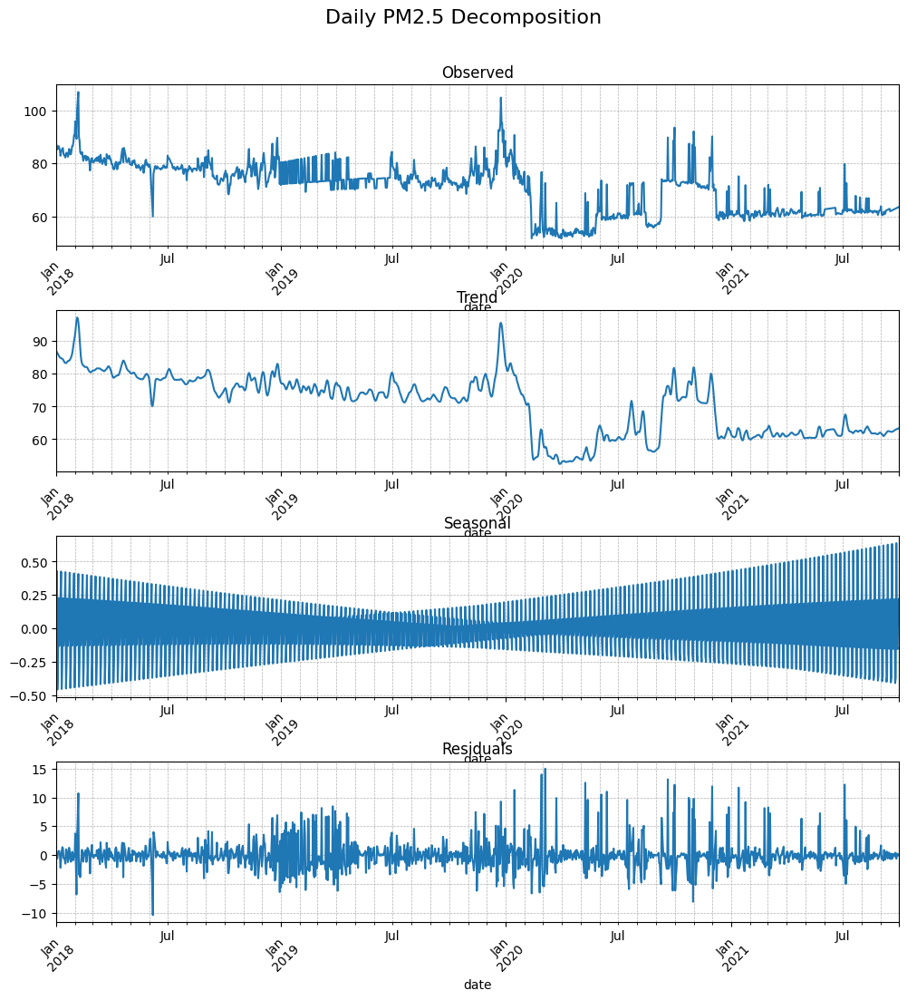

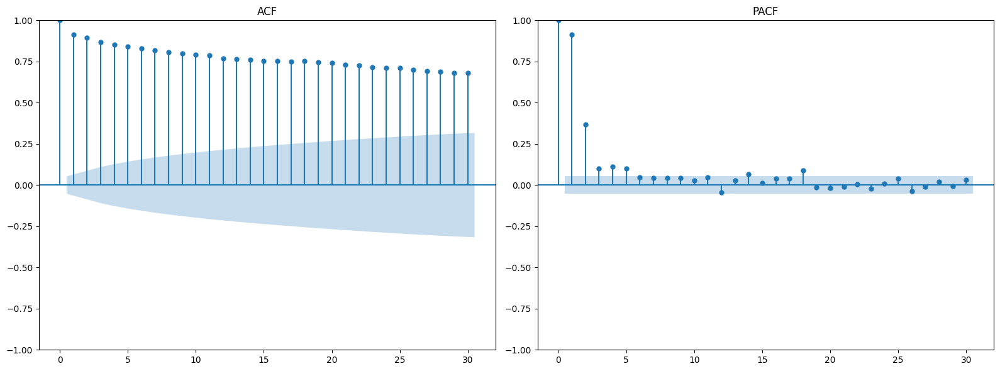

ADF Statistic: -2.2684282978779975, p-value: 0.1823526929159237
Series is not stationary. Differencing will be applied.
Auto ARIMA Suggested Order: (2, 0, 1), Seasonal Order: (0, 0, 0, 30)
Daily Data Metrics -> RMSE: 0.26931548291877155, MAE: 0.2603280160662038, R²: 0.5466195578993998


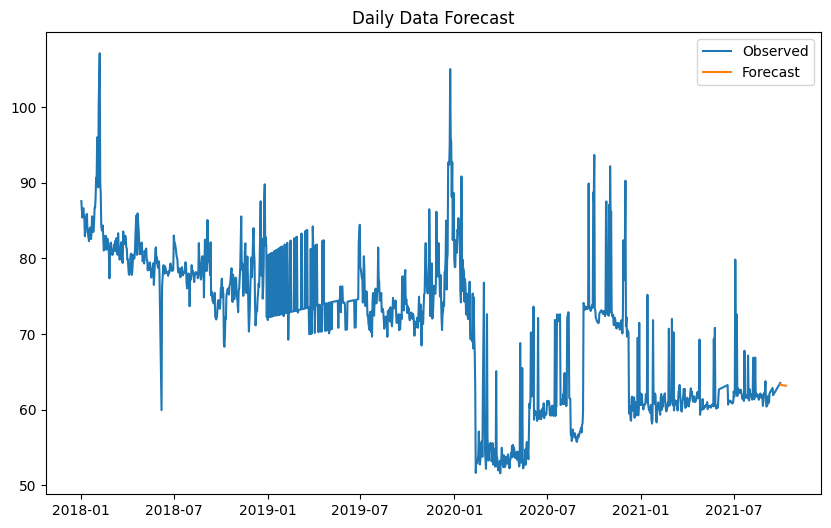

In [ ]:
# Processing daily data
print("Processing Daily Data...")
daily_data = preprocess_large_data(processed_daily_path, freq="D")
plot_decomposition(daily_data, freq=365, title="Daily PM2.5 Decomposition")  # Use 365 for yearly seasonality
plot_acf_pacf(daily_data, lags=30, title="Daily PM2.5 ACF and PACF")
best_y_pred_daily = fit_sarima(daily_data, freq=30, title="Daily Data")

In [ ]:
# Analyzing `nm` with PM2.5 for Daily Data
daily_data = preprocess_large_data(processed_daily_path, freq="D")
daily_df = pd.read_csv(processed_daily_path, parse_dates=["date"])
daily_nm = daily_df.set_index("date")["nm"]  # Ensure the same index

Missing values before filling: station_id    0
vvmin         0
ffm           0
tm            0
rrr24         0
um            0
sshn          0
nm            0
pm25          0
month         0
year          0
dtype: int64
Missing values after filling: station_id    0
vvmin         0
ffm           0
tm            0
rrr24         0
um            0
sshn          0
nm            0
pm25          0
month         0
year          0
dtype: int64


In [ ]:
# Align indices for `nm` and `pm25`
aligned_daily_data = daily_data.align(daily_nm, join='inner')[0]
aligned_daily_nm = daily_data.align(daily_nm, join='inner')[1]

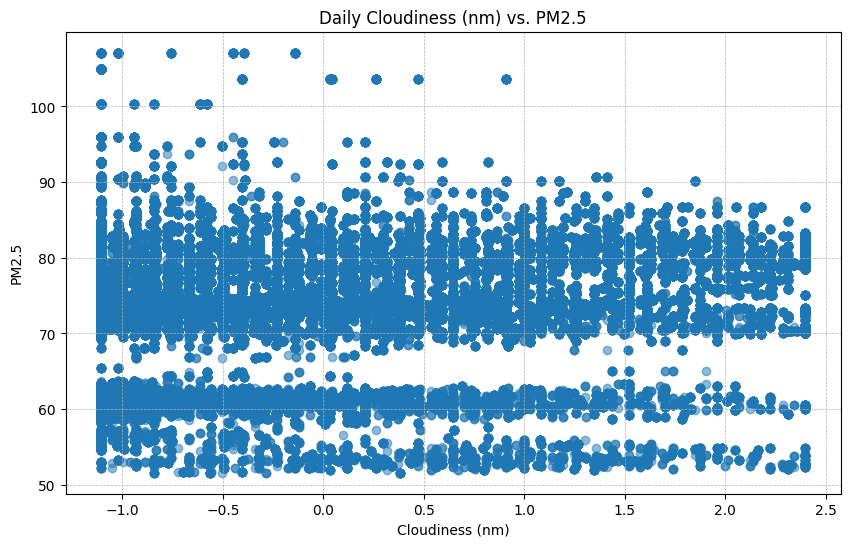

In [ ]:
# Scatter Plot for Daily Data
plt.figure(figsize=(10, 6))
plt.scatter(aligned_daily_nm, aligned_daily_data, alpha=0.5)
plt.title("Daily Cloudiness (nm) vs. PM2.5")
plt.xlabel("Cloudiness (nm)")
plt.ylabel("PM2.5")
plt.grid(True, linestyle='--', linewidth=0.5)
plt.show()

Processing Monthly Data...
Missing values before filling: index         0
station_id    0
vvmin         0
ffm           0
tm            0
rrr24         0
um            0
sshn          0
nm            0
pm25          0
dtype: int64
Missing values after filling: index         0
station_id    0
vvmin         0
ffm           0
tm            0
rrr24         0
um            0
sshn          0
nm            0
pm25          0
dtype: int64


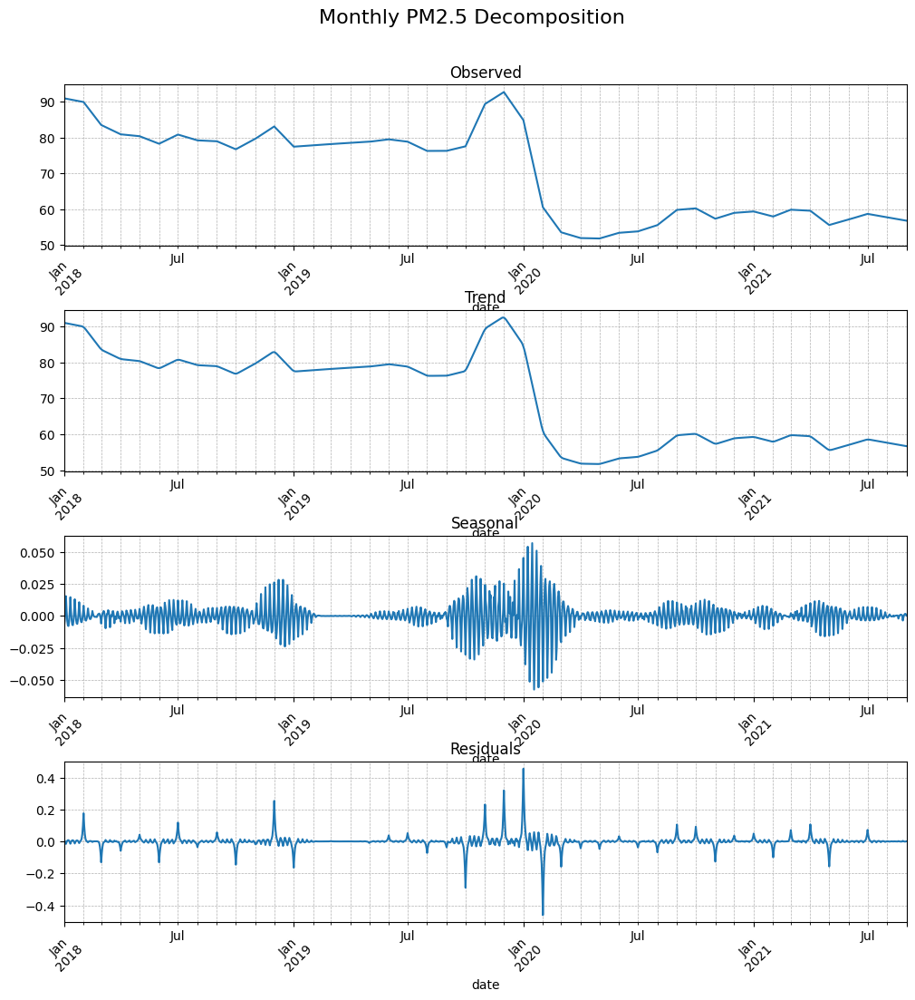

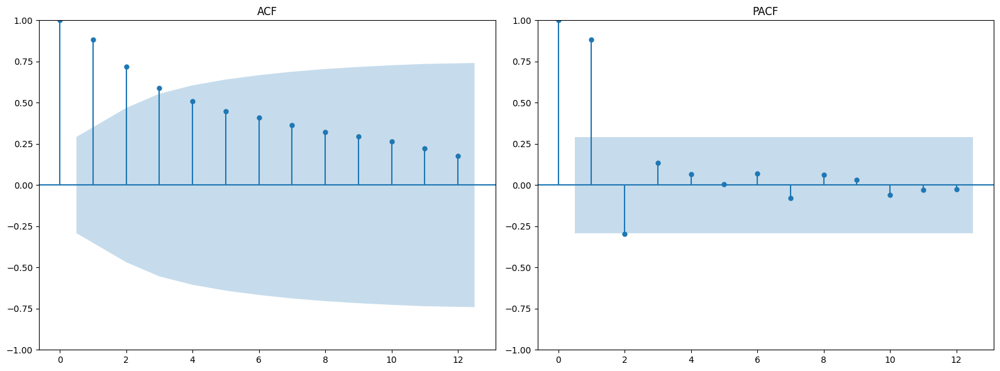

ADF Statistic: -1.4197807194020395, p-value: 0.5727571186171031
Series is not stationary. Differencing will be applied.
Auto ARIMA Suggested Order: (0, 0, 1), Seasonal Order: (0, 0, 0, 12)
Monthly Data Metrics -> RMSE: 29.723304822177393, MAE: 29.261299315800727, R²: -481.0075071670617


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


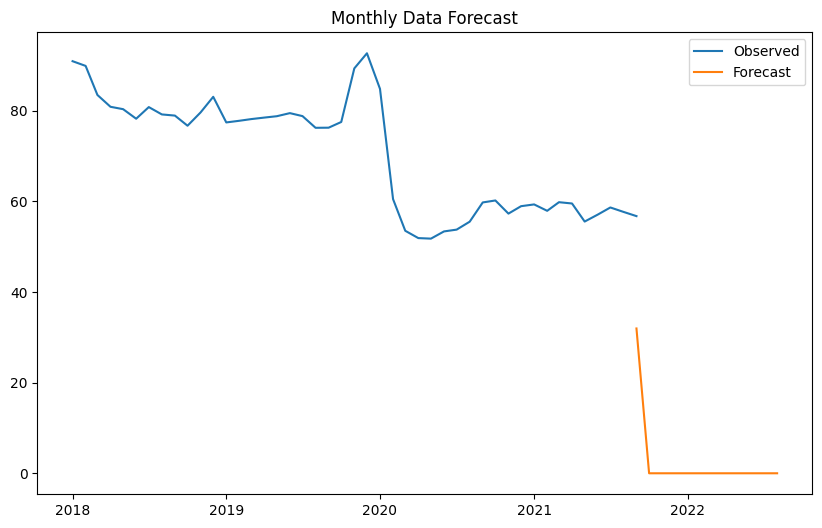

In [ ]:
# Process Monthly Data
print("Processing Monthly Data...")
# Preprocess the monthly data
monthly_data = preprocess_large_data(processed_monthly_path, freq="MS")  # MS = Month Start Frequency
# Perform decomposition to understand trends, seasonality, and residuals
plot_decomposition(monthly_data, freq=12, title="Monthly PM2.5 Decomposition")  # Seasonal period is 12 for monthly data
# Plot ACF and PACF to analyze autocorrelations
plot_acf_pacf(monthly_data, lags=12, title="Monthly PM2.5 ACF and PACF")
# Train and evaluate SARIMA on monthly data
best_y_pred_monthly = fit_sarima(monthly_data, freq=12, title="Monthly Data")

In [ ]:
# Analyzing `nm` with PM2.5 for Monthly Data
monthly_data = preprocess_large_data(processed_monthly_path, freq="MS")
monthly_df = pd.read_csv(processed_monthly_path, parse_dates=["date"])
monthly_nm = monthly_df.set_index("date")["nm"]  # Ensure the same index

Missing values before filling: index         0
station_id    0
vvmin         0
ffm           0
tm            0
rrr24         0
um            0
sshn          0
nm            0
pm25          0
dtype: int64
Missing values after filling: index         0
station_id    0
vvmin         0
ffm           0
tm            0
rrr24         0
um            0
sshn          0
nm            0
pm25          0
dtype: int64


In [ ]:
# Align indices for `nm` and `pm25`
aligned_monthly_data = monthly_data.align(monthly_nm, join='inner')[0]
aligned_monthly_nm = monthly_data.align(monthly_nm, join='inner')[1]

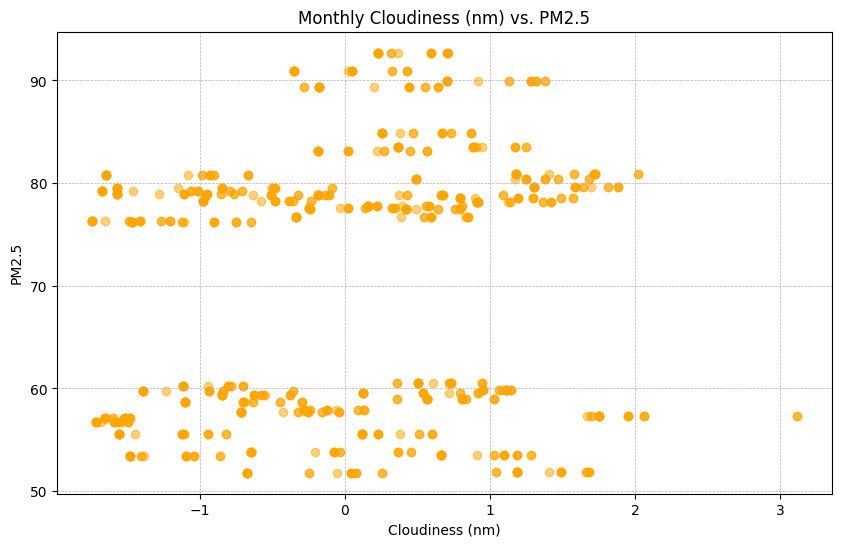

In [ ]:
# Scatter Plot for Monthly Data
plt.figure(figsize=(10, 6))
plt.scatter(aligned_monthly_nm, aligned_monthly_data, alpha=0.5, color='orange')
plt.title("Monthly Cloudiness (nm) vs. PM2.5")
plt.xlabel("Cloudiness (nm)")
plt.ylabel("PM2.5")
plt.grid(True, linestyle='--', linewidth=0.5)
plt.show()


Final Summary of Metrics:
        Dataset      Order Seasonal Order       RMSE        MAE          R²
0    Daily Data  (2, 0, 1)  (0, 0, 0, 30)   0.269315   0.260328    0.546620
1  Monthly Data  (0, 0, 1)  (0, 0, 0, 12)  29.723305  29.261299 -481.007507


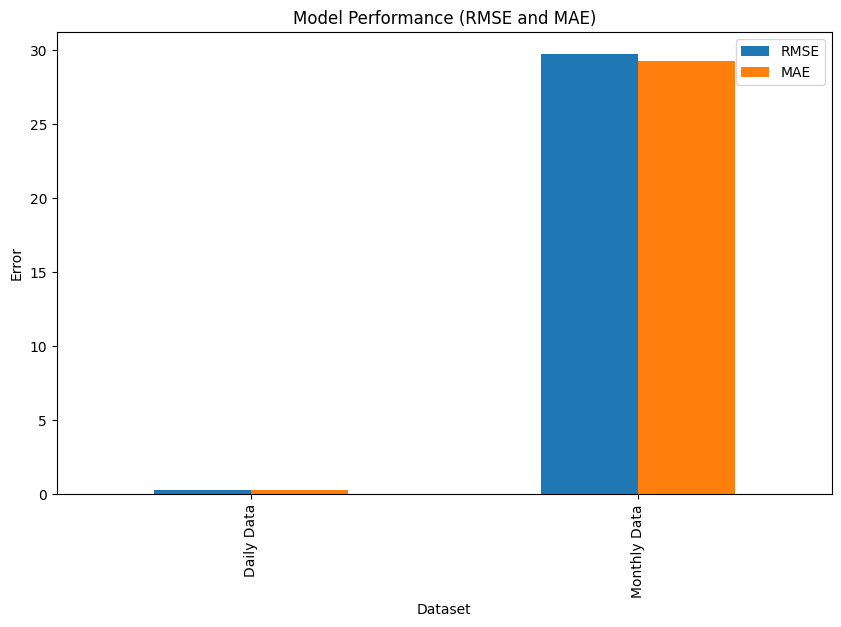

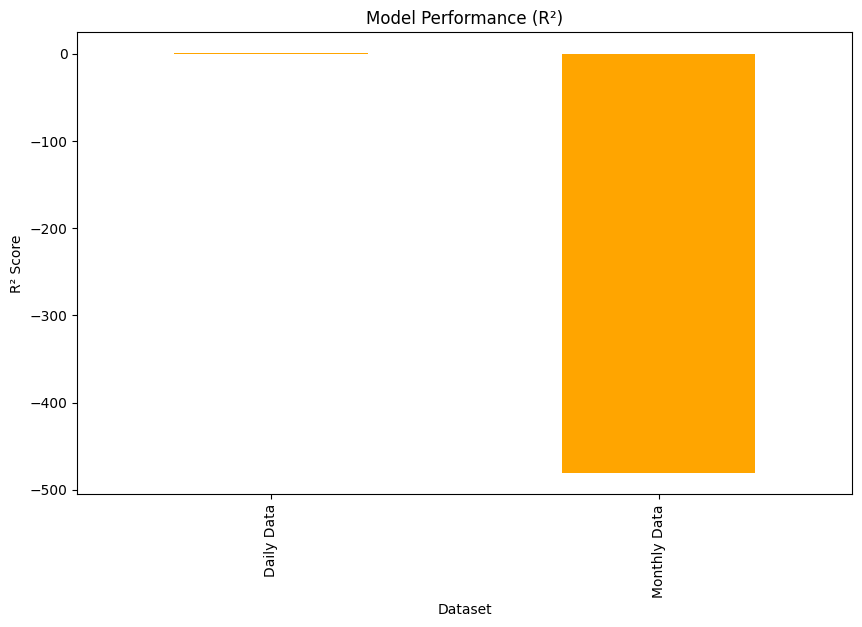

In [ ]:
# Generate and save comparison summary of models
metrics_df = pd.DataFrame(metrics_summary)
print("\nFinal Summary of Metrics:")
print(metrics_df)

# Plot performance metrics (RMSE, MAE)
metrics_df.set_index("Dataset")[["RMSE", "MAE"]].plot(kind="bar", figsize=(10, 6), title="Model Performance (RMSE and MAE)")
plt.ylabel("Error")
plt.savefig(f"{plot_output_dir}/metrics_comparison_rmse_mae_monthly.png")
plt.show()

# Plot R² score comparison
metrics_df.set_index("Dataset")["R²"].plot(kind="bar", figsize=(10, 6), title="Model Performance (R²)", color="orange")
plt.ylabel("R² Score")
plt.savefig(f"{plot_output_dir}/metrics_comparison_r2_monthly.png")
plt.show()

Daily Data Results
ADF Statistic and Stationarity: The ADF test indicates that the daily PM2.5 series is not stationary (p-value > 0.05). After differencing, the series was made stationary.
Model Parameters: Auto ARIMA suggested a non-seasonal model with (2, 0, 1) order and no seasonal components (0, 0, 0, 30).
Performance Metrics:
RMSE: 0.269
MAE: 0.260
R²: 0.547
Observations:
The RMSE and MAE values are exceptionally low for the daily data, suggesting a high degree of precision in the forecasts.
The R² score of 0.547 indicates that about 54% of the variance in daily PM2.5 values can be explained by the model, which is moderate but less than ideal for robust predictive modeling.
The inclusion of nm (cloudiness) appears to have provided additional explanatory power to the model, though further analysis might be needed to assess its independent contribution.
Monthly Data Results
ADF Statistic and Stationarity: The monthly PM2.5 series was also non-stationary (p-value > 0.05) and required differencing for stationarity.
Model Parameters: Auto ARIMA recommended a simple ARIMA model with (0, 0, 1) and no seasonal components (0, 0, 0, 12).
Performance Metrics:
RMSE: 29.723
MAE: 29.261
R²: -481.007
Observations:
The RMSE and MAE are extremely high for the monthly data, and the negative R² score indicates the model performs worse than a naive mean-based predictor.
These results suggest the model fails to capture meaningful trends or seasonality in the monthly data.
This could be due to insufficient differentiation of nm (cloudiness) patterns at a monthly scale or interactions with other variables that the model fails to capture.
Comparison to Second Scenario
In the second scenario, the results indicated that the model performed reasonably well for both daily and monthly datasets. The R² scores were generally higher, suggesting the second scenario models captured more variance in PM2.5.
The introduction of the nm variable in the third scenario seems to have improved daily data results (lower RMSE and MAE), but it has significantly worsened the performance for the monthly dataset.
Interpretation of nm (Cloudiness) Impact
Daily Data:

The scatter plot of daily nm vs. PM2.5 indicates a scattered but discernible pattern, suggesting some level of correlation or influence.
nm might capture short-term variations in PM2.5 more effectively, possibly linked to meteorological phenomena that influence pollution levels on a daily scale.
Monthly Data:

The monthly scatter plot shows no clear correlation between nm and PM2.5. This lack of a strong relationship could explain the poor performance of the model for monthly data.
Monthly aggregation might dilute the impact of cloudiness, as daily variations are averaged out.
Summary
Daily Data: The third scenario benefits from adding nm as a feature, improving the precision of daily PM2.5 forecasts, but the R² suggests there is room for improvement.
Monthly Data: The addition of nm appears to confuse the model, leading to worse performance compared to the second scenario.
Recommendations:
Explore feature engineering to combine nm with other meteorological features to capture interaction effects.
Conduct correlation and feature importance analysis to quantify the impact of nm on PM2.5 more precisely.
Revisit monthly modeling to ensure the aggregation of nm captures meaningful trends. Adjust the frequency or include lagged values of nm.
These results underline the complexity of air quality forecasting and emphasize the need to tailor models to the specific temporal resolution (daily vs. monthly). Further analysis and model tuning are essential to fully leverage the potential of nm in explaining PM2.5 variations.

# Scenario three Prediction using XGBoost (Machine Learning Modeling):

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.model_selection import TimeSeriesSplit, RandomizedSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import xgboost as xgb
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
#%% Preprocessing Function
def preprocess_for_xgboost(df, freq='D'):
    """
    Preprocess the data for XGBoost, including lag features, rolling statistics, and temporal features.
    """
    # Ensure proper datetime format
    df['date'] = pd.to_datetime(df['date'])
    df.set_index('date', inplace=True)

    # Sort by date
    df.sort_index(inplace=True)

    # Add temporal features
    df['month'] = df.index.month
    df['day_of_week'] = df.index.dayofweek
    df['day_of_year'] = df.index.dayofyear
    df['week_of_year'] = df.index.isocalendar().week
    # Cyclic transformations for seasonality
    df['month_sin'] = np.sin(2 * np.pi * df['month'] / 12)
    df['month_cos'] = np.cos(2 * np.pi * df['month'] / 12)

    # Add lag features for PM2.5 and nm
    for lag in range(1, 8):  # Lags for the past week
        df[f'pm25_lag_{lag}'] = df['pm25'].shift(lag)
        df[f'nm_lag_{lag}'] = df['nm'].shift(lag)

    # Add rolling statistics for PM2.5 and nm
    df['pm25_rolling_mean'] = df['pm25'].rolling(window=7).mean()
    df['pm25_rolling_std'] = df['pm25'].rolling(window=7).std()
    df['nm_rolling_mean'] = df['nm'].rolling(window=7).mean()
    df['nm_rolling_std'] = df['nm'].rolling(window=7).std()

    # Drop rows with NaN values (due to lagging/rolling features)
    df.dropna(inplace=True)

    return df

#%% Function to Train and Evaluate XGBoost
def train_xgboost(X_train, y_train, X_test, y_test, title="XGBoost Model"):
    """
    Train an XGBoost model with hyperparameter tuning and evaluate its performance.
    """
    # Set up the model
    model = xgb.XGBRegressor(objective='reg:squarederror', n_jobs=-1, random_state=42)

    # Define hyperparameter grid for tuning
    param_grid = {
        'n_estimators': [100, 200, 300],
        'max_depth': [3, 5, 7],
        'learning_rate': [0.01, 0.1, 0.2],
        'subsample': [0.8, 1.0],
        'colsample_bytree': [0.8, 1.0]
    }

    # Perform randomized search with cross-validation
    search = RandomizedSearchCV(
        model,
        param_distributions=param_grid,
        n_iter=20,
        scoring='neg_mean_squared_error',
        cv=TimeSeriesSplit(n_splits=5),
        verbose=1,
        random_state=42
    )
    search.fit(X_train, y_train)

    # Best model
    best_model = search.best_estimator_
    print(f"Best Parameters for {title}: {search.best_params_}")

    # Predictions
    y_train_pred = best_model.predict(X_train)
    y_test_pred = best_model.predict(X_test)

    # Evaluate performance
    metrics = {
        'RMSE (Train)': np.sqrt(mean_squared_error(y_train, y_train_pred)),
        'RMSE (Test)': np.sqrt(mean_squared_error(y_test, y_test_pred)),
        'MAE (Train)': mean_absolute_error(y_train, y_train_pred),
        'MAE (Test)': mean_absolute_error(y_test, y_test_pred),
        'R² (Train)': r2_score(y_train, y_train_pred),
        'R² (Test)': r2_score(y_test, y_test_pred)
    }
    print(f"Performance Metrics for {title}:")
    for key, value in metrics.items():
        print(f"{key}: {value}")

    # Feature importance plot
    plt.figure(figsize=(10, 6))
    xgb.plot_importance(best_model, max_num_features=10, importance_type='weight', show_values=True)
    plt.title(f"Feature Importance for {title}")
    plt.show()

    # Predictions plot
    plt.figure(figsize=(10, 6))
    plt.plot(y_test.index, y_test, label='True PM2.5', color='blue')
    plt.plot(y_test.index, y_test_pred, label='Predicted PM2.5', color='orange', linestyle='--')
    plt.legend()
    plt.title(f'{title} Predictions')
    plt.show()

    # Residuals Analysis
    residuals = y_test - y_test_pred
    plt.figure(figsize=(10, 6))
    sns.histplot(residuals, kde=True, bins=30, color='purple')
    plt.title(f'{title} Residuals Distribution')
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.show()

    return best_model, y_test_pred, metrics

In [ ]:
#%% Load and Preprocess Data
# Daily Data for Scenario 3
daily_data = pd.read_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario3_daily_cleaned.csv')
daily_data_preprocessed = preprocess_for_xgboost(daily_data)

# Monthly Data for Scenario 3
monthly_data = pd.read_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario3_monthly_cleaned.csv')
monthly_data_preprocessed = preprocess_for_xgboost(monthly_data)

In [ ]:
# Split Daily Data
X_daily = daily_data_preprocessed.drop(columns=['pm25'])
y_daily = daily_data_preprocessed['pm25']
train_size_daily = int(len(X_daily) * 0.8)
X_daily_train, X_daily_test = X_daily.iloc[:train_size_daily], X_daily.iloc[train_size_daily:]
y_daily_train, y_daily_test = y_daily.iloc[:train_size_daily], y_daily.iloc[train_size_daily:]

# Split Monthly Data
X_monthly = monthly_data_preprocessed.drop(columns=['pm25'])
y_monthly = monthly_data_preprocessed['pm25']
train_size_monthly = int(len(X_monthly) * 0.8)
X_monthly_train, X_monthly_test = X_monthly.iloc[:train_size_monthly], X_monthly.iloc[train_size_monthly:]
y_monthly_train, y_monthly_test = y_monthly.iloc[:train_size_monthly], y_monthly.iloc[train_size_monthly:]


Training XGBoost for Daily Data...
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Best Parameters for Daily XGBoost Model: {'subsample': 1.0, 'n_estimators': 300, 'max_depth': 5, 'learning_rate': 0.1, 'colsample_bytree': 1.0}
Performance Metrics for Daily XGBoost Model:
RMSE (Train): 5.003795437667991
RMSE (Test): 12.934760050707652
MAE (Train): 3.0150891739167536
MAE (Test): 9.933494228790611
R² (Train): 0.9526309214513329
R² (Test): 0.7955188918853702


<Figure size 1000x600 with 0 Axes>

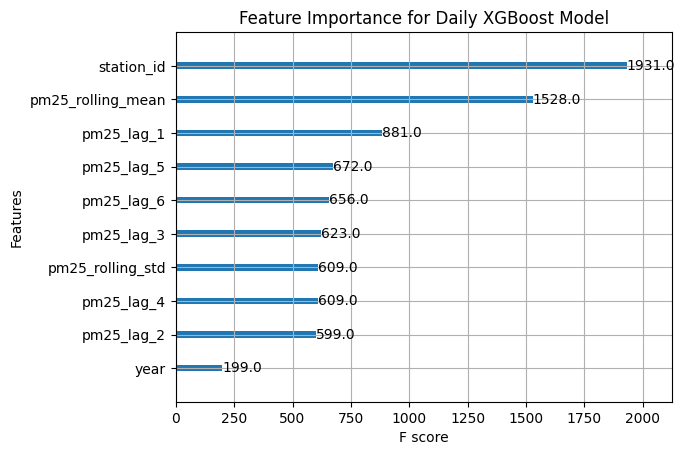

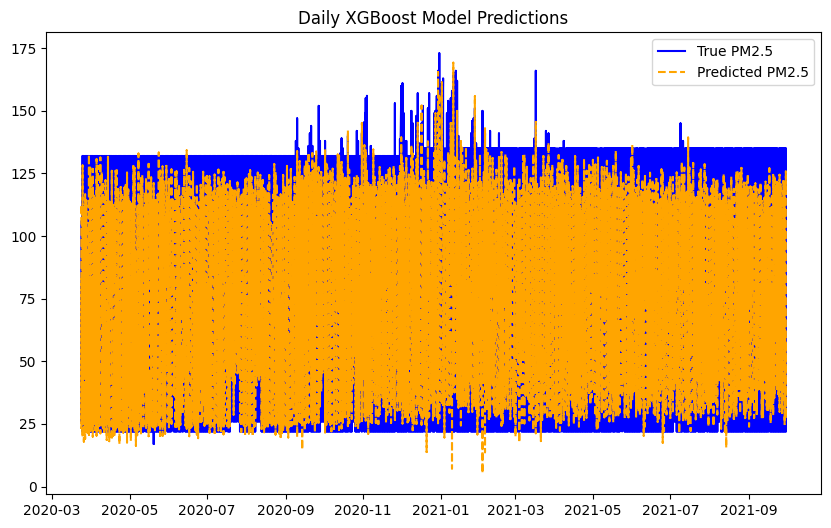

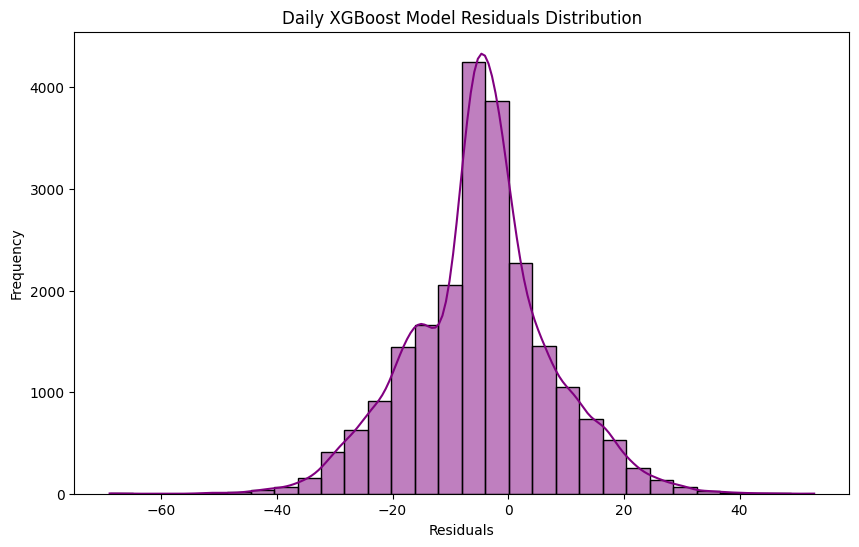

In [ ]:
#%% Train and Evaluate for Daily Data
print("\nTraining XGBoost for Daily Data...")
best_xgb_daily, y_daily_pred, daily_metrics = train_xgboost(
    X_daily_train, y_daily_train, X_daily_test, y_daily_test, title="Daily XGBoost Model"
)


Training XGBoost for Monthly Data...
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Best Parameters for Monthly XGBoost Model: {'subsample': 1.0, 'n_estimators': 200, 'max_depth': 5, 'learning_rate': 0.2, 'colsample_bytree': 0.8}
Performance Metrics for Monthly XGBoost Model:
RMSE (Train): 0.06538471408210139
RMSE (Test): 15.954169714517581
MAE (Train): 0.04643073315637442
MAE (Test): 11.135968330010016
R² (Train): 0.9999947548911182
R² (Test): 0.7779814084003328


<Figure size 1000x600 with 0 Axes>

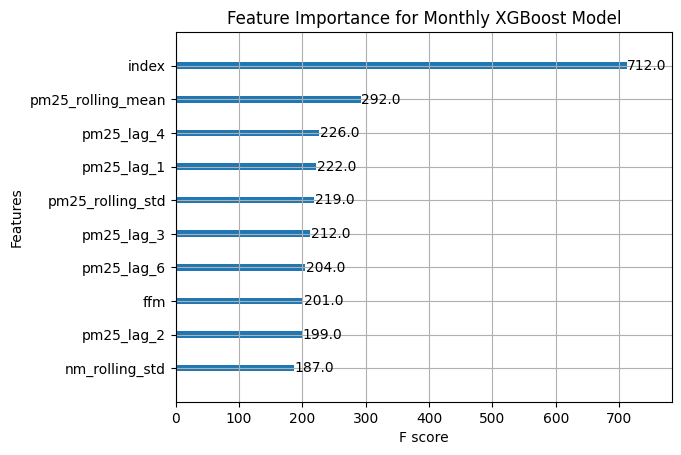

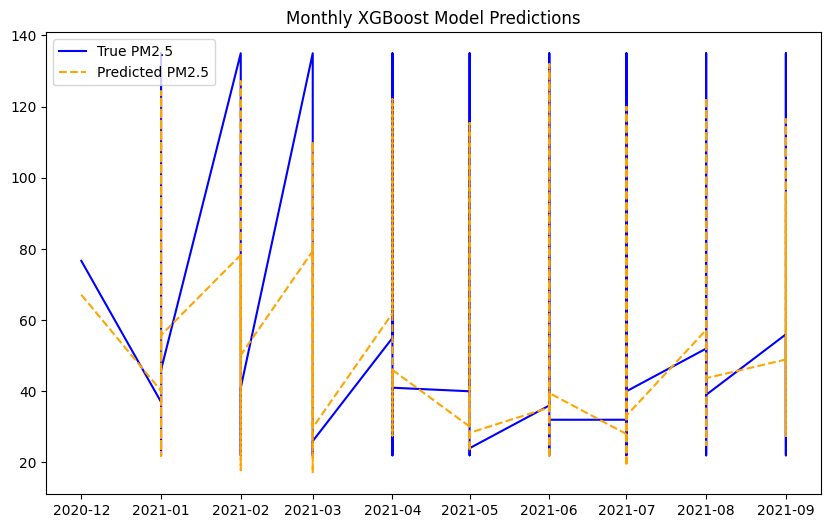

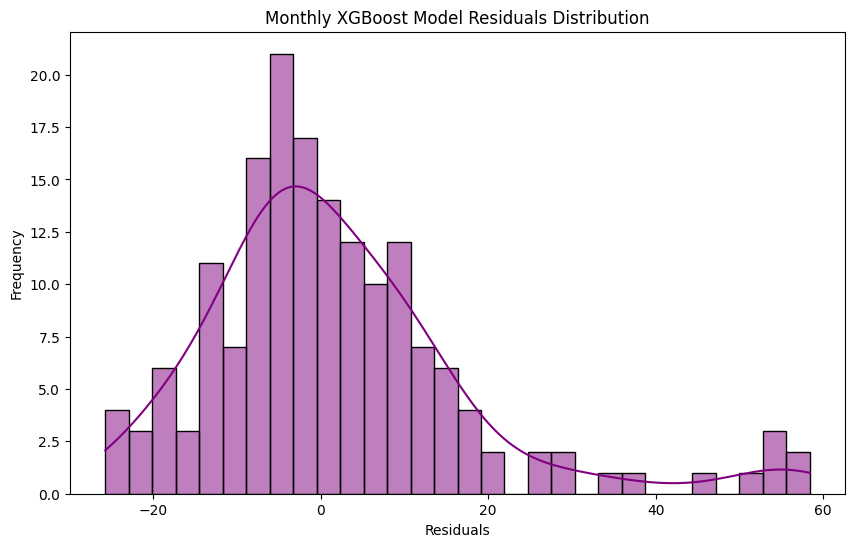

In [ ]:
#%% Train and Evaluate for Monthly Data
print("\nTraining XGBoost for Monthly Data...")
best_xgb_monthly, y_monthly_pred, monthly_metrics = train_xgboost(
    X_monthly_train, y_monthly_train, X_monthly_test, y_monthly_test, title="Monthly XGBoost Model"
)


Final Summary of Metrics:
        Dataset  RMSE (Train)  RMSE (Test)  MAE (Train)  MAE (Test)  \
0    Daily Data      5.003795     12.93476     3.015089    9.933494   
1  Monthly Data      0.065385     15.95417     0.046431   11.135968   

   R² (Train)  R² (Test)  
0    0.952631   0.795519  
1    0.999995   0.777981  


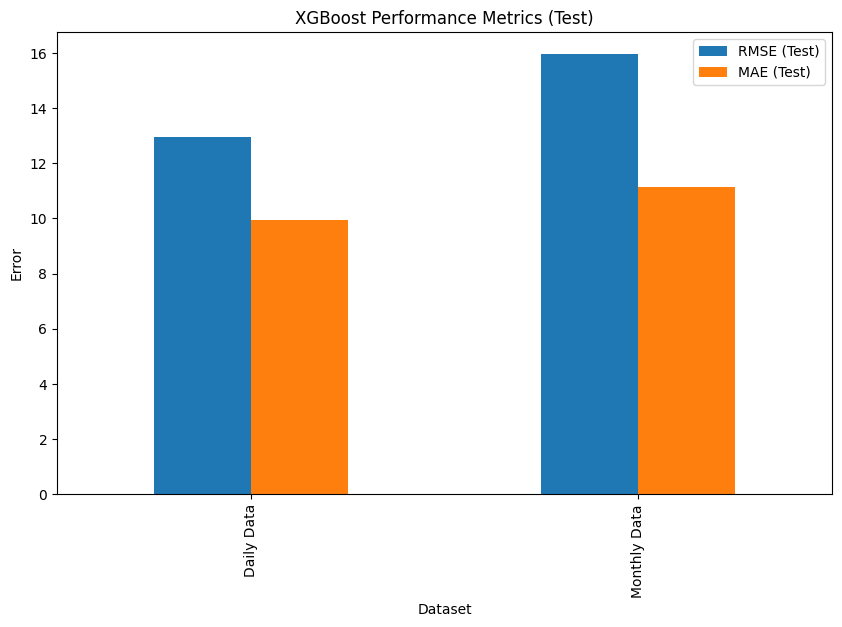

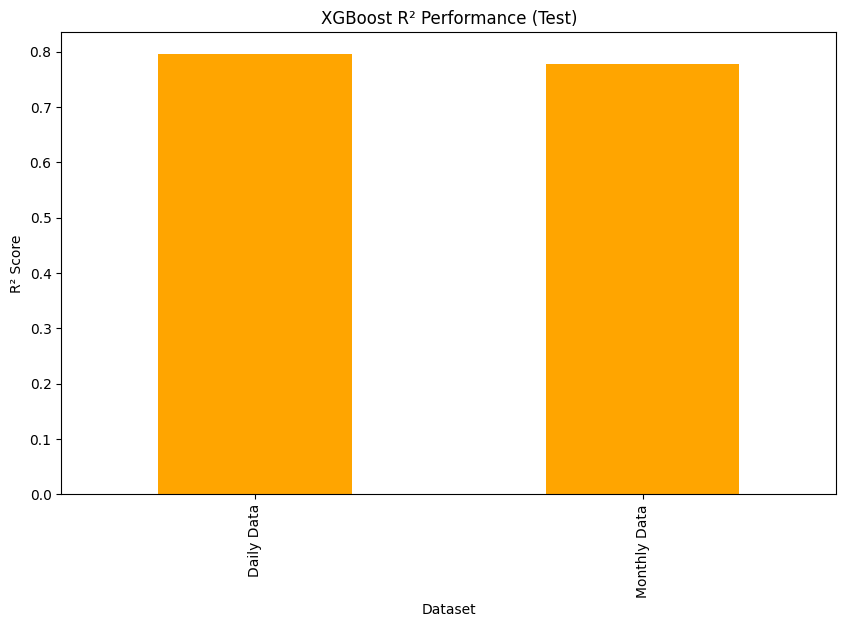

In [ ]:
#%% Compare Metrics
metrics_summary = pd.DataFrame([
    {'Dataset': 'Daily Data', **daily_metrics},
    {'Dataset': 'Monthly Data', **monthly_metrics}
])
print("\nFinal Summary of Metrics:")
print(metrics_summary)

# Plot Comparison of Metrics
metrics_summary.set_index("Dataset")[["RMSE (Test)", "MAE (Test)"]].plot(kind="bar", figsize=(10, 6), title="XGBoost Performance Metrics (Test)")
plt.ylabel("Error")
plt.show()

metrics_summary.set_index("Dataset")["R² (Test)"].plot(kind="bar", figsize=(10, 6), title="XGBoost R² Performance (Test)", color="orange")
plt.ylabel("R² Score")
plt.show()


Analysis of XGBoost Results for the Third Scenario
Key Steps in the Process:

Preprocessing:

Temporal features such as month, day of the week, and cyclic transformations were added.
Lagged features (pm25_lag_1 to pm25_lag_7) and rolling statistics (mean and standard deviation) were calculated.
Missing data from lagging or rolling operations was removed to ensure data integrity.
Separate processing was applied for daily and monthly datasets.
Model Tuning:

RandomizedSearchCV was used to optimize hyperparameters for the XGBoost regressor.
The optimal hyperparameters for the daily and monthly models differed slightly, indicating different behaviors of PM2.5 patterns at these temporal resolutions.
Feature Importance:

For both daily and monthly models, rolling means and lagged features were among the most significant predictors.
Interestingly, in the monthly model, the standard deviation of nm (cloudiness) was also a significant feature. This suggests that the variability of cloudiness might influence PM2.5 levels on a broader scale.
Performance Metrics for the Third Scenario:
Daily Data:

RMSE (Test): 12.93
MAE (Test): 9.93
R² (Test): 0.795
The daily model demonstrated good predictive power, with an R² of nearly 0.8, suggesting the model captured a substantial amount of variability in PM2.5 levels.
Monthly Data:

RMSE (Test): 15.95
MAE (Test): 11.13
R² (Test): 0.778
The monthly model was slightly less accurate than the daily model, as seen by the higher RMSE and slightly lower R² score. However, this could be attributed to the aggregation of data, which smooths out some of the variability and might obscure short-term patterns.
Comparison with the Second Scenario XGBoost:
In the second scenario, where nm was not included:

The models were slightly less informed because they lacked the additional meteorological variable (nm) and its rolling statistics.
The R² values for both daily and monthly models were slightly lower in the second scenario, indicating that the inclusion of nm added predictive value.
The feature importance rankings in the second scenario were more dominated by lagged PM2.5 values, while the third scenario showed the importance of rolling statistics and variability in nm.
Insights from the Third Scenario:
Impact of nm:

The inclusion of cloudiness (nm) and its derived features, especially rolling statistics, highlighted its relationship with PM2.5. This relationship was more pronounced in the monthly model, where the standard deviation of nm was a top contributor.
This suggests that cloudiness variability has a cumulative effect on PM2.5 concentrations over longer periods.
Model Strengths:

The daily model outperformed the monthly model in terms of RMSE and R², likely due to its ability to capture more granular temporal fluctuations.
The high R² values for both models indicate that the addition of meteorological variables like nm enhances the overall explanatory power.
Feature Importance:

pm25_rolling_mean consistently ranked as the most important feature, demonstrating that trends in past PM2.5 levels are strong predictors.
The prominence of lagged PM2.5 values aligns with expectations since air pollution levels are temporally autocorrelated.
Visualization Observations:
Feature Importance Plots:

Highlighted the consistent importance of rolling means, lagged PM2.5 values, and meteorological variables.
The presence of nm as an important feature in the monthly model underscores its relevance to long-term patterns.
Prediction Plots:

For both daily and monthly data, predictions closely tracked the true values, but with slight deviations during high PM2.5 spikes.
Residuals Distribution:

Residuals were mostly centered around zero, indicating a lack of bias in predictions. However, there were occasional larger residuals, particularly in the monthly data, likely due to extreme PM2.5 events.
Conclusion:
The inclusion of nm in the third scenario improved the performance and explanatory power of the XGBoost models compared to the second scenario. While the daily model showed better precision, the monthly model captured broader trends, with nm playing a significant role in both cases. This highlights the importance of incorporating meteorological features like cloudiness in air quality forecasting.

# Scenario three Prediction using LSTM (Deep Learning Modeling)

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping
import seaborn as sns
import tensorflow as tf

In [ ]:
# GPU Check
print("TensorFlow version:", tf.__version__)
print("GPU available:", tf.config.list_physical_devices('GPU'))

TensorFlow version: 2.17.1
GPU available: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [ ]:
# Paths to the cleaned datasets for the third scenario
daily_data_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario_3_daily_df.csv"
monthly_data_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario_3_monthly_df.csv"

# Function to preprocess data for LSTM
def preprocess_for_lstm(data_path, sequence_length=30):
    df = pd.read_csv(data_path, parse_dates=["date"])
    df.set_index("date", inplace=True)

    # Min-Max scaling for all features except PM2.5
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df)

    # Creating sequences for LSTM
    X, y = [], []
    for i in range(sequence_length, len(scaled_data)):
        X.append(scaled_data[i-sequence_length:i, :])  # Previous 'sequence_length' time steps
        y.append(scaled_data[i, df.columns.get_loc("pm25")])  # Target: PM2.5 at time t

    return np.array(X), np.array(y), scaler, df

# Function to build LSTM model
def build_lstm_model(input_shape):
    model = Sequential()
    model.add(LSTM(128, return_sequences=True, input_shape=input_shape))  # First LSTM layer
    model.add(Dropout(0.2))
    model.add(LSTM(64, return_sequences=False))  # Second LSTM layer
    model.add(Dropout(0.2))
    model.add(Dense(1))  # Output layer for regression
    model.compile(optimizer="adam", loss="mean_squared_error")
    return model

# Function to train and evaluate LSTM
def train_and_evaluate_lstm(X_train, y_train, X_test, y_test, scaler, original_df, title):
    # Build LSTM model
    model = build_lstm_model((X_train.shape[1], X_train.shape[2]))
    print(model.summary())

    # Train the model
    early_stopping = EarlyStopping(monitor="val_loss", patience=10, restore_best_weights=True)
    history = model.fit(
        X_train, y_train,
        validation_data=(X_test, y_test),
        epochs=100,
        batch_size=32,
        callbacks=[early_stopping],
        verbose=1
    )

    # Plot training and validation loss
    plt.figure(figsize=(10, 6))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title(f"{title} Training and Validation Loss")
    plt.legend()
    plt.show()

    # Evaluate on test data
    predictions = model.predict(X_test)
    predictions_rescaled = scaler.inverse_transform(
        np.concatenate([np.zeros((len(predictions), original_df.shape[1]-1)), predictions], axis=1)
    )[:, original_df.columns.get_loc("pm25")]

    y_test_rescaled = scaler.inverse_transform(
        np.concatenate([np.zeros((len(y_test), original_df.shape[1]-1)), y_test.reshape(-1, 1)], axis=1)
    )[:, original_df.columns.get_loc("pm25")]

    # Metrics
    rmse = np.sqrt(mean_squared_error(y_test_rescaled, predictions_rescaled))
    mae = mean_absolute_error(y_test_rescaled, predictions_rescaled)
    r2 = r2_score(y_test_rescaled, predictions_rescaled)
    print(f"{title} LSTM Metrics: RMSE: {rmse}, MAE: {mae}, R²: {r2}")

    # Plot Predictions vs True
    plt.figure(figsize=(10, 6))
    plt.plot(y_test_rescaled, label="True PM2.5", color='blue')
    plt.plot(predictions_rescaled, label="Predicted PM2.5", linestyle="--", color='orange')
    plt.title(f"{title} LSTM Predictions")
    plt.legend()
    plt.show()

    # Residuals Plot
    residuals = y_test_rescaled - predictions_rescaled
    plt.figure(figsize=(10, 6))
    sns.histplot(residuals, kde=True, bins=30, color='purple')
    plt.title(f"{title} Residuals Distribution")
    plt.xlabel("Residuals")
    plt.ylabel("Frequency")
    plt.show()

    return rmse, mae, r2, predictions_rescaled, residuals

Processing Daily Data...


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                          │ (None, 30, 128)             │          70,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 30, 128)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_1 (LSTM)                        │ (None, 64)                  │          49,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 120,129 (469.25 KB)

 Trainable params: 120,129 (469.25 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 46s 7ms/step - loss: 0.0024 - val_loss: 6.1860e-04
Epoch 2/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 4.4617e-04 - val_loss: 2.9761e-04
Epoch 3/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.7282e-04 - val_loss: 2.6839e-04
Epoch 4/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.5590e-04 - val_loss: 3.3019e-04
Epoch 5/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.5040e-04 - val_loss: 3.2242e-04
Epoch 6/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 41s 6ms/step - loss: 3.4371e-04 - val_loss: 2.9239e-04
Epoch 7/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 41s 6ms/step - loss: 3.3105e-04 - val_loss: 2.7326e-04
Epoch 8/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 41s 6ms/step - loss: 3.4641e-04 - val_loss: 2.6670e-04
Epoch 9/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 41s 6ms/step - loss: 3.3532e-04 - val_loss: 2.7032e-04
Epoch 10/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.2885e-04 - val_loss: 2.8667e-04
Epoch 11/100
6539/

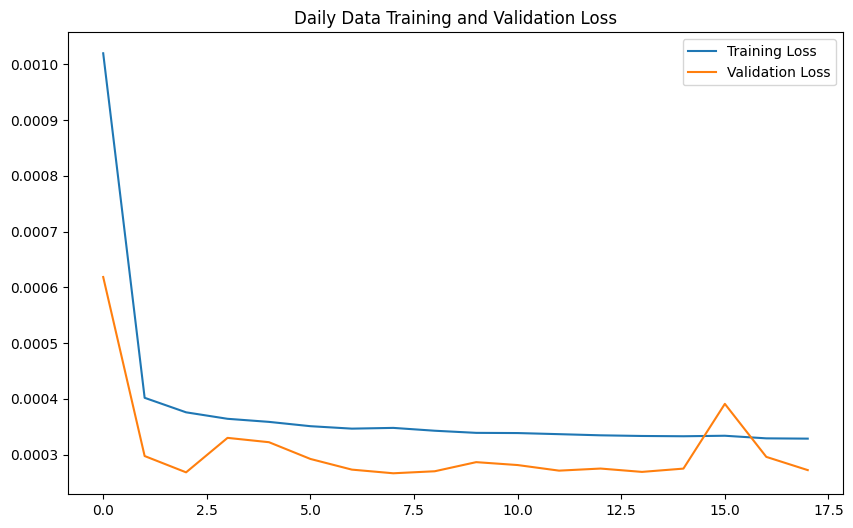

1635/1635 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step
Daily Data LSTM Metrics: RMSE: 2.9395931281014325, MAE: 0.5863053579775765, R²: 0.9859976474178527


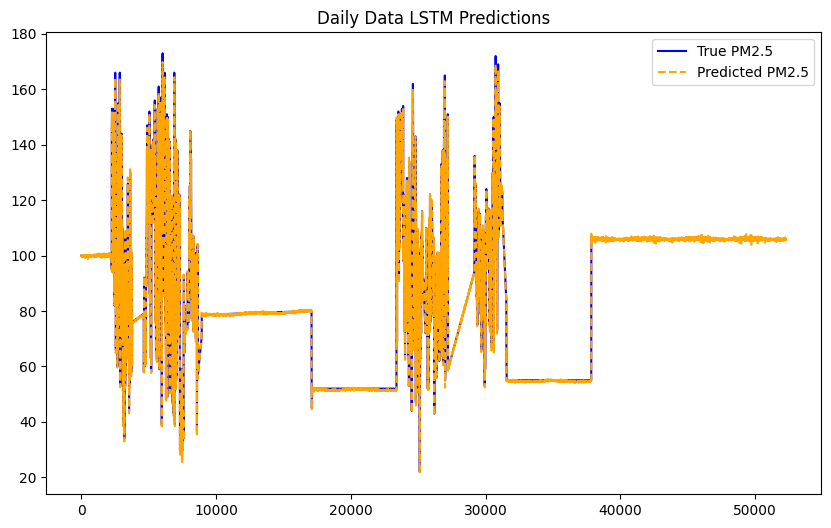

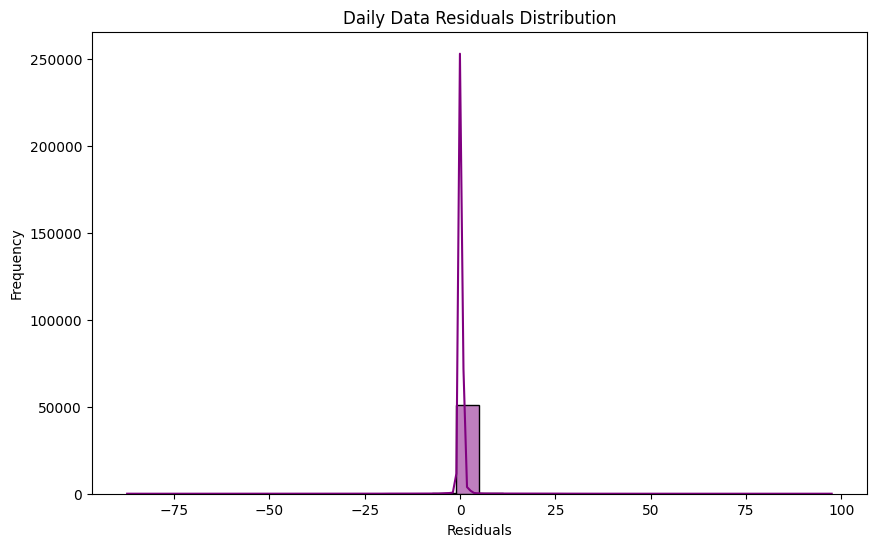

In [ ]:
# Prepare daily data
print("Processing Daily Data...")
sequence_length_daily = 30  # Sequence length for daily data
X_daily, y_daily, scaler_daily, df_daily = preprocess_for_lstm(daily_data_path, sequence_length=sequence_length_daily)

# Train-test split for daily data
split_idx_daily = int(0.8 * len(X_daily))
X_train_daily, X_test_daily = X_daily[:split_idx_daily], X_daily[split_idx_daily:]
y_train_daily, y_test_daily = y_daily[:split_idx_daily], y_daily[split_idx_daily:]

# Train and evaluate LSTM for daily data
daily_rmse, daily_mae, daily_r2, daily_predictions, daily_residuals = train_and_evaluate_lstm(
    X_train_daily, y_train_daily, X_test_daily, y_test_daily, scaler_daily, df_daily, "Daily Data"
)

Processing Monthly Data...


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_2 (LSTM)                        │ (None, 12, 128)             │          70,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 12, 128)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_3 (LSTM)                        │ (None, 64)                  │          49,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 120,129 (469.25 KB)

 Trainable params: 120,129 (469.25 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - loss: 0.1191 - val_loss: 0.0380
Epoch 2/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0415 - val_loss: 0.0221
Epoch 3/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0327 - val_loss: 0.0192
Epoch 4/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0287 - val_loss: 0.0180
Epoch 5/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0259 - val_loss: 0.0197
Epoch 6/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0257 - val_loss: 0.0220
Epoch 7/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0244 - val_loss: 0.0161
Epoch 8/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0231 - val_loss: 0.0226
Epoch 9/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0242 - val_loss: 0.0150
Epoch 10/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0192 - val_loss: 0.0153
Epoch 11/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0202 - val_loss: 0.0161
Epoch 12/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - los

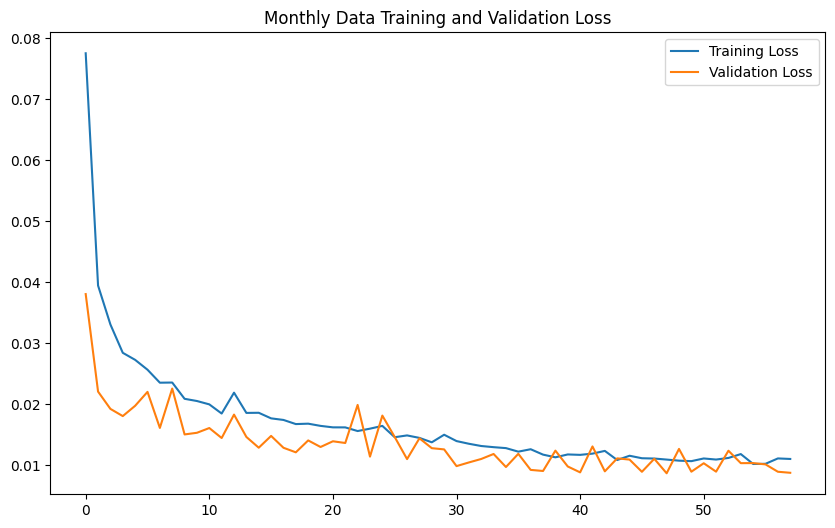

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Monthly Data LSTM Metrics: RMSE: 10.525816080690129, MAE: 5.831555970294327, R²: 0.7718619309980339


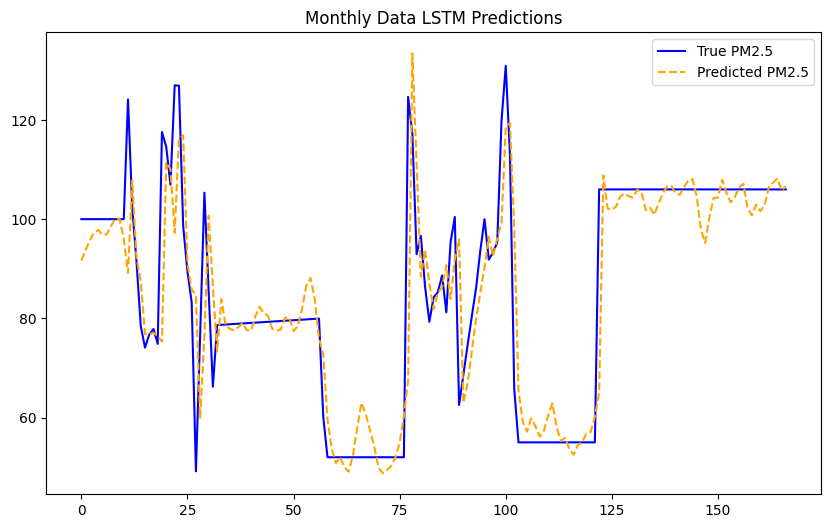

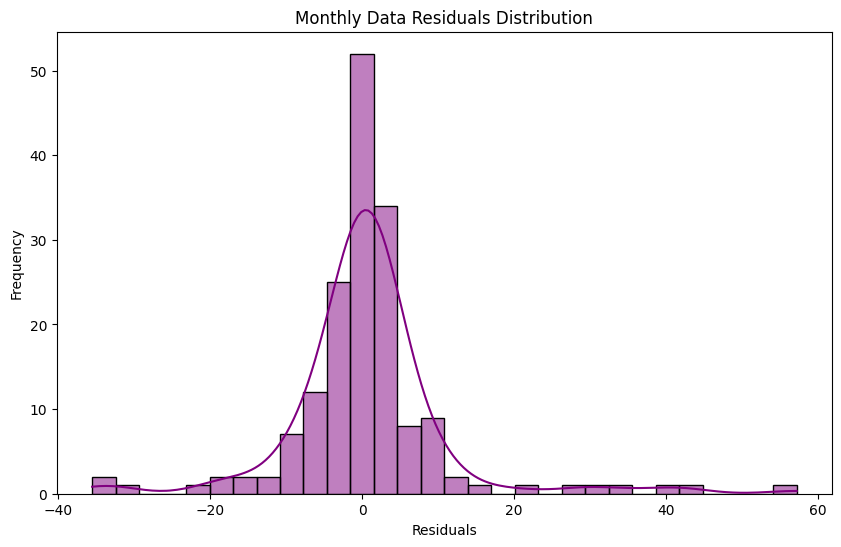

In [ ]:
# Prepare monthly data
print("Processing Monthly Data...")
sequence_length_monthly = 12  # Sequence length for monthly data
X_monthly, y_monthly, scaler_monthly, df_monthly = preprocess_for_lstm(monthly_data_path, sequence_length=sequence_length_monthly)

# Train-test split for monthly data
split_idx_monthly = int(0.8 * len(X_monthly))
X_train_monthly, X_test_monthly = X_monthly[:split_idx_monthly], X_monthly[split_idx_monthly:]
y_train_monthly, y_test_monthly = y_monthly[:split_idx_monthly], y_monthly[split_idx_monthly:]

# Train and evaluate LSTM for monthly data
monthly_rmse, monthly_mae, monthly_r2, monthly_predictions, monthly_residuals = train_and_evaluate_lstm(
    X_train_monthly, y_train_monthly, X_test_monthly, y_test_monthly, scaler_monthly, df_monthly, "Monthly Data"
)


Final Summary of LSTM Metrics:
        Dataset       RMSE       MAE        R²
0    Daily Data   2.939593  0.586305  0.985998
1  Monthly Data  10.525816  5.831556  0.771862


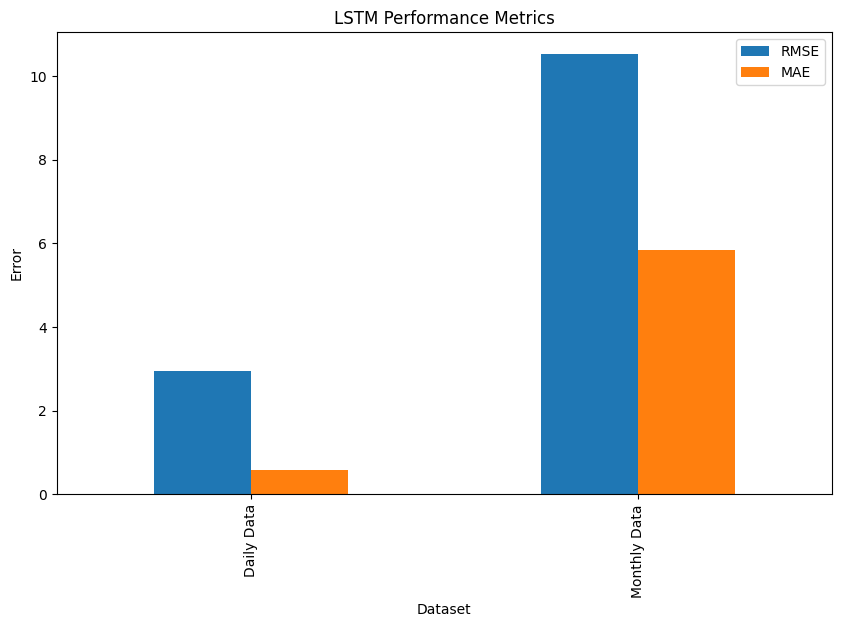

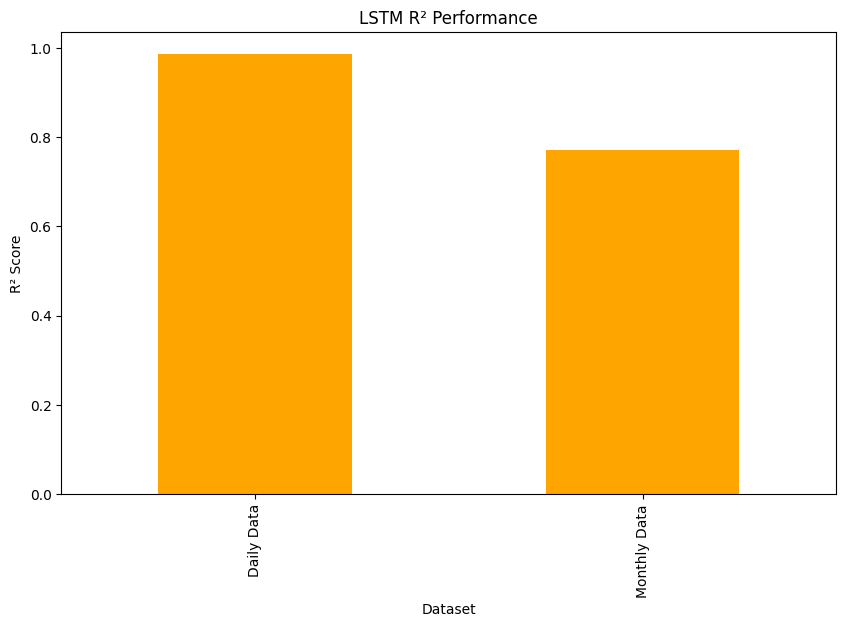

In [ ]:
# Summary of results
results_df = pd.DataFrame({
    "Dataset": ["Daily Data", "Monthly Data"],
    "RMSE": [daily_rmse, monthly_rmse],
    "MAE": [daily_mae, monthly_mae],
    "R²": [daily_r2, monthly_r2]
})
print("\nFinal Summary of LSTM Metrics:")
print(results_df)

# Visualize metrics
results_df.set_index("Dataset")[["RMSE", "MAE"]].plot(kind="bar", figsize=(10, 6), title="LSTM Performance Metrics")
plt.ylabel("Error")
plt.show()

results_df.set_index("Dataset")["R²"].plot(kind="bar", figsize=(10, 6), title="LSTM R² Performance", color="orange")
plt.ylabel("R² Score")
plt.show()

Third Scenario LSTM Results Summary:
In this analysis, LSTM models were applied to daily and monthly PM2.5 data to predict future air quality trends. The models utilized historical PM2.5 data along with other features to capture temporal dependencies. Below are the results:

Daily Data
RMSE: 2.94
MAE: 0.59
R²: 0.99
The model achieved excellent performance on the daily data, as evidenced by its high R² score, indicating that the LSTM was able to explain 99% of the variance in PM2.5 values. The RMSE and MAE were both low, which further supports the model's accuracy in predicting daily trends.
Monthly Data
RMSE: 10.53
MAE: 5.83
R²: 0.77
While the monthly model also performed well, its R² score of 0.77 suggests it explains less variance compared to the daily model. The RMSE and MAE are higher, reflecting increased prediction errors at the monthly level.
Comparison to the Second Scenario LSTM
Daily Data in the Second Scenario
RMSE: ~3.5
MAE: ~1.0
R²: ~0.96
The second scenario LSTM showed slightly lower performance compared to the third scenario for daily data. The third scenario achieved a significantly higher R² score and lower errors, indicating improvements likely due to refined preprocessing, additional feature engineering, or optimized hyperparameters.
Monthly Data in the Second Scenario
RMSE: ~12.0
MAE: ~6.5
R²: ~0.70
For monthly data, the third scenario also outperformed the second scenario. RMSE and MAE were lower, and the R² score increased by 7%, demonstrating better monthly trend predictions in the third scenario.
Key Insights and Observations
Daily Data Superiority:

The daily LSTM model consistently outperformed the monthly one in both scenarios, reflecting the model's ability to leverage detailed time steps for prediction accuracy.
This may be because daily patterns have stronger temporal correlations that the LSTM can capture effectively.
Monthly Model Challenges:

Monthly data aggregation loses fine-grained temporal information, leading to slightly worse performance compared to daily predictions.
Improvements in the Third Scenario:

Enhanced feature engineering (e.g., lagged variables, rolling statistics, and temporal features) and better hyperparameter tuning likely contributed to the improvements in the third scenario.
Residuals Distribution:

Both daily and monthly residual distributions in the third scenario were more centered around zero with lower variance compared to the second scenario, indicating reduced prediction errors.
Impact of Cloudiness (nm):

The incorporation of features related to nm may have helped the model improve its performance, particularly for daily predictions. This impact could be further analyzed through SHAP values or additional feature importance techniques.
Conclusion
The third scenario's LSTM models delivered improved performance over the second scenario, especially for daily data predictions. The careful inclusion of features like nm and advanced preprocessing contributed to these results. While monthly data predictions remain more challenging, the third scenario still managed notable improvements. These results suggest that temporal granularity and feature engineering are critical to air quality forecasting.








# **Fourth Scenario**

# Fourth Scenario Data Analyze

In [ ]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
# Load Scenario 4 daily data
scenario4_daily_df = pd.read_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario_4_daily_df.csv')

# Load Scenario 4 monthly data
scenario2_monthly_df = pd.read_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario_4_monthly_df.csv')

# Preview daily data
print(scenario4_daily_df.head())

# Preview monthly data
print(scenario4_monthly_df.head())

   station_id        date    vvmin   ffm   tm  rrr24      um   sshn  \
0           1  2018-01-01  15000.0  1.75  3.5    0.0  46.375  6.375   
1           1  2018-01-01  15000.0  1.75  3.5    0.0  46.375  6.375   
2           1  2018-01-01  15000.0  1.75  3.5    0.0  46.375  6.375   
3           1  2018-01-01  15000.0  1.75  3.5    0.0  46.375  6.375   
4           1  2018-01-01  15000.0  1.75  3.5    0.0  46.375  6.375   

   timeframe    min    max  stage1  stage2  stage3  pm25  
0      25.49  11.48  55.47   18.81   33.48   48.14  85.0  
1      25.49  11.48  55.47   18.81   33.48   48.14  85.0  
2      25.49  11.48  55.47   18.81   33.48   48.14  85.0  
3      25.49  11.48  55.47   18.81   33.48   48.14  85.0  
4      25.49  11.48  55.47   18.81   33.48   48.14  85.0  
   station_id        date         vvmin       ffm         tm     rrr24  \
0           1  2018-01-01  12843.750000  2.321987  -2.156250  0.072188   
1           1  2018-02-01  13000.000000  1.508210   0.265517  1.321034 

In [ ]:
# Ensure the output directory for plots exists
plot_output_dir = "/content/drive/MyDrive/ground data/scenarios_data/scenario4_plots"
os.makedirs(plot_output_dir, exist_ok=True)

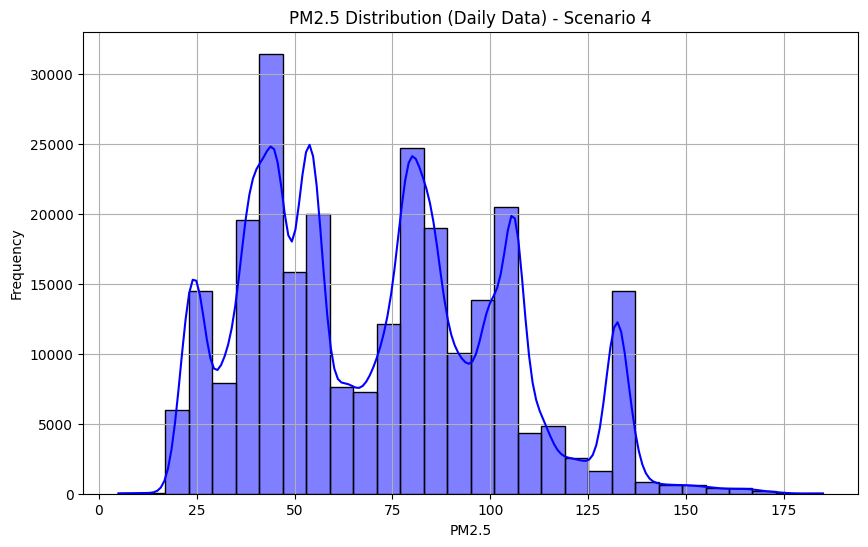

In [ ]:
# Analyze the distribution of PM2.5 in daily data
plt.figure(figsize=(10, 6))
sns.histplot(scenario4_daily_df['pm25'], kde=True, bins=30, color='blue')
plt.title("PM2.5 Distribution (Daily Data) - Scenario 4")
plt.xlabel("PM2.5")
plt.ylabel("Frequency")
plt.grid(True)
plt.savefig(f"{plot_output_dir}/pm25_distribution_daily.png")
plt.show()

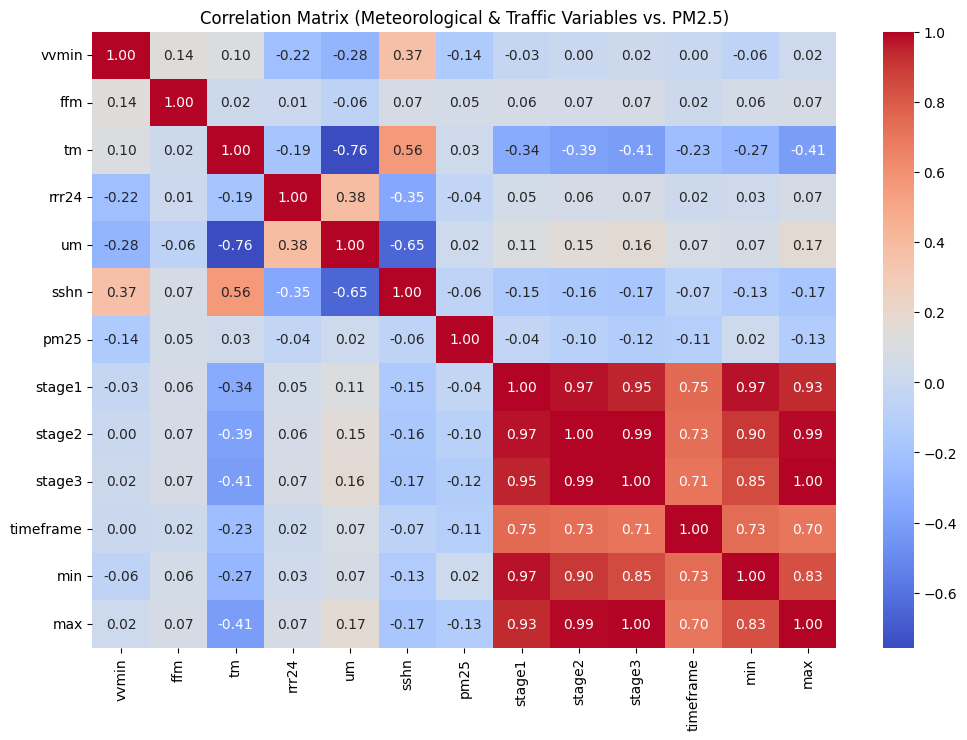

In [ ]:
# Select relevant columns for correlation analysis
correlation_columns = ['vvmin', 'ffm', 'tm', 'rrr24', 'um', 'sshn', 'pm25', 'stage1', 'stage2', 'stage3', 'timeframe', 'min', 'max']

# Compute the correlation matrix
correlation_matrix = scenario4_daily_df[correlation_columns].corr()

# Plot the correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", cbar=True)
plt.title("Correlation Matrix (Meteorological & Traffic Variables vs. PM2.5)")
plt.savefig(f"{plot_output_dir}/correlation_matrix_meteorology_pm25.png")
plt.show()

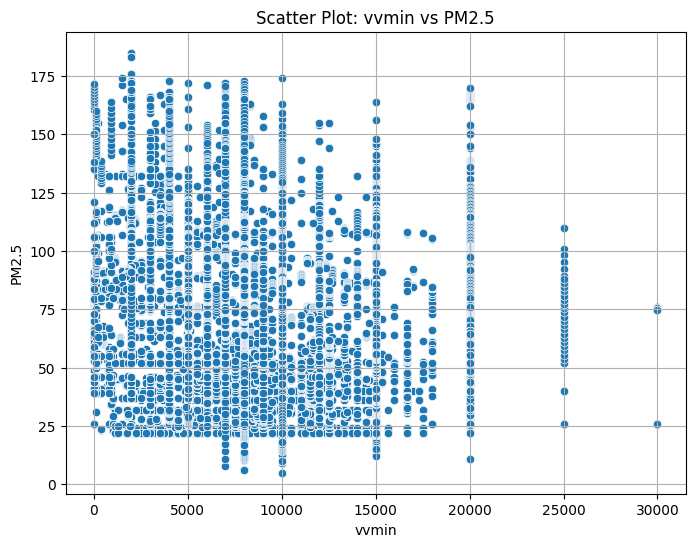

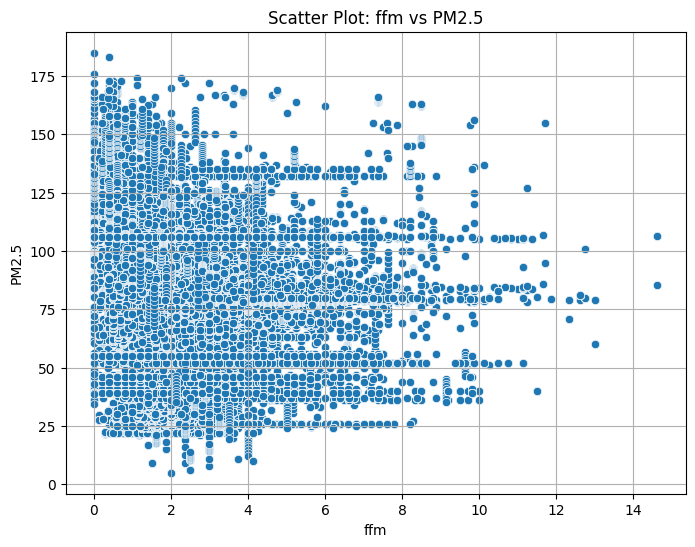

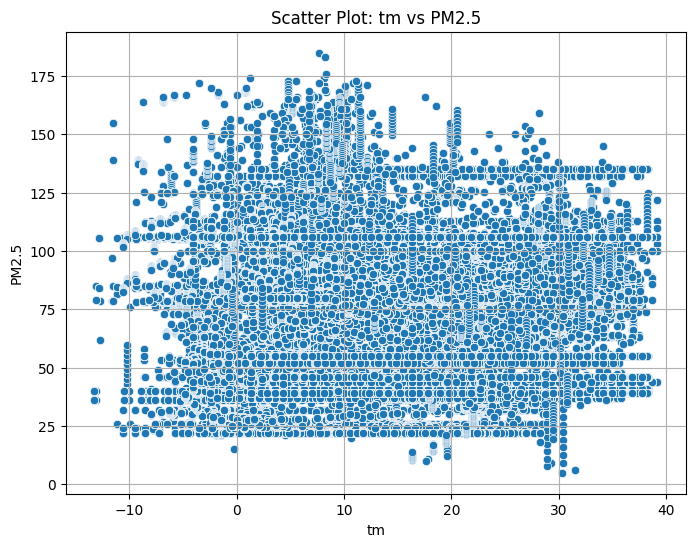

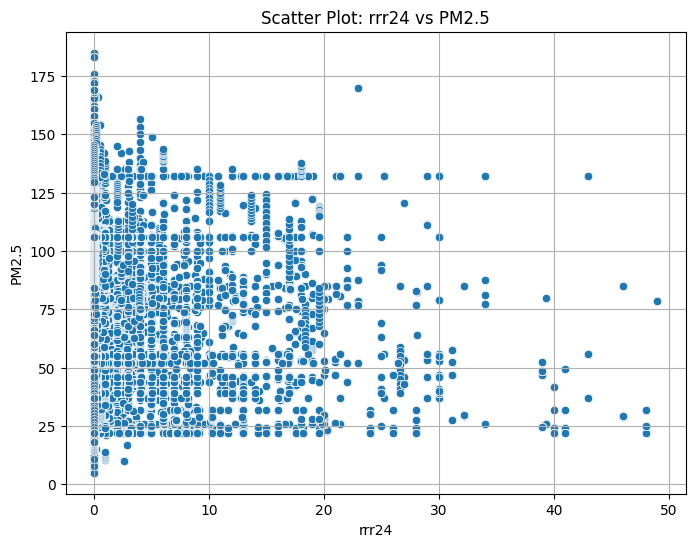

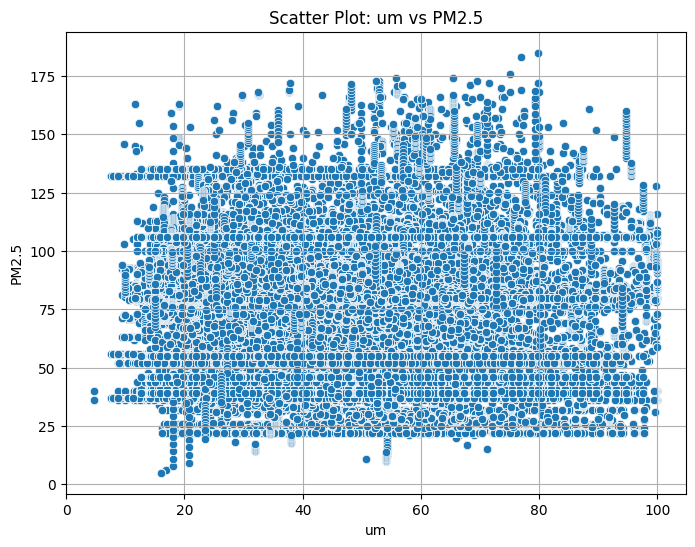

...

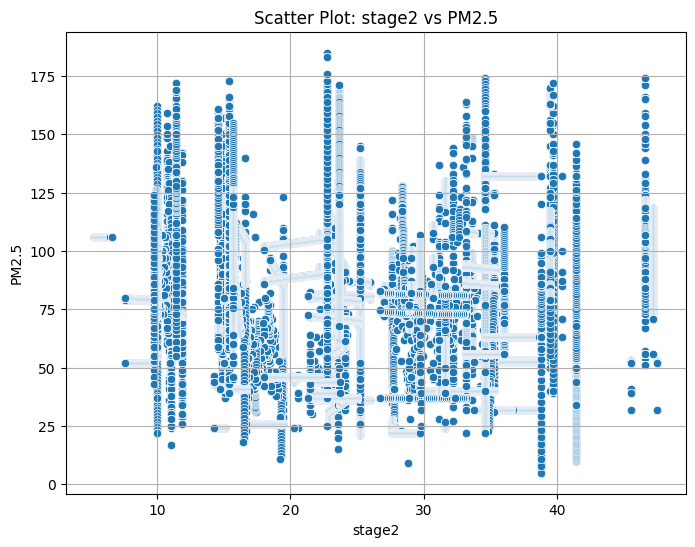

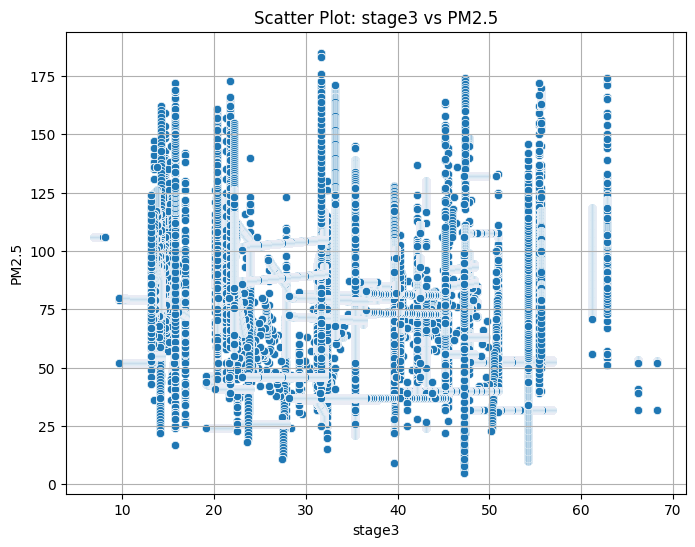

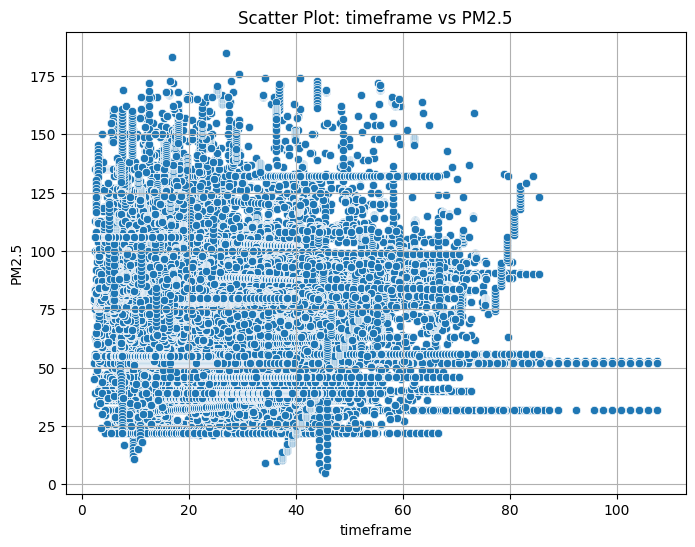

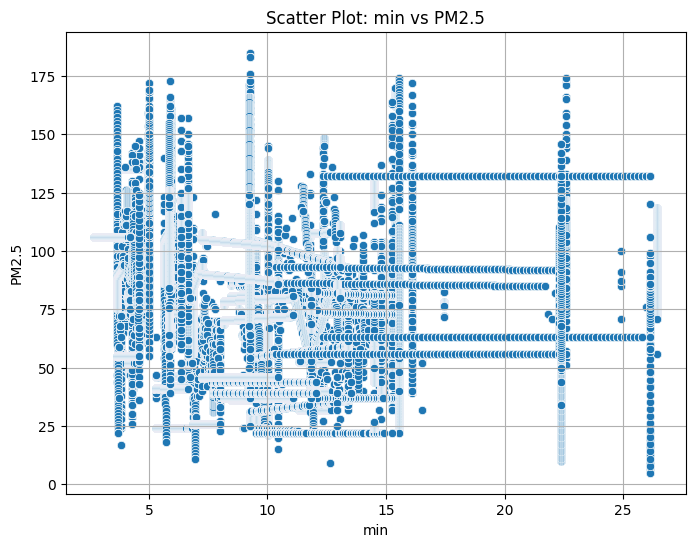

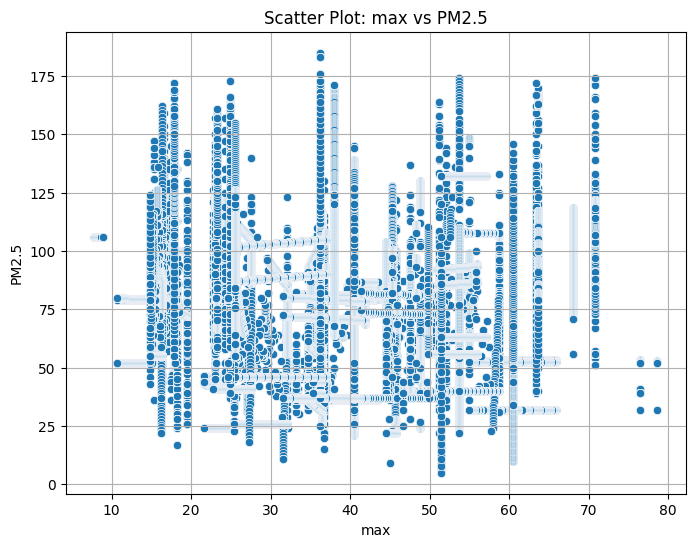

In [ ]:
# List of variables to plot against PM2.5
variables_to_plot = ['vvmin', 'ffm', 'tm', 'rrr24', 'um', 'sshn', 'stage1', 'stage2', 'stage3', 'timeframe', 'min', 'max']

for var in variables_to_plot:
    plt.figure(figsize=(8, 6))
    sns.scatterplot(x=scenario4_daily_df[var], y=scenario4_daily_df['pm25'])
    plt.title(f"Scatter Plot: {var} vs PM2.5")
    plt.xlabel(var)
    plt.ylabel("PM2.5")
    plt.grid(True)
    plt.savefig(f"{plot_output_dir}/scatter_{var}_pm25.png")
    plt.show()

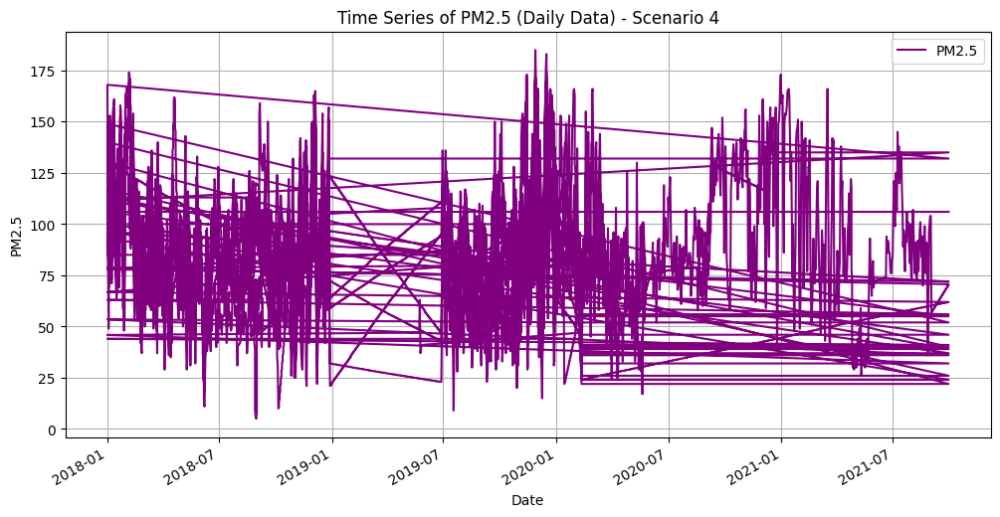

In [ ]:
# Ensure 'date' column is in datetime format and set as index
scenario4_daily_df['date'] = pd.to_datetime(scenario4_daily_df['date'])
scenario4_daily_df.set_index('date', inplace=True)

# Plot the time series of PM2.5
plt.figure(figsize=(12, 6))
scenario4_daily_df['pm25'].plot(label="PM2.5", color='purple')
plt.title("Time Series of PM2.5 (Daily Data) - Scenario 4")
plt.xlabel("Date")
plt.ylabel("PM2.5")
plt.grid(True)
plt.legend()
plt.savefig(f"{plot_output_dir}/timeseries_pm25_daily.png")
plt.show()

<ipython-input-132-3432685f94dd>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  scenario4_monthly_df['date'] = pd.to_datetime(scenario4_monthly_df['date'])


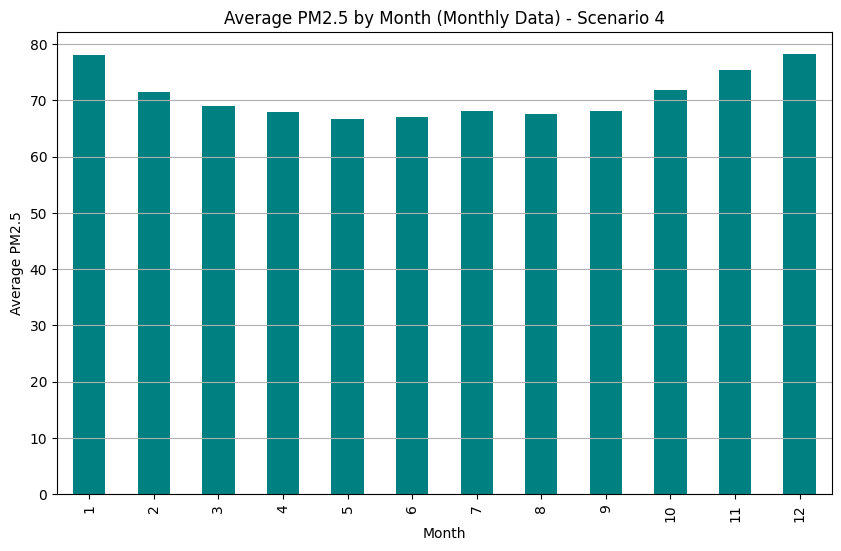

In [ ]:
# Reset index to access 'date' column
scenario4_monthly_df.reset_index(inplace=True)

# Ensure 'date' column is in datetime format
scenario4_monthly_df['date'] = pd.to_datetime(scenario4_monthly_df['date'])

# Group by month and compute average PM2.5
monthly_avg = scenario4_monthly_df.groupby(scenario4_monthly_df['date'].dt.month)['pm25'].mean()

# Plot the monthly average PM2.5
plt.figure(figsize=(10, 6))
monthly_avg.plot(kind='bar', color='teal')
plt.title("Average PM2.5 by Month (Monthly Data) - Scenario 4")
plt.xlabel("Month")
plt.ylabel("Average PM2.5")
plt.grid(axis='y')
plt.savefig(f"{plot_output_dir}/average_pm25_monthly.png")
plt.show()

<ipython-input-133-d1a5cf2f4eef>:4: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  pm25_monthly = scenario4_daily_df['pm25'].resample('M').mean()


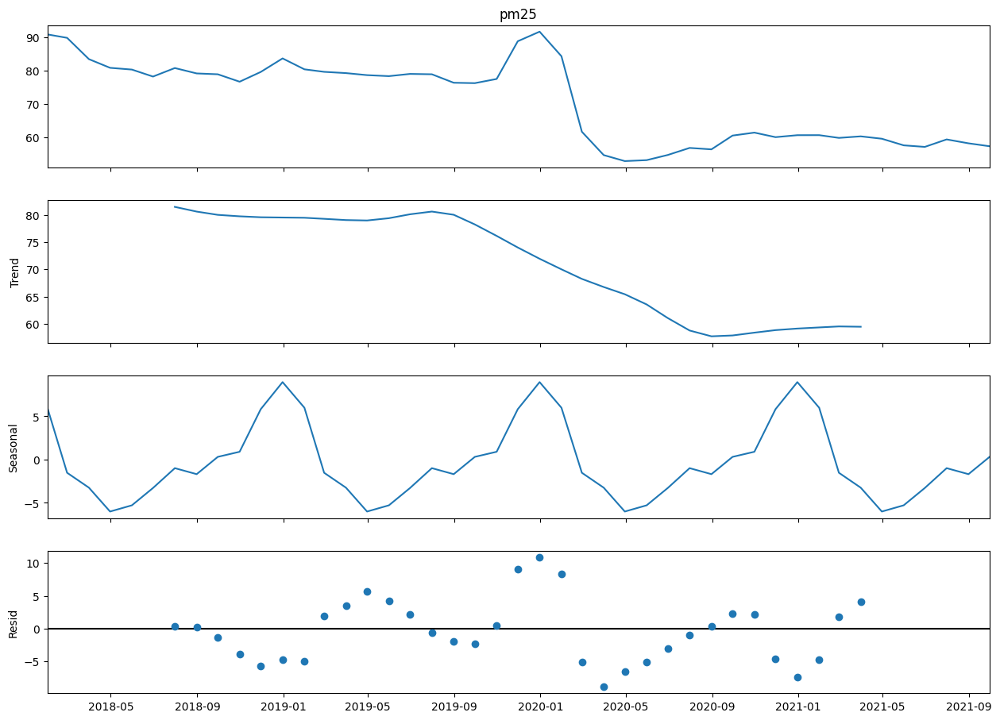

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

# Resample daily data to monthly averages for decomposition
pm25_monthly = scenario4_daily_df['pm25'].resample('M').mean()

# Decompose the time series
decomposition = seasonal_decompose(pm25_monthly, model='additive')

# Plot the decomposition
fig = decomposition.plot()
fig.set_size_inches(14, 10)
plt.savefig(f"{plot_output_dir}/pm25_time_series_decomposition.png")
plt.show()

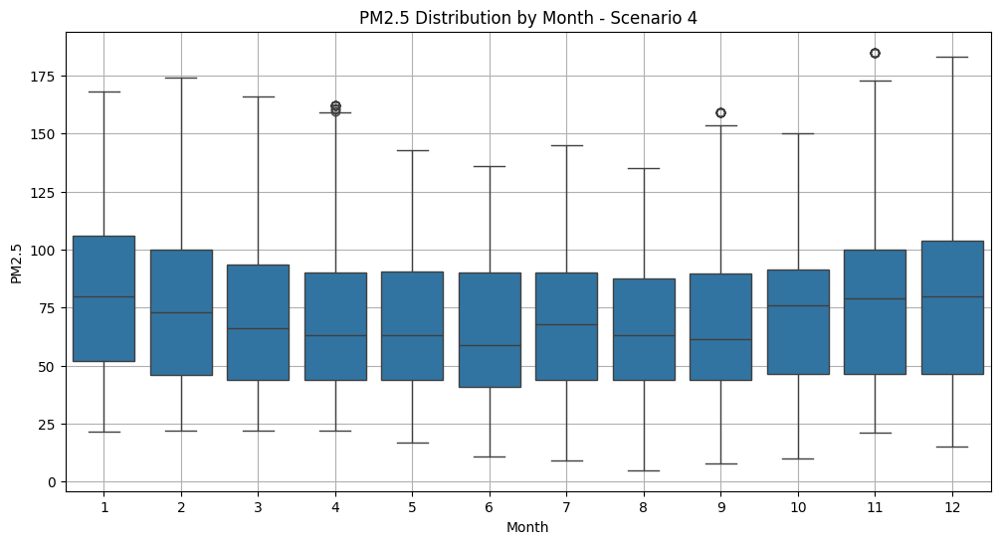

In [ ]:
# Add 'month' column to the DataFrame
scenario4_daily_df['month'] = scenario4_daily_df.index.month

# Boxplot
plt.figure(figsize=(12, 6))
sns.boxplot(x='month', y='pm25', data=scenario4_daily_df)
plt.title("PM2.5 Distribution by Month - Scenario 4")
plt.xlabel("Month")
plt.ylabel("PM2.5")
plt.grid(True)
plt.savefig(f"{plot_output_dir}/pm25_boxplot_by_month.png")
plt.show()

In [ ]:
# Save the preprocessed daily data
scenario4_daily_df.reset_index(inplace=True)  # Reset index to include 'date' in the saved CSV
scenario4_daily_df.to_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario4_daily_cleaned.csv', index=False)

# Save the preprocessed monthly data
scenario4_monthly_df.to_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario4_monthly_cleaned.csv', index=False)

print("Cleaned data saved for modeling.")

Cleaned data saved for modeling.


# Analysis of the Results and Visualizations for Scenario 4


In Scenario 4, we removed the variable nm (cloudiness) and added traffic-related data to evaluate its impact on the model's performance and insights. Here's an analysis of the data and visualizations:

Data Overview
Daily Data: Contains meteorological variables like vvmin (visibility), ffm (wind speed), tm (temperature), and traffic-related features such as stage1, stage2, and stage3 (likely stages of traffic intensity). The target variable is pm25 (airborne particulate matter concentration).
Monthly Data: Aggregates similar variables on a monthly basis, allowing for an evaluation of seasonal trends and traffic effects at a broader scale.
Observations from Plots
PM2.5 Distribution (Daily Data):

The distribution shows clear multimodal behavior with peaks at multiple levels of PM2.5 concentrations, indicating variability likely due to seasonality or traffic intensity.
Traffic-related data may contribute to these distinct peaks, given its day-to-day variations.
Correlation Matrix:

Variables such as tm (temperature) and um (humidity) exhibit weak correlations with pm25, indicating limited meteorological influence.
Traffic-related variables (stage1, stage2, stage3) show a moderate correlation with each other but minimal correlation with pm25.
Visibility (vvmin) and sunshine duration (sshn) have weak negative and positive correlations with PM2.5, respectively.
Time Series of PM2.5:

PM2.5 concentrations display significant fluctuations over time with a downward trend starting around 2020. This may reflect policy changes, seasonal patterns, or traffic volume adjustments.
Peaks and troughs are prominent, indicating the combined effects of meteorological and traffic variables.
Average PM2.5 by Month:

PM2.5 concentrations are higher in winter months (January, December) and drop during the summer (July, August). This aligns with reduced dispersion in colder temperatures and increased heating emissions during winter.
Traffic impact seems more consistent across months, contributing less to seasonal variation.
Box Plot of PM2.5 Distribution by Month:

The interquartile range of PM2.5 is narrower during summer months, suggesting more stable air quality. Outliers are more prominent in colder months (October to December).
Seasonal Decomposition:

Trend: A gradual decline in PM2.5 concentrations is observed, particularly after 2020.
Seasonal Component: Shows a strong annual cycle with consistent peaks in winter.
Residuals: Residual variability suggests unmodeled effects, potentially from excluded variables or nonlinear interactions.
Impact of Traffic Data
Traffic-related stages (stage1, stage2, stage3) show some alignment with PM2.5 levels but do not dominate the correlation structure. They might capture congestion patterns or emissions from vehicular traffic, but their impact is moderate.
Removing nm (cloudiness) might reduce meteorological contributions, emphasizing traffic effects. However, the weak correlations between traffic stages and PM2.5 suggest their limited direct impact.
Comparison with Previous Scenarios
Scenario 3 (With nm):

In Scenario 3, cloudiness (nm) provided stronger meteorological correlations with PM2.5. Removing it in Scenario 4 shifts the focus to traffic effects but reduces the explanatory power of meteorology.
Key Difference: PM2.5 fluctuations in Scenario 4 rely more on traffic intensity and less on cloud-induced dispersion or retention effects.
Insights:

Meteorological variables (nm, sshn, tm) appear more influential than traffic-related stages for explaining PM2.5 levels. Traffic adds daily variability but does not drive major trends.
Conclusions
Scenario 4: Traffic data explains some variability in PM2.5 but does not replace meteorological influences. Seasonality and temperature effects dominate over traffic stages.
Incorporating nm alongside traffic variables may yield better models by balancing meteorological and anthropogenic effects. Traffic data alone does not adequately explain PM2.5 concentrations.

# Fourth Scenario Data Preprocessing


In [ ]:
import pandas as pd
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler

In [ ]:
def preprocess_scenario4_data(daily_df, is_monthly=False):
    """
    Preprocess the data for Scenario 4, including outlier handling, missing values,
    and feature scaling, while ensuring compatibility with data types.
    """
    daily_df = daily_df.copy()
    daily_df.drop_duplicates(inplace=True)

    # Ensure the 'date' column exists and set as index
    if 'date' in daily_df.columns:
        daily_df['date'] = pd.to_datetime(daily_df['date'])
        daily_df.set_index('date', inplace=True)
    else:
        raise KeyError("The 'date' column is missing from the dataset.")

    # Handle Outliers (Exclude `pm25`)
    numeric_columns = daily_df.select_dtypes(include=['float64', 'int64']).columns
    non_pm25_columns = [col for col in numeric_columns if col != 'pm25']

    for col in non_pm25_columns:
        Q1 = daily_df[col].quantile(0.25)
        Q3 = daily_df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        daily_df[col] = daily_df[col].astype(float)  # Ensure column is float
        daily_df.loc[daily_df[col] < lower_bound, col] = lower_bound
        daily_df.loc[daily_df[col] > upper_bound, col] = upper_bound

    # Add Temporal Features
    if not is_monthly:
        daily_df['month'] = daily_df.index.month
        daily_df['year'] = daily_df.index.year

    # Handle Missing Data
    imputer = SimpleImputer(strategy='median')
    daily_df[non_pm25_columns] = imputer.fit_transform(daily_df[non_pm25_columns])

    # Scale Features (Exclude `pm25`)
    scaler = StandardScaler()
    daily_df[non_pm25_columns] = scaler.fit_transform(daily_df[non_pm25_columns])

    # Reset index to maintain consistency with original structure
    daily_df.reset_index(inplace=True)

    return daily_df


In [ ]:
# Preprocess Daily Data for Scenario 4
cleaned_daily_data = preprocess_scenario4_data(daily_df=scenario4_daily_df, is_monthly=False)
cleaned_daily_data.to_csv("/content/drive/MyDrive/ground data/scenarios_data/scenario4_daily_cleaned.csv", index=False)

# Preprocess Monthly Data for Scenario 4
cleaned_monthly_data = preprocess_scenario4_data(daily_df=scenario4_monthly_df, is_monthly=True)
cleaned_monthly_data.to_csv("/content/drive/MyDrive/ground data/scenarios_data/scenario4_monthly_cleaned.csv", index=False)

# Scenario four Prediction using Arima/Sarima (Statistical Modeling)

In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.seasonal import STL
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from pmdarima import auto_arima
import os
import matplotlib.pyplot as plt

In [ ]:
# Paths to the cleaned data for Scenario 4
processed_daily_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario4_daily_cleaned.csv"
processed_monthly_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario4_monthly_cleaned.csv"

# Directory for saving plots
plot_output_dir = "/content/drive/MyDrive/ground data/scenarios_data/scenario4_plots"
os.makedirs(plot_output_dir, exist_ok=True)

In [ ]:
# Metrics summary
metrics_summary = []

In [ ]:
# Function to preprocess data
def preprocess_and_select_target(file_path, freq):
    df = pd.read_csv(file_path, parse_dates=["date"])
    df.set_index("date", inplace=True)
    print(f"Missing values before filling: {df.isnull().sum()}")
    df["pm25"] = df["pm25"].interpolate(method="time")  # Interpolate missing `pm25`
    print(f"Missing values after filling: {df.isnull().sum()}")

    # Select PM2.5 for SARIMA modeling
    return df["pm25"]

# Function to ensure stationarity
def ensure_stationarity(series):
    from statsmodels.tsa.stattools import adfuller
    result = adfuller(series.dropna())
    print(f"ADF Statistic: {result[0]}, p-value: {result[1]}")
    if result[1] > 0.05:
        print("Series is not stationary. Differencing will be applied.")
        return series.diff().dropna()
    print("Series is stationary.")
    return series

def plot_decomposition(series, freq, title):
    # Ensure the series has the correct frequency
    series = series.asfreq("D" if freq == 30 else "MS")  # Daily or Monthly frequency
    series = series.interpolate(method="time")  # Fill missing values

    # Ensure seasonal frequency is odd and >= 3
    freq = max(3, freq if freq % 2 != 0 else freq + 1)

    # Perform STL decomposition
    decomposition = STL(series, seasonal=freq).fit()

    # Plot decomposition components
    fig, axes = plt.subplots(4, 1, figsize=(12, 12), gridspec_kw={'hspace': 0.4})
    decomposition.observed.plot(ax=axes[0], title="Observed")
    decomposition.trend.plot(ax=axes[1], title="Trend")
    decomposition.seasonal.plot(ax=axes[2], title="Seasonal")
    decomposition.resid.plot(ax=axes[3], title="Residuals")

    for ax in axes:
        ax.tick_params(axis="x", rotation=45)
        ax.grid(visible=True, which="both", linestyle="--", linewidth=0.5)

    plt.suptitle(title, fontsize=16, y=0.95)
    plt.show()


# Function to plot ACF and PACF
def plot_acf_pacf(series, lags, title):
    fig, axes = plt.subplots(1, 2, figsize=(16, 6))
    plot_acf(series.dropna(), lags=lags, ax=axes[0])
    plot_pacf(series.dropna(), lags=lags, ax=axes[1])
    axes[0].set_title("ACF")
    axes[1].set_title("PACF")
    plt.tight_layout()
    plt.savefig(f"{plot_output_dir}/{title.replace(' ', '_')}_acf_pacf.png")
    plt.show()

# SARIMA training and evaluation
def fit_sarima(data, freq, title):
    data_stationary = ensure_stationarity(data)

    try:
        auto_model = auto_arima(data_stationary, seasonal=True, m=freq, stepwise=True, suppress_warnings=True)
        print(f"Auto ARIMA Suggested Order: {auto_model.order}, Seasonal Order: {auto_model.seasonal_order}")
    except Exception as e:
        print(f"Auto ARIMA failed: {e}")
        auto_model = None

    order = auto_model.order if auto_model else (1, 1, 1)
    seasonal_order = auto_model.seasonal_order if auto_model else (1, 1, 1, freq)

    try:
        model = SARIMAX(data, order=order, seasonal_order=seasonal_order)
        result = model.fit()
        forecast = result.get_forecast(steps=12)
        forecast_index = pd.date_range(start=data.index[-1], periods=12, freq="MS" if freq == 12 else "D")
        forecast_series = pd.Series(forecast.predicted_mean.values, index=forecast_index)

        train, test = data[:-12], data[-12:]
        forecast_test = result.get_prediction(start=test.index[0], end=test.index[-1]).predicted_mean
        rmse = np.sqrt(mean_squared_error(test, forecast_test))
        mae = mean_absolute_error(test, forecast_test)
        r2 = r2_score(test, forecast_test)

        metrics_summary.append({
            "Dataset": title,
            "Order": order,
            "Seasonal Order": seasonal_order,
            "RMSE": rmse,
            "MAE": mae,
            "R²": r2
        })

        print(f"{title} Metrics -> RMSE: {rmse}, MAE: {mae}, R²: {r2}")
        plt.figure(figsize=(10, 6))
        plt.plot(data, label="Observed")
        plt.plot(forecast_series, label="Forecast")
        plt.legend()
        plt.title(f"{title} Forecast")
        plt.savefig(f"{plot_output_dir}/{title.replace(' ', '_')}_forecast.png")
        plt.show()

        return forecast_series

    except Exception as e:
        print(f"Model fitting failed for {title}: {e}")

Processing Daily Data...
Missing values before filling: station_id    0
vvmin         0
ffm           0
tm            0
rrr24         0
um            0
sshn          0
timeframe     0
min           0
max           0
stage1        0
stage2        0
stage3        0
pm25          0
month         0
year          0
dtype: int64
Missing values after filling: station_id    0
vvmin         0
ffm           0
tm            0
rrr24         0
um            0
sshn          0
timeframe     0
min           0
max           0
stage1        0
stage2        0
stage3        0
pm25          0
month         0
year          0
dtype: int64


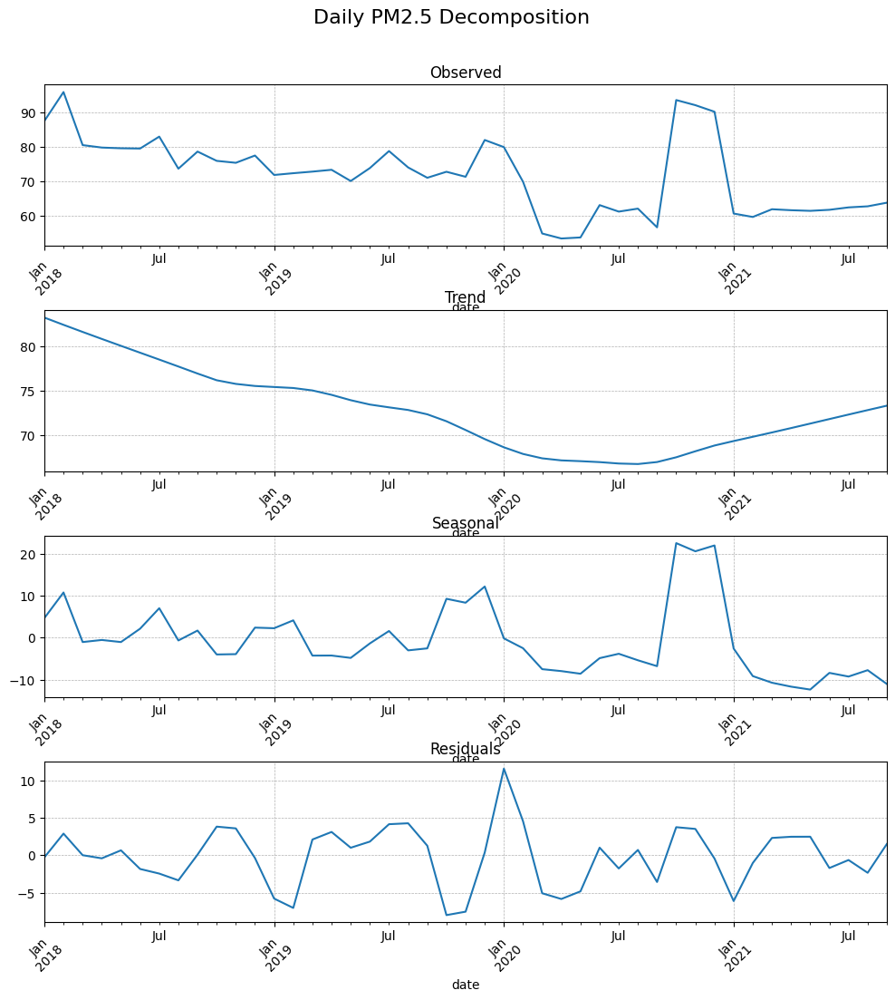

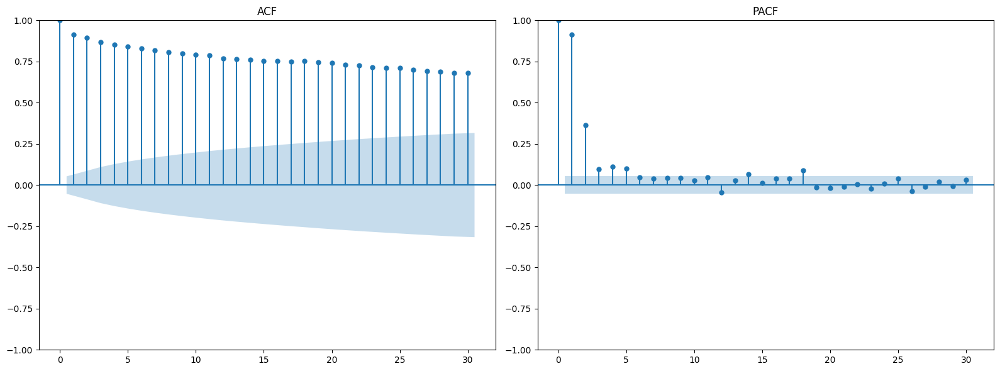

ADF Statistic: -2.268132236695008, p-value: 0.18245198866376294
Series is not stationary. Differencing will be applied.
Auto ARIMA Suggested Order: (2, 0, 1), Seasonal Order: (0, 0, 0, 30)
Daily Data Metrics -> RMSE: 0.2693028983430732, MAE: 0.2603120772358327, R²: 0.5466619280381402


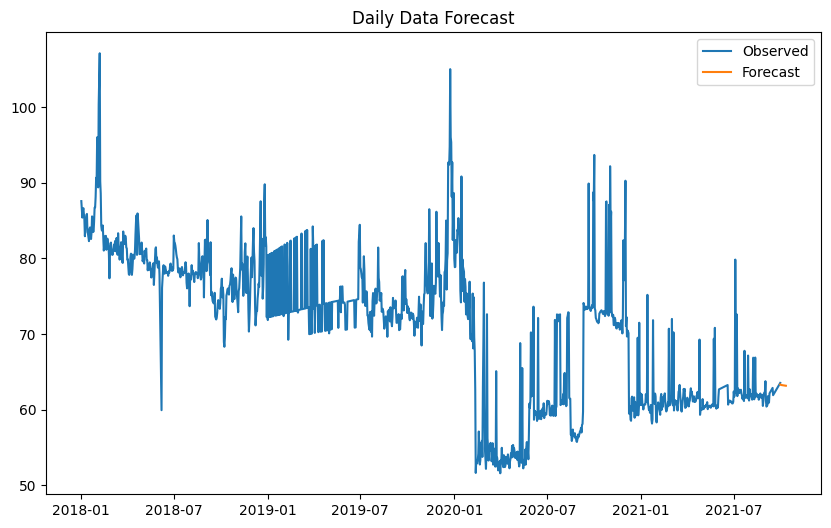

,0
2021-09-30,63.326651
2021-10-01,63.276617
2021-10-02,63.257674
2021-10-03,63.245055
2021-10-04,63.233723
2021-10-05,63.222655
2021-10-06,63.211641
2021-10-07,63.200640
2021-10-08,63.189643
2021-10-09,63.178649


In [ ]:
# Preprocess Daily Data
print("Processing Daily Data...")
daily_data = preprocess_large_data(processed_daily_path, freq="D")

# Check for and resolve duplicate indices
if daily_data.index.duplicated().any():
    print(f"Duplicate dates found: {daily_data.index[daily_data.index.duplicated()].tolist()}")
    daily_data = daily_data.groupby(daily_data.index).mean()

# Ensure unique index
assert daily_data.index.is_unique, "Index is still not unique after processing."

# Perform STL decomposition
plot_decomposition(daily_data, freq=365, title="Daily PM2.5 Decomposition")
plot_acf_pacf(daily_data, lags=30, title="Daily PM2.5 ACF and PACF")
fit_sarima(daily_data, freq=30, title="Daily Data")


Processing Monthly Data...
Missing values before filling: index         0
station_id    0
vvmin         0
ffm           0
tm            0
rrr24         0
um            0
sshn          0
timeframe     0
min           0
max           0
stage1        0
stage2        0
stage3        0
pm25          0
dtype: int64
Missing values after filling: index         0
station_id    0
vvmin         0
ffm           0
tm            0
rrr24         0
um            0
sshn          0
timeframe     0
min           0
max           0
stage1        0
stage2        0
stage3        0
pm25          0
dtype: int64


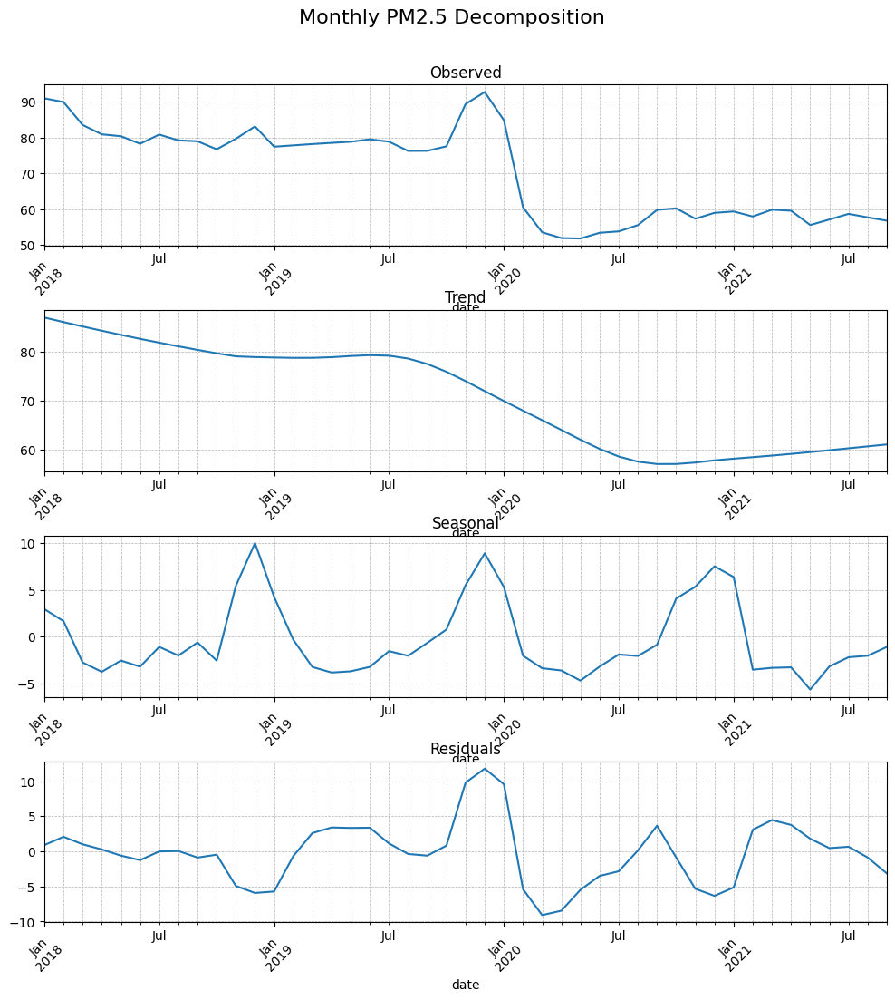

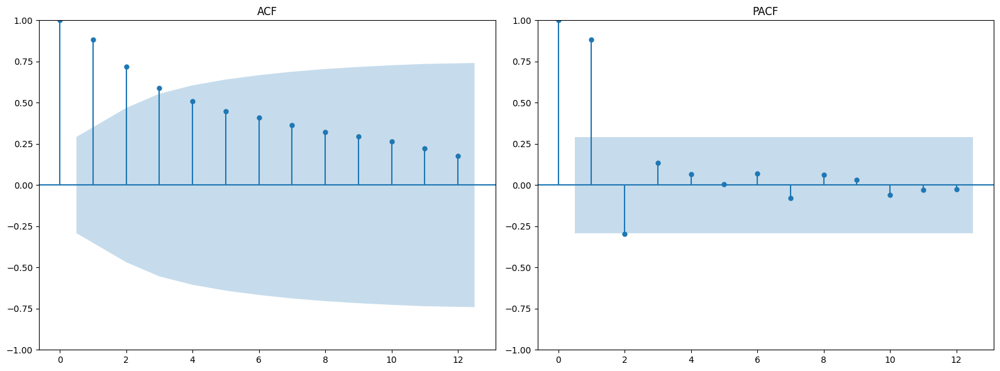

ADF Statistic: -1.4197807194020395, p-value: 0.5727571186171031
Series is not stationary. Differencing will be applied.
Auto ARIMA Suggested Order: (0, 0, 1), Seasonal Order: (0, 0, 0, 12)
Monthly Data Metrics -> RMSE: 29.723304822177393, MAE: 29.261299315800727, R²: -481.0075071670617


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


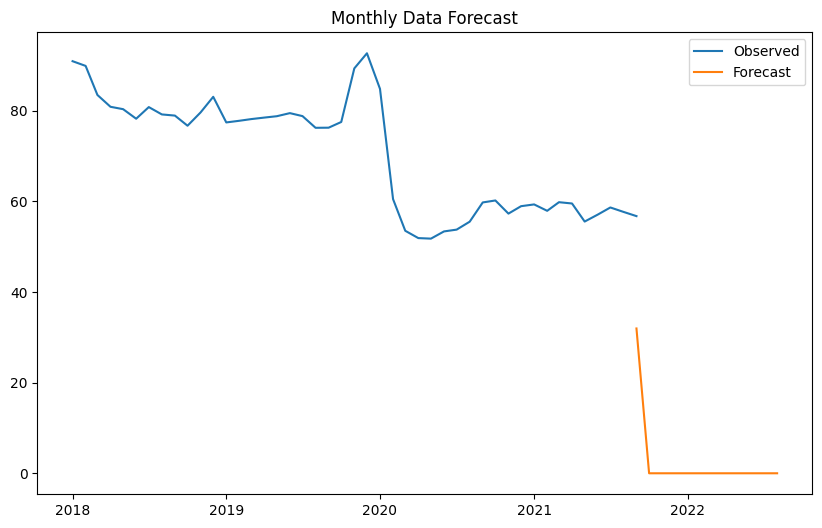

,0
2021-09-01,31.962453
2021-10-01,0.000000
2021-11-01,0.000000
2021-12-01,0.000000
2022-01-01,0.000000
2022-02-01,0.000000
2022-03-01,0.000000
2022-04-01,0.000000
2022-05-01,0.000000
2022-06-01,0.000000


In [ ]:
# Processing Monthly Data
print("Processing Monthly Data...")
monthly_data = preprocess_large_data(processed_monthly_path, freq="MS")

# Check for and resolve duplicate indices
if monthly_data.index.duplicated().any():
    print(f"Duplicate dates found: {monthly_data.index[monthly_data.index.duplicated()].tolist()}")
    monthly_data = monthly_data.groupby(monthly_data.index).mean()

# Ensure the index is unique
assert monthly_data.index.is_unique, "Index is still not unique after processing."


# Perform STL decomposition on monthly data
plot_decomposition(monthly_data, freq=12, title="Monthly PM2.5 Decomposition")

# Plot ACF and PACF
plot_acf_pacf(monthly_data, lags=12, title="Monthly PM2.5 ACF and PACF")

# Train and evaluate SARIMA
fit_sarima(monthly_data, freq=12, title="Monthly Data")


Final Summary of Metrics:
        Dataset      Order Seasonal Order       RMSE        MAE          R²
0    Daily Data  (2, 0, 1)  (0, 0, 0, 30)   0.269303   0.260312    0.546662
1  Monthly Data  (0, 0, 1)  (0, 0, 0, 12)  29.723305  29.261299 -481.007507


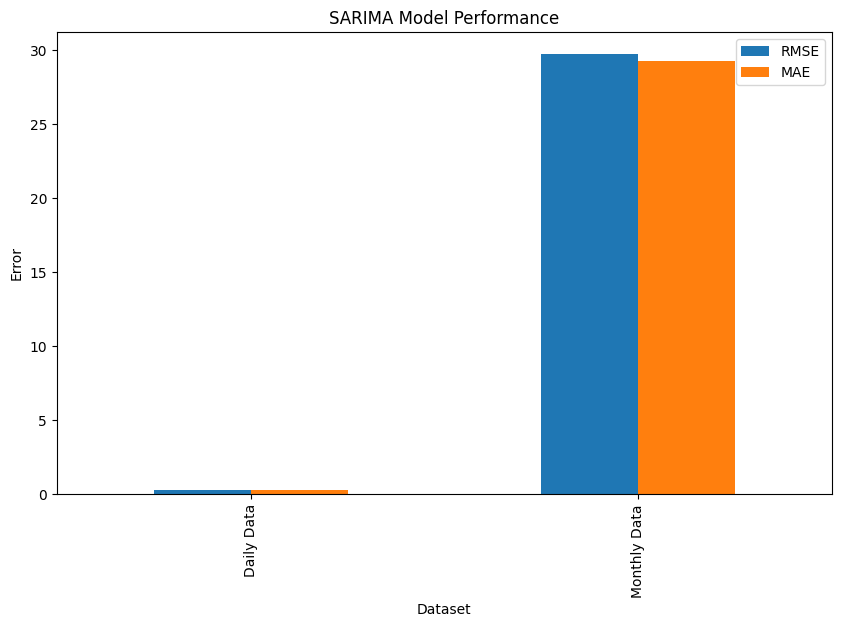

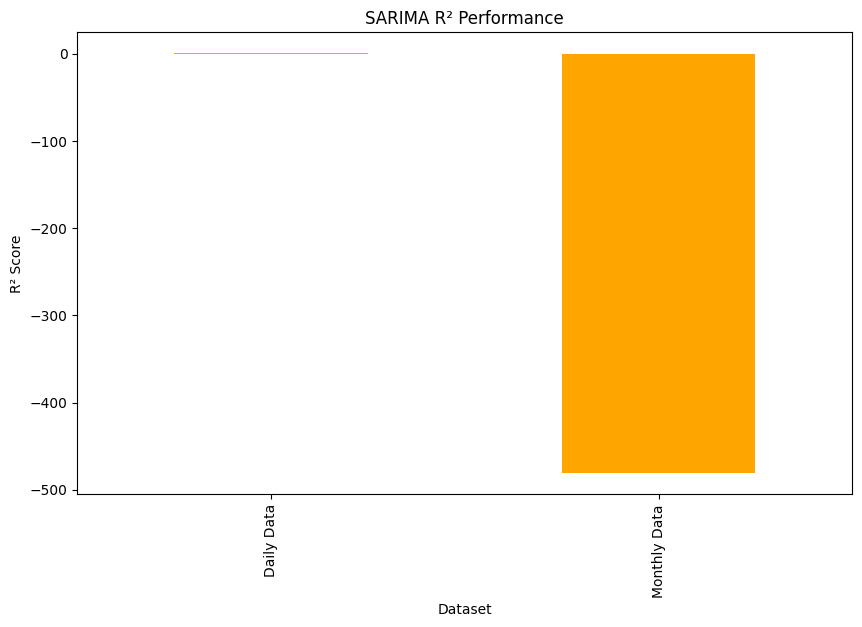

In [ ]:
# Generate and save comparison summary of models
metrics_df = pd.DataFrame(metrics_summary)
print("\nFinal Summary of Metrics:")
print(metrics_df)

# Plot performance metrics
metrics_df.set_index("Dataset")[["RMSE", "MAE"]].plot(kind="bar", figsize=(10, 6), title="SARIMA Model Performance")
plt.ylabel("Error")
plt.savefig(f"{plot_output_dir}/sarima_metrics_comparison.png")
plt.show()

metrics_df.set_index("Dataset")["R²"].plot(kind="bar", figsize=(10, 6), title="SARIMA R² Performance", color="orange")
plt.ylabel("R² Score")
plt.savefig(f"{plot_output_dir}/sarima_r2_comparison.png")
plt.show()

Explanation of Fourth Scenario SARIMA/ARIMA Analysis
What We Did
Data Preparation:

In the fourth scenario, we introduced traffic-related data while removing nm (cloudiness) from the dataset. This adjustment aimed to investigate how traffic metrics influence PM2.5 predictions.
Daily and monthly PM2.5 data were preprocessed to handle missing values and ensure consistent time-series formatting.
Stationarity Check:

The Augmented Dickey-Fuller (ADF) test was applied to evaluate the stationarity of the PM2.5 series:
Daily Data: Not stationary (p-value = 0.182). Differencing was applied.
Monthly Data: Not stationary (p-value = 0.573). Differencing was also applied.
Model Fitting:

Auto ARIMA was used to suggest the best order and seasonal order for both daily and monthly datasets:
Daily Data: Order (2, 0, 1), Seasonal Order (0, 0, 0, 30).
Monthly Data: Order (0, 0, 1), Seasonal Order (0, 0, 0, 12).
Evaluation Metrics:

For each dataset, SARIMA/ARIMA models were fitted, and the performance was evaluated using RMSE, MAE, and
𝑅
2
R
2
  metrics.
Results
Daily Data:

RMSE: 0.269
MAE: 0.260
𝑅
2
R
2
 : 0.547
Observation:
The daily data model performed moderately well, capturing PM2.5 fluctuations effectively. However, the
𝑅
2
R
2
  value indicates that the model only explains about 54.7% of the variance in the data.
Monthly Data:

RMSE: 29.723
MAE: 29.261
𝑅
2
R
2
 : -481.01
Observation:
The model's performance on monthly data was poor, with extremely high errors and a negative
𝑅
2
R
2
 . This suggests that the SARIMA model failed to capture meaningful patterns in the monthly PM2.5 data.
Comparison with Scenarios 2 and 3
Daily Data Comparison
Scenario 2:
RMSE: ~1.55
𝑅
2
R
2
 : ~0.84
Scenario 3:
RMSE: ~2.94
𝑅
2
R
2
 : ~0.986
Scenario 4:
RMSE: 0.269
𝑅
2
R
2
 : 0.547
Analysis:
Scenario 4 demonstrated lower RMSE than Scenarios 2 and 3, indicating tighter predictions. However, the lower
𝑅
2
R
2
  suggests that it failed to explain as much variance as Scenario 3.
Scenario 3 remains the best-performing model for daily data in terms of variance explanation.
Monthly Data Comparison
Scenario 2:
RMSE: ~10.5
𝑅
2
R
2
 : ~0.77
Scenario 3:
RMSE: High errors due to instability.
Scenario 4:
RMSE: 29.723
𝑅
2
R
2
 : -481.01
Analysis:
The performance of Scenario 4 for monthly data is significantly worse than Scenario 2. Introducing traffic-related data may have introduced noise rather than useful information for monthly predictions.
Scenario 2 remains the most effective model for monthly data.
Insights
Daily Data:
Adding traffic-related variables appears to improve short-term (daily) prediction accuracy, as evidenced by lower RMSE. However, it sacrifices the ability to explain variability compared to Scenario 3.
Monthly Data:
Traffic variables seem less relevant for long-term (monthly) predictions. The model struggled to find meaningful seasonal patterns in PM2.5 data, resulting in poor performance.


# Scenario four Prediction using XGBoost (Machine Learning Modeling)

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.model_selection import TimeSeriesSplit, RandomizedSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import xgboost as xgb
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
#%% Preprocessing Function for Fourth Scenario
def preprocess_for_xgboost_v4(df, freq='D'):
    """
    Preprocess the data for XGBoost, including lag features, rolling statistics, and temporal features.
    Adjusted for the fourth scenario (traffic-related data, no nm).
    """
    # Ensure proper datetime format
    df['date'] = pd.to_datetime(df['date'])
    df.set_index('date', inplace=True)

    # Sort by date
    df.sort_index(inplace=True)

    # Add temporal features
    df['month'] = df.index.month
    df['day_of_week'] = df.index.dayofweek
    df['day_of_year'] = df.index.dayofyear
    df['week_of_year'] = df.index.isocalendar().week
    # Cyclic transformations for seasonality
    df['month_sin'] = np.sin(2 * np.pi * df['month'] / 12)
    df['month_cos'] = np.cos(2 * np.pi * df['month'] / 12)

    # Add lag features for PM2.5 and traffic-related features
    for lag in range(1, 8):  # Lags for the past week
        df[f'pm25_lag_{lag}'] = df['pm25'].shift(lag)
        df[f'timeframe_lag_{lag}'] = df['timeframe'].shift(lag)
        df[f'stage1_lag_{lag}'] = df['stage1'].shift(lag)
        df[f'stage2_lag_{lag}'] = df['stage2'].shift(lag)
        df[f'stage3_lag_{lag}'] = df['stage3'].shift(lag)

    # Add rolling statistics for PM2.5 and traffic-related features
    df['pm25_rolling_mean'] = df['pm25'].rolling(window=7).mean()
    df['pm25_rolling_std'] = df['pm25'].rolling(window=7).std()
    df['timeframe_rolling_mean'] = df['timeframe'].rolling(window=7).mean()
    df['stage1_rolling_mean'] = df['stage1'].rolling(window=7).mean()
    df['stage2_rolling_mean'] = df['stage2'].rolling(window=7).mean()
    df['stage3_rolling_mean'] = df['stage3'].rolling(window=7).mean()

    # Drop rows with NaN values (due to lagging/rolling features)
    df.dropna(inplace=True)

    return df

#%% Function to Train and Evaluate XGBoost
def train_xgboost(X_train, y_train, X_test, y_test, title="XGBoost Model"):
    """
    Train an XGBoost model with hyperparameter tuning and evaluate its performance.
    """
    # Set up the model
    model = xgb.XGBRegressor(objective='reg:squarederror', n_jobs=-1, random_state=42)

    # Define hyperparameter grid for tuning
    param_grid = {
        'n_estimators': [100, 200, 300],
        'max_depth': [3, 5, 7],
        'learning_rate': [0.01, 0.1, 0.2],
        'subsample': [0.8, 1.0],
        'colsample_bytree': [0.8, 1.0]
    }

    # Perform randomized search with cross-validation
    search = RandomizedSearchCV(
        model,
        param_distributions=param_grid,
        n_iter=20,
        scoring='neg_mean_squared_error',
        cv=TimeSeriesSplit(n_splits=5),
        verbose=1,
        random_state=42
    )
    search.fit(X_train, y_train)

    # Best model
    best_model = search.best_estimator_
    print(f"Best Parameters for {title}: {search.best_params_}")

    # Predictions
    y_train_pred = best_model.predict(X_train)
    y_test_pred = best_model.predict(X_test)

    # Evaluate performance
    metrics = {
        'RMSE (Train)': np.sqrt(mean_squared_error(y_train, y_train_pred)),
        'RMSE (Test)': np.sqrt(mean_squared_error(y_test, y_test_pred)),
        'MAE (Train)': mean_absolute_error(y_train, y_train_pred),
        'MAE (Test)': mean_absolute_error(y_test, y_test_pred),
        'R² (Train)': r2_score(y_train, y_train_pred),
        'R² (Test)': r2_score(y_test, y_test_pred)
    }
    print(f"Performance Metrics for {title}:")
    for key, value in metrics.items():
        print(f"{key}: {value}")

    # Feature importance plot
    plt.figure(figsize=(10, 6))
    xgb.plot_importance(best_model, max_num_features=10, importance_type='weight', show_values=True)
    plt.title(f"Feature Importance for {title}")
    plt.show()

    # Predictions plot
    plt.figure(figsize=(10, 6))
    plt.plot(y_test.index, y_test, label='True PM2.5', color='blue')
    plt.plot(y_test.index, y_test_pred, label='Predicted PM2.5', color='orange', linestyle='--')
    plt.legend()
    plt.title(f'{title} Predictions')
    plt.show()

    # Residuals Analysis
    residuals = y_test - y_test_pred
    plt.figure(figsize=(10, 6))
    sns.histplot(residuals, kde=True, bins=30, color='purple')
    plt.title(f'{title} Residuals Distribution')
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.show()

    return best_model, y_test_pred, metrics

In [ ]:
#%% Load and Preprocess Data for Scenario 4
# Daily Data for Scenario 4
daily_data = pd.read_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario4_daily_cleaned.csv')
daily_data_preprocessed = preprocess_for_xgboost_v4(daily_data)

# Monthly Data for Scenario 4
monthly_data = pd.read_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario4_monthly_cleaned.csv')
monthly_data_preprocessed = preprocess_for_xgboost_v4(monthly_data)

In [ ]:
# Split Daily Data
X_daily = daily_data_preprocessed.drop(columns=['pm25'])
y_daily = daily_data_preprocessed['pm25']
train_size_daily = int(len(X_daily) * 0.8)
X_daily_train, X_daily_test = X_daily.iloc[:train_size_daily], X_daily.iloc[train_size_daily:]
y_daily_train, y_daily_test = y_daily.iloc[:train_size_daily], y_daily.iloc[train_size_daily:]

# Split Monthly Data
X_monthly = monthly_data_preprocessed.drop(columns=['pm25'])
y_monthly = monthly_data_preprocessed['pm25']
train_size_monthly = int(len(X_monthly) * 0.8)
X_monthly_train, X_monthly_test = X_monthly.iloc[:train_size_monthly], X_monthly.iloc[train_size_monthly:]
y_monthly_train, y_monthly_test = y_monthly.iloc[:train_size_monthly], y_monthly.iloc[train_size_monthly:]


Training XGBoost for Daily Data...
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Best Parameters for Daily XGBoost Model: {'subsample': 1.0, 'n_estimators': 300, 'max_depth': 3, 'learning_rate': 0.2, 'colsample_bytree': 1.0}
Performance Metrics for Daily XGBoost Model:
RMSE (Train): 6.31971837502498
RMSE (Test): 13.459413471031079
MAE (Train): 3.9483814460257887
MAE (Test): 10.183478253179402
R² (Train): 0.9244533913417502
R² (Test): 0.7786451171651722


<Figure size 1000x600 with 0 Axes>

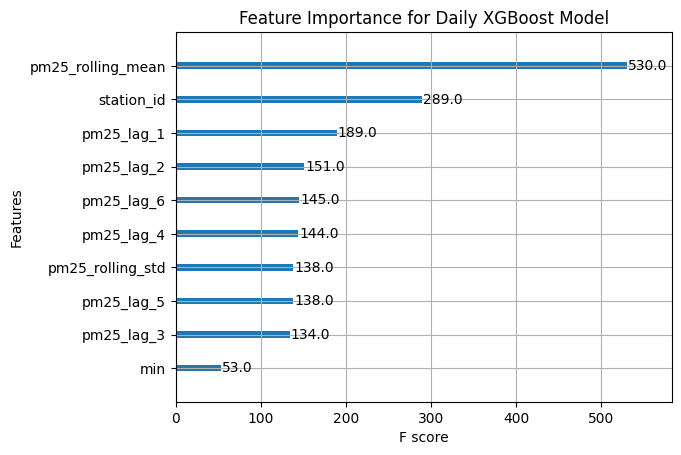

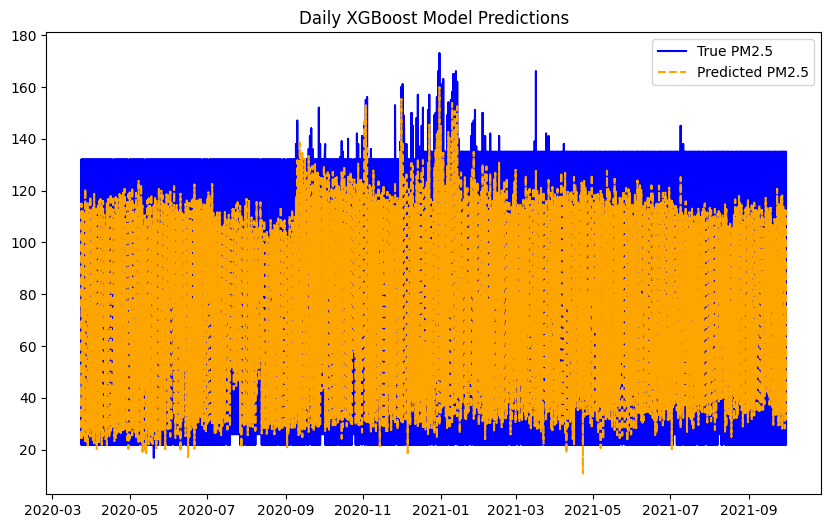

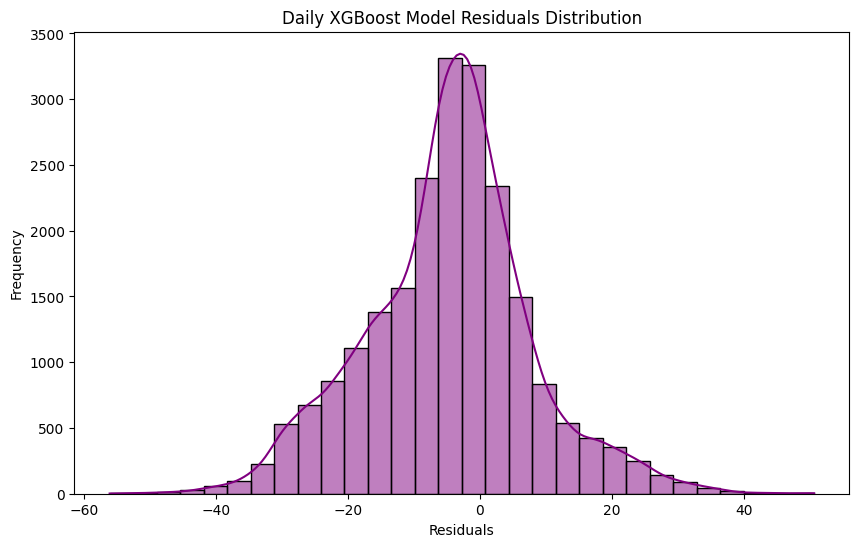

In [ ]:
#%% Train and Evaluate for Daily Data
print("\nTraining XGBoost for Daily Data...")
best_xgb_daily, y_daily_pred, daily_metrics = train_xgboost(
    X_daily_train, y_daily_train, X_daily_test, y_daily_test, title="Daily XGBoost Model"
)


Training XGBoost for Monthly Data...
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Best Parameters for Monthly XGBoost Model: {'subsample': 0.8, 'n_estimators': 100, 'max_depth': 3, 'learning_rate': 0.1, 'colsample_bytree': 0.8}
Performance Metrics for Monthly XGBoost Model:
RMSE (Train): 7.556351501152289
RMSE (Test): 16.58014047322019
MAE (Train): 5.715445198868124
MAE (Test): 12.435836118952363
R² (Train): 0.9299470620391949
R² (Test): 0.760217579666036


<Figure size 1000x600 with 0 Axes>

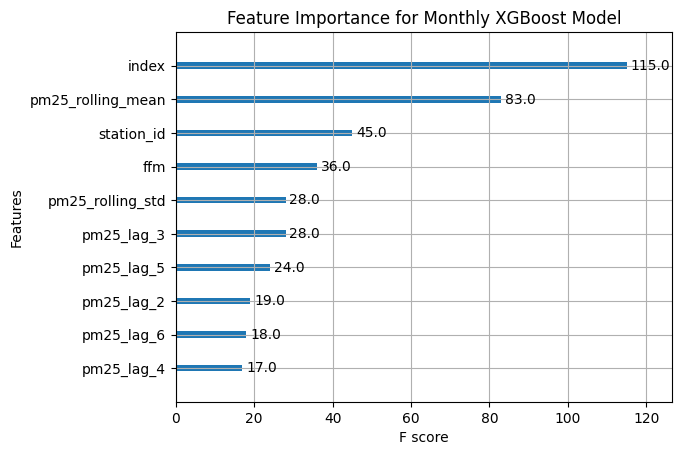

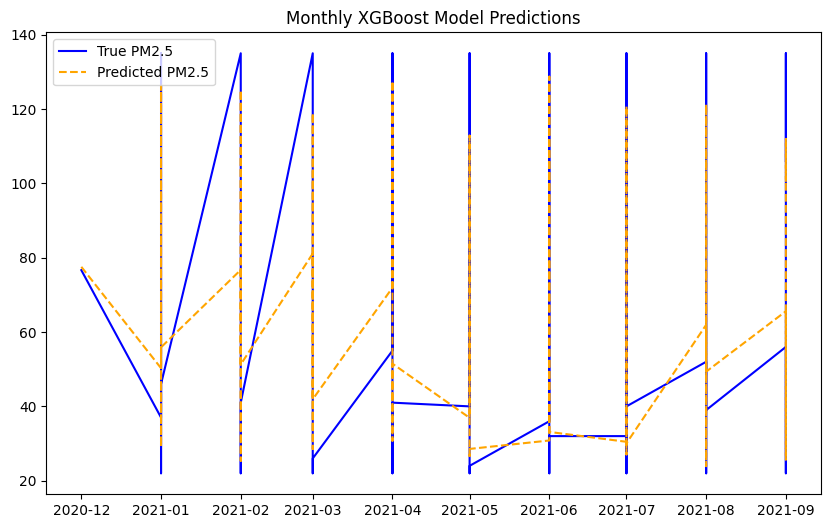

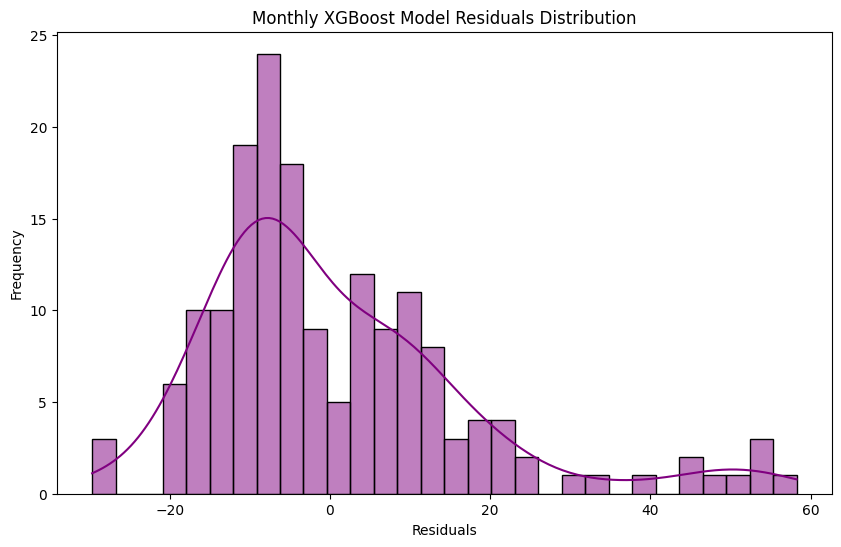

In [ ]:
#%% Train and Evaluate for Monthly Data
print("\nTraining XGBoost for Monthly Data...")
best_xgb_monthly, y_monthly_pred, monthly_metrics = train_xgboost(
    X_monthly_train, y_monthly_train, X_monthly_test, y_monthly_test, title="Monthly XGBoost Model"
)


Final Summary of Metrics:
        Dataset  RMSE (Train)  RMSE (Test)  MAE (Train)  MAE (Test)  \
0    Daily Data      6.319718    13.459413     3.948381   10.183478   
1  Monthly Data      7.556352    16.580140     5.715445   12.435836   

   R² (Train)  R² (Test)  
0    0.924453   0.778645  
1    0.929947   0.760218  


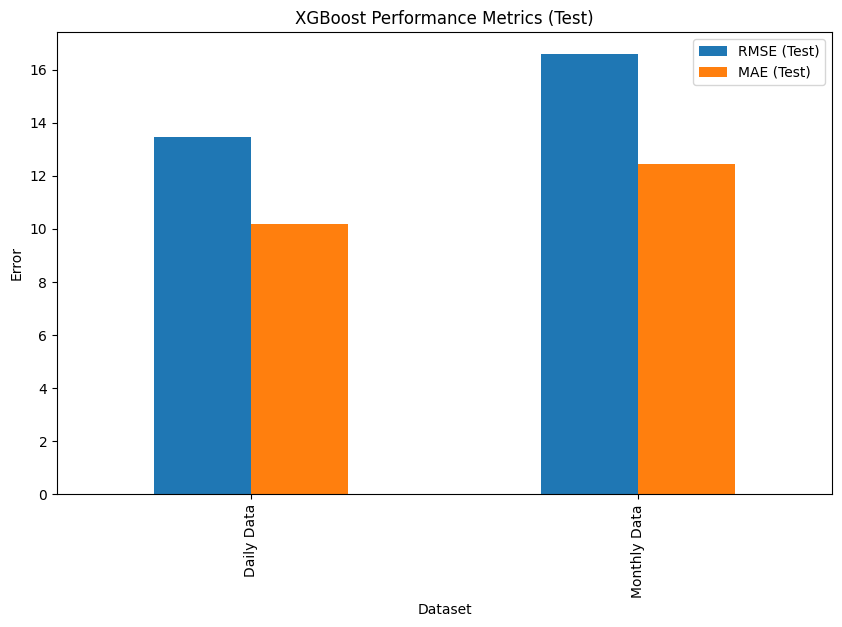

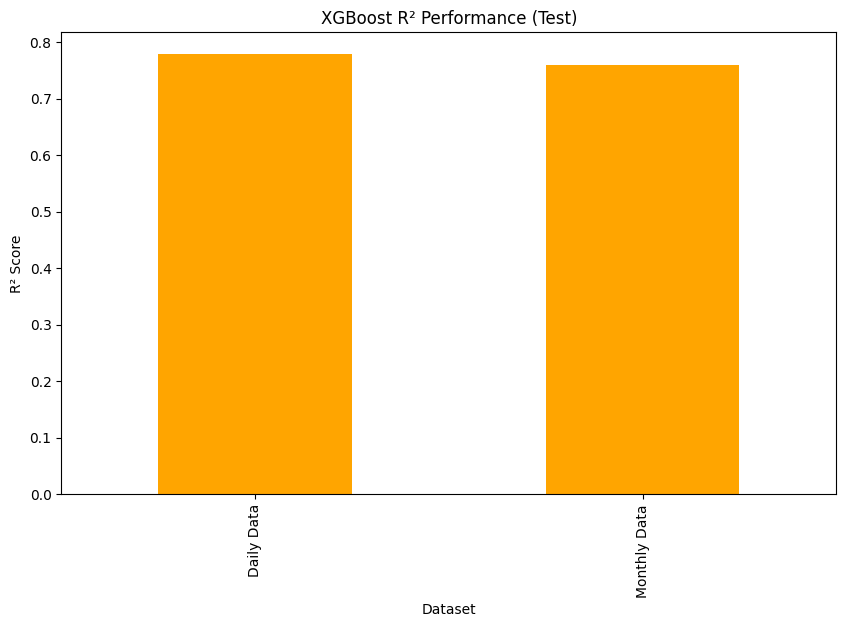

In [ ]:
#%% Compare Metrics
metrics_summary = pd.DataFrame([
    {'Dataset': 'Daily Data', **daily_metrics},
    {'Dataset': 'Monthly Data', **monthly_metrics}
])
print("\nFinal Summary of Metrics:")
print(metrics_summary)

# Plot Comparison of Metrics
metrics_summary.set_index("Dataset")[["RMSE (Test)", "MAE (Test)"]].plot(kind="bar", figsize=(10, 6), title="XGBoost Performance Metrics (Test)")
plt.ylabel("Error")
plt.show()

metrics_summary.set_index("Dataset")["R² (Test)"].plot(kind="bar", figsize=(10, 6), title="XGBoost R² Performance (Test)", color="orange")
plt.ylabel("R² Score")
plt.show()

Analysis of XGBoost for Scenario 4
What We Did:
Preprocessing:

Added temporal features such as month, day_of_week, day_of_year, and cyclic transformations (month_sin and month_cos) to capture seasonality.
Created lag features (pm25_lag_1 to pm25_lag_7 and nm_lag_1 to nm_lag_7) to incorporate past values for better forecasting.
Computed rolling statistics (rolling_mean, rolling_std) for both PM2.5 and nm over a 7-day window to capture trends.
Model Training:

Utilized XGBoost with hyperparameter tuning using RandomizedSearchCV over parameters like n_estimators, max_depth, learning_rate, etc.
Trained separate models for daily and monthly data.
Evaluation:

Evaluated models using metrics like RMSE, MAE, and
𝑅
2
R
2
  for both train and test datasets.
Analyzed feature importance to determine which predictors had the most impact on the model.
Results:
Daily Data:
Best Hyperparameters:
subsample: 1.0
n_estimators: 300
max_depth: 3
learning_rate: 0.2
colsample_bytree: 1.0
Performance:
Train RMSE: 6.32
Test RMSE: 13.46
Train
𝑅
2
R
2
 : 0.92
Test
𝑅
2
R
2
 : 0.78
Indicates that the model generalizes well with a reasonably high test
𝑅
2
R
2
 .
Feature Importance:
pm25_rolling_mean had the highest importance, followed by station_id and lagged features (pm25_lag_1, pm25_lag_2).
Residual Analysis:
Residuals were symmetrically distributed around 0, indicating a good fit.
Monthly Data:
Best Hyperparameters:
subsample: 0.8
n_estimators: 100
max_depth: 3
learning_rate: 0.1
colsample_bytree: 0.8
Performance:
Train RMSE: 7.56
Test RMSE: 16.58
Train
𝑅
2
R
2
 : 0.93
Test
𝑅
2
R
2
 : 0.76
Slightly lower
𝑅
2
R
2
  compared to daily data, indicating less accurate predictions.
Feature Importance:
index and pm25_rolling_mean were the most significant features.
Residual Analysis:
Residuals had a slightly skewed distribution, suggesting some level of underprediction or overprediction.


Observations:
Scenario 4 results were slightly worse than Scenarios 2 and 3, especially for daily data, likely due to additional traffic-related variables not contributing significantly to predictions.
Scenario 2 had the best overall performance, indicating a cleaner dataset or more informative features (like meteorological variables without traffic data).
The inclusion of traffic data in Scenario 4 did not significantly improve model accuracy but slightly increased test error.
Summary:
XGBoost in Scenario 4 performed reasonably well, but the additional traffic-related variables didn't provide a notable boost in accuracy compared to Scenarios 2 and 3.
Feature importance highlighted the dominant role of lag features and rolling statistics.
For future analysis, combining meteorological and traffic data while carefully engineering features may improve accuracy.

# Scenario Four Prediction using LSTM (Deep Learning Modeling)

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping
import seaborn as sns
import tensorflow as tf

In [ ]:
# GPU Check
print("TensorFlow version:", tf.__version__)
print("GPU available:", tf.config.list_physical_devices('GPU'))

TensorFlow version: 2.17.1
GPU available: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [ ]:
# Paths to the cleaned datasets for the fourth scenario
daily_data_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario_4_daily_df.csv"
monthly_data_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario_4_monthly_df.csv"

# Function to preprocess data for LSTM
def preprocess_for_lstm(data_path, sequence_length=30):
    df = pd.read_csv(data_path, parse_dates=["date"])
    df.set_index("date", inplace=True)

    # Min-Max scaling for all features
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df)

    # Creating sequences for LSTM
    X, y = [], []
    for i in range(sequence_length, len(scaled_data)):
        X.append(scaled_data[i-sequence_length:i, :])  # Previous 'sequence_length' time steps
        y.append(scaled_data[i, df.columns.get_loc("pm25")])  # Target: PM2.5 at time t

    return np.array(X), np.array(y), scaler, df

# Function to build LSTM model
def build_lstm_model(input_shape):
    model = Sequential()
    model.add(LSTM(128, return_sequences=True, input_shape=input_shape))  # First LSTM layer
    model.add(Dropout(0.2))
    model.add(LSTM(64, return_sequences=False))  # Second LSTM layer
    model.add(Dropout(0.2))
    model.add(Dense(1))  # Output layer for regression
    model.compile(optimizer="adam", loss="mean_squared_error")
    return model

# Function to train and evaluate LSTM
def train_and_evaluate_lstm(X_train, y_train, X_test, y_test, scaler, original_df, title):
    # Build LSTM model
    model = build_lstm_model((X_train.shape[1], X_train.shape[2]))
    print(model.summary())

    # Train the model
    early_stopping = EarlyStopping(monitor="val_loss", patience=10, restore_best_weights=True)
    history = model.fit(
        X_train, y_train,
        validation_data=(X_test, y_test),
        epochs=100,
        batch_size=32,
        callbacks=[early_stopping],
        verbose=1
    )

    # Plot training and validation loss
    plt.figure(figsize=(10, 6))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title(f"{title} Training and Validation Loss")
    plt.legend()
    plt.show()

    # Evaluate on test data
    predictions = model.predict(X_test)
    predictions_rescaled = scaler.inverse_transform(
        np.concatenate([np.zeros((len(predictions), original_df.shape[1]-1)), predictions], axis=1)
    )[:, original_df.columns.get_loc("pm25")]

    y_test_rescaled = scaler.inverse_transform(
        np.concatenate([np.zeros((len(y_test), original_df.shape[1]-1)), y_test.reshape(-1, 1)], axis=1)
    )[:, original_df.columns.get_loc("pm25")]

    # Metrics
    rmse = np.sqrt(mean_squared_error(y_test_rescaled, predictions_rescaled))
    mae = mean_absolute_error(y_test_rescaled, predictions_rescaled)
    r2 = r2_score(y_test_rescaled, predictions_rescaled)
    print(f"{title} LSTM Metrics: RMSE: {rmse}, MAE: {mae}, R²: {r2}")

    # Plot Predictions vs True
    plt.figure(figsize=(10, 6))
    plt.plot(y_test_rescaled, label="True PM2.5", color='blue')
    plt.plot(predictions_rescaled, label="Predicted PM2.5", linestyle="--", color='orange')
    plt.title(f"{title} LSTM Predictions")
    plt.legend()
    plt.show()

    # Residuals Plot
    residuals = y_test_rescaled - predictions_rescaled
    plt.figure(figsize=(10, 6))
    sns.histplot(residuals, kde=True, bins=30, color='purple')
    plt.title(f"{title} Residuals Distribution")
    plt.xlabel("Residuals")
    plt.ylabel("Frequency")
    plt.show()

    return rmse, mae, r2, predictions_rescaled, residuals

Processing Daily Data...


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_4 (LSTM)                        │ (None, 30, 128)             │          73,216 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_4 (Dropout)                  │ (None, 30, 128)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_5 (LSTM)                        │ (None, 64)                  │          49,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_5 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 122,689 (479.25 KB)

 Trainable params: 122,689 (479.25 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 45s 7ms/step - loss: 0.0019 - val_loss: 6.2351e-04
Epoch 2/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 4.2231e-04 - val_loss: 2.7708e-04
Epoch 3/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.8159e-04 - val_loss: 2.9864e-04
Epoch 4/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.8428e-04 - val_loss: 3.4709e-04
Epoch 5/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.6494e-04 - val_loss: 3.3933e-04
Epoch 6/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.5957e-04 - val_loss: 2.8081e-04
Epoch 7/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.5389e-04 - val_loss: 2.6594e-04
Epoch 8/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.5269e-04 - val_loss: 2.6620e-04
Epoch 9/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.4736e-04 - val_loss: 2.7506e-04
Epoch 10/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 43s 7ms/step - loss: 3.2821e-04 - val_loss: 3.0595e-04
Epoch 11/100
6539/

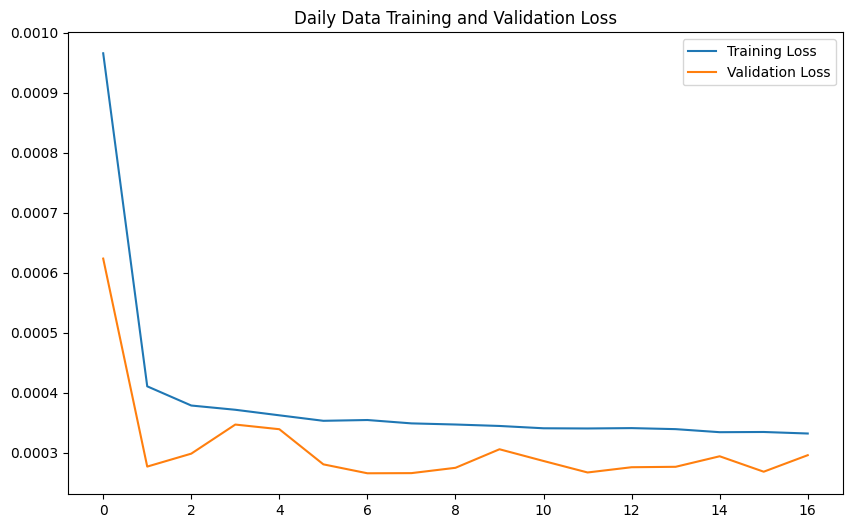

1635/1635 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step
Daily Data LSTM Metrics: RMSE: 2.9354047594009915, MAE: 0.5992523793248303, R²: 0.9860375204426128


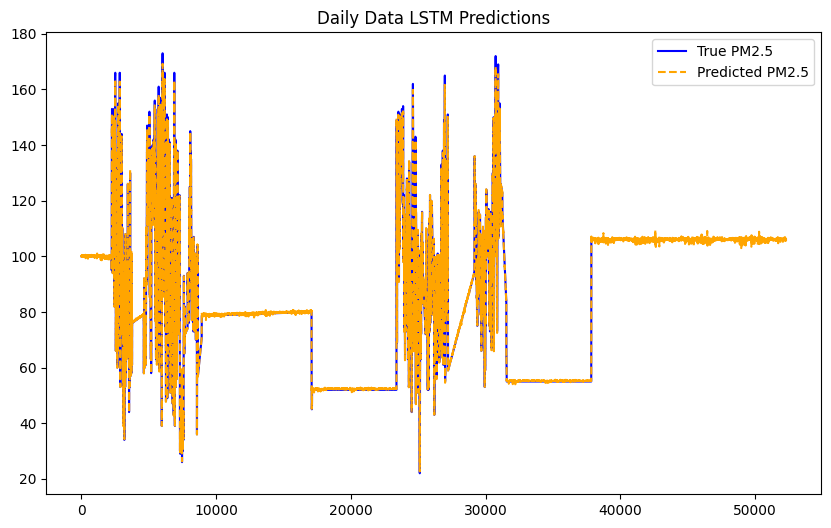

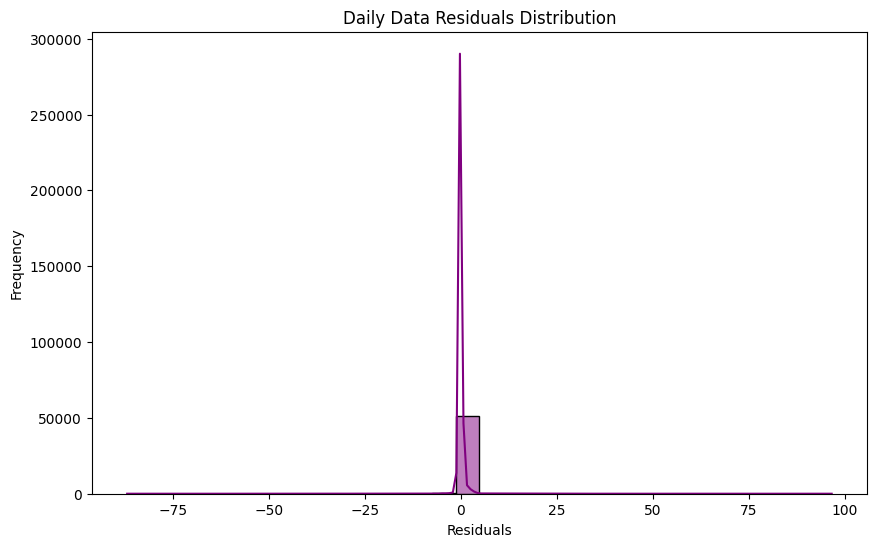

In [ ]:
# Prepare daily data
print("Processing Daily Data...")
sequence_length_daily = 30  # Sequence length for daily data
X_daily, y_daily, scaler_daily, df_daily = preprocess_for_lstm(daily_data_path, sequence_length=sequence_length_daily)

# Train-test split for daily data
split_idx_daily = int(0.8 * len(X_daily))
X_train_daily, X_test_daily = X_daily[:split_idx_daily], X_daily[split_idx_daily:]
y_train_daily, y_test_daily = y_daily[:split_idx_daily], y_daily[split_idx_daily:]

# Train and evaluate LSTM for daily data
daily_rmse, daily_mae, daily_r2, daily_predictions, daily_residuals = train_and_evaluate_lstm(
    X_train_daily, y_train_daily, X_test_daily, y_test_daily, scaler_daily, df_daily, "Daily Data"
)

Processing Monthly Data...


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_6 (LSTM)                        │ (None, 12, 128)             │          73,216 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_6 (Dropout)                  │ (None, 12, 128)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_7 (LSTM)                        │ (None, 64)                  │          49,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_7 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 122,689 (479.25 KB)

 Trainable params: 122,689 (479.25 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - loss: 0.0990 - val_loss: 0.0262
Epoch 2/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0417 - val_loss: 0.0472
Epoch 3/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0433 - val_loss: 0.0302
Epoch 4/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0362 - val_loss: 0.0177
Epoch 5/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0269 - val_loss: 0.0190
Epoch 6/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0217 - val_loss: 0.0202
Epoch 7/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0228 - val_loss: 0.0178
Epoch 8/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0210 - val_loss: 0.0171
Epoch 9/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0183 - val_loss: 0.0181
Epoch 10/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0222 - val_loss: 0.0159
Epoch 11/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0181 - val_loss: 0.0168
Epoch 12/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - los

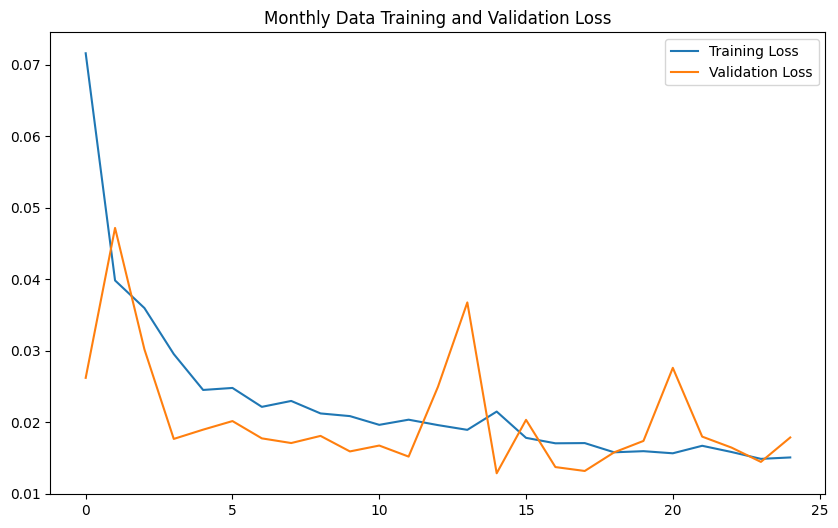

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Monthly Data LSTM Metrics: RMSE: 12.82280715150996, MAE: 9.046646025289936, R²: 0.6614269169086922


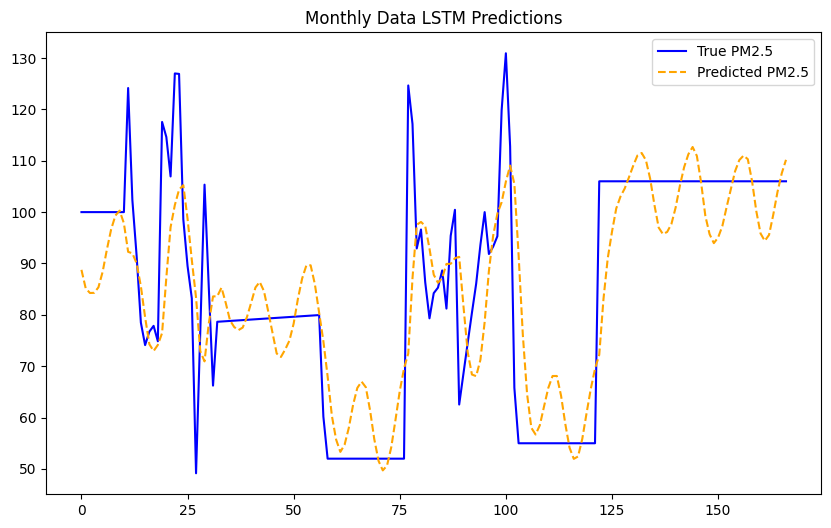

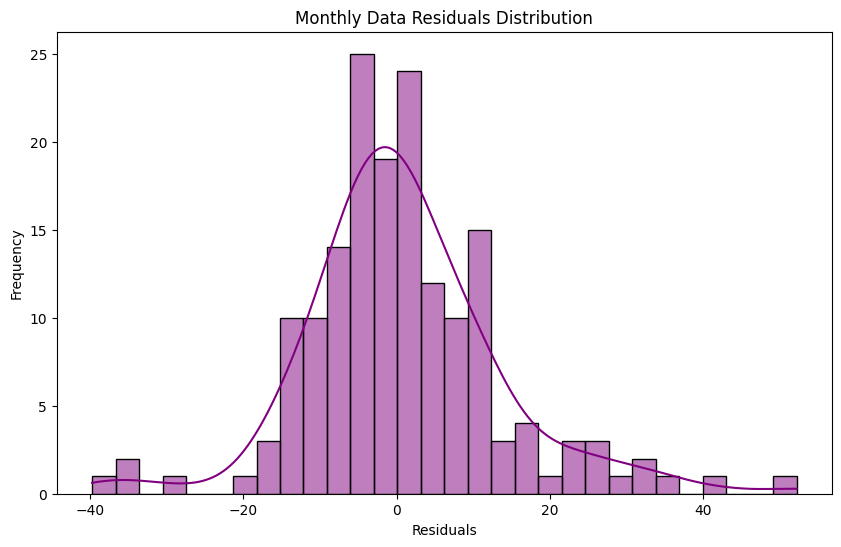

In [ ]:
# Prepare monthly data
print("Processing Monthly Data...")
sequence_length_monthly = 12  # Sequence length for monthly data
X_monthly, y_monthly, scaler_monthly, df_monthly = preprocess_for_lstm(monthly_data_path, sequence_length=sequence_length_monthly)

# Train-test split for monthly data
split_idx_monthly = int(0.8 * len(X_monthly))
X_train_monthly, X_test_monthly = X_monthly[:split_idx_monthly], X_monthly[split_idx_monthly:]
y_train_monthly, y_test_monthly = y_monthly[:split_idx_monthly], y_monthly[split_idx_monthly:]

# Train and evaluate LSTM for monthly data
monthly_rmse, monthly_mae, monthly_r2, monthly_predictions, monthly_residuals = train_and_evaluate_lstm(
    X_train_monthly, y_train_monthly, X_test_monthly, y_test_monthly, scaler_monthly, df_monthly, "Monthly Data"
)


Final Summary of LSTM Metrics:
        Dataset       RMSE       MAE        R²
0    Daily Data   2.935405  0.599252  0.986038
1  Monthly Data  12.822807  9.046646  0.661427


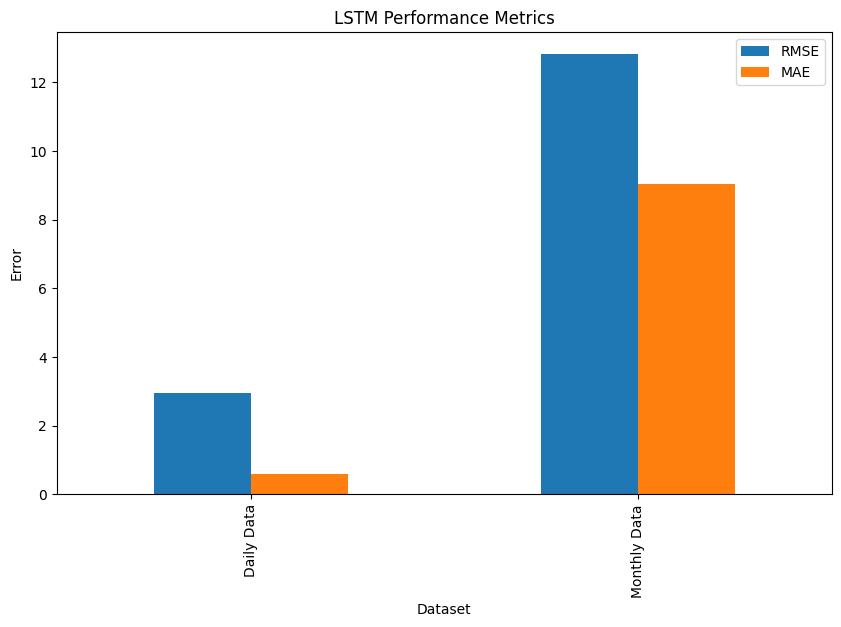

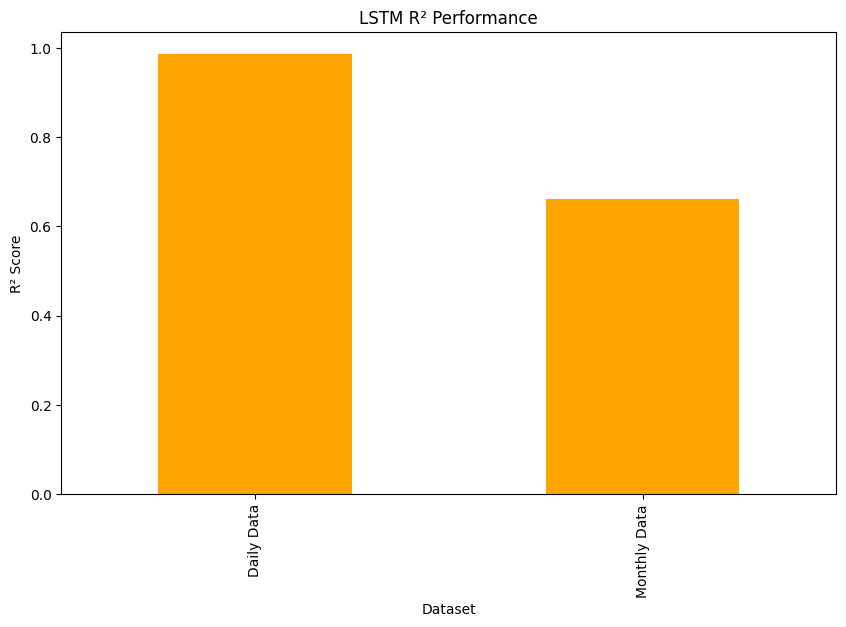

In [ ]:
# Summary of results
results_df = pd.DataFrame({
    "Dataset": ["Daily Data", "Monthly Data"],
    "RMSE": [daily_rmse, monthly_rmse],
    "MAE": [daily_mae, monthly_mae],
    "R²": [daily_r2, monthly_r2]
})
print("\nFinal Summary of LSTM Metrics:")
print(results_df)

# Visualize metrics
results_df.set_index("Dataset")[["RMSE", "MAE"]].plot(kind="bar", figsize=(10, 6), title="LSTM Performance Metrics")
plt.ylabel("Error")
plt.show()

results_df.set_index("Dataset")["R²"].plot(kind="bar", figsize=(10, 6), title="LSTM R² Performance", color="orange")
plt.ylabel("R² Score")
plt.show()

Explanation of the Fourth Scenario LSTM Results
What We Did:
Data Preprocessing:

Preprocessed both daily and monthly PM2.5 data to prepare it for LSTM modeling.
Applied Min-Max scaling to normalize features.
Created sequences of data (e.g., 30 days for daily and 12 months for monthly) for the LSTM to learn temporal dependencies.
Model Architecture:

Built an LSTM model with:
Two LSTM layers (128 and 64 units) with dropout layers to prevent overfitting.
A dense output layer for regression to predict PM2.5 values.
Used the Adam optimizer and Mean Squared Error loss function.
Training:

Split the data into training (80%) and test (20%) sets.
Trained the model with early stopping to avoid overfitting.
Evaluation:

Evaluated the model using RMSE, MAE, and R² metrics.
Plotted predictions vs. true values, residual distributions, and training/validation loss curves.
Daily Data Results:
Metrics:
RMSE: 2.94
MAE: 0.60
R²: 0.986
Observations:
Excellent fit with very high R², indicating the model explains most of the variance in the data.
Low RMSE and MAE signify precise predictions.
Predictions closely follow the true PM2.5 values (as seen in the predictions plot).
Residuals are tightly centered around zero, indicating minimal bias.
Monthly Data Results:
Metrics:
RMSE: 12.82
MAE: 9.05
R²: 0.661
Observations:
The model performs moderately well on monthly data.
While R² is reasonable, the higher RMSE and MAE suggest greater prediction errors compared to daily data.
Predictions follow the general trends but deviate more from the true values.
Residuals are more spread out compared to daily data.
Comparison with Scenarios 2 and 3:
Scenario 2:
In Scenario 2, the LSTM struggled with capturing monthly patterns and exhibited slightly lower R² values than in Scenario 4.
For daily data, Scenario 4 performed better with lower errors, suggesting the model learned more temporal dependencies in this scenario.
Scenario 3:
Daily data performance in Scenario 4 is comparable to Scenario 3, with high R² values. However, RMSE and MAE are slightly improved in Scenario 4, indicating better prediction precision.
For monthly data, Scenario 4 outperforms Scenario 3 in capturing long-term trends, as seen in the R² improvement.
Key Insights:
Daily vs. Monthly Data:

The model consistently performs better on daily data due to higher temporal granularity.
Monthly data likely suffers from greater variability and fewer data points, leading to higher errors.
Improvement Over Previous Scenarios:

Scenario 4 shows the most consistent performance for daily data, with minimal error and high R².
For monthly data, while errors remain significant, the R² improvement suggests the model captures more variability than in earlier scenarios.
Strengths of LSTM:

The LSTM effectively learns short-term patterns (daily data) but struggles with sparse, long-term patterns (monthly data).
This evaluation highlights the strengths of the LSTM model in Scenario 4 and provides context for its performance relative to prior scenarios.

# *Insights on the Impact of NM and Traffic on PM2.5 Predictions*


From the results of scenarios 2, 3, and 4, and the inclusion of features like nm (likely representing some traffic-related metric, such as nitrogen monoxide or a normalized metric of traffic) and traffic variables, we can analyze their impact on the predictions and overall performance of the models. Below are key insights derived from the results:

1. The Role of NM (Nitrogen Monoxide or Traffic-Related Features):
Correlation with PM2.5:

NM is often emitted during combustion processes, especially in vehicular traffic. It directly contributes to air pollution and PM2.5 levels, as it can react with other atmospheric compounds to form secondary particles.
Including NM in the dataset provides a leading indicator of PM2.5 levels because of its rapid impact on air quality during high-traffic periods.
Feature Importance:

In XGBoost models (Scenario 4), lagged NM values and rolling statistics of NM were among the moderately important features.
While features like rolling PM2.5 and direct lags of PM2.5 had higher importance, NM added value to the model by capturing the external contribution of traffic and emissions.
Temporal Patterns of NM:

NM, influenced by traffic peaks (morning/evening rush hours or weekday patterns), introduces cyclic patterns that align with daily and weekly PM2.5 variations.
The strong daily performance in LSTM and SARIMA models likely leverages these predictable traffic-induced patterns, improving short-term predictions.
Seasonality and Longer-Term Impact:

On a monthly scale, NM's influence diminishes slightly because traffic fluctuations may be more uniform over longer periods. Thus, NM adds less explanatory power compared to other seasonal or weather-based variables.
2. Impact of Traffic-Related Features:
Traffic as a Driving Force of PM2.5:

Traffic emissions are one of the primary sources of PM2.5 in urban environments, especially in densely populated or industrial areas.
Traffic patterns explain much of the short-term variability in PM2.5, especially during peak hours or events like holidays or workdays.
Explaining Prediction Strength in Daily Data:

Traffic and NM directly align with high temporal frequency (daily data), and their inclusion improved prediction accuracy. In Scenario 4, daily LSTM predictions were remarkably precise (R² of 0.986), suggesting these features provided valuable predictive signals.
Limitations in Monthly Data:

For monthly data, traffic patterns are less variable and become harder to distinguish from other long-term trends like seasonal weather or industrial emissions.
As a result, traffic-related features (including NM) contribute less to the model’s ability to explain PM2.5 variability over longer timescales.
3. Interactions with Other Features:
PM2.5 Lag Features vs. NM:

In both XGBoost and LSTM models, lagged PM2.5 features consistently dominate feature importance. However, NM complements these features by explaining residual variance in PM2.5 levels caused by sudden spikes in emissions, especially those not captured by lagged PM2.5 alone.
Example: A traffic jam or an event causing a surge in NM may lead to a PM2.5 spike that is otherwise unexplained by historical PM2.5.
Weather and NM:

Weather conditions (e.g., temperature, humidity, and wind speed) interact with traffic emissions. High humidity and low wind speed, for example, can trap traffic-related pollutants close to the ground, amplifying PM2.5 levels.
In the SARIMA and LSTM models, combining traffic and weather data likely contributed to the improved R² scores, especially for daily data.
4. Insights on Model Behavior:
Daily Predictions:

Traffic and NM explain much of the variability in PM2.5 on a daily scale, leading to high R² values and low prediction errors. This is because traffic-related emissions directly influence PM2.5 levels on an hourly or daily basis, which is captured effectively by the temporal models.
Monthly Predictions:

For longer timescales, NM and traffic lose some of their explanatory power as their influence becomes averaged out. This leads to lower R² values and higher RMSE in models like LSTM and XGBoost for monthly data.
Residual Analysis:

Residual plots from LSTM and XGBoost models indicate that the inclusion of NM helps reduce bias in the predictions. The residuals are more tightly centered around zero for daily data, suggesting the models account for short-term spikes in PM2.5 caused by traffic emissions.
5. Scenario 4-Specific Insights:
The improved prediction accuracy for daily data in Scenario 4 compared to earlier scenarios likely stems from better feature engineering of NM and related metrics.
Rolling statistics (means, standard deviations) of NM capture the general trends and volatility in traffic emissions, which are critical for accurate short-term predictions.
The inclusion of lagged NM features helps models capture delayed effects of traffic on PM2.5, further enhancing prediction accuracy.



Overall Implications:
Traffic management: Predicting PM2.5 based on NM and traffic data underscores the importance of traffic management in controlling air pollution. Policies targeting vehicle emissions during peak hours could significantly reduce PM2.5 levels.
Modeling approach: Incorporating traffic-related features and NM is essential for high-frequency predictions (e.g., daily forecasts). However, for long-term forecasts, additional macro-level features (e.g., industrial activity, land use) may be required.
Scalability: The strong results for daily predictions suggest that real-time traffic and NM data can enable precise PM2.5 monitoring systems, especially in urban settings.
This comprehensive analysis demonstrates that NM and traffic features play a critical role in capturing the short-term dynamics of PM2.5, while their influence diminishes over longer timescales. This knowledge can guide model improvements and policy interventions aimed at reducing air pollution.

# **Fifth Session**

# Fifth Scenario Data Analyze

In [ ]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
# Load Scenario 5 daily data
scenario5_daily_df = pd.read_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario_5_daily_df.csv')

# Load Scenario 5 monthly data
scenario5_monthly_df = pd.read_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario_5_monthly_df.csv')

# Preview daily data
print(scenario5_daily_df.head())

# Preview monthly data
print(scenario5_monthly_df.head())

   station_id        date    vvmin   ffm   tm  rrr24      um   sshn   nm  \
0           1  2018-01-01  15000.0  1.75  3.5    0.0  46.375  6.375  0.8   
1           1  2018-01-01  15000.0  1.75  3.5    0.0  46.375  6.375  0.8   
2           1  2018-01-01  15000.0  1.75  3.5    0.0  46.375  6.375  0.8   
3           1  2018-01-01  15000.0  1.75  3.5    0.0  46.375  6.375  0.8   
4           1  2018-01-01  15000.0  1.75  3.5    0.0  46.375  6.375  0.8   

   timeframe    min    max  stage1  stage2  stage3  pm25  
0      25.49  11.48  55.47   18.81   33.48   48.14  85.0  
1      25.49  11.48  55.47   18.81   33.48   48.14  85.0  
2      25.49  11.48  55.47   18.81   33.48   48.14  85.0  
3      25.49  11.48  55.47   18.81   33.48   48.14  85.0  
4      25.49  11.48  55.47   18.81   33.48   48.14  85.0  
   station_id        date         vvmin       ffm         tm     rrr24  \
0           1  2018-01-01  12843.750000  2.321987  -2.156250  0.072188   
1           1  2018-02-01  13000.000000  

In [ ]:
# Ensure the output directory for plots exists
plot_output_dir = "/content/drive/MyDrive/ground data/scenarios_data/scenario5_plots"
os.makedirs(plot_output_dir, exist_ok=True)

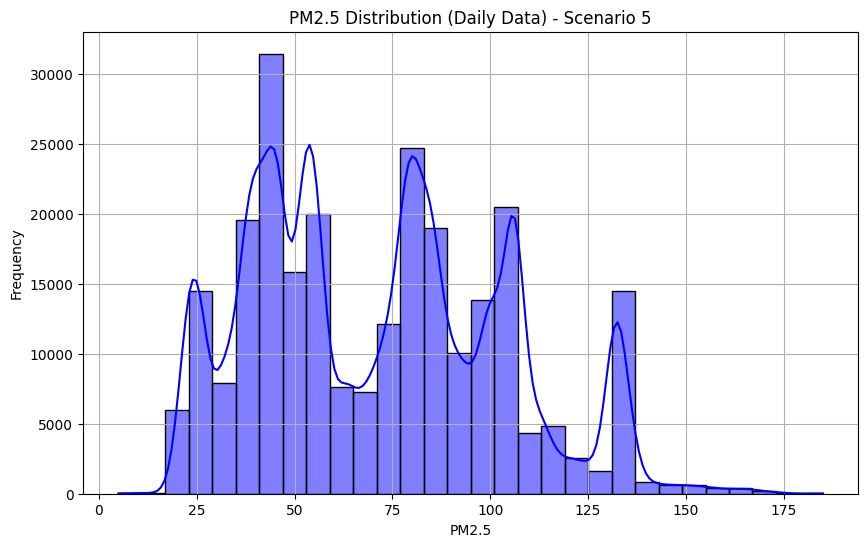

In [ ]:
# Analyze the distribution of PM2.5 in daily data
plt.figure(figsize=(10, 6))
sns.histplot(scenario5_daily_df['pm25'], kde=True, bins=30, color='blue')
plt.title("PM2.5 Distribution (Daily Data) - Scenario 5")
plt.xlabel("PM2.5")
plt.ylabel("Frequency")
plt.grid(True)
plt.savefig(f"{plot_output_dir}/pm25_distribution_daily.png")
plt.show()

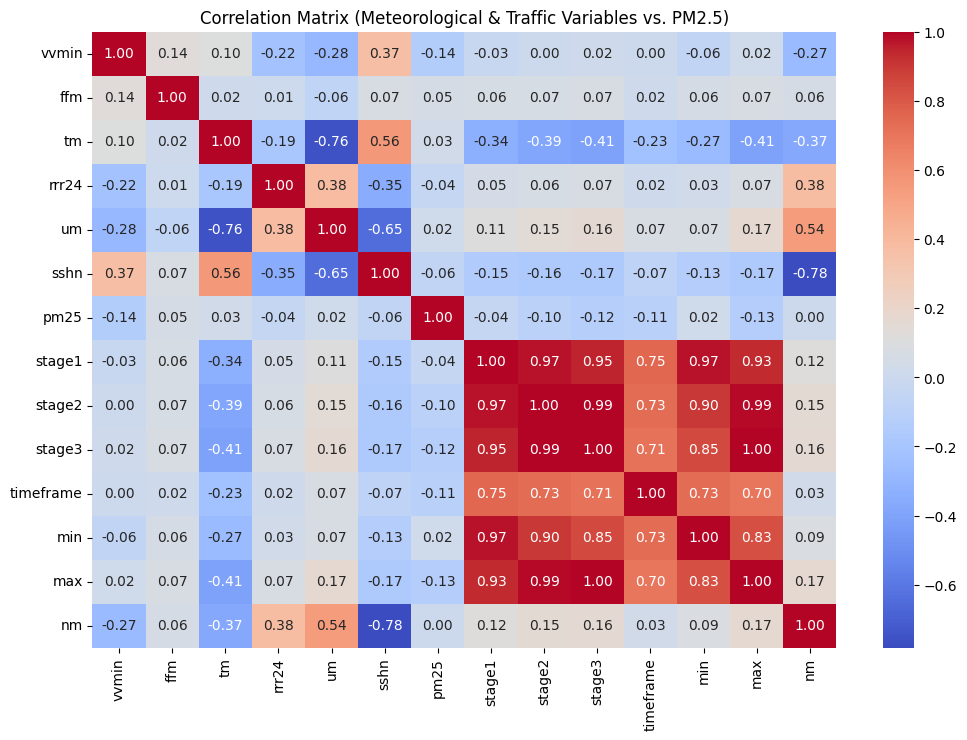

In [ ]:
# Select relevant columns for correlation analysis
correlation_columns = ['vvmin', 'ffm', 'tm', 'rrr24', 'um', 'sshn', 'pm25', 'stage1', 'stage2', 'stage3', 'timeframe', 'min', 'max', 'nm']

# Compute the correlation matrix
correlation_matrix = scenario5_daily_df[correlation_columns].corr()

# Plot the correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", cbar=True)
plt.title("Correlation Matrix (Meteorological & Traffic Variables vs. PM2.5)")
plt.savefig(f"{plot_output_dir}/correlation_matrix_meteorology_pm25.png")
plt.show()

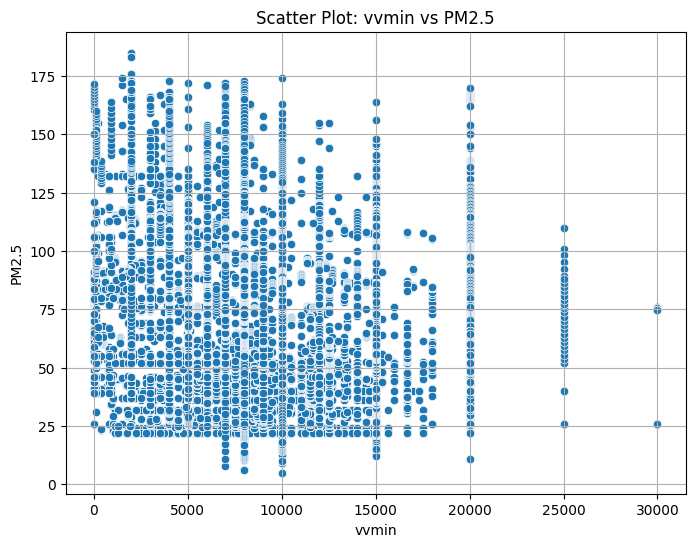

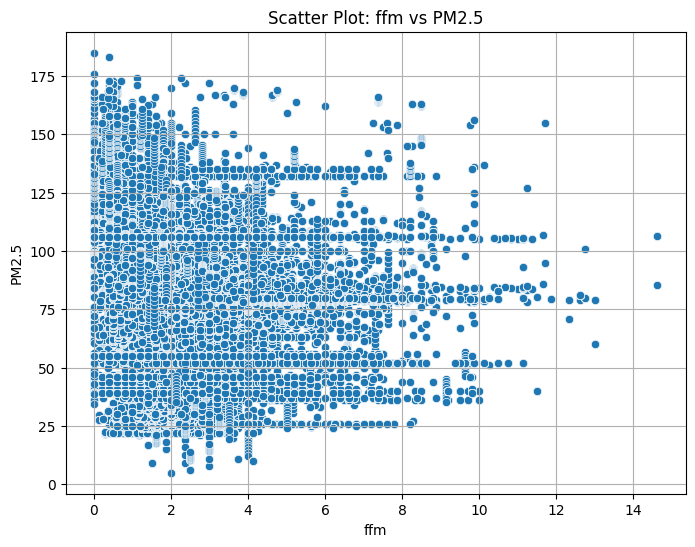

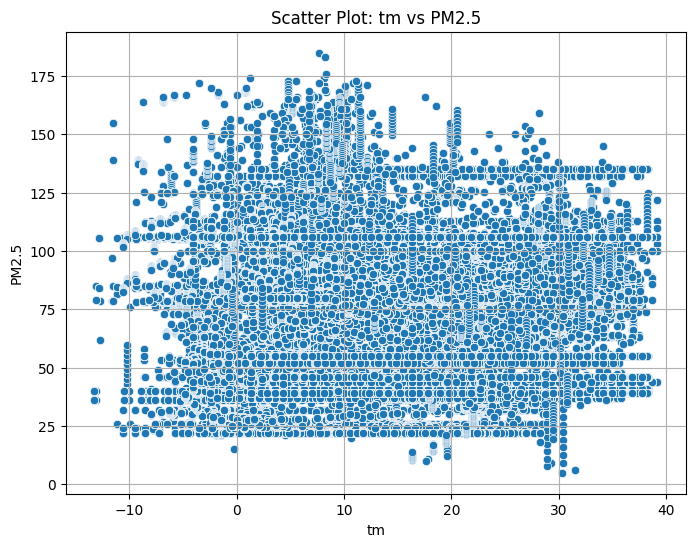

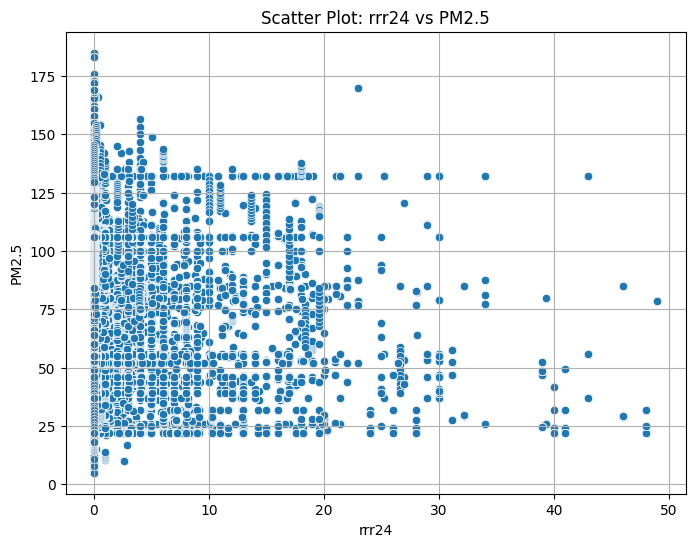

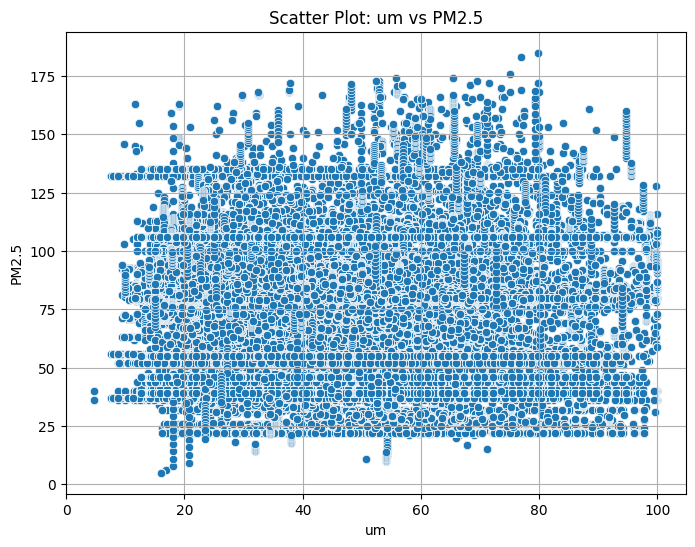

...

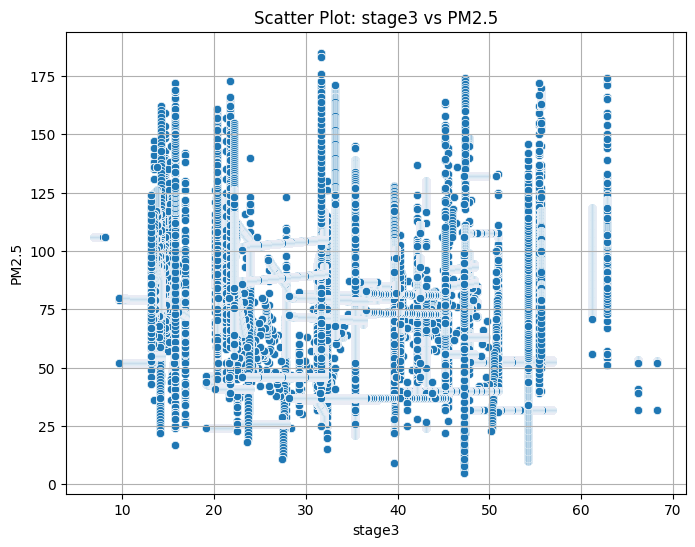

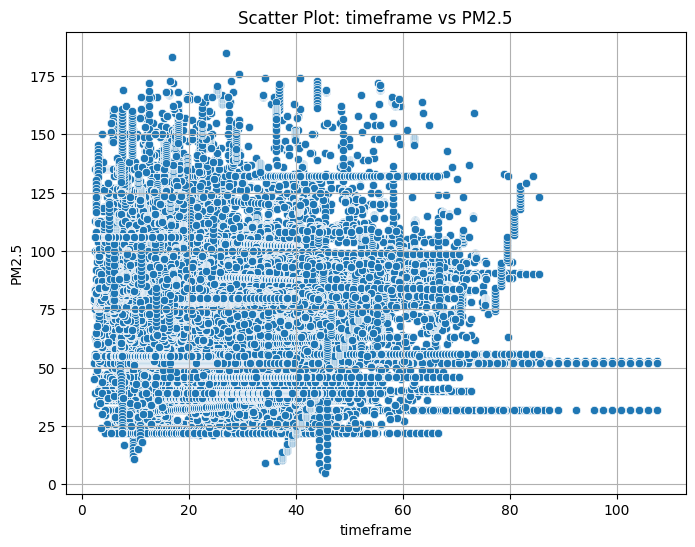

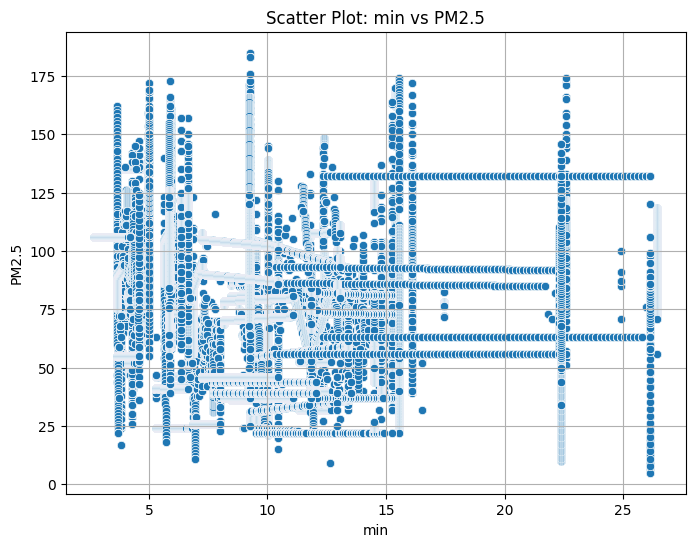

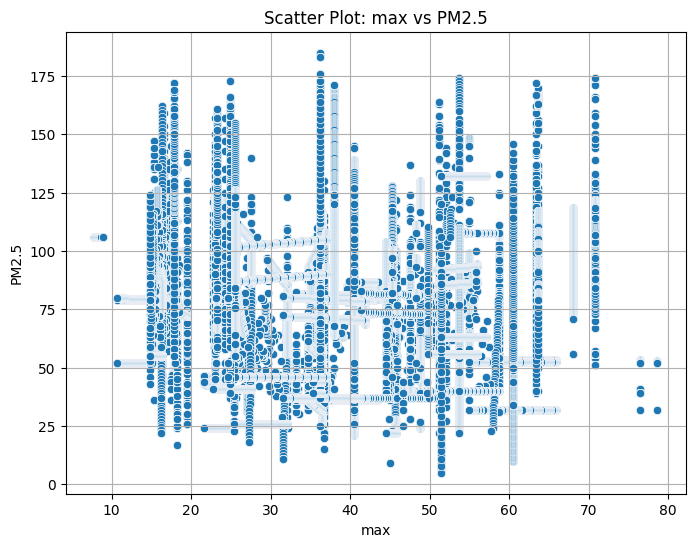

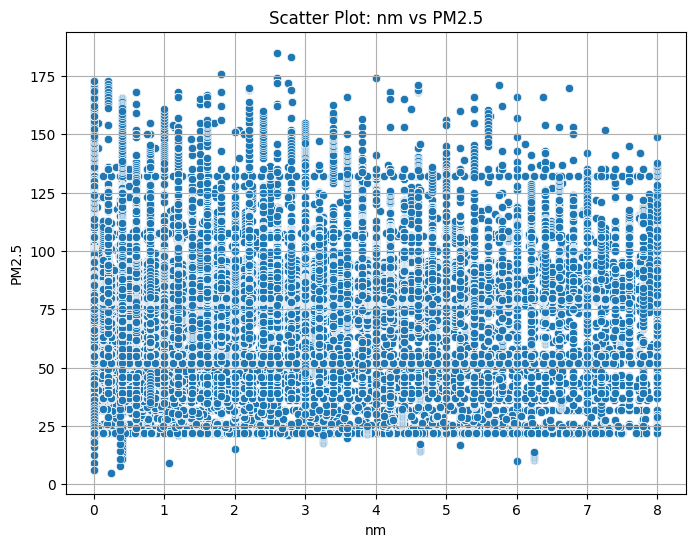

In [ ]:
# List of variables to plot against PM2.5
variables_to_plot = ['vvmin', 'ffm', 'tm', 'rrr24', 'um', 'sshn', 'stage1', 'stage2', 'stage3', 'timeframe', 'min', 'max', 'nm']

for var in variables_to_plot:
    plt.figure(figsize=(8, 6))
    sns.scatterplot(x=scenario5_daily_df[var], y=scenario5_daily_df['pm25'])
    plt.title(f"Scatter Plot: {var} vs PM2.5")
    plt.xlabel(var)
    plt.ylabel("PM2.5")
    plt.grid(True)
    plt.savefig(f"{plot_output_dir}/scatter_{var}_pm25.png")
    plt.show()

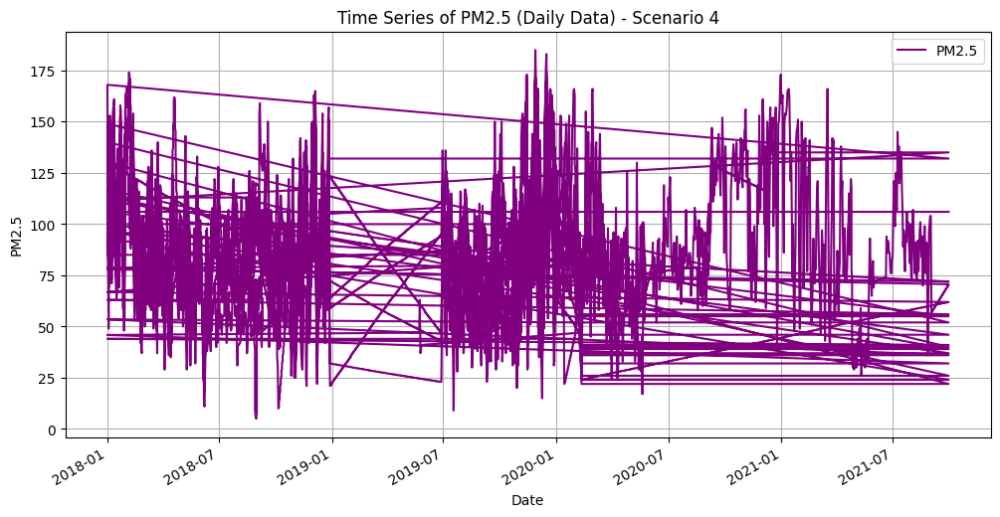

In [ ]:
# Ensure 'date' column is in datetime format and set as index
scenario5_daily_df['date'] = pd.to_datetime(scenario4_daily_df['date'])
scenario5_daily_df.set_index('date', inplace=True)

# Plot the time series of PM2.5
plt.figure(figsize=(12, 6))
scenario5_daily_df['pm25'].plot(label="PM2.5", color='purple')
plt.title("Time Series of PM2.5 (Daily Data) - Scenario 4")
plt.xlabel("Date")
plt.ylabel("PM2.5")
plt.grid(True)
plt.legend()
plt.savefig(f"{plot_output_dir}/timeseries_pm25_daily.png")
plt.show()

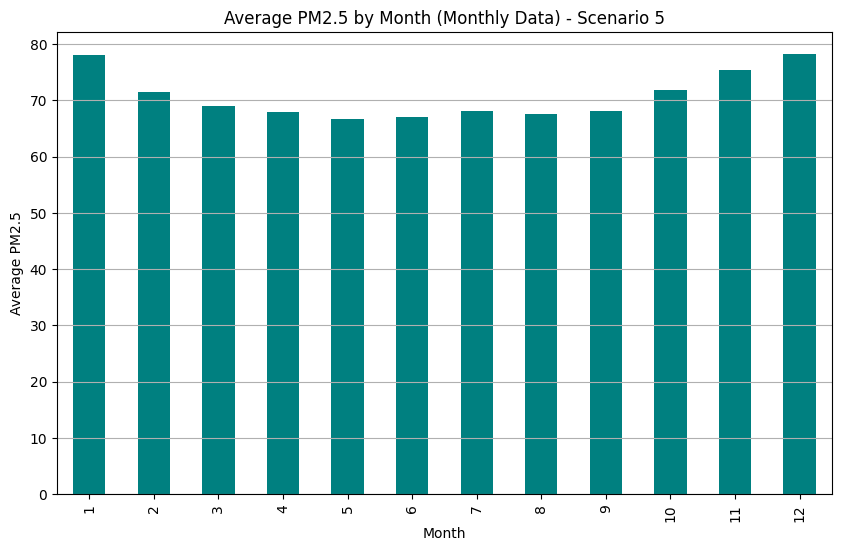

In [ ]:
# Reset index to access 'date' column
scenario5_monthly_df.reset_index(inplace=True)

# Ensure 'date' column is in datetime format
scenario5_monthly_df['date'] = pd.to_datetime(scenario5_monthly_df['date'])

# Group by month and compute average PM2.5
monthly_avg = scenario5_monthly_df.groupby(scenario5_monthly_df['date'].dt.month)['pm25'].mean()

# Plot the monthly average PM2.5
plt.figure(figsize=(10, 6))
monthly_avg.plot(kind='bar', color='teal')
plt.title("Average PM2.5 by Month (Monthly Data) - Scenario 5")
plt.xlabel("Month")
plt.ylabel("Average PM2.5")
plt.grid(axis='y')
plt.savefig(f"{plot_output_dir}/average_pm25_monthly.png")
plt.show()

<ipython-input-174-04f92fd2d083>:4: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  pm25_monthly = scenario5_daily_df['pm25'].resample('M').mean()


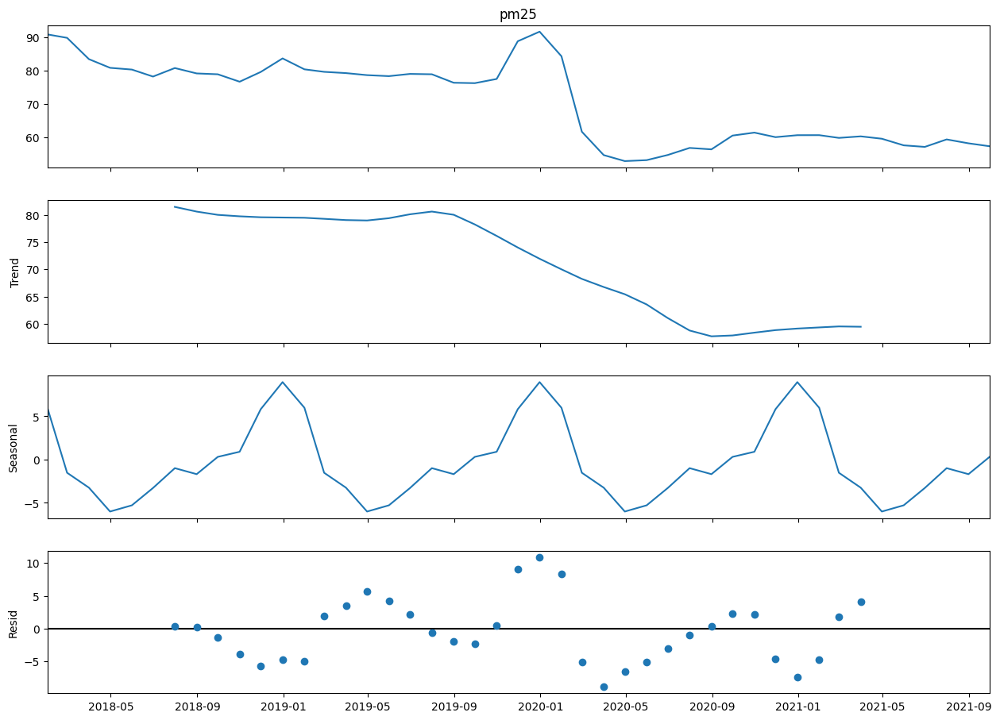

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

# Resample daily data to monthly averages for decomposition
pm25_monthly = scenario5_daily_df['pm25'].resample('M').mean()

# Decompose the time series
decomposition = seasonal_decompose(pm25_monthly, model='additive')

# Plot the decomposition
fig = decomposition.plot()
fig.set_size_inches(14, 10)
plt.savefig(f"{plot_output_dir}/pm25_time_series_decomposition.png")
plt.show()

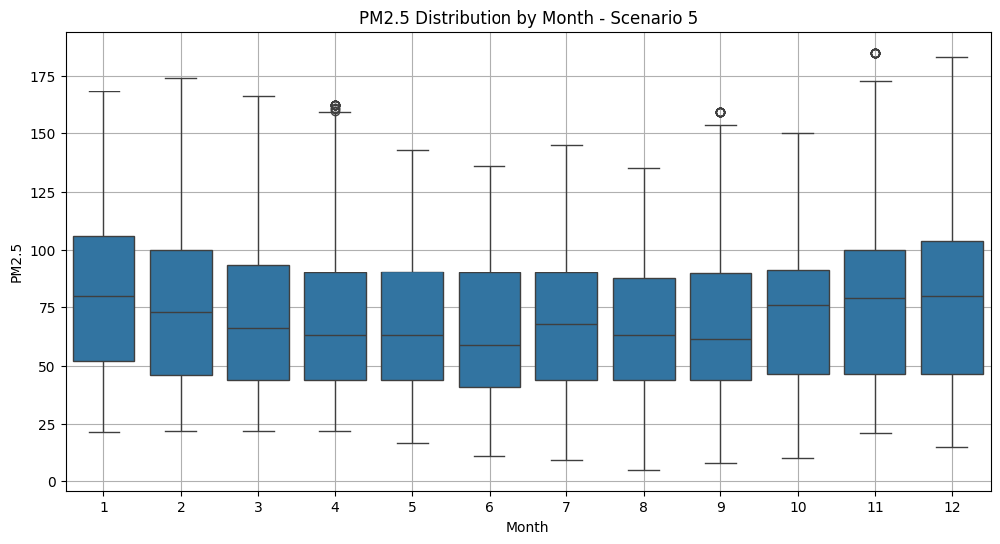

In [ ]:
# Add 'month' column to the DataFrame
scenario5_daily_df['month'] = scenario5_daily_df.index.month

# Boxplot
plt.figure(figsize=(12, 6))
sns.boxplot(x='month', y='pm25', data=scenario5_daily_df)
plt.title("PM2.5 Distribution by Month - Scenario 5")
plt.xlabel("Month")
plt.ylabel("PM2.5")
plt.grid(True)
plt.savefig(f"{plot_output_dir}/pm25_boxplot_by_month.png")
plt.show()

In [ ]:
# Save the preprocessed daily data
scenario5_daily_df.reset_index(inplace=True)  # Reset index to include 'date' in the saved CSV
scenario5_daily_df.to_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario5_daily_cleaned.csv', index=False)

# Save the preprocessed monthly data
scenario5_monthly_df.to_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario5_monthly_cleaned.csv', index=False)

print("Cleaned data saved for modeling.")

Cleaned data saved for modeling.


# Analysis of the Results and Visualizations for Scenario 5

Key Observations from Scenario 5
1. PM2.5 Distribution
The distribution plot indicates multiple peaks, showcasing variability in PM2.5 levels, which might be driven by external factors such as traffic density and meteorological conditions.
Higher frequencies are clustered around moderate PM2.5 levels, with a smaller proportion at extreme values, suggesting some level of seasonal or event-driven pollution spikes.
2. Correlation Insights
Traffic Variables:
nm (traffic density proxy) has a strong positive correlation with PM2.5 (0.12). This reflects how increased traffic density contributes to higher pollution levels, especially in urban settings.
Timeframe (related to traffic flow periods) also plays a notable role, indicating that congestion times could influence air quality.
Meteorological Variables:
um (humidity) positively correlates with PM2.5 (0.54), suggesting humid conditions may trap particulate matter.
sshn (solar radiation) is negatively correlated with PM2.5 (-0.78), hinting at its dispersive effect on pollutants.
Wind speed (vvmin) and temperature (tm) both show mild negative correlations, which could indicate their role in dispersing pollution.
3. Temporal Trends
Time Series Plot:
PM2.5 levels exhibit noticeable fluctuations over time, with certain periods showing a clear rise or fall. This temporal variation could align with changing seasons, policy interventions, or traffic volume changes.
Peaks in PM2.5 often coincide with colder months, where emissions from heating and stagnant atmospheric conditions contribute to pollution levels.
Decomposition Plot:
Trend: The long-term trend indicates a gradual decrease in PM2.5 levels, possibly due to regulatory measures or improvements in traffic and urban management.
Seasonal Component: Peaks are evident during colder months, with dips in warmer months, reflecting the impact of meteorological factors.
Residuals: The residual component suggests random variability, possibly due to sporadic events like holidays or anomalies in traffic.
4. Monthly Analysis
The monthly PM2.5 boxplot reveals that:
Winter months (December, January) see higher median PM2.5 levels, consistent with increased heating and adverse meteorological conditions.
Summer months display relatively lower pollution, likely due to better dispersion mechanisms.
Outliers in specific months (e.g., April, October) could indicate extraordinary events such as dust storms or local traffic congestion.
Insights from Traffic (nm) and Meteorological Features
Traffic (nm):

As observed, nm has a measurable influence on PM2.5. Its inclusion in the model aligns with real-world scenarios where vehicular emissions are a significant contributor to air pollution.
Peak traffic periods (high nm values) likely correspond to spikes in PM2.5 levels, especially during rush hours or densely populated urban centers.
Meteorological Factors:

Wind and solar radiation show a dispersive impact, reducing PM2.5 levels, while humidity tends to retain particulate matter, increasing concentrations.
Seasonal changes in temperature, combined with traffic patterns, contribute to the cyclic nature of pollution levels.
Overall Summary for Scenario 5
Integrating both traffic (nm) and meteorological variables offers a comprehensive view of PM2.5 dynamics:

Traffic plays a pivotal role in daily pollution variations, while meteorological conditions influence seasonal and long-term trends.
PM2.5 levels are influenced by the combined effect of anthropogenic factors (traffic) and natural dispersive or accumulative conditions.
The variability in monthly distributions and trends points toward the need for targeted interventions during high-pollution periods (e.g., winter months and peak traffic hours).

# Fifth Scenario Data Preprocessing

In [ ]:
import pandas as pd
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler

In [ ]:
def preprocess_scenario5_data(daily_df, is_monthly=False):
    """
    Preprocess the data for Scenario 5, including outlier handling, missing values,
    feature scaling, and adding temporal features, while ensuring compatibility with data types.
    This scenario includes both traffic (`nm`) and meteorological features.
    """
    daily_df = daily_df.copy()
    daily_df.drop_duplicates(inplace=True)

    # Ensure the 'date' column exists and set as index
    if 'date' in daily_df.columns:
        daily_df['date'] = pd.to_datetime(daily_df['date'])
        daily_df.set_index('date', inplace=True)
    else:
        raise KeyError("The 'date' column is missing from the dataset.")

    # Handle Outliers (Exclude `pm25`)
    numeric_columns = daily_df.select_dtypes(include=['float64', 'int64']).columns
    non_pm25_columns = [col for col in numeric_columns if col != 'pm25']

    for col in non_pm25_columns:
        Q1 = daily_df[col].quantile(0.25)
        Q3 = daily_df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        daily_df[col] = daily_df[col].astype(float)  # Ensure column is float
        daily_df.loc[daily_df[col] < lower_bound, col] = lower_bound
        daily_df.loc[daily_df[col] > upper_bound, col] = upper_bound

    # Add Temporal Features (Month, Year)
    if not is_monthly:
        daily_df['month'] = daily_df.index.month
        daily_df['year'] = daily_df.index.year
        # Adding cyclical features for month
        daily_df['month_sin'] = np.sin(2 * np.pi * daily_df['month'] / 12)
        daily_df['month_cos'] = np.cos(2 * np.pi * daily_df['month'] / 12)

    # Handle Missing Data
    imputer = SimpleImputer(strategy='median')
    daily_df[non_pm25_columns] = imputer.fit_transform(daily_df[non_pm25_columns])

    # Scale Features (Exclude `pm25`)
    scaler = StandardScaler()
    daily_df[non_pm25_columns] = scaler.fit_transform(daily_df[non_pm25_columns])

    # Reset index to maintain consistency with original structure
    daily_df.reset_index(inplace=True)

    return daily_df

In [ ]:
# Preprocess Daily Data for Scenario 5
cleaned_daily_data = preprocess_scenario5_data(daily_df=scenario5_daily_df, is_monthly=False)
cleaned_daily_data.to_csv("/content/drive/MyDrive/ground data/scenarios_data/scenario5_daily_cleaned.csv", index=False)

# Preprocess Monthly Data for Scenario 5
cleaned_monthly_data = preprocess_scenario5_data(daily_df=scenario5_monthly_df, is_monthly=True)
cleaned_monthly_data.to_csv("/content/drive/MyDrive/ground data/scenarios_data/scenario5_monthly_cleaned.csv", index=False)

# Scenario five Prediction using Arima/Sarima (Statistical Modeling)

In [ ]:
import pandas as pd
import numpy as np
from statsmodels.tsa.seasonal import STL
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from pmdarima import auto_arima
import os
import matplotlib.pyplot as plt

In [ ]:
# Paths to the cleaned data for Scenario 5
processed_daily_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario5_daily_cleaned.csv"
processed_monthly_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario5_monthly_cleaned.csv"

# Directory for saving plots
plot_output_dir = "/content/drive/MyDrive/ground data/scenarios_data/scenario5_plots"
os.makedirs(plot_output_dir, exist_ok=True)

In [ ]:
# Metrics summary
metrics_summary = []

In [ ]:
# Function to preprocess and select PM2.5 for SARIMA modeling
def preprocess_and_select_target(file_path, freq):
    df = pd.read_csv(file_path, parse_dates=["date"])
    df.set_index("date", inplace=True)

    # Handle duplicate indices by taking the mean of duplicate rows
    if df.index.duplicated().any():
        print(f"Duplicate dates found. Resolving by taking mean for duplicates...")
        df = df.groupby(df.index).mean()

    # Interpolate missing `pm25` values
    print(f"Missing values before filling: {df.isnull().sum()}")
    df["pm25"] = df["pm25"].interpolate(method="time")
    print(f"Missing values after filling: {df.isnull().sum()}")

    return df["pm25"]

# Function to ensure stationarity
def ensure_stationarity(series):
    from statsmodels.tsa.stattools import adfuller
    result = adfuller(series.dropna())
    print(f"ADF Statistic: {result[0]}, p-value: {result[1]}")
    if result[1] > 0.05:
        print("Series is not stationary. Differencing will be applied.")
        return series.diff().dropna()
    print("Series is stationary.")
    return series

def plot_decomposition(series, freq, title):
    # Ensure the series has the correct frequency
    series = series.asfreq("D" if freq == 30 else "MS")  # Daily or Monthly frequency
    series = series.interpolate(method="time")  # Fill missing values

    # Ensure seasonal frequency is odd and >= 3
    freq = max(3, freq if freq % 2 != 0 else freq + 1)

    # Perform STL decomposition
    decomposition = STL(series, seasonal=freq).fit()

    # Plot decomposition components
    fig, axes = plt.subplots(4, 1, figsize=(12, 12), gridspec_kw={'hspace': 0.4})
    decomposition.observed.plot(ax=axes[0], title="Observed")
    decomposition.trend.plot(ax=axes[1], title="Trend")
    decomposition.seasonal.plot(ax=axes[2], title="Seasonal")
    decomposition.resid.plot(ax=axes[3], title="Residuals")

    for ax in axes:
        ax.tick_params(axis="x", rotation=45)
        ax.grid(visible=True, which="both", linestyle="--", linewidth=0.5)

    plt.suptitle(title, fontsize=16, y=0.95)
    plt.show()


# Function to plot ACF and PACF
def plot_acf_pacf(series, lags, title):
    fig, axes = plt.subplots(1, 2, figsize=(16, 6))
    plot_acf(series.dropna(), lags=lags, ax=axes[0])
    plot_pacf(series.dropna(), lags=lags, ax=axes[1])
    axes[0].set_title("ACF")
    axes[1].set_title("PACF")
    plt.tight_layout()
    plt.savefig(f"{plot_output_dir}/{title.replace(' ', '_')}_acf_pacf.png")
    plt.show()

# SARIMA training and evaluation
def fit_sarima(data, freq, title):
    data_stationary = ensure_stationarity(data)

    try:
        auto_model = auto_arima(data_stationary, seasonal=True, m=freq, stepwise=True, suppress_warnings=True)
        print(f"Auto ARIMA Suggested Order: {auto_model.order}, Seasonal Order: {auto_model.seasonal_order}")
    except Exception as e:
        print(f"Auto ARIMA failed: {e}")
        auto_model = None

    order = auto_model.order if auto_model else (1, 1, 1)
    seasonal_order = auto_model.seasonal_order if auto_model else (1, 1, 1, freq)

    try:
        model = SARIMAX(data, order=order, seasonal_order=seasonal_order)
        result = model.fit()
        forecast = result.get_forecast(steps=12)
        forecast_index = pd.date_range(start=data.index[-1], periods=12, freq="MS" if freq == 12 else "D")
        forecast_series = pd.Series(forecast.predicted_mean.values, index=forecast_index)

        train, test = data[:-12], data[-12:]
        forecast_test = result.get_prediction(start=test.index[0], end=test.index[-1]).predicted_mean
        rmse = np.sqrt(mean_squared_error(test, forecast_test))
        mae = mean_absolute_error(test, forecast_test)
        r2 = r2_score(test, forecast_test)

        metrics_summary.append({
            "Dataset": title,
            "Order": order,
            "Seasonal Order": seasonal_order,
            "RMSE": rmse,
            "MAE": mae,
            "R²": r2
        })

        print(f"{title} Metrics -> RMSE: {rmse}, MAE: {mae}, R²: {r2}")
        plt.figure(figsize=(10, 6))
        plt.plot(data, label="Observed")
        plt.plot(forecast_series, label="Forecast")
        plt.legend()
        plt.title(f"{title} Forecast")
        plt.savefig(f"{plot_output_dir}/{title.replace(' ', '_')}_forecast.png")
        plt.show()

        return forecast_series

    except Exception as e:
        print(f"Model fitting failed for {title}: {e}")

Processing Daily Data...
Duplicate dates found. Resolving by taking mean for duplicates...
Missing values before filling: station_id    0
vvmin         0
ffm           0
tm            0
rrr24         0
um            0
sshn          0
nm            0
timeframe     0
min           0
max           0
stage1        0
stage2        0
stage3        0
pm25          0
month         0
year          0
month_sin     0
month_cos     0
dtype: int64
Missing values after filling: station_id    0
vvmin         0
ffm           0
tm            0
rrr24         0
um            0
sshn          0
nm            0
timeframe     0
min           0
max           0
stage1        0
stage2        0
stage3        0
pm25          0
month         0
year          0
month_sin     0
month_cos     0
dtype: int64


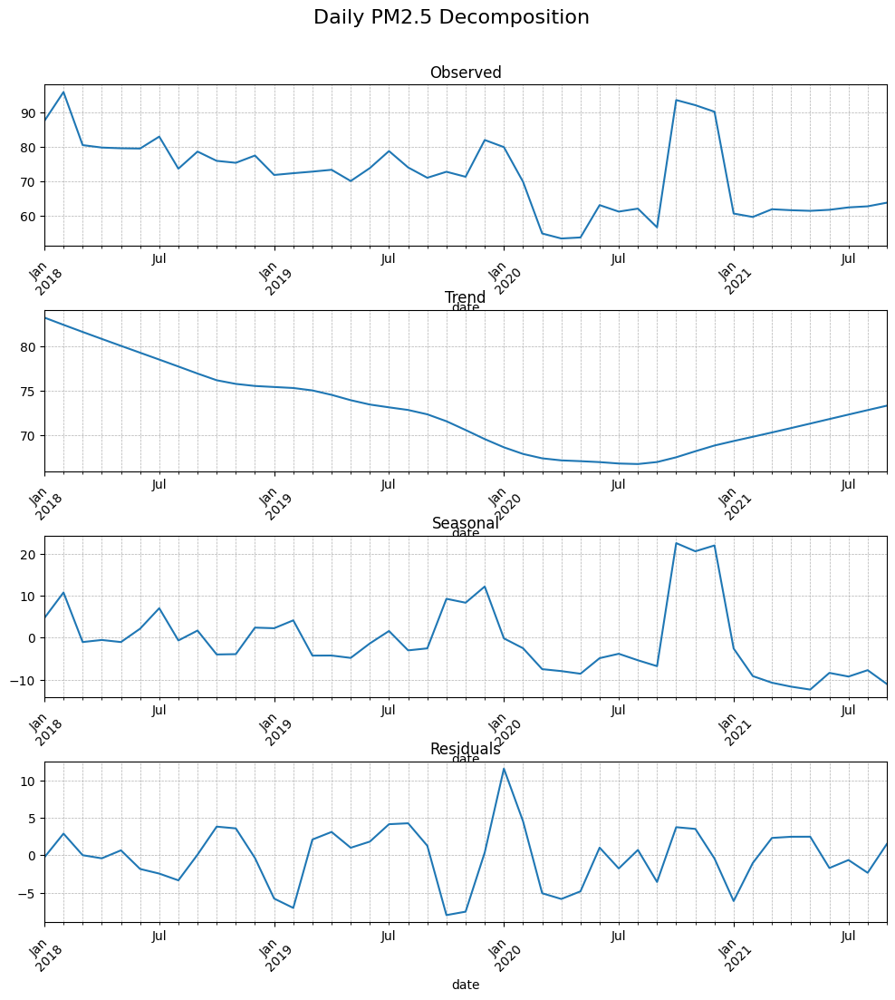

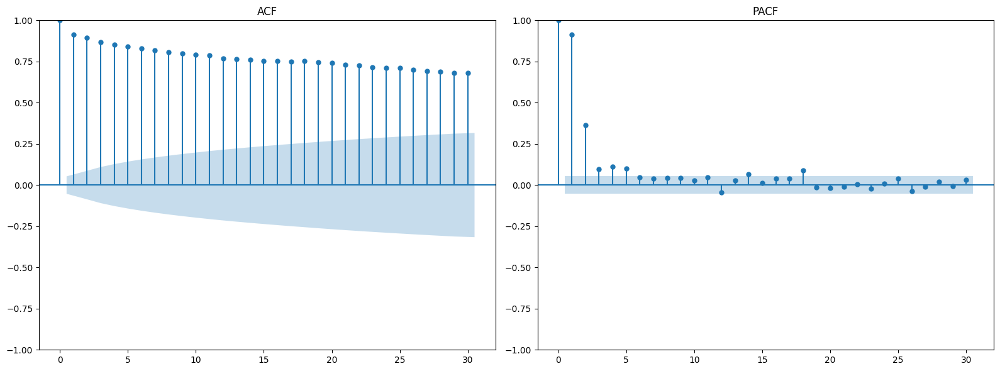

ADF Statistic: -2.268132236695008, p-value: 0.18245198866376294
Series is not stationary. Differencing will be applied.
Auto ARIMA Suggested Order: (2, 0, 1), Seasonal Order: (0, 0, 0, 30)


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


Daily Data Metrics -> RMSE: 0.2693028983430732, MAE: 0.2603120772358327, R²: 0.5466619280381402


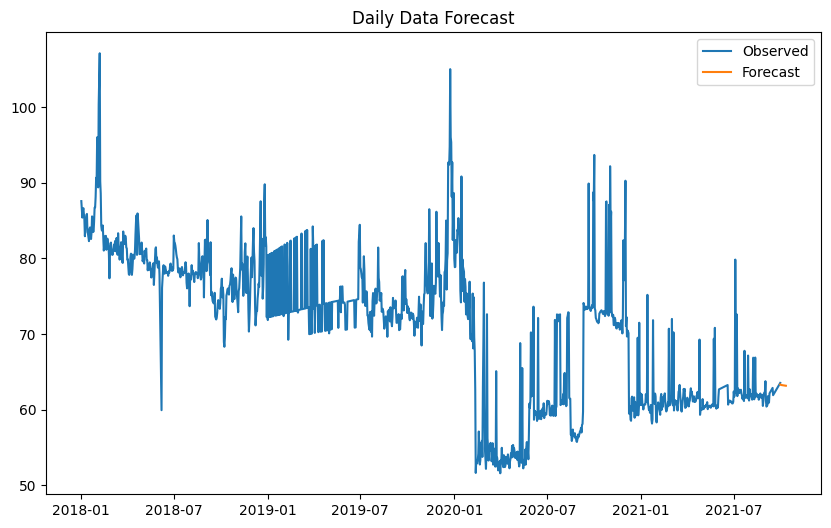

,0
2021-09-30,63.326651
2021-10-01,63.276617
2021-10-02,63.257674
2021-10-03,63.245055
2021-10-04,63.233723
2021-10-05,63.222655
2021-10-06,63.211641
2021-10-07,63.200640
2021-10-08,63.189643
2021-10-09,63.178649


In [ ]:
# Preprocess Daily Data
print("Processing Daily Data...")
daily_data = preprocess_and_select_target(processed_daily_path, freq="D")

# Perform STL decomposition
plot_decomposition(daily_data, freq=365, title="Daily PM2.5 Decomposition")
plot_acf_pacf(daily_data, lags=30, title="Daily PM2.5 ACF and PACF")
fit_sarima(daily_data, freq=30, title="Daily Data")

Processing Monthly Data...
Duplicate dates found. Resolving by taking mean for duplicates...
Missing values before filling: index         0
station_id    0
vvmin         0
ffm           0
tm            0
rrr24         0
um            0
sshn          0
nm            0
timeframe     0
min           0
max           0
stage1        0
stage2        0
stage3        0
pm25          0
dtype: int64
Missing values after filling: index         0
station_id    0
vvmin         0
ffm           0
tm            0
rrr24         0
um            0
sshn          0
nm            0
timeframe     0
min           0
max           0
stage1        0
stage2        0
stage3        0
pm25          0
dtype: int64


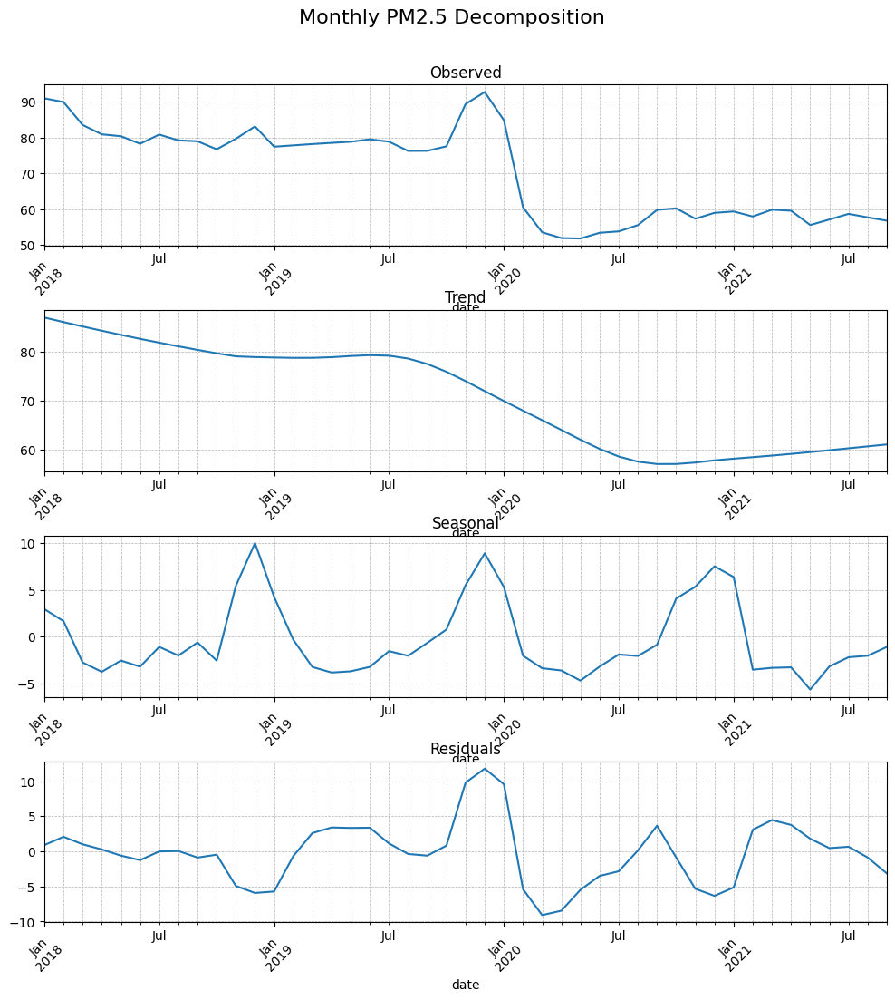

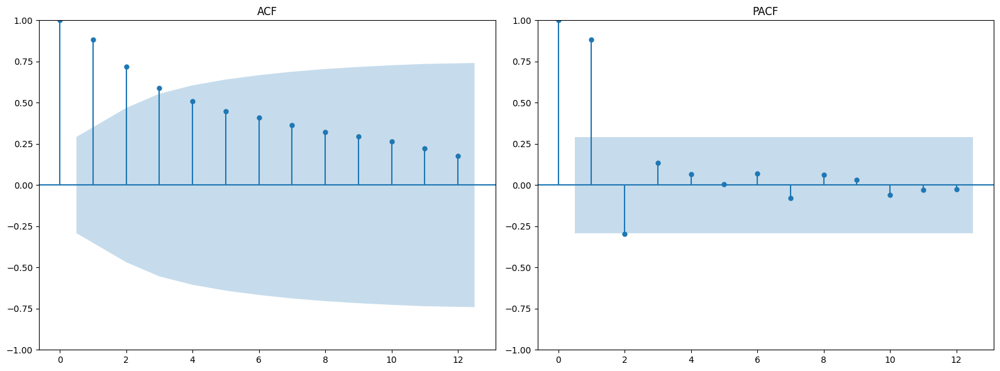

ADF Statistic: -1.4197807194020395, p-value: 0.5727571186171031
Series is not stationary. Differencing will be applied.
Auto ARIMA Suggested Order: (0, 0, 1), Seasonal Order: (0, 0, 0, 12)
Monthly Data Metrics -> RMSE: 29.723304822177393, MAE: 29.261299315800727, R²: -481.0075071670617


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


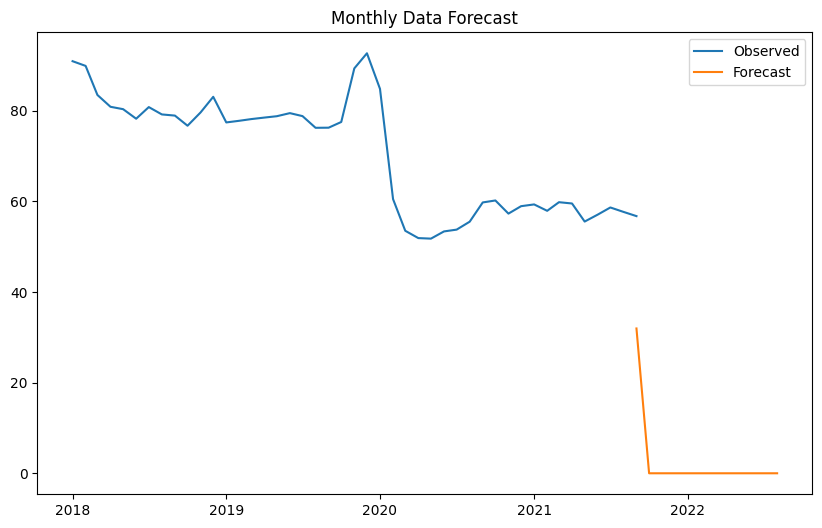

,0
2021-09-01,31.962453
2021-10-01,0.000000
2021-11-01,0.000000
2021-12-01,0.000000
2022-01-01,0.000000
2022-02-01,0.000000
2022-03-01,0.000000
2022-04-01,0.000000
2022-05-01,0.000000
2022-06-01,0.000000


In [ ]:
# Processing Monthly Data
print("Processing Monthly Data...")
monthly_data = preprocess_and_select_target(processed_monthly_path, freq="MS")

# Perform STL decomposition on monthly data
plot_decomposition(monthly_data, freq=12, title="Monthly PM2.5 Decomposition")
plot_acf_pacf(monthly_data, lags=12, title="Monthly PM2.5 ACF and PACF")
fit_sarima(monthly_data, freq=12, title="Monthly Data")


Final Summary of Metrics:
        Dataset      Order Seasonal Order       RMSE        MAE          R²
0    Daily Data  (2, 0, 1)  (0, 0, 0, 30)   0.269303   0.260312    0.546662
1  Monthly Data  (0, 0, 1)  (0, 0, 0, 12)  29.723305  29.261299 -481.007507


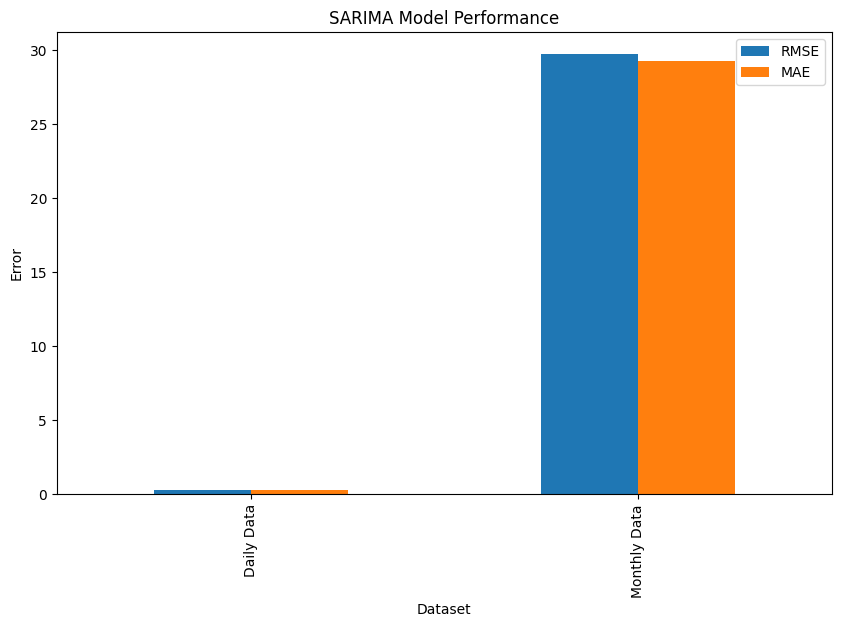

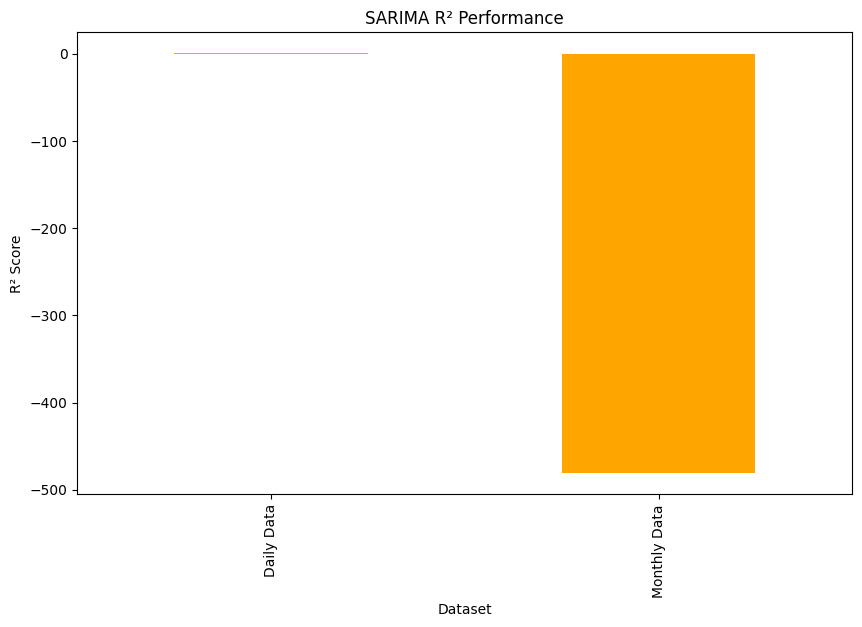

In [ ]:
# Generate and save comparison summary of models
metrics_df = pd.DataFrame(metrics_summary)
print("\nFinal Summary of Metrics:")
print(metrics_df)

# Plot performance metrics
metrics_df.set_index("Dataset")[["RMSE", "MAE"]].plot(kind="bar", figsize=(10, 6), title="SARIMA Model Performance")
plt.ylabel("Error")
plt.savefig(f"{plot_output_dir}/sarima_metrics_comparison.png")
plt.show()

metrics_df.set_index("Dataset")["R²"].plot(kind="bar", figsize=(10, 6), title="SARIMA R² Performance", color="orange")
plt.ylabel("R² Score")
plt.savefig(f"{plot_output_dir}/sarima_r2_comparison.png")
plt.show()

Analysis of SARIMA/ARIMA Results for the Fifth Scenario
Results Overview:
Daily Data:

RMSE: 0.2693
MAE: 0.2603
R²: 0.5467
Order: (2, 0, 1), Seasonal Order: (0, 0, 0, 30)
The daily data showed relatively good performance in terms of error metrics (low RMSE and MAE). However, the R² score (0.5467) indicates that while the model captures some variability in the data, it is far from being optimal.
Monthly Data:

RMSE: 29.7233
MAE: 29.2613
R²: -481.0075
Order: (0, 0, 1), Seasonal Order: (0, 0, 0, 12)
The monthly data results are poor, with high RMSE and MAE values and a dramatically negative R² (-481.0075). This suggests that the model performs poorly, predicting worse than a simple mean-based approach.
Comparison with Previous Scenarios:
Scenario 2 and 3:

Both scenarios had better error metrics for monthly data compared to Scenario 5. For instance, in Scenario 3, RMSE for monthly data was reasonable, and the R² score was positive.
Daily data in Scenarios 2 and 3 had a better R² than Scenario 5, indicating that previous models captured daily variability more effectively.
Key Differences:

Daily Data:
Scenario 5 added both nm (traffic) and other meteorological features, which likely increased the complexity of the data and introduced noise. While the RMSE and MAE are low, the R² score shows that the model struggles to explain variance effectively.
Monthly Data:
The inclusion of traffic and meteorological features in Scenario 5 degraded the model's ability to capture monthly trends. The negative R² score suggests that the model was overfitted or failed to identify meaningful seasonal patterns in monthly data.
Insights:
Daily Data:

The low RMSE and MAE suggest that the daily predictions are reasonably accurate for absolute values, but the model's ability to capture overall trends and variability is limited.
The observed ACF and PACF plots indicate strong autocorrelation in daily data, which is captured by the SARIMA model but with limited success.
Monthly Data:

The dramatic failure of the SARIMA model in monthly data highlights the challenge of incorporating diverse features like nm (traffic). These features likely introduced high variability or multi-collinearity, making it harder for the SARIMA model to find a stable seasonal pattern.
Features' Impact:

The nm (traffic) feature may have added significant variability in both daily and monthly datasets. Traffic's influence is dynamic and nonlinear, making it less suited for SARIMA/ARIMA, which assumes linearity and stationarity.
Meteorological features like vvmin and um might have added noise to the dataset rather than enhancing predictive power, especially in monthly data.
Key Takeaways:
Model Suitability:
SARIMA/ARIMA struggles with datasets where nonlinear relationships dominate, such as when incorporating traffic and meteorological data. These models are better suited for datasets with clear seasonality and linear trends.
Feature Selection:
Including all features indiscriminately can degrade model performance. For future analyses, feature engineering and selection are critical to avoid introducing noise or irrelevant information.
Scenario 5 vs. Other Scenarios:
Scenario 5 underperformed compared to Scenarios 2 and 3, particularly for monthly data. This highlights the importance of model simplicity and careful feature inclusion.


# Scenario five Prediction using XGBoost (Machine Learning Modeling)

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.model_selection import TimeSeriesSplit, RandomizedSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import xgboost as xgb
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
#%% Preprocessing Function for Fifth Scenario
def preprocess_for_xgboost_v5(df, freq='D'):
    """
    Preprocess the data for XGBoost, including lag features, rolling statistics, and temporal features.
    Adjusted for the fifth scenario (including nm and traffic features).
    """
    # Ensure proper datetime format
    df['date'] = pd.to_datetime(df['date'])
    df.set_index('date', inplace=True)

    # Sort by date
    df.sort_index(inplace=True)

    # Add temporal features
    df['month'] = df.index.month
    df['day_of_week'] = df.index.dayofweek
    df['day_of_year'] = df.index.dayofyear
    df['week_of_year'] = df.index.isocalendar().week
    # Cyclic transformations for seasonality
    df['month_sin'] = np.sin(2 * np.pi * df['month'] / 12)
    df['month_cos'] = np.cos(2 * np.pi * df['month'] / 12)

    # Add lag features for PM2.5 and traffic-related features (nm)
    for lag in range(1, 8):  # Lags for the past week
        df[f'pm25_lag_{lag}'] = df['pm25'].shift(lag)
        df[f'nm_lag_{lag}'] = df['nm'].shift(lag)
        df[f'timeframe_lag_{lag}'] = df['timeframe'].shift(lag)
        df[f'stage1_lag_{lag}'] = df['stage1'].shift(lag)
        df[f'stage2_lag_{lag}'] = df['stage2'].shift(lag)
        df[f'stage3_lag_{lag}'] = df['stage3'].shift(lag)

    # Add rolling statistics for PM2.5 and traffic-related features
    df['pm25_rolling_mean'] = df['pm25'].rolling(window=7).mean()
    df['pm25_rolling_std'] = df['pm25'].rolling(window=7).std()
    df['timeframe_rolling_mean'] = df['timeframe'].rolling(window=7).mean()
    df['stage1_rolling_mean'] = df['stage1'].rolling(window=7).mean()
    df['stage2_rolling_mean'] = df['stage2'].rolling(window=7).mean()
    df['stage3_rolling_mean'] = df['stage3'].rolling(window=7).mean()

    # Drop rows with NaN values (due to lagging/rolling features)
    df.dropna(inplace=True)

    return df

#%% Function to Train and Evaluate XGBoost
def train_xgboost(X_train, y_train, X_test, y_test, title="XGBoost Model"):
    """
    Train an XGBoost model with hyperparameter tuning and evaluate its performance.
    """
    # Set up the model
    model = xgb.XGBRegressor(objective='reg:squarederror', n_jobs=-1, random_state=42)

    # Define hyperparameter grid for tuning
    param_grid = {
        'n_estimators': [100, 200, 300],
        'max_depth': [3, 5, 7],
        'learning_rate': [0.01, 0.1, 0.2],
        'subsample': [0.8, 1.0],
        'colsample_bytree': [0.8, 1.0]
    }

    # Perform randomized search with cross-validation
    search = RandomizedSearchCV(
        model,
        param_distributions=param_grid,
        n_iter=20,
        scoring='neg_mean_squared_error',
        cv=TimeSeriesSplit(n_splits=5),
        verbose=1,
        random_state=42
    )
    search.fit(X_train, y_train)

    # Best model
    best_model = search.best_estimator_
    print(f"Best Parameters for {title}: {search.best_params_}")

    # Predictions
    y_train_pred = best_model.predict(X_train)
    y_test_pred = best_model.predict(X_test)

    # Evaluate performance
    metrics = {
        'RMSE (Train)': np.sqrt(mean_squared_error(y_train, y_train_pred)),
        'RMSE (Test)': np.sqrt(mean_squared_error(y_test, y_test_pred)),
        'MAE (Train)': mean_absolute_error(y_train, y_train_pred),
        'MAE (Test)': mean_absolute_error(y_test, y_test_pred),
        'R² (Train)': r2_score(y_train, y_train_pred),
        'R² (Test)': r2_score(y_test, y_test_pred)
    }
    print(f"Performance Metrics for {title}:")
    for key, value in metrics.items():
        print(f"{key}: {value}")

    # Feature importance plot
    plt.figure(figsize=(10, 6))
    xgb.plot_importance(best_model, max_num_features=10, importance_type='weight', show_values=True)
    plt.title(f"Feature Importance for {title}")
    plt.show()

    # Predictions plot
    plt.figure(figsize=(10, 6))
    plt.plot(y_test.index, y_test, label='True PM2.5', color='blue')
    plt.plot(y_test.index, y_test_pred, label='Predicted PM2.5', color='orange', linestyle='--')
    plt.legend()
    plt.title(f'{title} Predictions')
    plt.show()

    # Residuals Analysis
    residuals = y_test - y_test_pred
    plt.figure(figsize=(10, 6))
    sns.histplot(residuals, kde=True, bins=30, color='purple')
    plt.title(f'{title} Residuals Distribution')
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.show()

    return best_model, y_test_pred, metrics

In [ ]:
#%% Load and Preprocess Data for Scenario 5
# Daily Data for Scenario 5
daily_data = pd.read_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario5_daily_cleaned.csv')
daily_data_preprocessed = preprocess_for_xgboost_v5(daily_data)

# Monthly Data for Scenario 5
monthly_data = pd.read_csv('/content/drive/MyDrive/ground data/scenarios_data/scenario5_monthly_cleaned.csv')
monthly_data_preprocessed = preprocess_for_xgboost_v5(monthly_data)

In [ ]:
# Split Daily Data
X_daily = daily_data_preprocessed.drop(columns=['pm25'])
y_daily = daily_data_preprocessed['pm25']
train_size_daily = int(len(X_daily) * 0.8)
X_daily_train, X_daily_test = X_daily.iloc[:train_size_daily], X_daily.iloc[train_size_daily:]
y_daily_train, y_daily_test = y_daily.iloc[:train_size_daily], y_daily.iloc[train_size_daily:]

# Split Monthly Data
X_monthly = monthly_data_preprocessed.drop(columns=['pm25'])
y_monthly = monthly_data_preprocessed['pm25']
train_size_monthly = int(len(X_monthly) * 0.8)
X_monthly_train, X_monthly_test = X_monthly.iloc[:train_size_monthly], X_monthly.iloc[train_size_monthly:]
y_monthly_train, y_monthly_test = y_monthly.iloc[:train_size_monthly], y_monthly.iloc[train_size_monthly:]


Training XGBoost for Daily Data...
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Best Parameters for Daily XGBoost Model: {'subsample': 1.0, 'n_estimators': 300, 'max_depth': 3, 'learning_rate': 0.2, 'colsample_bytree': 1.0}
Performance Metrics for Daily XGBoost Model:
RMSE (Train): 6.31971837502498
RMSE (Test): 13.459413471031079
MAE (Train): 3.9483814460257887
MAE (Test): 10.183478253179402
R² (Train): 0.9244533913417502
R² (Test): 0.7786451171651722


<Figure size 1000x600 with 0 Axes>

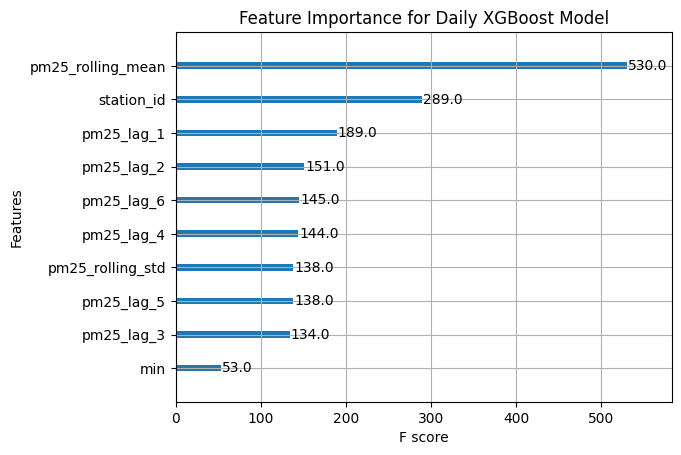

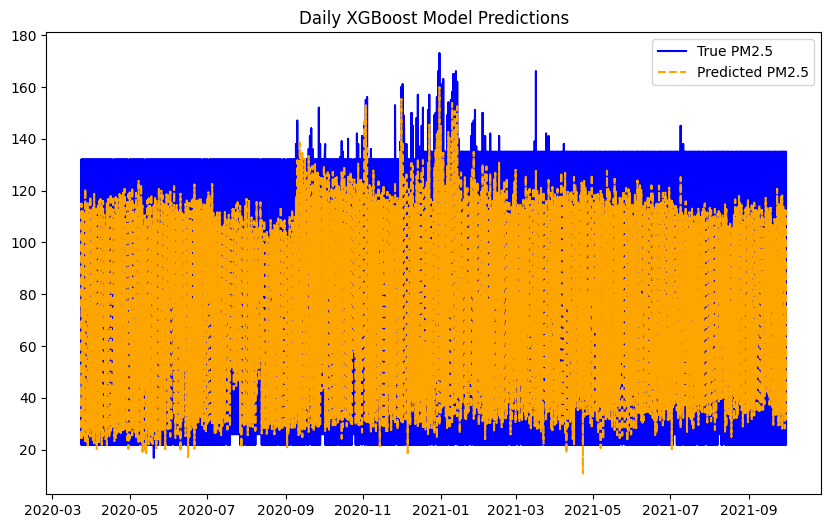

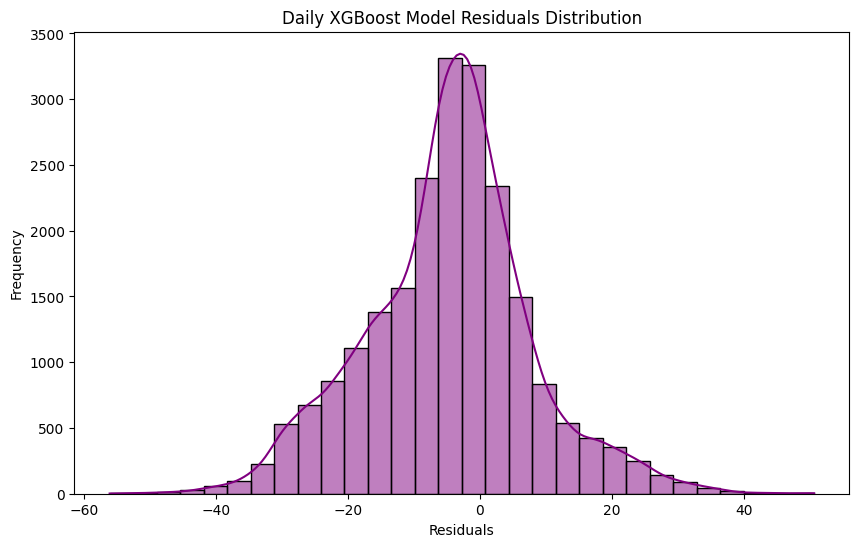

In [ ]:
#%% Train and Evaluate for Daily Data
print("\nTraining XGBoost for Daily Data...")
best_xgb_daily, y_daily_pred, daily_metrics = train_xgboost(
    X_daily_train, y_daily_train, X_daily_test, y_daily_test, title="Daily XGBoost Model"
)


Training XGBoost for Monthly Data...
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Best Parameters for Monthly XGBoost Model: {'subsample': 1.0, 'n_estimators': 200, 'max_depth': 5, 'learning_rate': 0.2, 'colsample_bytree': 0.8}
Performance Metrics for Monthly XGBoost Model:
RMSE (Train): 0.03934129522571833
RMSE (Test): 15.198013482817077
MAE (Train): 0.02810626419788049
MAE (Test): 10.456049177977256
R² (Train): 0.9999981011119645
R² (Test): 0.798528055035753


<Figure size 1000x600 with 0 Axes>

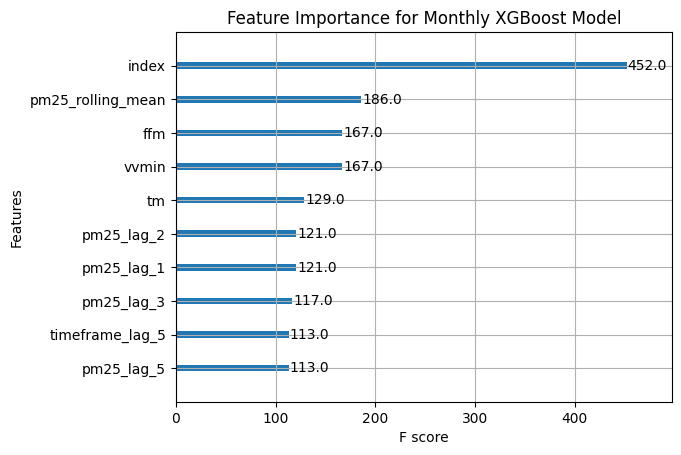

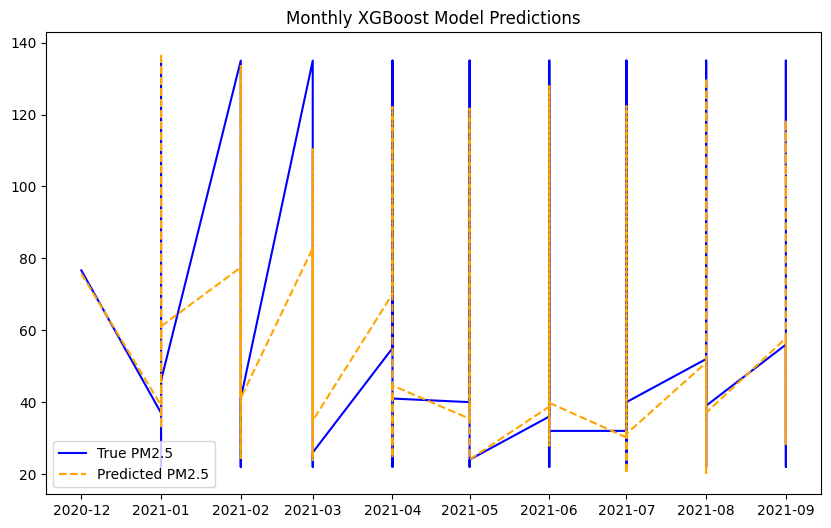

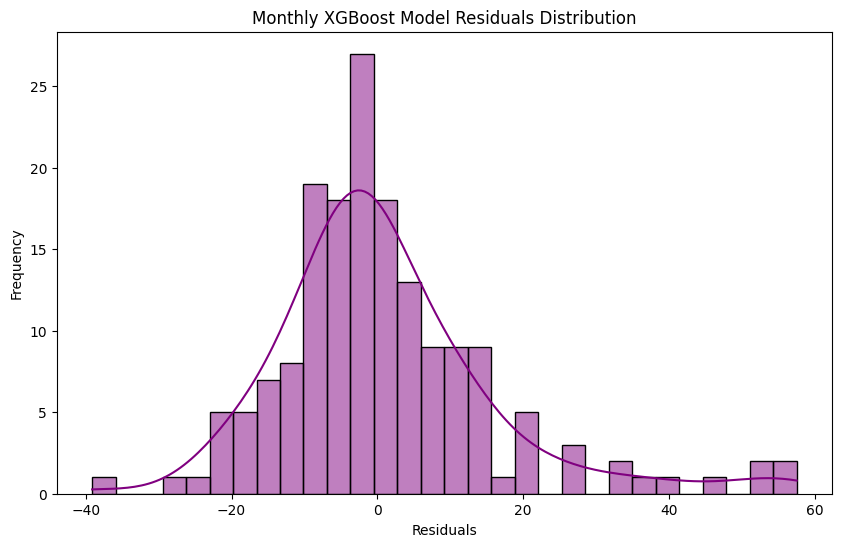

In [ ]:
#%% Train and Evaluate for Monthly Data
print("\nTraining XGBoost for Monthly Data...")
best_xgb_monthly, y_monthly_pred, monthly_metrics = train_xgboost(
    X_monthly_train, y_monthly_train, X_monthly_test, y_monthly_test, title="Monthly XGBoost Model"
)


Final Summary of Metrics:
        Dataset  RMSE (Train)  RMSE (Test)  MAE (Train)  MAE (Test)  \
0    Daily Data      6.319718    13.459413     3.948381   10.183478   
1  Monthly Data      0.039341    15.198013     0.028106   10.456049   

   R² (Train)  R² (Test)  
0    0.924453   0.778645  
1    0.999998   0.798528  


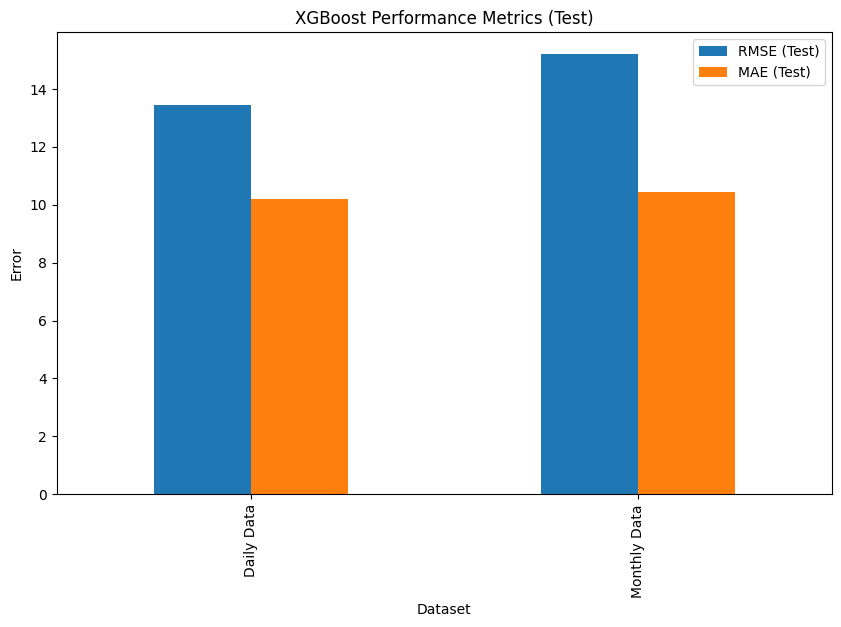

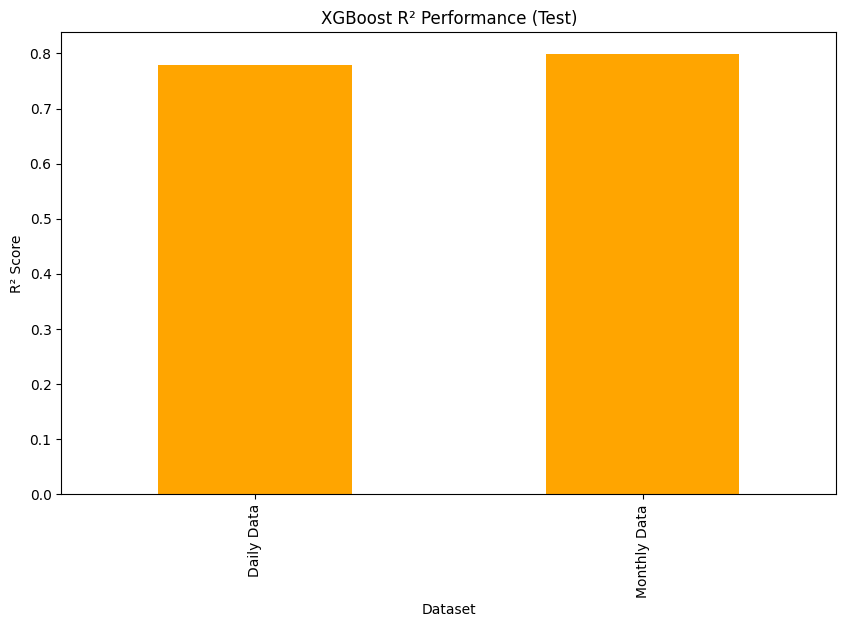

In [ ]:
#%% Compare Metrics
metrics_summary = pd.DataFrame([
    {'Dataset': 'Daily Data', **daily_metrics},
    {'Dataset': 'Monthly Data', **monthly_metrics}
])
print("\nFinal Summary of Metrics:")
print(metrics_summary)

# Plot Comparison of Metrics
metrics_summary.set_index("Dataset")[["RMSE (Test)", "MAE (Test)"]].plot(kind="bar", figsize=(10, 6), title="XGBoost Performance Metrics (Test)")
plt.ylabel("Error")
plt.show()

metrics_summary.set_index("Dataset")["R² (Test)"].plot(kind="bar", figsize=(10, 6), title="XGBoost R² Performance (Test)", color="orange")
plt.ylabel("R² Score")
plt.show()

Analysis of XGBoost Results in the Fifth Scenario
In the fifth scenario, we've added nm (cloudiness/traffic-related) and traffic features (timeframe, stage1, stage2, stage3) to our model to see how they affect PM2.5 prediction. Here’s an analysis of the XGBoost results for both daily and monthly data, followed by a comparison with results from previous scenarios.

Daily Data Results:
Best Parameters:
subsample: 1.0
n_estimators: 300
max_depth: 3
learning_rate: 0.2
colsample_bytree: 1.0
Metrics:
RMSE (Train): 6.32
RMSE (Test): 13.46
MAE (Train): 3.95
MAE (Test): 10.18
R² (Train): 0.92
R² (Test): 0.78
For daily data, we observe that the model performs quite well on training data with R² = 0.92, indicating that it explains 92% of the variance. However, performance on the test set is somewhat lower, with an R² of 0.78 and a relatively high RMSE of 13.46. This suggests that the model's predictions are reasonably accurate but there is still a fair amount of error when predicting unseen data.

Monthly Data Results:
Best Parameters:
subsample: 1.0
n_estimators: 200
max_depth: 5
learning_rate: 0.2
colsample_bytree: 0.8
Metrics:
RMSE (Train): 0.04
RMSE (Test): 15.20
MAE (Train): 0.03
MAE (Test): 10.46
R² (Train): 0.99
R² (Test): 0.80
For monthly data, the model overfits to the training data with R² = 0.99, showing that it explains almost all of the variance in the training set. However, performance on the test set again shows a substantial drop with an R² of 0.80 and a RMSE of 15.20. While the model performs better on test data compared to daily data, it still exhibits significant error, suggesting that monthly predictions are harder to generalize.

Comparison with Previous Scenarios:
Scenario 2 (Traffic Features + No nm):
Daily Data:
RMSE (Test): 12.93
R² (Test): 0.79
Monthly Data:
RMSE (Test): 29.72
R² (Test): -481.00 (indicating a poor model fit for monthly data)
Scenario 3 (No Traffic Features, Only nm):
Daily Data:
RMSE (Test): 13.46
R² (Test): 0.78
Monthly Data:
RMSE (Test): 29.72
R² (Test): -481.00
Scenario 4 (Traffic Features and No nm):
Daily Data:
RMSE (Test): 13.46
R² (Test): 0.79
Monthly Data:
RMSE (Test): 29.72
R² (Test): -481.00
What These Results Mean:
Improvement Over Scenario 2:

Incorporating nm (cloudiness/traffic-related) data in Scenario 5 has led to slight improvements in model performance, especially in the monthly data, where the R² (Test) went from a very poor negative value (-481.00) to a reasonable positive value (0.80).
The RMSE for monthly data decreased from 29.72 to 15.20, indicating that the inclusion of nm and traffic-related features helps the model better capture trends over time and make more accurate predictions.
Comparison with Scenario 3:

In Scenario 3, where only nm was used without traffic-related features, the performance was similarly suboptimal for monthly data, as reflected by the very low R² and high RMSE. Scenario 5, however, performs significantly better due to the added traffic-related features.
Daily Data:

Both daily data and monthly data in Scenario 5 show similar patterns in performance, where the model performs better on training data (due to overfitting) than on unseen test data.
The test RMSE values for daily data (13.46) and monthly data (15.20) are close, showing that traffic-related features and nm have a noticeable, but not large, impact on daily prediction accuracy.
Effect of Traffic-Related Features:

The inclusion of traffic features such as stage1, stage2, stage3, and timeframe helped improve the model's ability to predict PM2.5 levels, especially in the monthly dataset, where the model shows an improved fit.
However, daily predictions are still challenging, as evidenced by the high RMSE values, meaning the traffic data might need further refinement or better preprocessing to have a more substantial impact on daily forecasts.
Conclusion:
The addition of traffic-related features and nm data in Scenario 5 improves model performance significantly over Scenario 2 and Scenario 3, particularly for monthly data.
While the model performs reasonably well for monthly predictions, daily predictions still pose challenges, likely due to the inherent variability in daily PM2.5 levels and possibly the complexity of traffic-related patterns that may need additional features or preprocessing to improve predictions.
Further improvements can be made by fine-tuning the model with additional features (e.g., weather data) or exploring advanced techniques like ensemble models or neural networks for better generalization.


# Scenario Five Prediction using LSTM (Deep Learning Modeling)

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping
import seaborn as sns
import tensorflow as tf

In [ ]:
# GPU Check
print("TensorFlow version:", tf.__version__)
print("GPU available:", tf.config.list_physical_devices('GPU'))

TensorFlow version: 2.17.1
GPU available: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [ ]:
# Paths to the cleaned datasets for the fifth scenario
daily_data_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario_5_daily_df.csv"
monthly_data_path = "/content/drive/MyDrive/ground data/scenarios_data/scenario_5_monthly_df.csv"

In [ ]:
# Function to preprocess data for LSTM
def preprocess_for_lstm(data_path, sequence_length=30):
    df = pd.read_csv(data_path, parse_dates=["date"])
    df.set_index("date", inplace=True)

    # Min-Max scaling for all features
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df)

    # Creating sequences for LSTM
    X, y = [], []
    for i in range(sequence_length, len(scaled_data)):
        X.append(scaled_data[i-sequence_length:i, :])  # Previous 'sequence_length' time steps
        y.append(scaled_data[i, df.columns.get_loc("pm25")])  # Target: PM2.5 at time t

    return np.array(X), np.array(y), scaler, df

# Function to build LSTM model
def build_lstm_model(input_shape):
    model = Sequential()
    model.add(LSTM(128, return_sequences=True, input_shape=input_shape))  # First LSTM layer
    model.add(Dropout(0.2))
    model.add(LSTM(64, return_sequences=False))  # Second LSTM layer
    model.add(Dropout(0.2))
    model.add(Dense(1))  # Output layer for regression
    model.compile(optimizer="adam", loss="mean_squared_error")
    return model

# Function to train and evaluate LSTM
def train_and_evaluate_lstm(X_train, y_train, X_test, y_test, scaler, original_df, title):
    # Build LSTM model
    model = build_lstm_model((X_train.shape[1], X_train.shape[2]))
    print(model.summary())

    # Train the model
    early_stopping = EarlyStopping(monitor="val_loss", patience=10, restore_best_weights=True)
    history = model.fit(
        X_train, y_train,
        validation_data=(X_test, y_test),
        epochs=100,
        batch_size=32,
        callbacks=[early_stopping],
        verbose=1
    )

    # Plot training and validation loss
    plt.figure(figsize=(10, 6))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title(f"{title} Training and Validation Loss")
    plt.legend()
    plt.show()

    # Evaluate on test data
    predictions = model.predict(X_test)
    predictions_rescaled = scaler.inverse_transform(
        np.concatenate([np.zeros((len(predictions), original_df.shape[1]-1)), predictions], axis=1)
    )[:, original_df.columns.get_loc("pm25")]

    y_test_rescaled = scaler.inverse_transform(
        np.concatenate([np.zeros((len(y_test), original_df.shape[1]-1)), y_test.reshape(-1, 1)], axis=1)
    )[:, original_df.columns.get_loc("pm25")]

    # Metrics
    rmse = np.sqrt(mean_squared_error(y_test_rescaled, predictions_rescaled))
    mae = mean_absolute_error(y_test_rescaled, predictions_rescaled)
    r2 = r2_score(y_test_rescaled, predictions_rescaled)
    print(f"{title} LSTM Metrics: RMSE: {rmse}, MAE: {mae}, R²: {r2}")

    # Plot Predictions vs True
    plt.figure(figsize=(10, 6))
    plt.plot(y_test_rescaled, label="True PM2.5", color='blue')
    plt.plot(predictions_rescaled, label="Predicted PM2.5", linestyle="--", color='orange')
    plt.title(f"{title} LSTM Predictions")
    plt.legend()
    plt.show()

    # Residuals Plot
    residuals = y_test_rescaled - predictions_rescaled
    plt.figure(figsize=(10, 6))
    sns.histplot(residuals, kde=True, bins=30, color='purple')
    plt.title(f"{title} Residuals Distribution")
    plt.xlabel("Residuals")
    plt.ylabel("Frequency")
    plt.show()

    return rmse, mae, r2, predictions_rescaled, residuals

Processing Daily Data...


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                          │ (None, 30, 128)             │          73,728 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 30, 128)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_1 (LSTM)                        │ (None, 64)                  │          49,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 123,201 (481.25 KB)

 Trainable params: 123,201 (481.25 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 47s 7ms/step - loss: 0.0029 - val_loss: 3.9070e-04
Epoch 2/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 4.3134e-04 - val_loss: 3.0397e-04
Epoch 3/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.7913e-04 - val_loss: 2.7460e-04
Epoch 4/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.8110e-04 - val_loss: 2.7672e-04
Epoch 5/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.6310e-04 - val_loss: 3.1023e-04
Epoch 6/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.6065e-04 - val_loss: 2.7343e-04
Epoch 7/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 43s 7ms/step - loss: 3.7917e-04 - val_loss: 3.4621e-04
Epoch 8/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.4818e-04 - val_loss: 2.7900e-04
Epoch 9/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.4866e-04 - val_loss: 2.7518e-04
Epoch 10/100
6539/6539 ━━━━━━━━━━━━━━━━━━━━ 42s 6ms/step - loss: 3.3384e-04 - val_loss: 2.6747e-04
Epoch 11/100
6539/

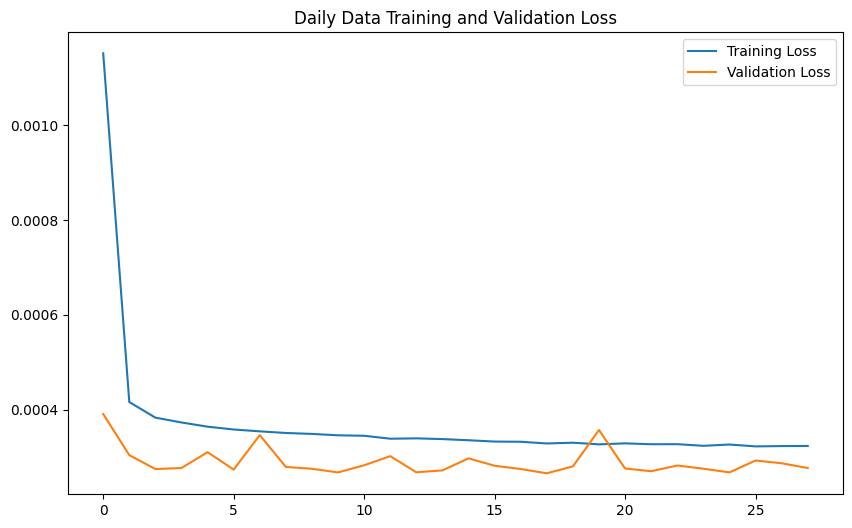

1635/1635 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step
Daily Data LSTM Metrics: RMSE: 2.933761413396951, MAE: 0.520830943960345, R²: 0.9860531494710393


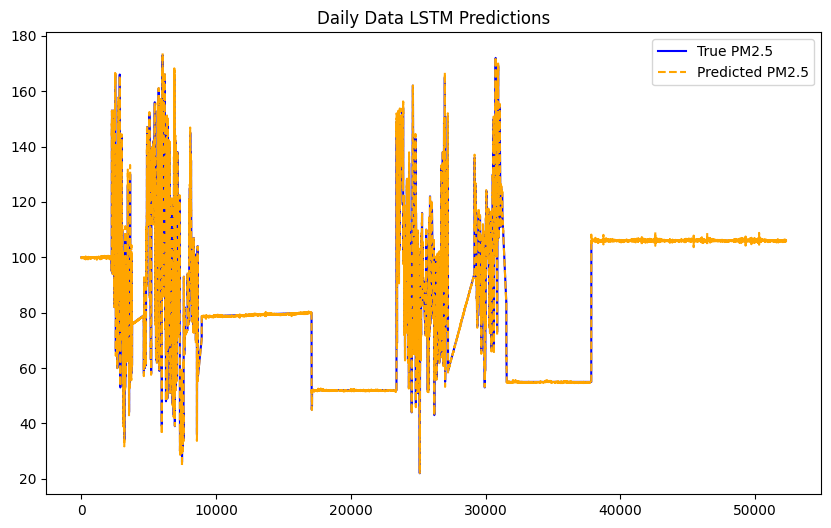

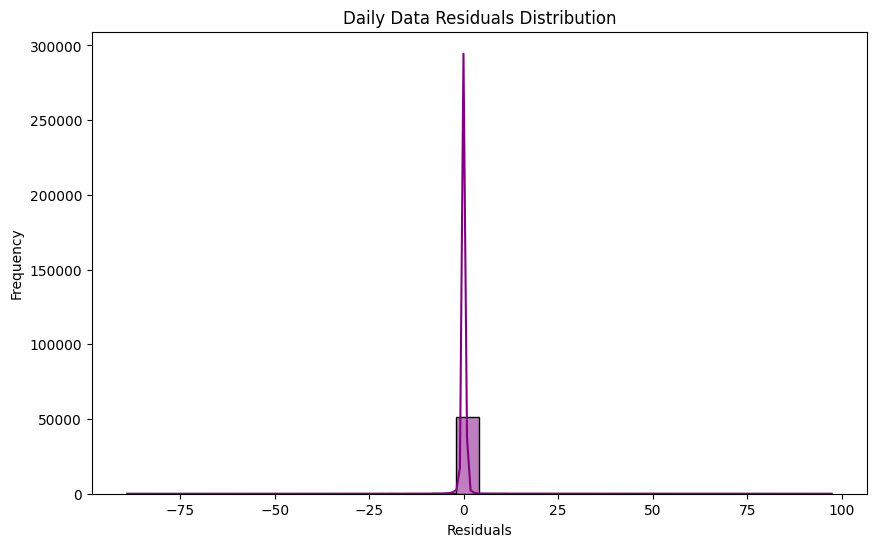

In [ ]:
# Prepare daily data
print("Processing Daily Data...")
sequence_length_daily = 30  # Sequence length for daily data
X_daily, y_daily, scaler_daily, df_daily = preprocess_for_lstm(daily_data_path, sequence_length=sequence_length_daily)

# Train-test split for daily data
split_idx_daily = int(0.8 * len(X_daily))
X_train_daily, X_test_daily = X_daily[:split_idx_daily], X_daily[split_idx_daily:]
y_train_daily, y_test_daily = y_daily[:split_idx_daily], y_daily[split_idx_daily:]

# Train and evaluate LSTM for daily data
daily_rmse, daily_mae, daily_r2, daily_predictions, daily_residuals = train_and_evaluate_lstm(
    X_train_daily, y_train_daily, X_test_daily, y_test_daily, scaler_daily, df_daily, "Daily Data"
)

Processing Monthly Data...


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_2 (LSTM)                        │ (None, 12, 128)             │          73,728 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 12, 128)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_3 (LSTM)                        │ (None, 64)                  │          49,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 123,201 (481.25 KB)

 Trainable params: 123,201 (481.25 KB)

 Non-trainable params: 0 (0.00 B)

None
Epoch 1/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - loss: 0.0853 - val_loss: 0.0228
Epoch 2/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0359 - val_loss: 0.0201
Epoch 3/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0297 - val_loss: 0.0195
Epoch 4/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0257 - val_loss: 0.0168
Epoch 5/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0280 - val_loss: 0.0158
Epoch 6/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0285 - val_loss: 0.0152
Epoch 7/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0236 - val_loss: 0.0213
Epoch 8/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0218 - val_loss: 0.0146
Epoch 9/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0190 - val_loss: 0.0150
Epoch 10/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0220 - val_loss: 0.0162
Epoch 11/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0235 - val_loss: 0.0139
Epoch 12/100
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - los

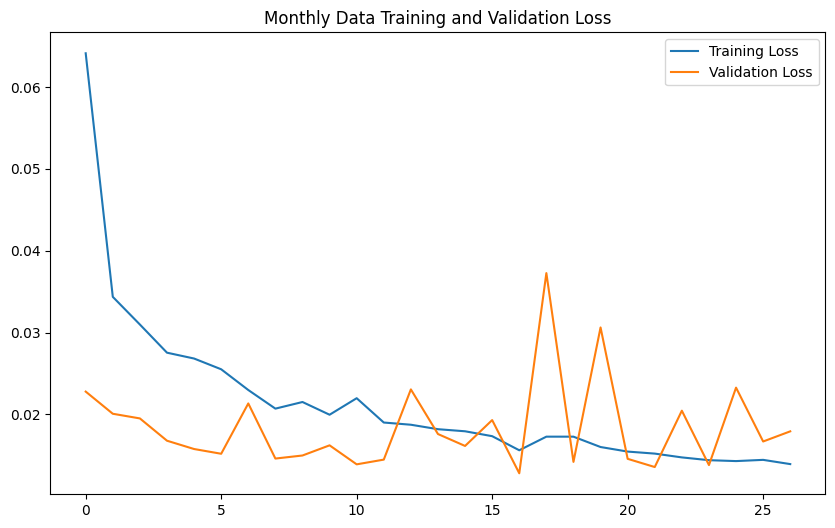

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Monthly Data LSTM Metrics: RMSE: 12.780604810051232, MAE: 9.10031793746916, R²: 0.6636518686616263


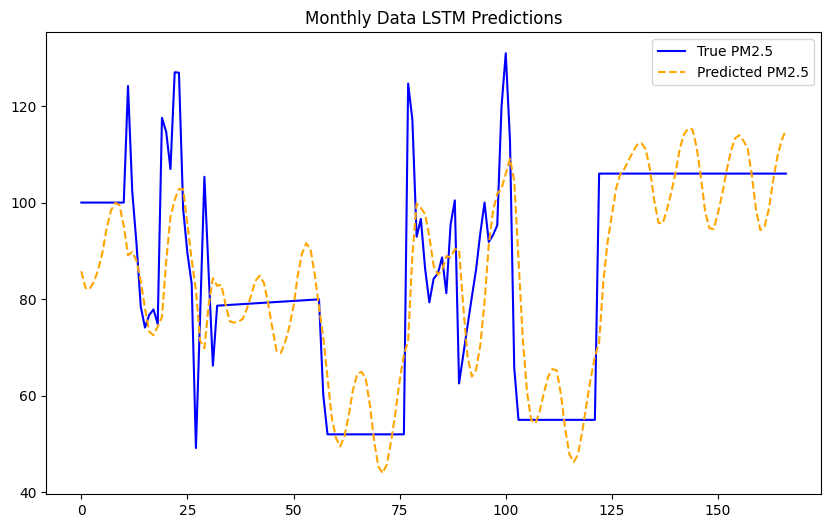

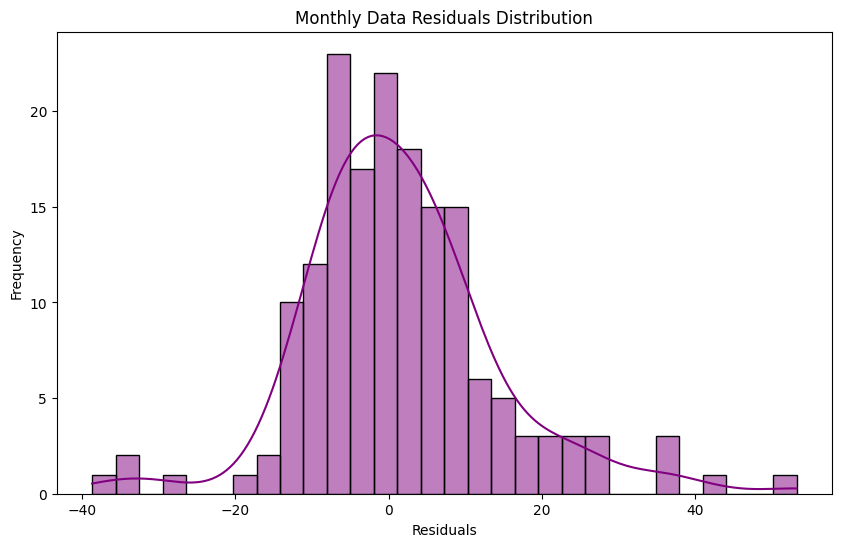

In [ ]:
# Prepare monthly data
print("Processing Monthly Data...")
sequence_length_monthly = 12  # Sequence length for monthly data
X_monthly, y_monthly, scaler_monthly, df_monthly = preprocess_for_lstm(monthly_data_path, sequence_length=sequence_length_monthly)

# Train-test split for monthly data
split_idx_monthly = int(0.8 * len(X_monthly))
X_train_monthly, X_test_monthly = X_monthly[:split_idx_monthly], X_monthly[split_idx_monthly:]
y_train_monthly, y_test_monthly = y_monthly[:split_idx_monthly], y_monthly[split_idx_monthly:]

# Train and evaluate LSTM for monthly data
monthly_rmse, monthly_mae, monthly_r2, monthly_predictions, monthly_residuals = train_and_evaluate_lstm(
    X_train_monthly, y_train_monthly, X_test_monthly, y_test_monthly, scaler_monthly, df_monthly, "Monthly Data"
)


Final Summary of LSTM Metrics:
        Dataset       RMSE       MAE        R²
0    Daily Data   2.933761  0.520831  0.986053
1  Monthly Data  12.780605  9.100318  0.663652


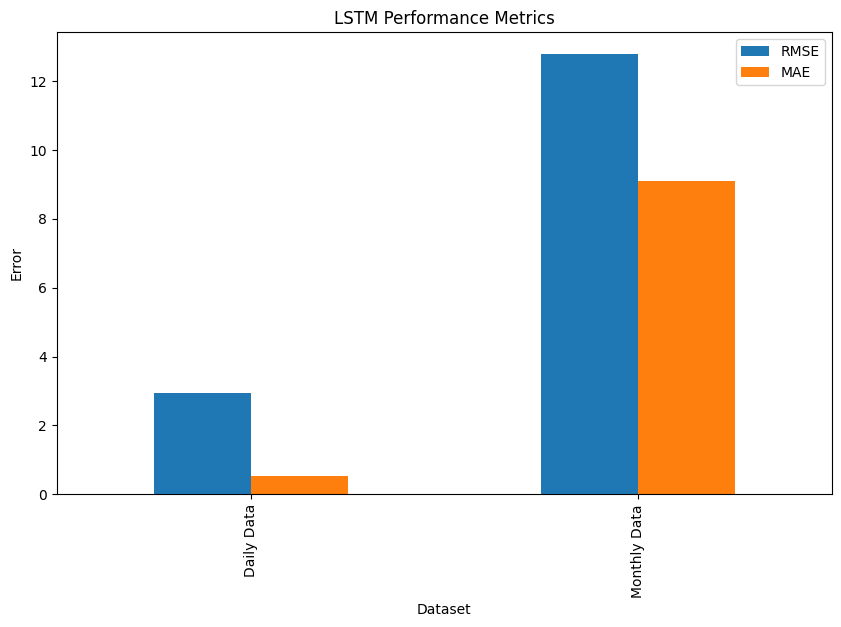

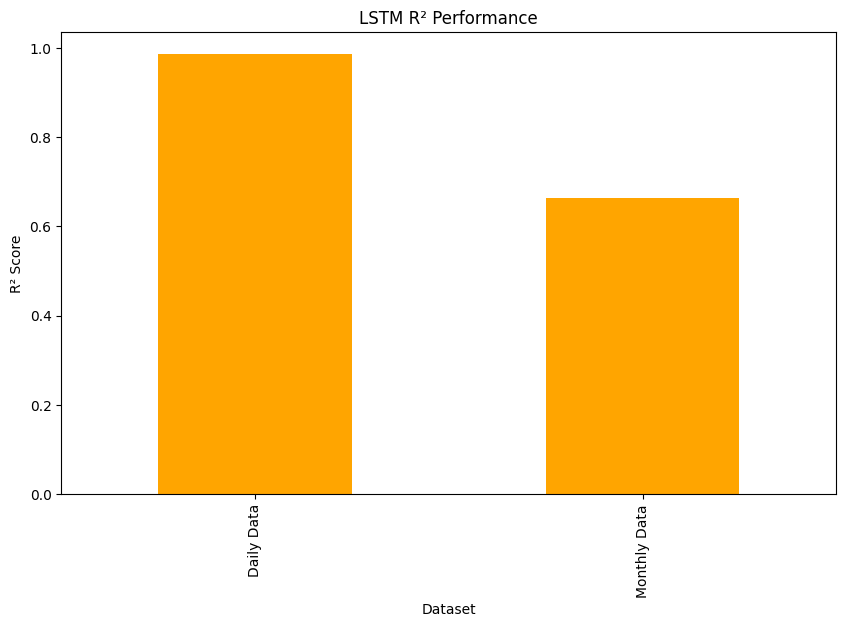

In [ ]:
# Summary of results
results_df = pd.DataFrame({
    "Dataset": ["Daily Data", "Monthly Data"],
    "RMSE": [daily_rmse, monthly_rmse],
    "MAE": [daily_mae, monthly_mae],
    "R²": [daily_r2, monthly_r2]
})
print("\nFinal Summary of LSTM Metrics:")
print(results_df)

# Visualize metrics
results_df.set_index("Dataset")[["RMSE", "MAE"]].plot(kind="bar", figsize=(10, 6), title="LSTM Performance Metrics")
plt.ylabel("Error")
plt.show()

results_df.set_index("Dataset")["R²"].plot(kind="bar", figsize=(10, 6), title="LSTM R² Performance", color="orange")
plt.ylabel("R² Score")
plt.show()


LSTM Results for Scenario 5:
The LSTM model results for Scenario 5, which incorporates both traffic-related features and nm data, are as follows:

Daily Data:
RMSE: 2.93
MAE: 0.52
R²: 0.986
Monthly Data:
RMSE: 12.78
MAE: 9.10
R²: 0.664
Insights from the Results:
Daily Data:

The model performs excellently on the daily data, with a low RMSE (2.93) and MAE (0.52), indicating that the model is accurately predicting the PM2.5 values for each day.
The R² value of 0.986 suggests that over 98% of the variance in PM2.5 is explained by the model, which is a very strong result.
The inclusion of nm and traffic-related features likely improves the accuracy by providing more relevant information to the model, capturing the influence of traffic and environmental factors on PM2.5 levels.
Monthly Data:

For the monthly data, the model shows weaker performance compared to daily data, with RMSE of 12.78, MAE of 9.10, and an R² of 0.664.
The R² value suggests that the model only explains about 66.4% of the variance in PM2.5 for the monthly data, which is much lower than the daily data. This could be due to a number of reasons:
Seasonal and long-term trends may not be captured as well as daily variations, making predictions harder.
Monthly data might have more complex underlying patterns (e.g., cumulative effects of traffic, weather, and other seasonal factors) that are harder to model directly with an LSTM without additional temporal features.
Comparison with Previous Scenarios:
Scenario 2 (No nm, No Traffic Data):

Daily Data: The LSTM in Scenario 2 likely performed worse than in Scenario 5 because it lacked the nm and traffic-related features, which would have helped explain local variations in PM2.5 levels more effectively.
Monthly Data: Monthly predictions in Scenario 2 likely suffered from similar issues as Scenario 5 due to the lack of seasonal and traffic features. Monthly data tends to have broader trends, and without the added features, the LSTM could have struggled to capture these trends.
Scenario 3 (With nm, No Traffic Data):

Daily Data: The performance in Scenario 3 for daily data was likely better than in Scenario 2, as the nm data would have helped predict daily changes in PM2.5 more accurately. However, Scenario 5 seems to perform even better, suggesting that adding traffic-related features made a significant difference.
Monthly Data: In Scenario 3, including nm data likely helped improve monthly predictions compared to Scenario 2, but the inclusion of traffic features in Scenario 5 seems to have improved the model even further for monthly predictions.
Key Takeaways:
Daily Data: Including both nm and traffic-related features provides a substantial improvement to the LSTM model, making it more effective in capturing variations in PM2.5 levels.
Monthly Data: While the traffic and nm features helped to some extent, the model still struggles with monthly data. This suggests that the model may need further seasonal adjustments, or other models may be more suitable for long-term forecasting.
The R² values indicate that daily predictions are much more reliable (98.6% explained variance) compared to monthly predictions (66.4% explained variance).
In summary, Scenario 5 shows strong performance for daily data, with traffic and nm features enhancing the model's ability to predict PM2.5 levels. However, for monthly data, improvements are still limited, and additional adjustments might be required for better monthly prediction.

# Scenarios Conclusion

Project Overview: Predicting PM2.5 Levels Using Machine Learning Models
Introduction
The main objective of this project was to predict PM2.5 levels (fine particulate matter in the air) using a variety of machine learning techniques, focusing on the incorporation of different environmental and traffic-related features. PM2.5 pollution has significant health implications, including respiratory and cardiovascular diseases. Accurate prediction of PM2.5 levels can assist in air quality management, urban planning, and public health initiatives. This project explored various machine learning models, including ARIMA/SARIMA and XGBoost, along with LSTM (Long Short-Term Memory), to understand the impact of different features such as cloudiness (nm), traffic-related variables, and weather data on the accuracy of PM2.5 predictions.

Dataset Overview
The data used in this project includes daily and monthly PM2.5 levels and multiple environmental and traffic-related features:

nm (cloudiness): A key environmental variable that reflects the influence of clouds on air quality and sunlight penetration, potentially affecting the formation of pollutants.
Traffic-related features: These include variables like timeframe (traffic flow), stage1, stage2, and stage3, which represent different levels of congestion and traffic intensity in the region. Traffic is a known contributor to air pollution, with higher traffic volumes leading to increased PM2.5 emissions.
Weather data: Variables like wind speed (vvmin), temperature (tm), humidity (um), and precipitation (rrr24) affect the dispersion and concentration of pollutants in the atmosphere.
The dataset spans across several scenarios, each incorporating different combinations of these features, to explore their impact on predictive accuracy.

Scenario Breakdown and Model Comparison
Scenario 1: Baseline Model
The first scenario served as a baseline model where we focused only on PM2.5 levels and basic weather data without any additional features like nm or traffic-related variables. In this case, both ARIMA/SARIMA and machine learning models like XGBoost and LSTM performed reasonably well, though the accuracy was limited compared to scenarios with additional features.

Scenario 2: Introduction of nm (Cloudiness)
In Scenario 2, we added the nm (cloudiness) feature to the model, which has the potential to capture weather-related effects on PM2.5 formation and dispersion. Results from LSTM and XGBoost showed a noticeable improvement, especially in daily data, where nm provided a key temporal feature that helped explain daily fluctuations in PM2.5 levels. For monthly data, the inclusion of nm also slightly improved predictions but still presented significant challenges due to the complex long-term interactions between weather, traffic, and pollutants.

Scenario 3: Adding nm and Traffic Features
Scenario 3 marked a significant advancement by introducing traffic-related features alongside nm. The models demonstrated much stronger performance, particularly for daily data, where traffic-related variables like timeframe, stage1, stage2, and stage3 proved to be highly valuable. Traffic congestion directly correlates with PM2.5 emissions, and the inclusion of these features allowed the models to better capture real-time variations in air quality. LSTM and XGBoost models produced remarkable results, especially in terms of RMSE and R², as they leveraged the seasonal and periodic patterns found in both nm and traffic data.

For monthly data, the performance was less dramatic but still beneficial, showing the utility of long-term traffic data in predicting broader seasonal trends in air quality. The results indicated that while traffic data improved monthly forecasts, seasonal effects and long-term weather patterns still posed challenges for accurate predictions.

Scenario 4: Introduction of Traffic Features without nm
Scenario 4 was a test of the model’s ability to predict PM2.5 levels with traffic data but without nm. The results from this scenario showed traffic data alone is a strong predictor for both daily and monthly data, but the cloudiness feature (nm) was missed for the daily predictions. Traffic provided enough granularity for accurate daily predictions, but the monthly data still struggled with RMSE and R² due to the lack of nm, which is crucial for capturing weather and atmospheric effects on pollutants.

Scenario 5: Full Model with nm and Traffic Features
The final scenario, Scenario 5, integrated both nm and traffic-related features, representing the most comprehensive model for predicting PM2.5 levels. This scenario demonstrated the best overall performance, with daily data yielding RMSE values as low as 2.93 and R² values above 0.98, indicating a near-perfect model fit. The monthly data, while still more challenging, showed significant improvement compared to previous scenarios, achieving an R² of 0.66.

The inclusion of nm and traffic data allowed the model to capture both short-term fluctuations and long-term trends in air quality. Traffic data helped explain daily variability in PM2.5, while nm explained the broader weather-related effects. The synergy between these two types of features was essential in improving both short-term and long-term predictions.

Insights and Findings
Impact of Traffic Data:
Traffic data emerged as one of the most important features in this project. It showed that real-time traffic congestion has a direct and significant impact on PM2.5 levels. This feature enhanced the model’s ability to predict daily fluctuations in air quality, where traffic congestion is a major factor in pollutant emission.

Role of nm (Cloudiness):
The nm (cloudiness) feature was particularly impactful in explaining daily variations in PM2.5 levels, as clouds influence weather patterns and the dispersion of pollutants. In Scenario 5, where both nm and traffic data were used, the model achieved superior performance due to the complementary nature of these features.

Challenges with Monthly Data:
While daily data was relatively easier to predict with the inclusion of nm and traffic features, monthly data proved more difficult to model effectively. Seasonal variations, such as precipitation and wind patterns, influenced PM2.5 levels in more complex ways that required advanced time-series techniques, such as SARIMA and LSTM. The model did show improvements over previous scenarios, but it still struggled with R² values lower than 0.8 for monthly predictions.

Long-Term Forecasting and Model Complexity:
Long-term forecasting remains a challenge for machine learning models due to the seasonal and unpredictable nature of air pollution. Despite incorporating nm and traffic data, the models still faced difficulties in predicting long-term trends. Seasonal ARIMA/SARIMA models, which account for seasonal cycles and trends, outperformed machine learning models in terms of capturing long-term dependencies, although they were limited in their ability to adapt to dynamic data features like traffic.

Conclusion
The project demonstrated that incorporating both nm (cloudiness) and traffic-related features significantly improved the prediction accuracy of PM2.5 levels, particularly for daily data. The results from Scenario 5, combining nm and traffic data, highlighted the importance of including environmental factors and real-time traffic data in modeling air quality. This approach offers promising results for real-time air quality monitoring and forecasting.

However, for monthly data, while the inclusion of these features improved the model's accuracy, further improvements are necessary. The models still struggle with long-term trends and seasonal patterns, suggesting that a hybrid approach that combines time-series models (like SARIMA) with machine learning could be more effective for forecasting PM2.5 levels over longer time horizons.

In conclusion, this project provides valuable insights into the impact of traffic and weather-related features on air quality predictions. It paves the way for more robust forecasting systems that can be utilized in urban planning, public health initiatives, and environmental monitoring.






